In [26]:
import numpy as np
import math
import time
import matplotlib.pyplot as plt

from scipy.optimize import minimize

In [27]:
sigma = 0.5
mu = np.array([-0.0, 0.0])
n = 10

mu_hat = np.mean(np.random.multivariate_normal( mu, np.identity(2), n), axis=0)
print(mu_hat)

[-0.05425876 -0.28664439]


In [28]:
def sample_noise(T=10.0, dt=0.5, num_trajs=500, n=2) :
    time_steps = math.floor(T/dt)
    noise_samples = np.random.multivariate_normal(np.zeros(2), np.identity(2) , [num_trajs,time_steps])
    return noise_samples

def stage_cost(dist2, dist_weight = 1) :
    return dist_weight*dist2

def term_cost(dist2, goal_reached) :
    return (1 - float(goal_reached)) * dist2

def compute_lambda_theta(theta) :
    return 1/(1 - theta)

def rollout(x0, x_goal, u_curr, obs_pos, obs_r, T, dt, theta, noise_samples, dist_weight, sigma, mu_hat, obs_cost = 10, num_trajs=500, num_vis=500, goal_tolerance=0.1) :
    costs = np.zeros(num_trajs)
    # time_steps = len(u_curr) # Haven't defined u_curr yet
    time_steps = int(T//dt)
    goal_reached = False
    goal_tolerance_sq = goal_tolerance ** 2
    # dist_to_goal2 = 1e9
    
    x_vis = np.zeros( (num_vis, time_steps, 2) )*np.nan
    n = len(x0)
    
    for k in range(num_trajs) :
        x_curr = np.zeros(n)
        for i in range(n) :
            x_curr[i] = x0[i]
        if k < num_vis :
            x_vis[k, 0, :] = x_curr[:2]    
        for t in range(time_steps) :
            # x_curr +=np.array([[0, 0, dt, 0],[0, 0, 0, dt],[0, 0, 0, 0],[0, 0, 0, 0]]) @ x_curr + np.array([[0, 0],[0, 0],[sigma, 0],[0, sigma]]) @ (mu_hat*dt + noise_samples[k,t,:] * np.sqrt(dt))    
            x_curr +=np.array([[0, 0, dt, 0],[0, 0, 0, dt],[0, 0, 0, 0],[0, 0, 0, 0]]) @ x_curr + np.array([[0, 0],[0, 0],[sigma, 0],[0, sigma]]) @ ( mu*dt + noise_samples[k,t,:] * np.sqrt(dt))    
            
            if k < num_vis :
                x_vis[k, t, :] = x_curr[:2]    
                
            # dist_to_goal2 = (x_goal[0]-x_curr[0])**2 + (x_goal[1]-x_curr[1])**2
            # if dist_to_goal2 < 0.01 :
            #     costs[k] += stage_cost(dist_to_goal2, dist_weight)
            #     break
            # else :

            dist_to_goal2 = (x_goal[0]-x_curr[0])**2 + (x_goal[1]-x_curr[1])**2
            costs[k] += stage_cost(dist_to_goal2, dist_weight)
            if dist_to_goal2 <= goal_tolerance_sq :
                goal_reached = True
                break
            num_obs = len(obs_pos)
            if num_obs != 0 :
                for obs_i in range(num_obs) :
                    op = obs_pos[obs_i]
                    costs[k] += float(x_curr[0] > op[0] and x_curr[0] < op[0] + obs_r[obs_i] and 
                                      x_curr[1] > op[1] and x_curr[1] < op[1] + obs_r[obs_i]) * obs_cost 
                if float(x_curr[0] > op[0] and x_curr[0] < op[0] + obs_r[obs_i] and 
                                  x_curr[1] > op[1] and x_curr[1] < op[1] + obs_r[obs_i]) != 0 :
                    break
                # Boundary panalty
                costs[k] += float(x_curr[0] < -4 or x_curr[0] > 1  or
                                  x_curr[1] < -1 or x_curr[1] > 4 )  * obs_cost 
                
                if float(x_curr[0] < -4 or x_curr[0] > 1  or
                                  x_curr[1] < -1 or x_curr[1] > 4 ) != 0 :
                    break
            
            
            # Terminal cost
            # costs[k] += term_cost(dist_to_goal2, goal_reached) 
            
            # for t in range(time_steps) :
            #     costs[k] += u_curr[t,:] @ Sigma @ u_curr[t,:]
    return costs, x_vis

In [29]:
def opt_cost_func(lambda_, gamma, costs, num_trajs):
    lambda_prime = 1 / (1 - lambda_)
    return gamma / lambda_ + 1/lambda_prime * np.log(1/num_trajs * np.sum(np.exp(-costs * lambda_prime)))


In [30]:
def update_useq_risk_neutral(costs, u_curr, noise_samples, T, dt, sigma, lambda_neut=1, n=2) :
    costs = np.exp( - (costs) / lambda_neut )     
    sum_costs = np.sum(costs)    
    
 
    time_steps = math.floor(T/dt)
    u_curr = np.zeros((time_steps,n))
    for t in range(time_steps) :
        for k in range(len(costs)) :
            u_curr[t,:] += (costs[k] / sum_costs ) * noise_samples[k,t,:] / np.sqrt(dt) 

    return  u_curr



In [31]:
def update_useq_NM(costs, u_curr, noise_samples, gammas, T, dt, init_report, n=2, desired_threshold=1e-3):
    num_trajs = len(noise_samples)
    lambda_r = 1  # Initialize lambda_r

    for gamma in gammas:
        best_result = None
        best_value = float('inf')  # Initialize to positive infinity for minimization
        best_method = None
        
        methods = ['Powell', 'CG', 'BFGS', 'L-BFGS-B', 'TNC', 'COBYLA', 'SLSQP']
        bound_for_lambda = [(0, None)]  # This sets the lower bound to 0 and no upper bound

        for method in methods:
            try:
                result = minimize(opt_cost_func, x0=lambda_r, args=(gamma, costs, num_trajs), method=method, bounds=bound_for_lambda)
                
                # Compare result.fun even if result.success is False
                if result.fun < best_value:
                    best_result = result
                    best_value = result.fun
                    best_method = method
            except ValueError as e:
                print(f"Error using method {method} for gamma = {gamma}: {e}")
        
        if best_result:  # If we found a result (regardless of success status)
            lambda_r = best_result.x[0]
            #print(f"For gamma = {gamma}, best method is {best_method} with value {best_value}.")
            
            # Stop the loop if the best_value is below the desired_threshold
            if best_value < desired_threshold:
                print(f"Desired threshold reached with value {best_value}. Stopping optimization.")
                break  # Break out of the gamma loop
        else:
            print("Optimization failed for gamma =", gamma)

    # Return the best lambda_r found
    return update_useq_risk_neutral(costs, u_curr, noise_samples, T, dt, sigma, lambda_neut=lambda_r, n=2)

In [32]:
def path_integral(x0, x_goal, u_curr, dist_weight, obs_cost, obs_pos, obs_r, T, dt, theta, num_trajs, num_vis, init_report, gammas, sigma):
    
    noise_samples = sample_noise(T, dt, num_trajs, n=2)
    costs, x_vis = rollout(x0, x_goal, u_curr, obs_pos, obs_r, T, dt, theta, noise_samples, dist_weight, sigma, mu_hat, obs_cost, num_trajs, num_vis, goal_tolerance=0.1)   
    #u_curr = update_useq_risk_neutral(costs, u_curr, noise_samples, T, dt, sigma, lambda_neut=1, n=2)
    # u_curr = update_useq_bisection(costs, u_curr, noise_samples, gammas, T, dt, init_report, sigma, n=2)
    u_curr = update_useq_NM(costs, u_curr, noise_samples, gammas, T, dt, init_report, n=2, desired_threshold=1e-3)
    return u_curr, x_vis

In [33]:
num_simulation = 100
max_steps = 600
x_hists = np.zeros( (num_simulation, max_steps+1, 2) )*np.nan
success_time = []
success_index = []
fail_index = []

/var/folders/lf/cvhsltm529q5zyt6s5vt08l00000gn/T/ipykernel_36170/3098456216.py:2: RuntimeWarning: divide by zero encountered in divide
  lambda_prime = 1 / (1 - lambda_)
/var/folders/lf/cvhsltm529q5zyt6s5vt08l00000gn/T/ipykernel_36170/3098456216.py:3: RuntimeWarning: divide by zero encountered in log
  return gamma / lambda_ + 1/lambda_prime * np.log(1/num_trajs * np.sum(np.exp(-costs * lambda_prime)))
/var/folders/lf/cvhsltm529q5zyt6s5vt08l00000gn/T/ipykernel_36170/3098456216.py:3: RuntimeWarning: invalid value encountered in multiply
  return gamma / lambda_ + 1/lambda_prime * np.log(1/num_trajs * np.sum(np.exp(-costs * lambda_prime)))
/var/folders/lf/cvhsltm529q5zyt6s5vt08l00000gn/T/ipykernel_36170/3098456216.py:3: RuntimeWarning: overflow encountered in exp
  return gamma / lambda_ + 1/lambda_prime * np.log(1/num_trajs * np.sum(np.exp(-costs * lambda_prime)))
/usr/local/Caskroom/miniconda/base/envs/Lab/lib/python3.11/site-packages/scipy/optimize/_optimize.py:2305: RuntimeWarning: i

Desired threshold reached with value -inf. Stopping optimization.


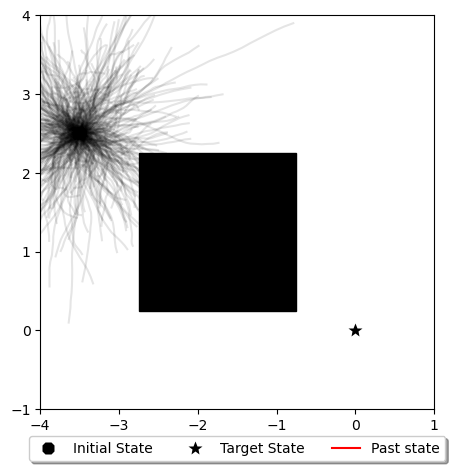

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


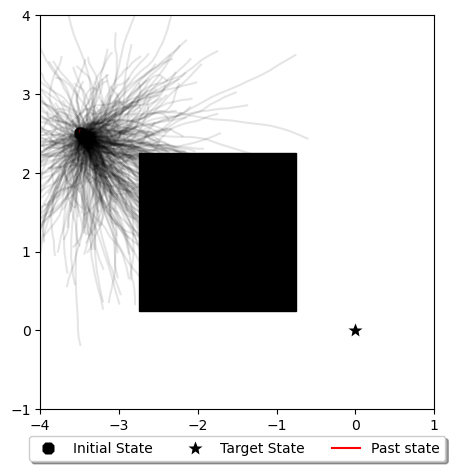

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


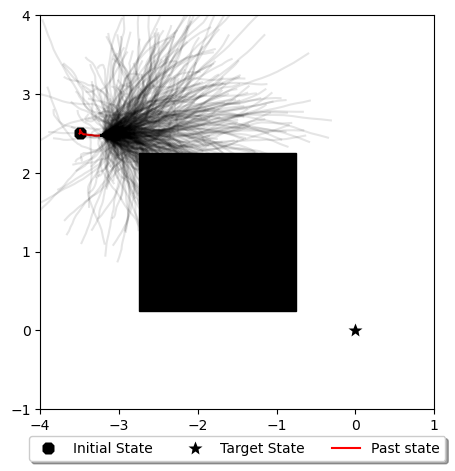

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


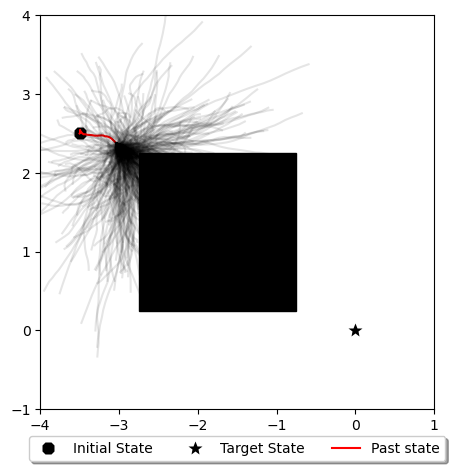

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


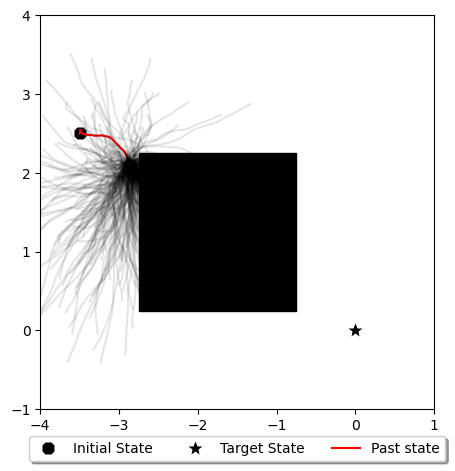

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


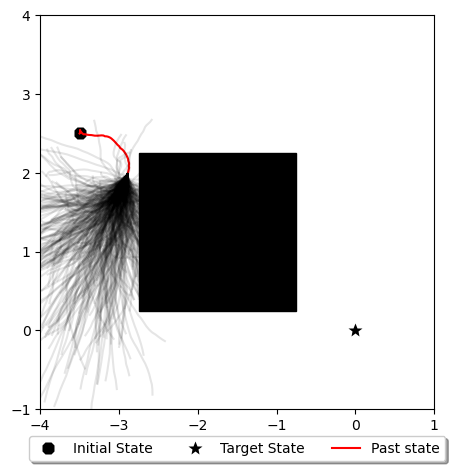

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


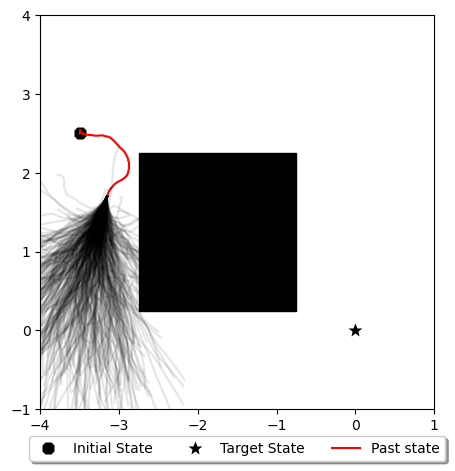

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


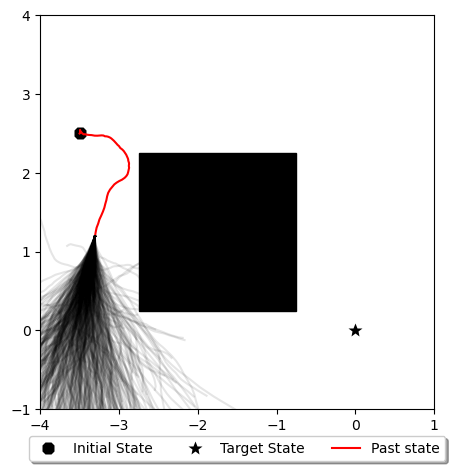

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


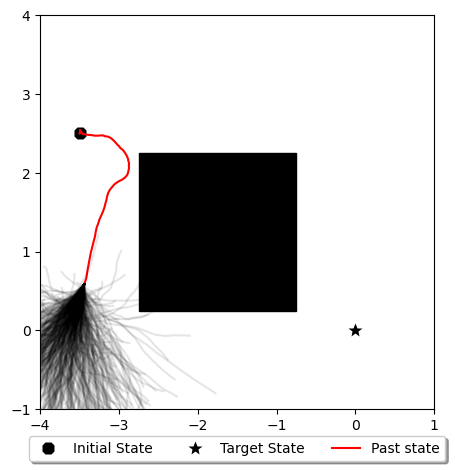

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


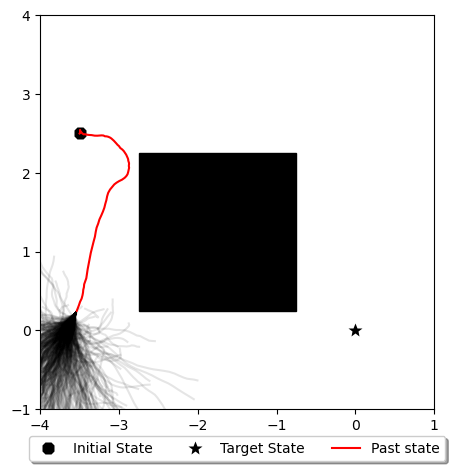

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


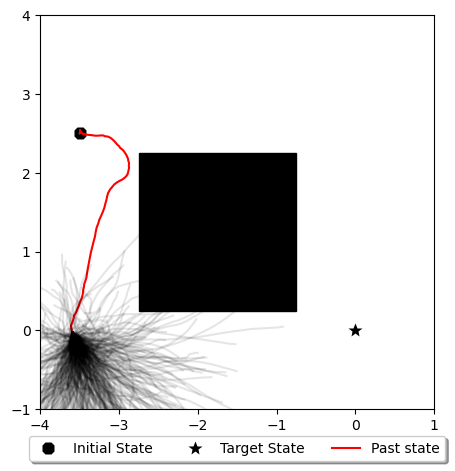

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


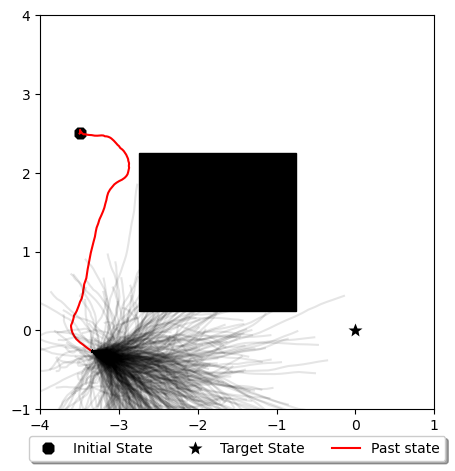

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


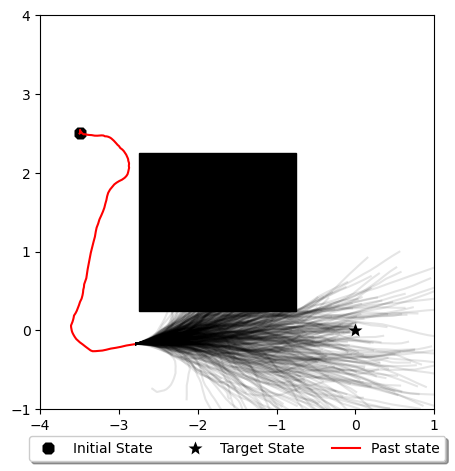

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


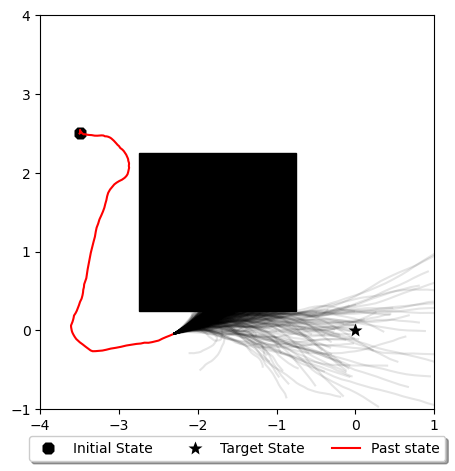

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


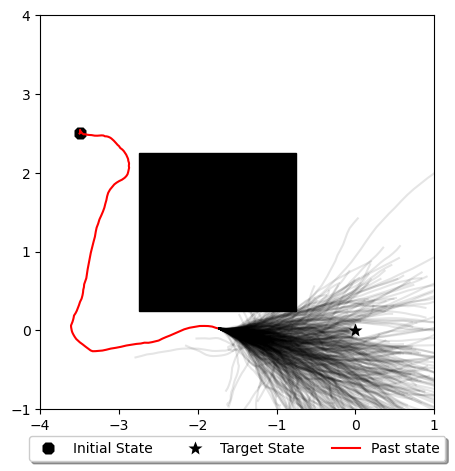

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


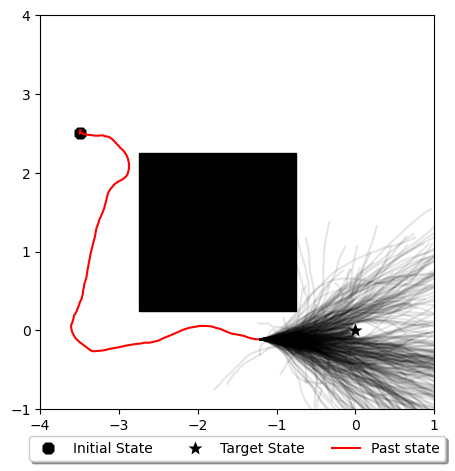

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


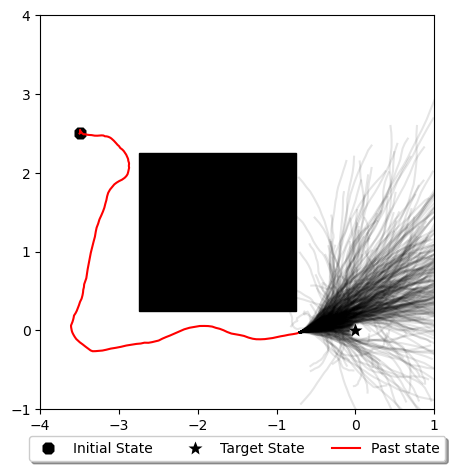

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


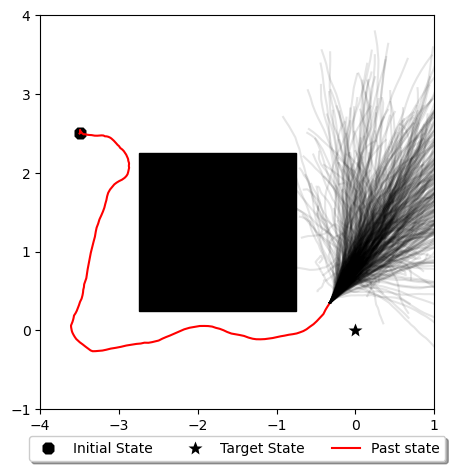

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


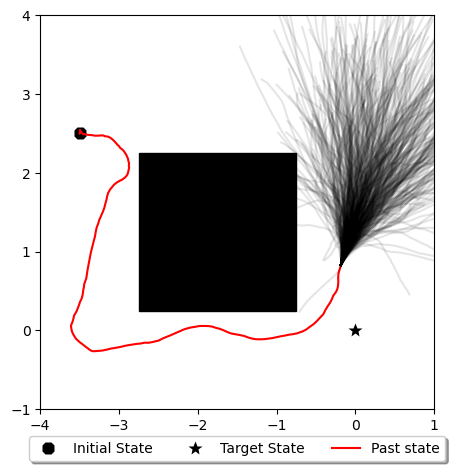

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


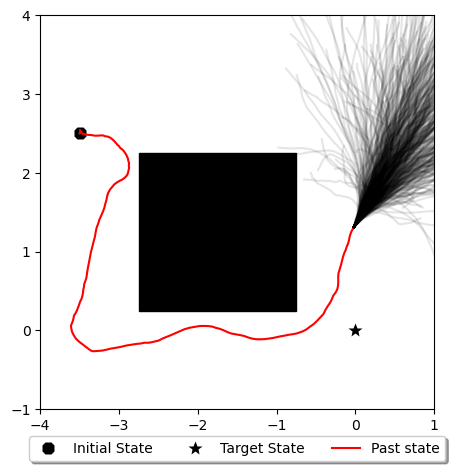

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


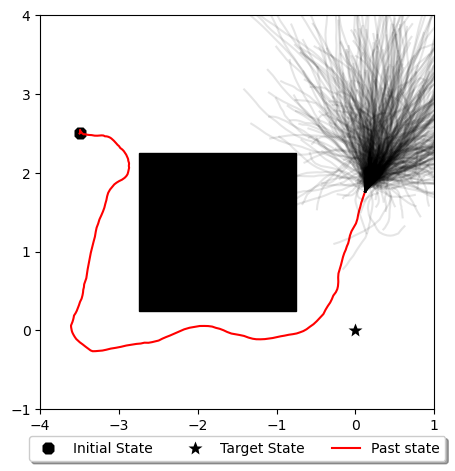

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


/usr/local/Caskroom/miniconda/base/envs/Lab/lib/python3.11/site-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


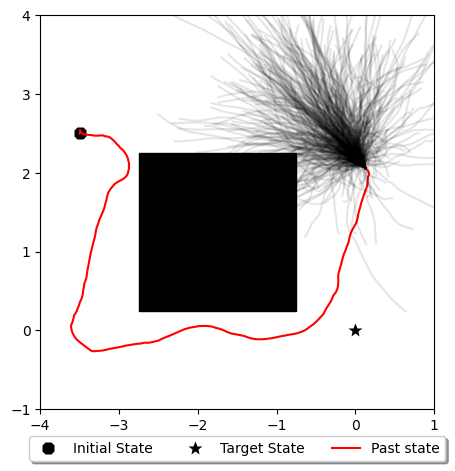

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


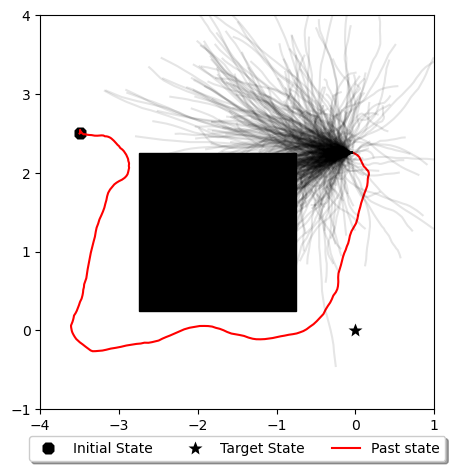

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


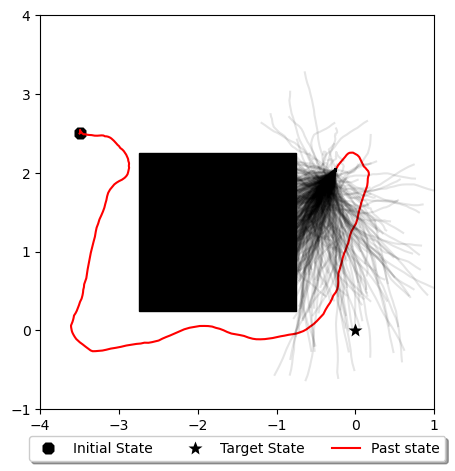

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


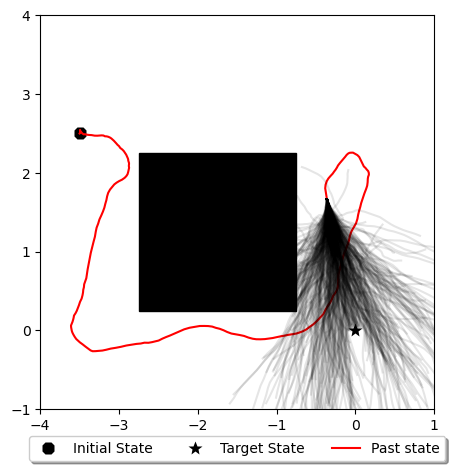

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


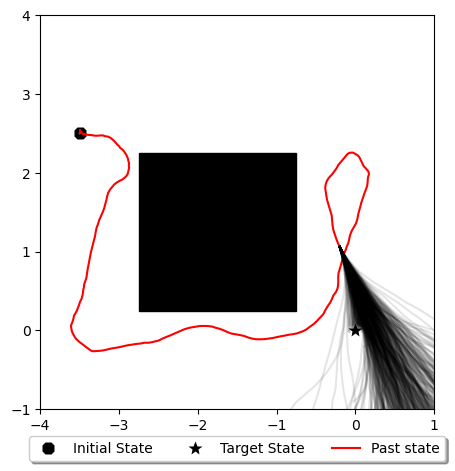

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


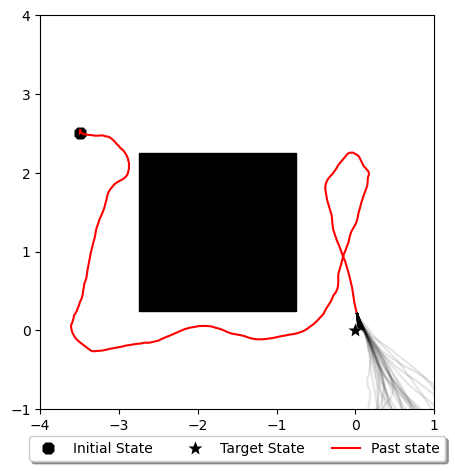

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -8.437940008402564e-05. Stopping optimization.
Goal reached at t=13.10s
Desired threshold reached with value -inf. Stopping optimization.


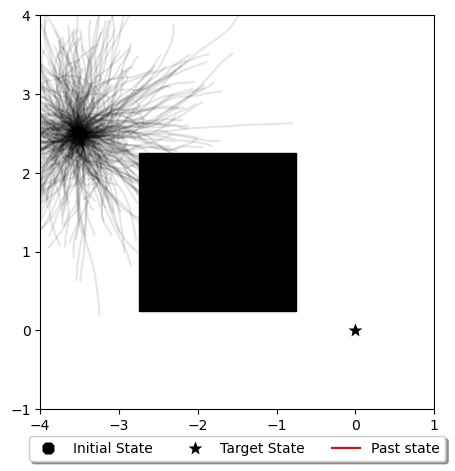

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


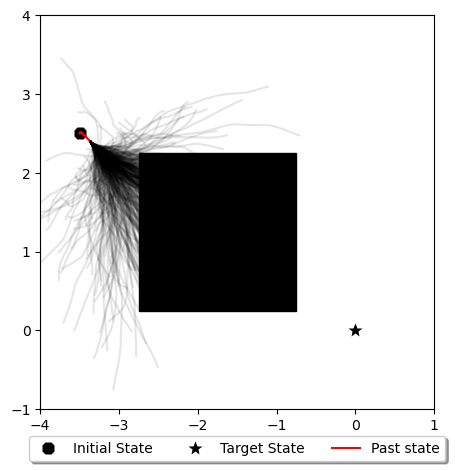

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


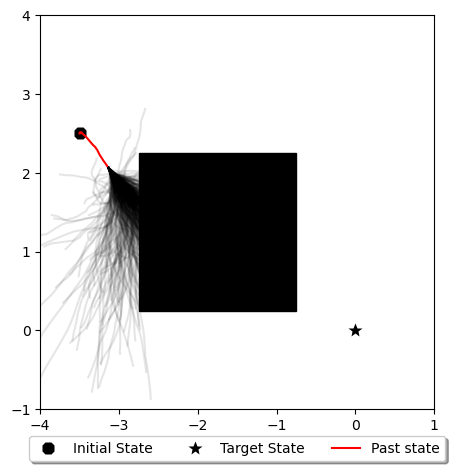

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


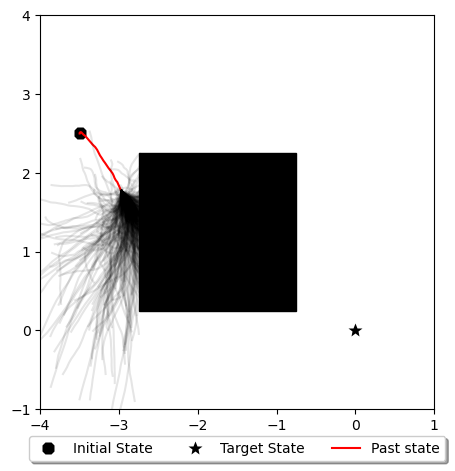

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


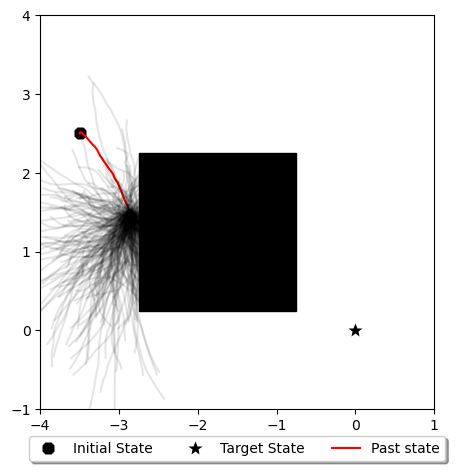

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


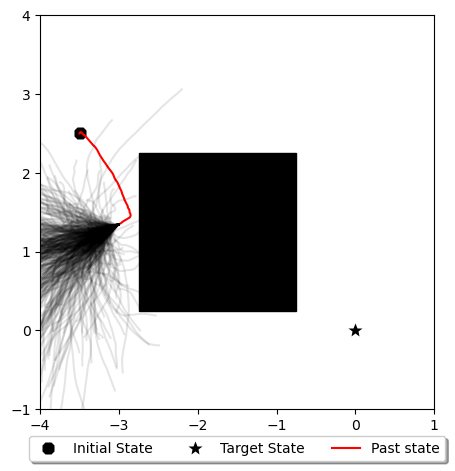

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


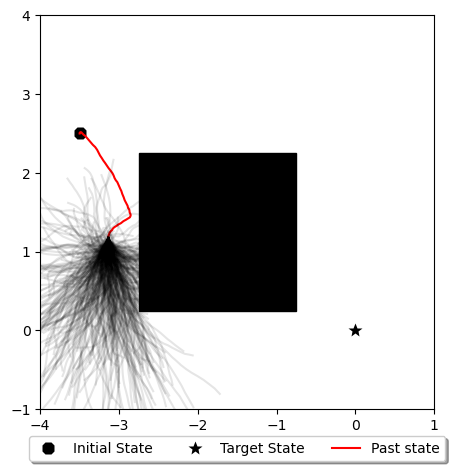

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


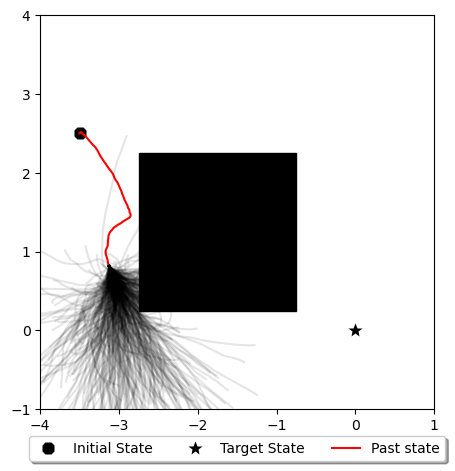

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


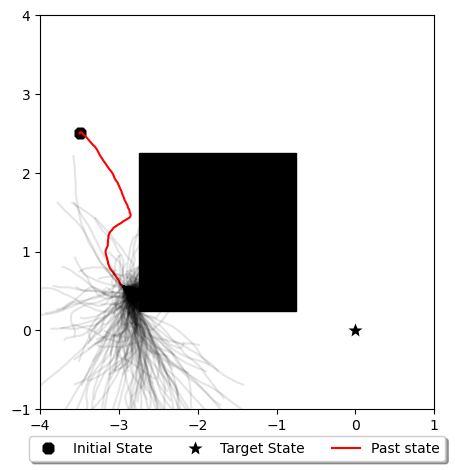

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


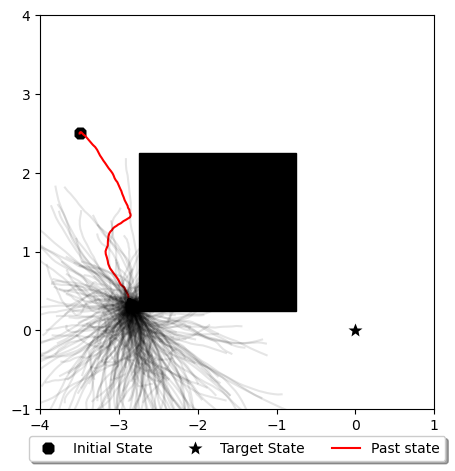

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


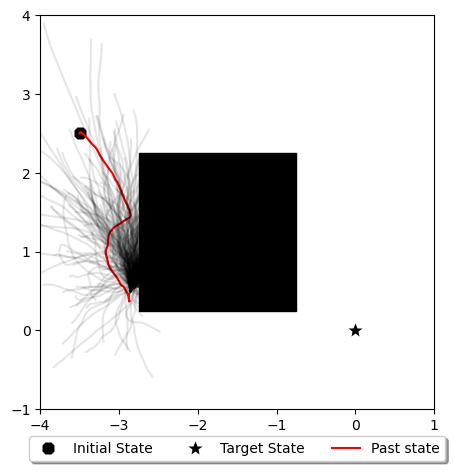

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


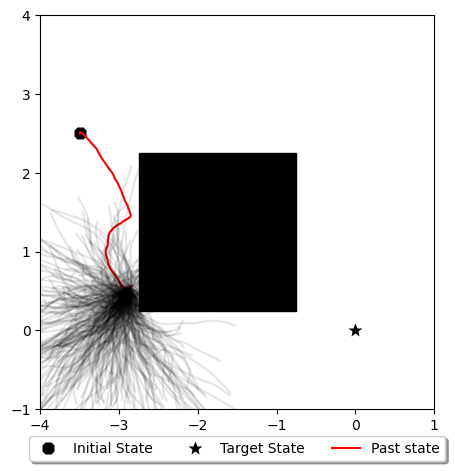

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


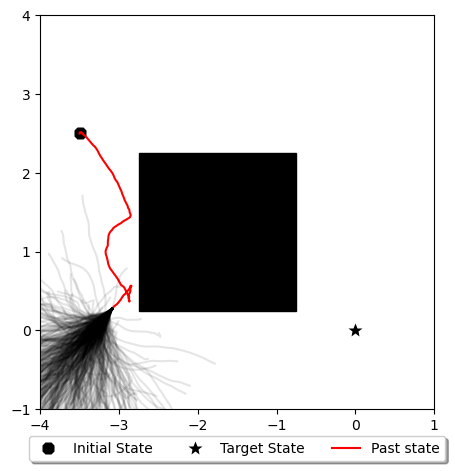

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


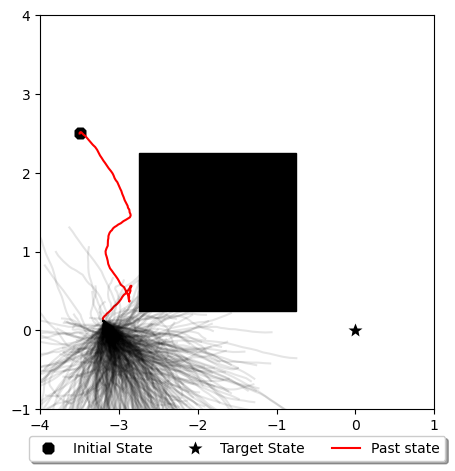

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


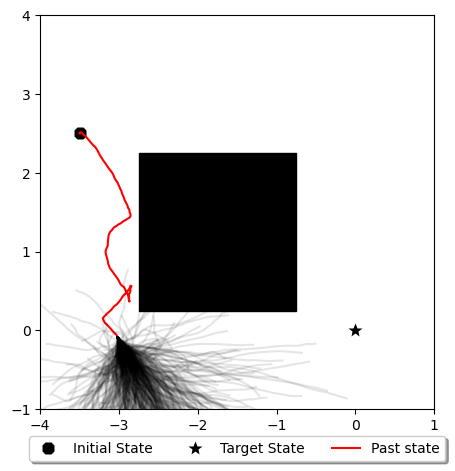

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


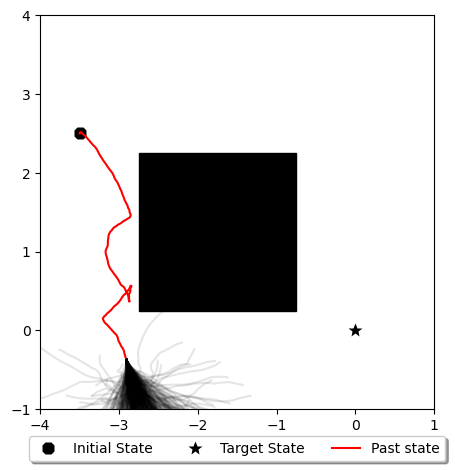

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


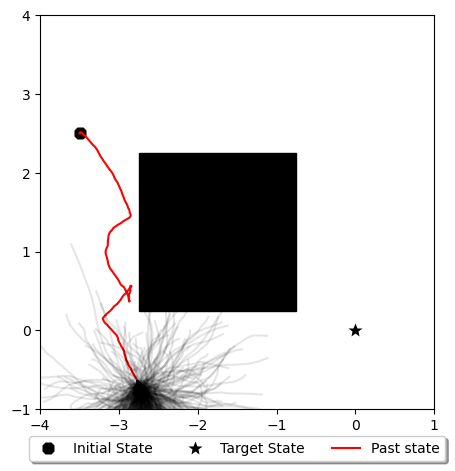

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


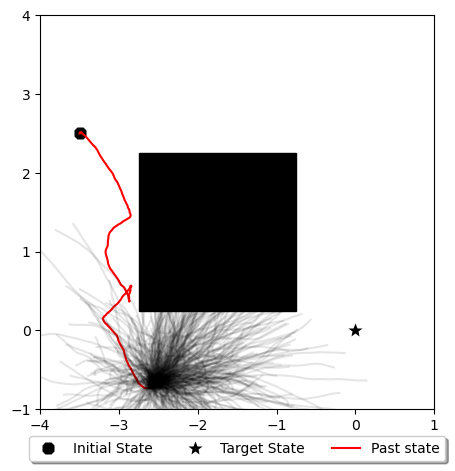

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


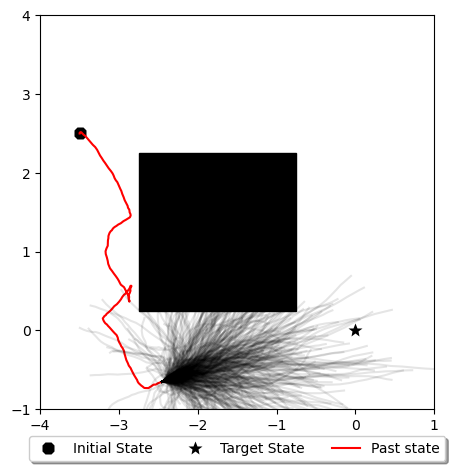

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


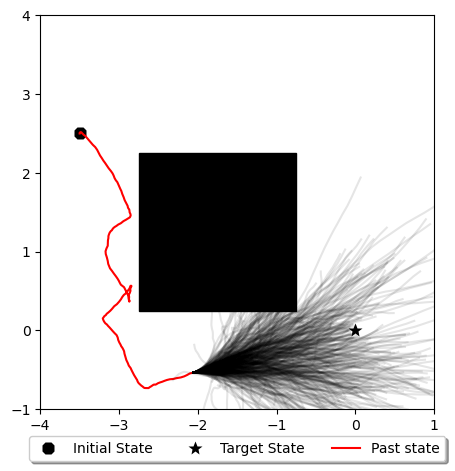

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


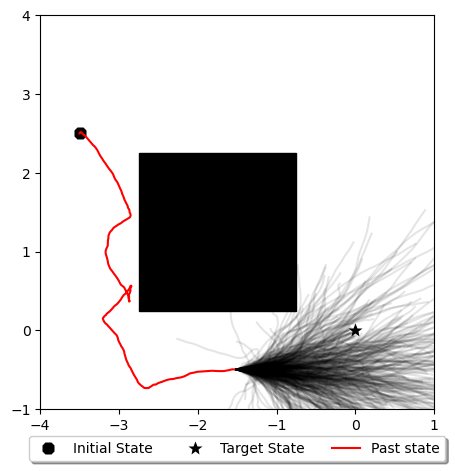

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


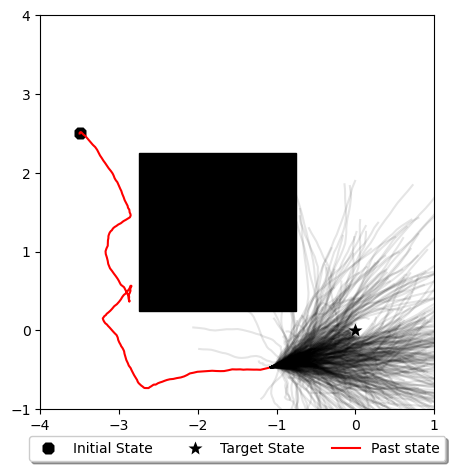

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


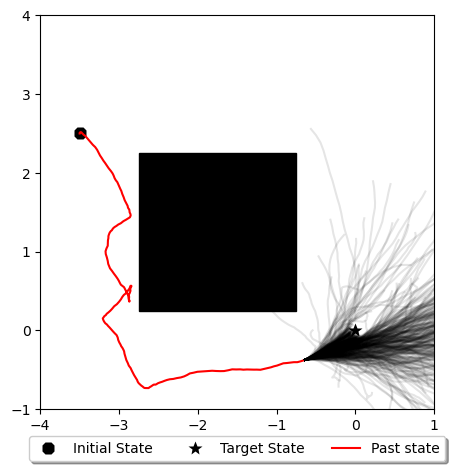

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


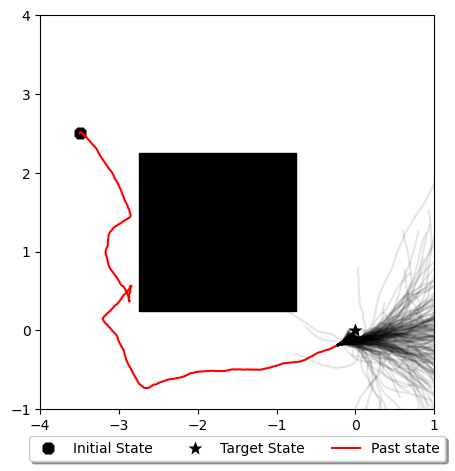

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -7.385982892329562e-05. Stopping optimization.
Goal reached at t=11.70s
Desired threshold reached with value -inf. Stopping optimization.


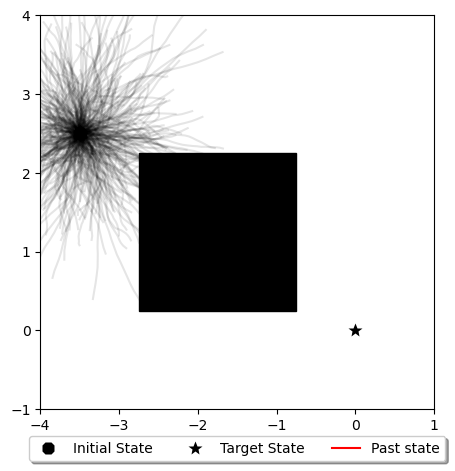

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


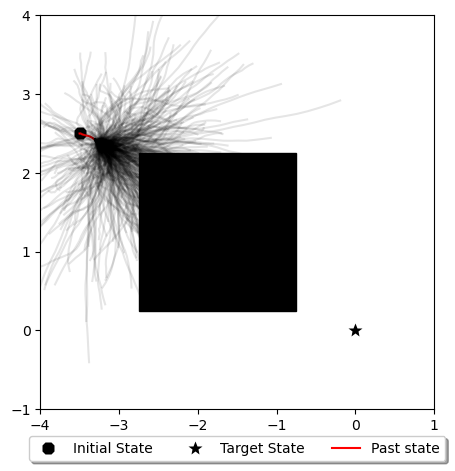

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


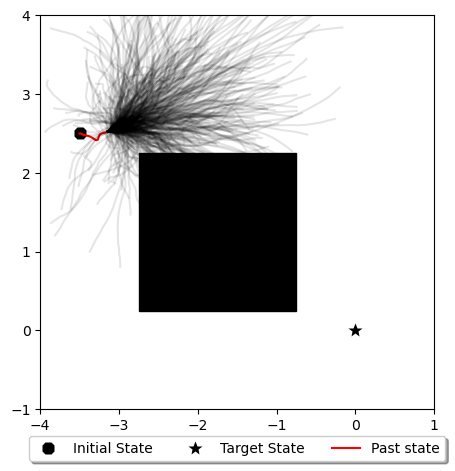

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


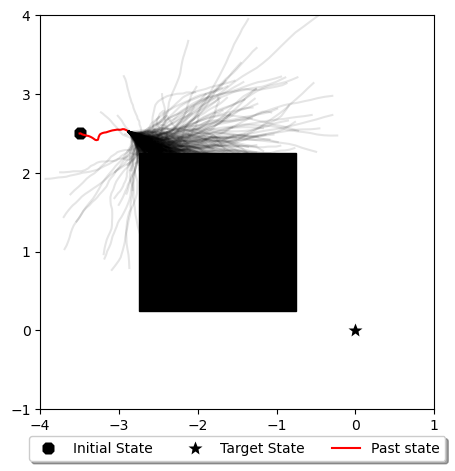

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


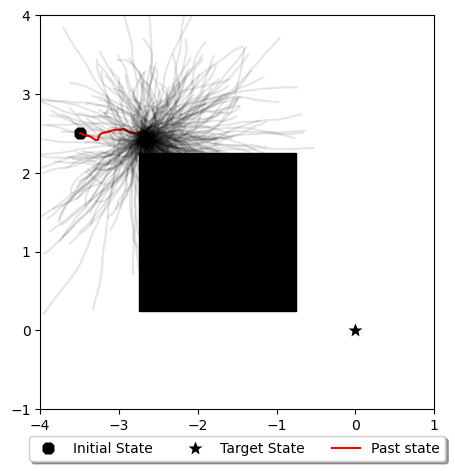

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


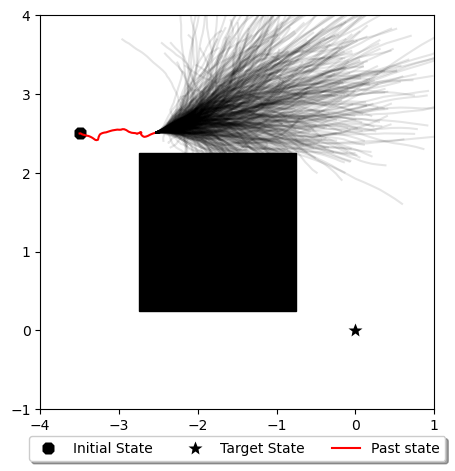

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


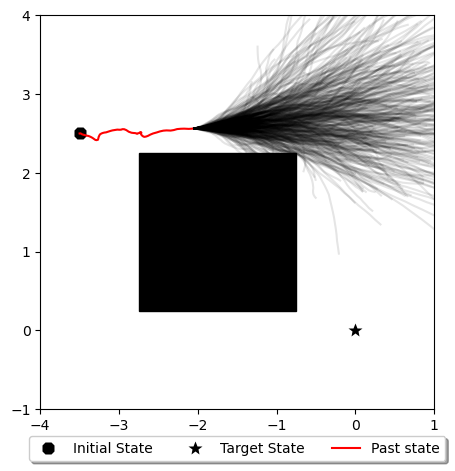

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


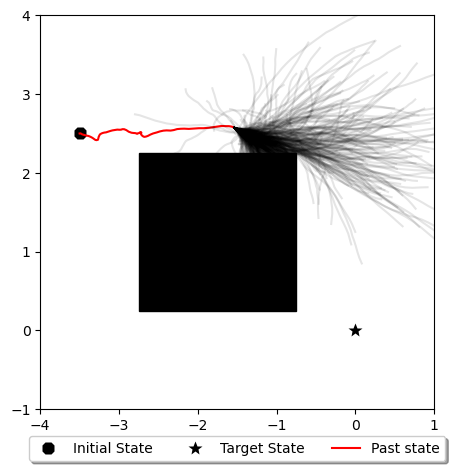

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


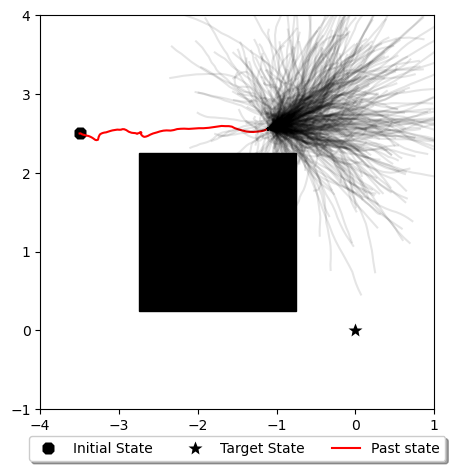

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


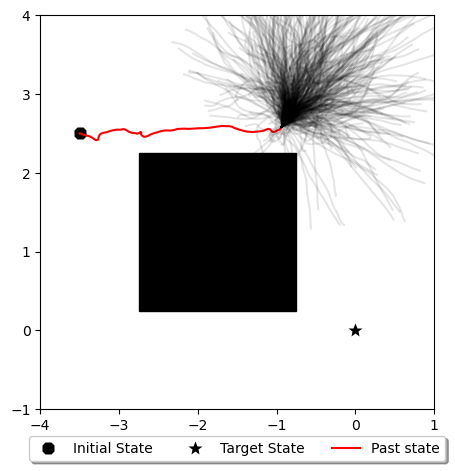

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


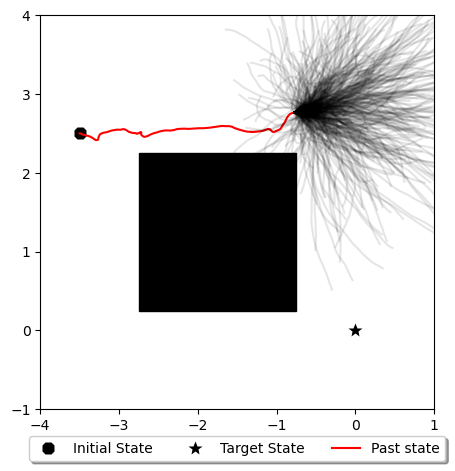

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


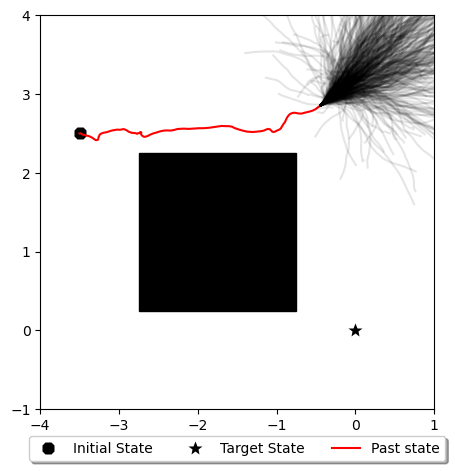

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


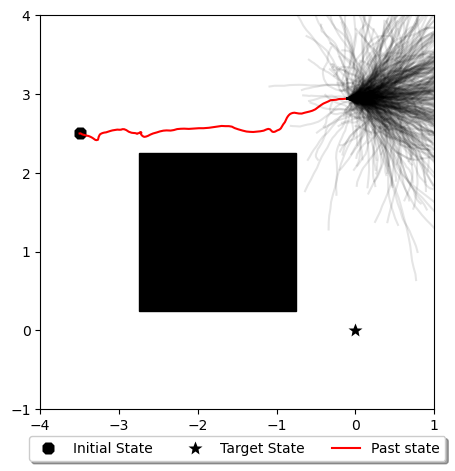

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


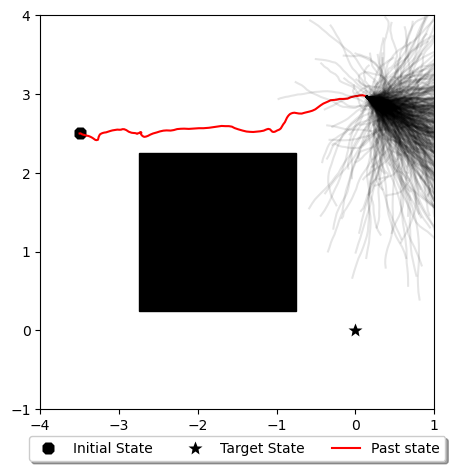

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


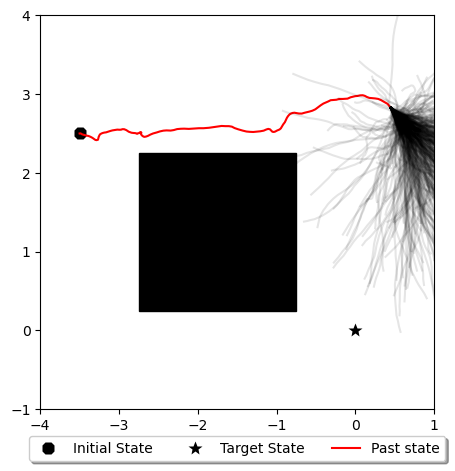

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


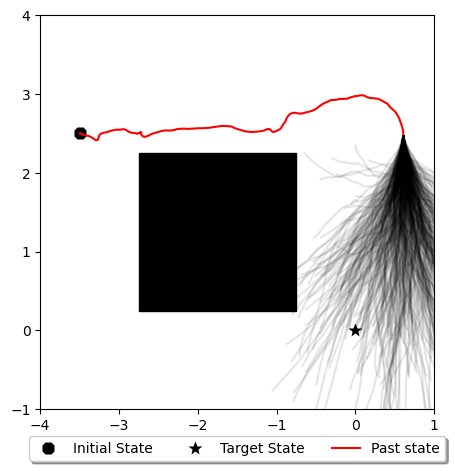

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


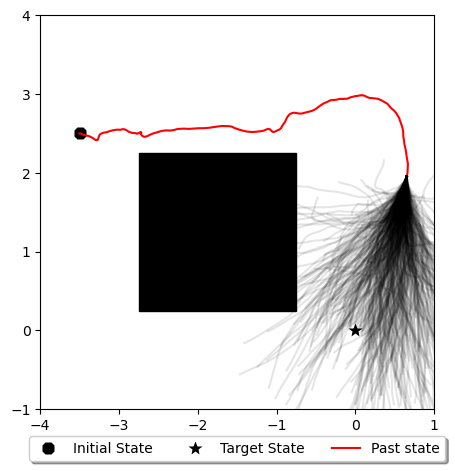

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


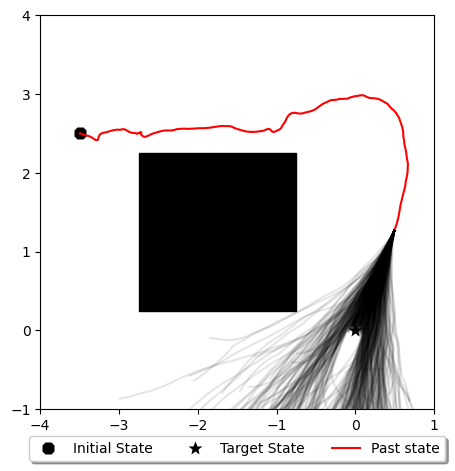

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


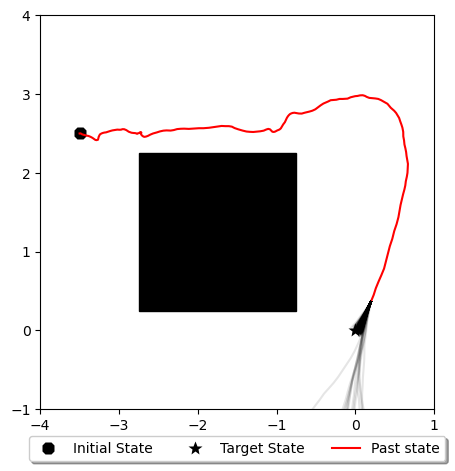

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -0.0002423126583325983. Stopping optimization.
Desired threshold reached with value -4.329509333720876e-05. Stopping optimization.
Goal reached at t=9.20s
Desired threshold reached with value -inf. Stopping optimization.


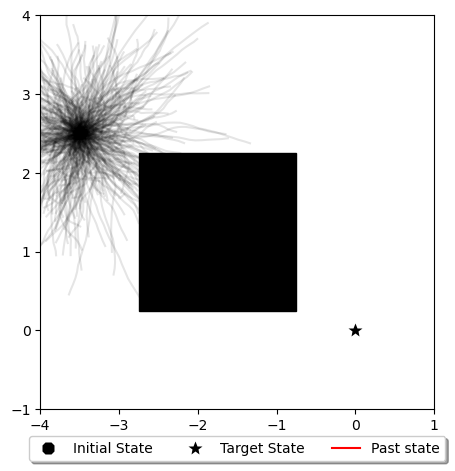

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


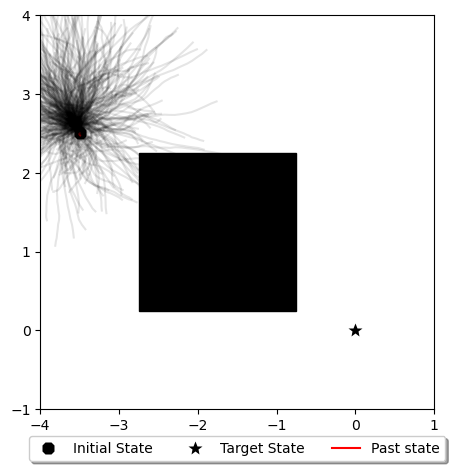

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


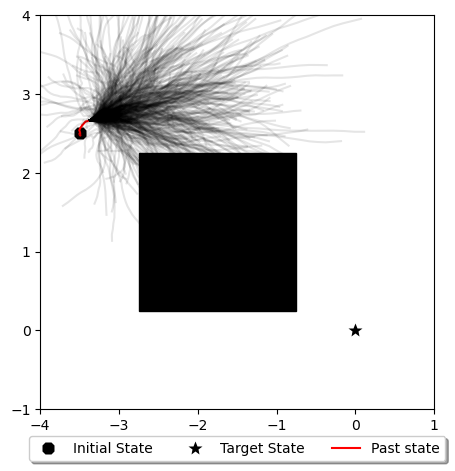

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


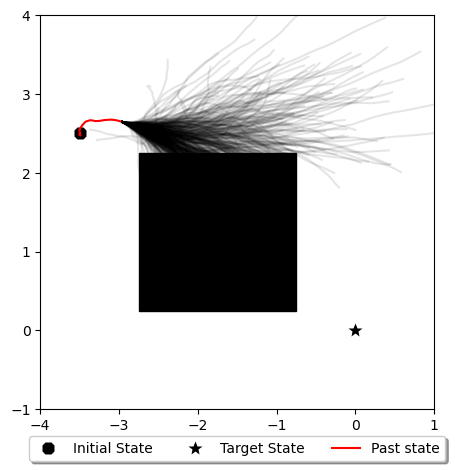

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


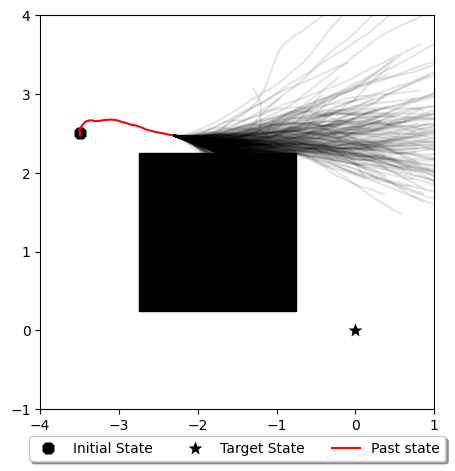

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


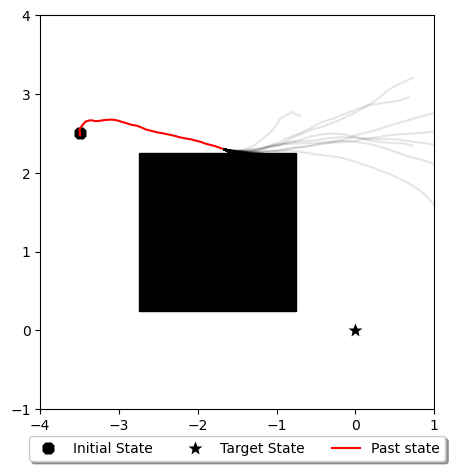

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


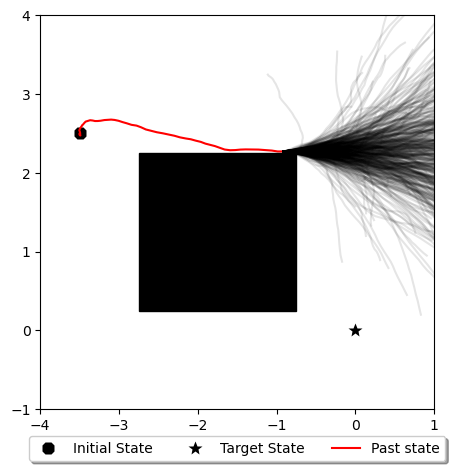

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


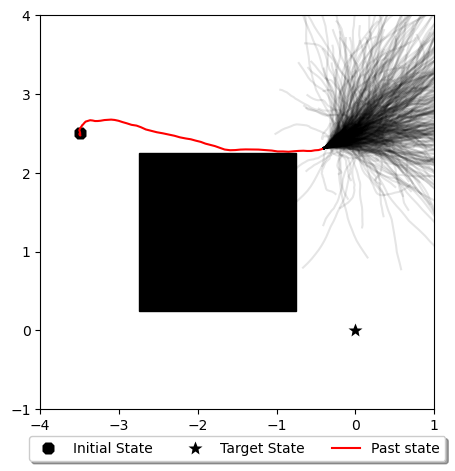

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


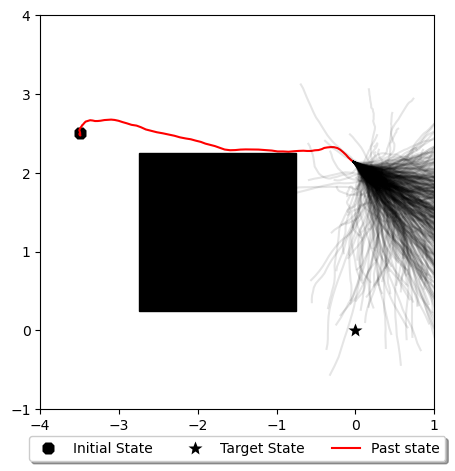

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


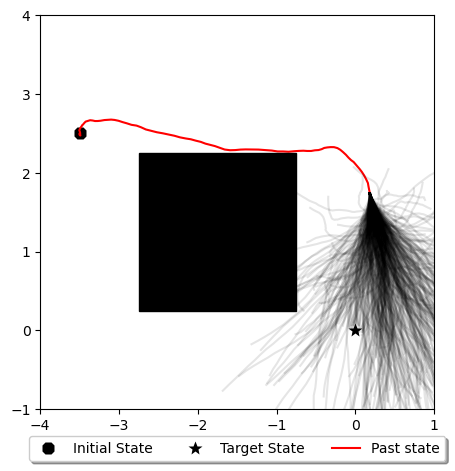

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


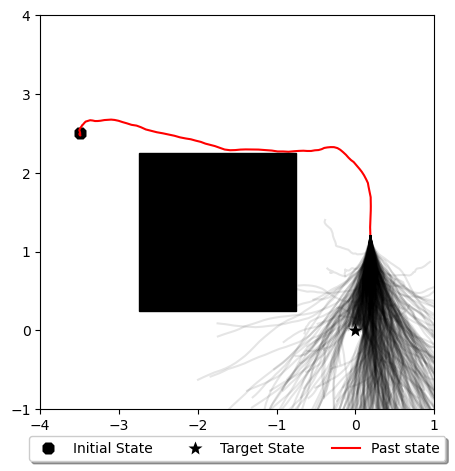

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


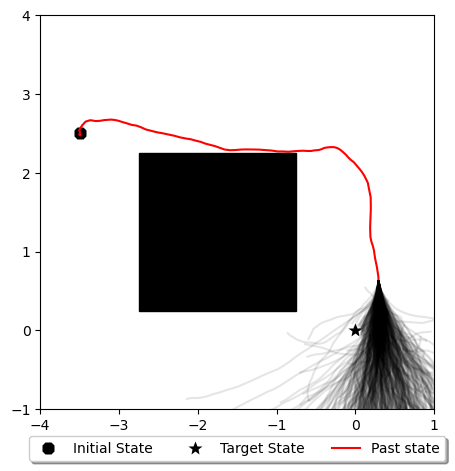

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


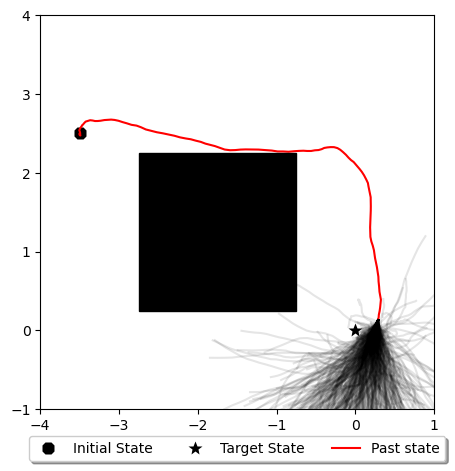

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


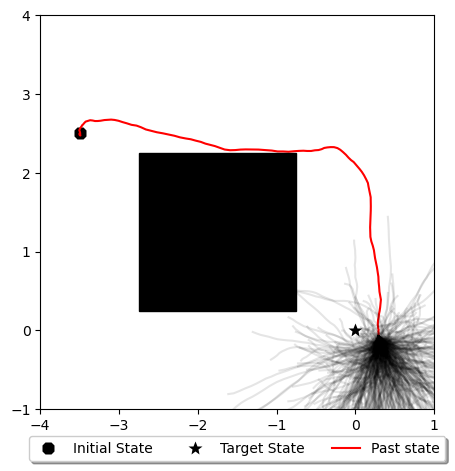

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


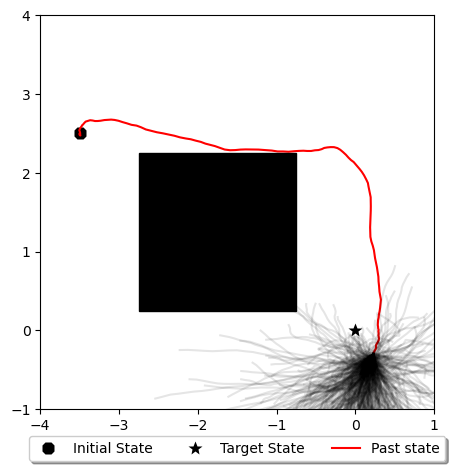

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


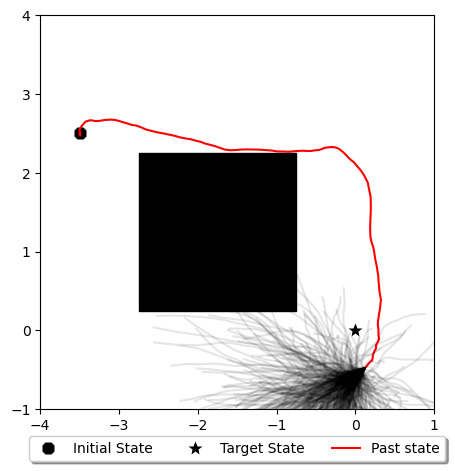

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


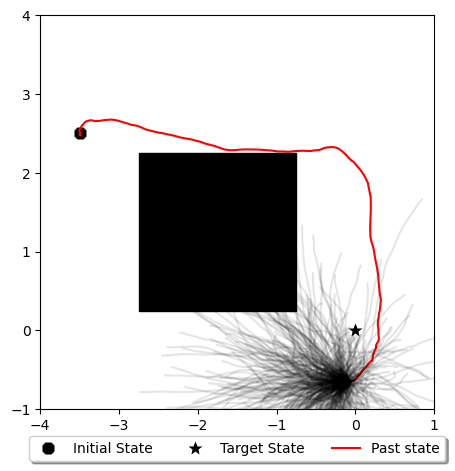

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


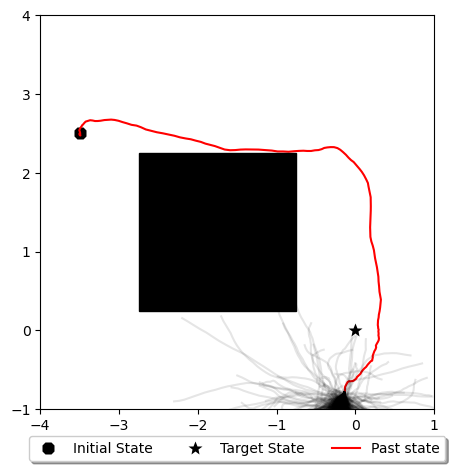

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


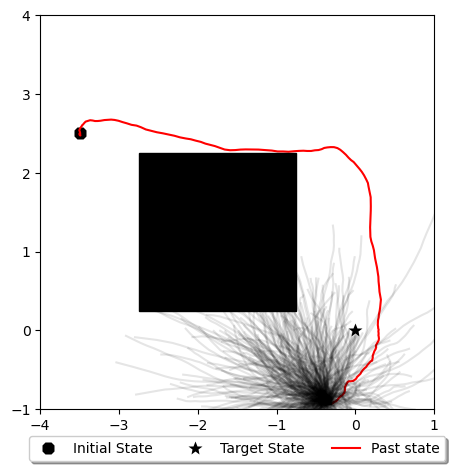

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


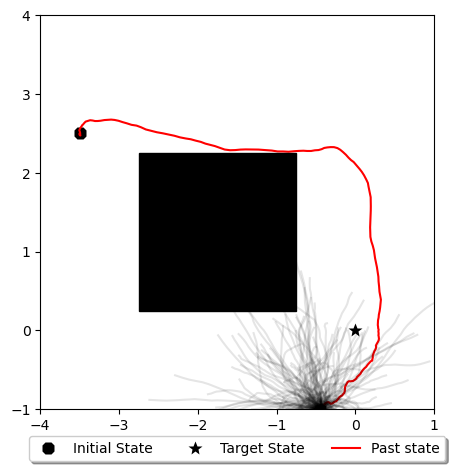

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


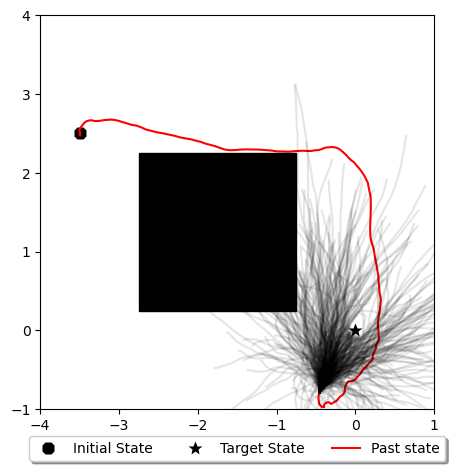

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


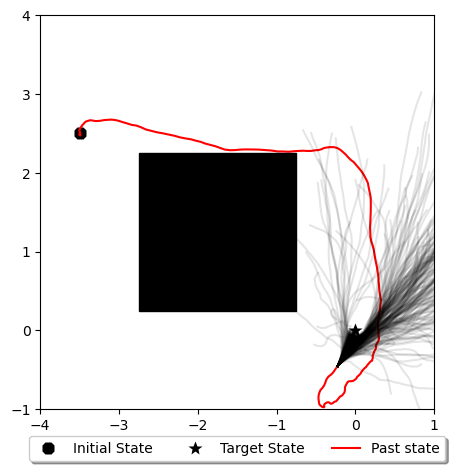

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -0.0006500840803488488. Stopping optimization.
Desired threshold reached with value -0.00027681345026518955. Stopping optimization.
Desired threshold reached with value -6.333283482775938e-05. Stopping optimization.
Goal reached at t=10.90s
Desired threshold reached with value -inf. Stopping optimization.


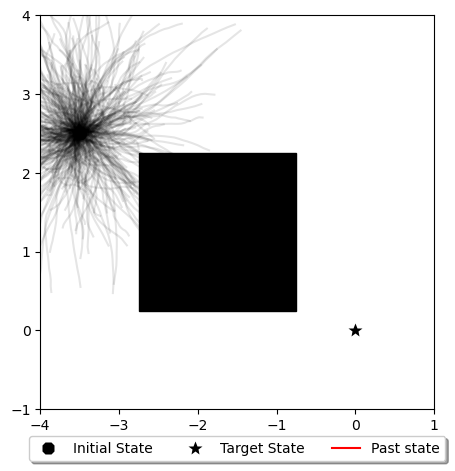

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


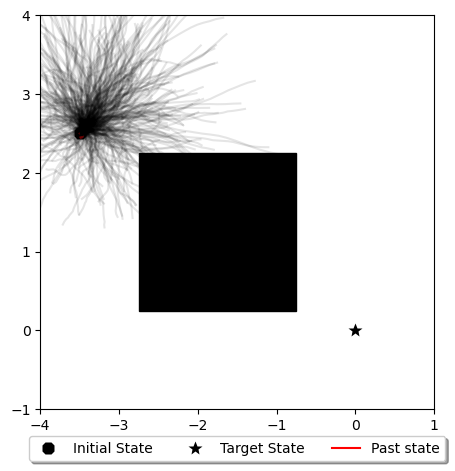

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


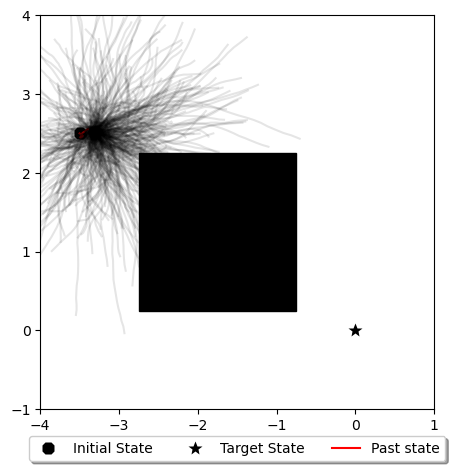

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


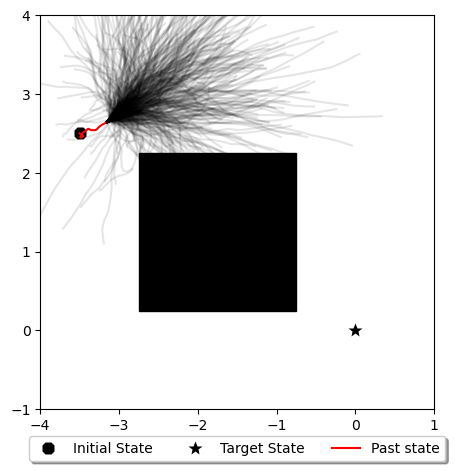

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


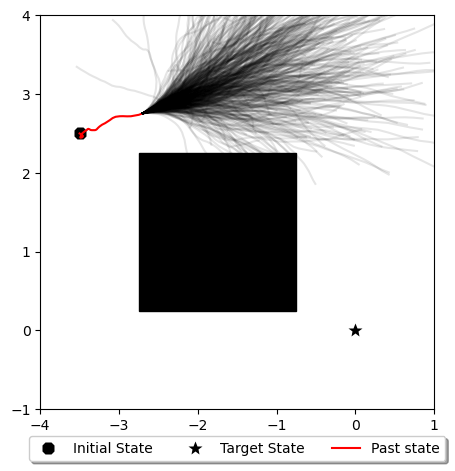

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


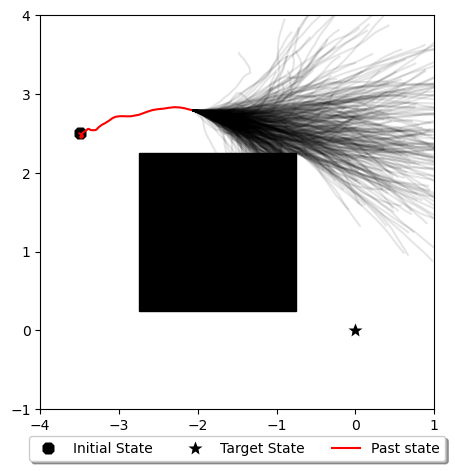

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


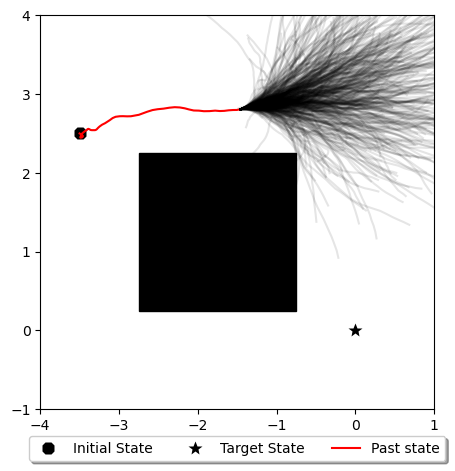

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


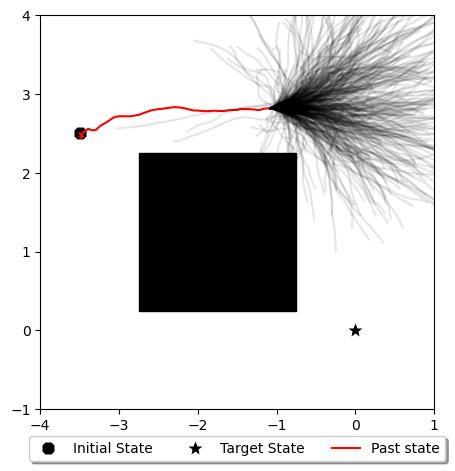

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


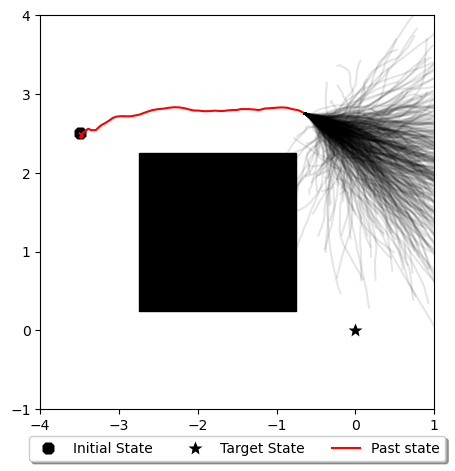

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


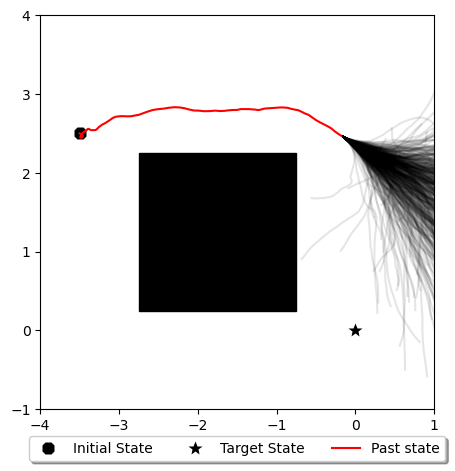

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


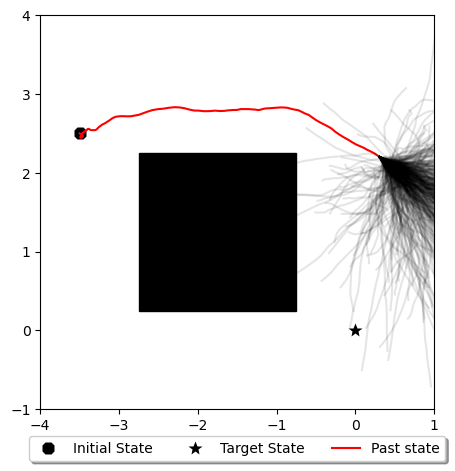

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


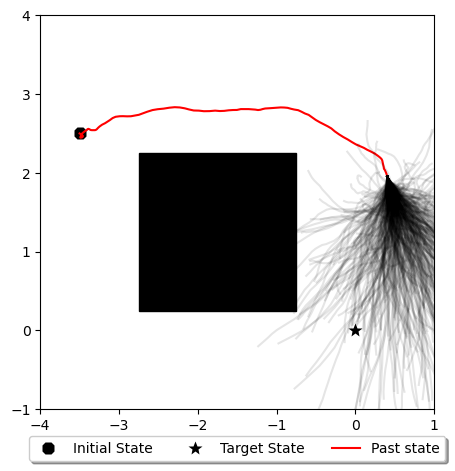

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


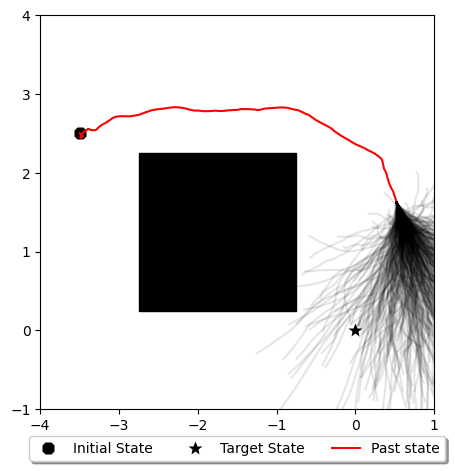

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


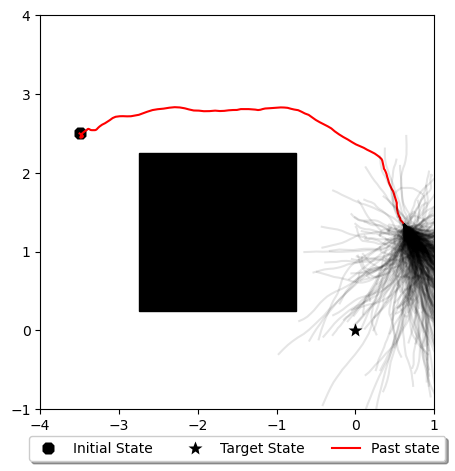

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


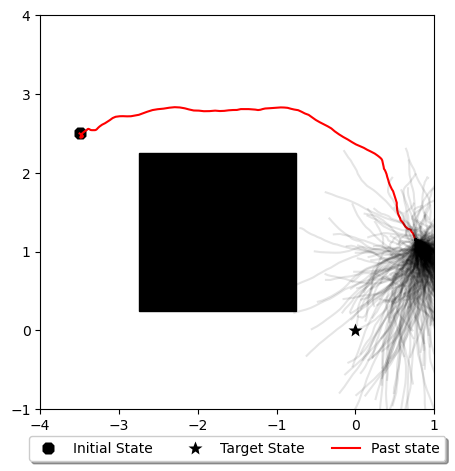

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


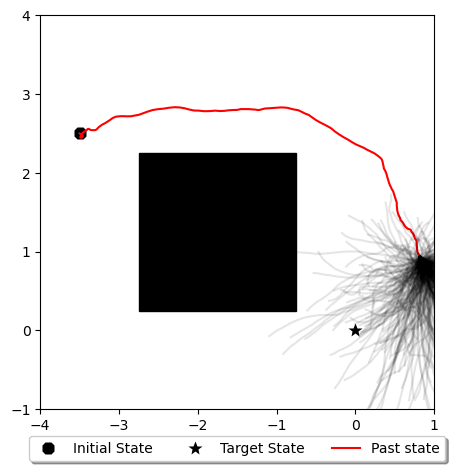

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


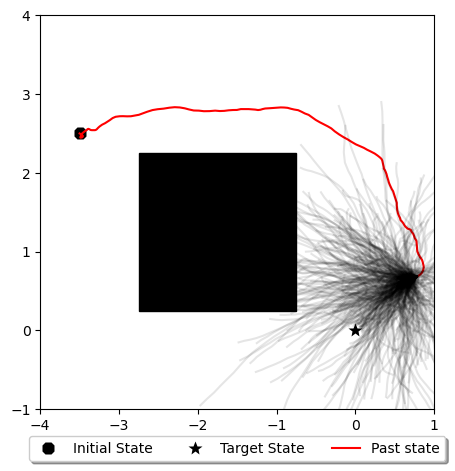

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


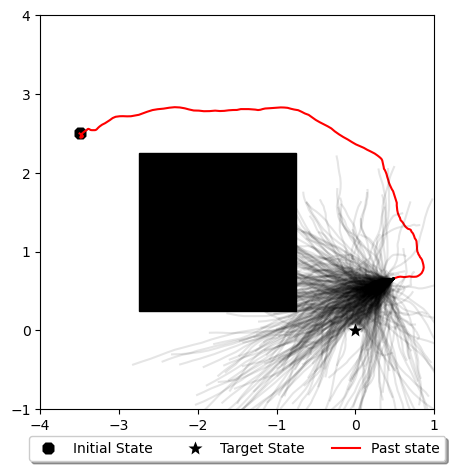

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


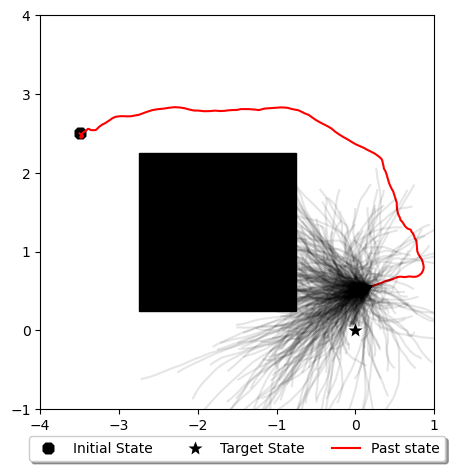

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


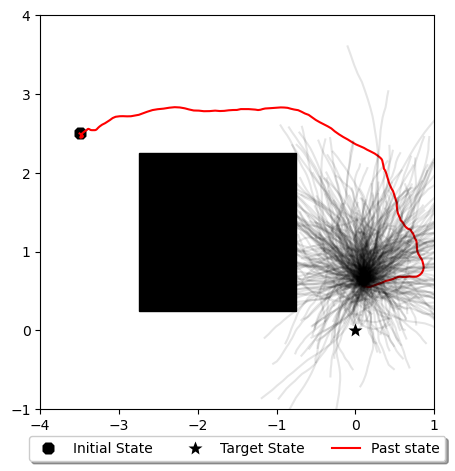

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


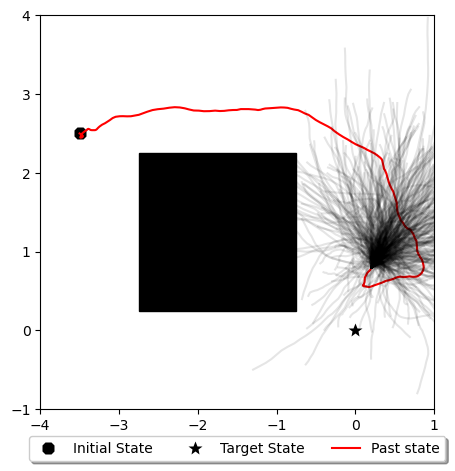

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


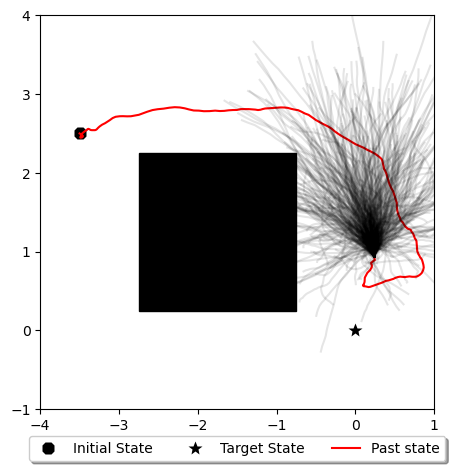

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


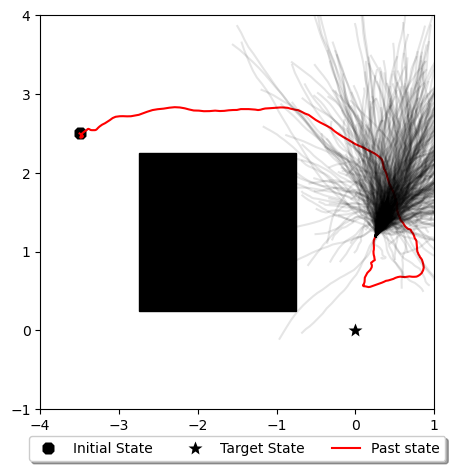

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


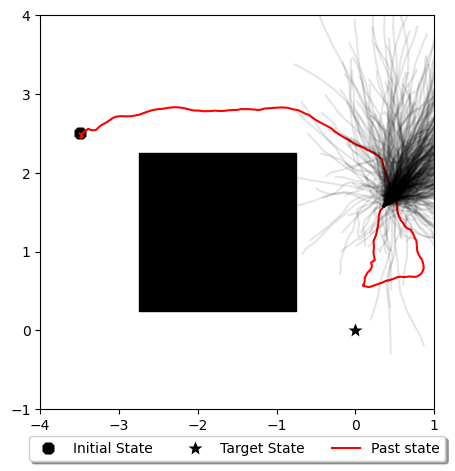

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


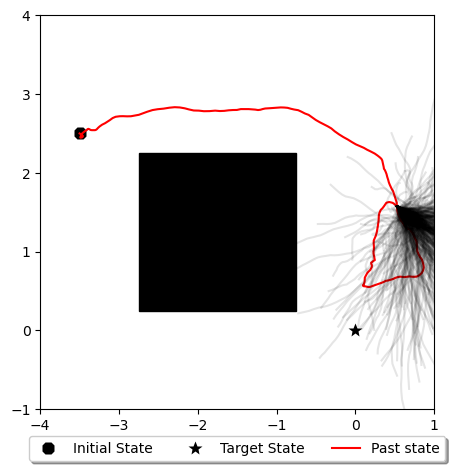

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


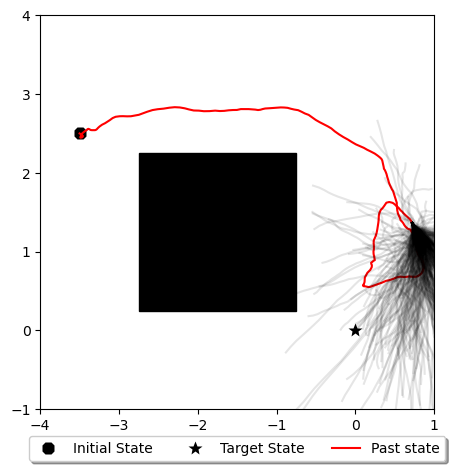

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


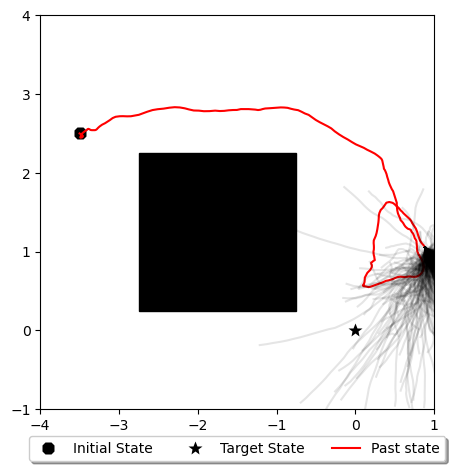

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


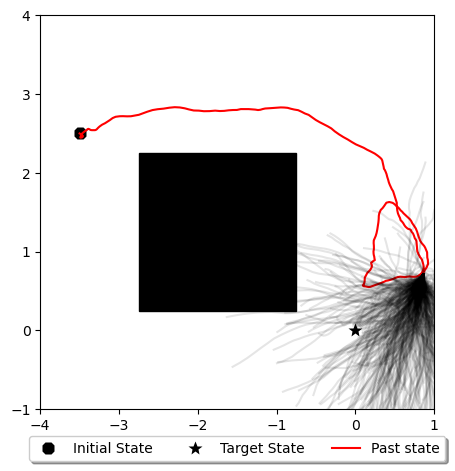

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


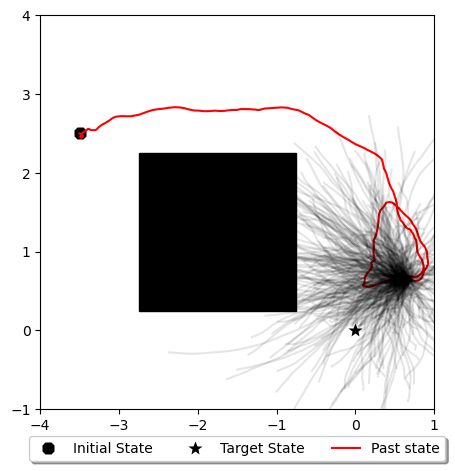

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


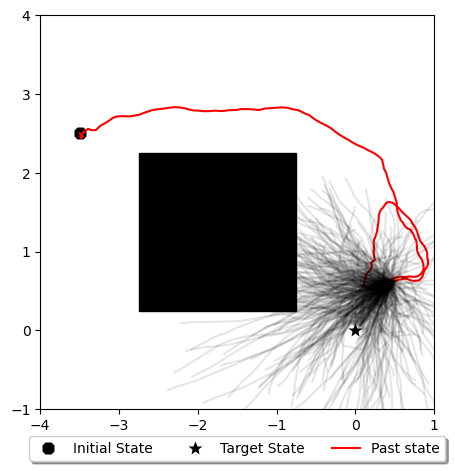

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


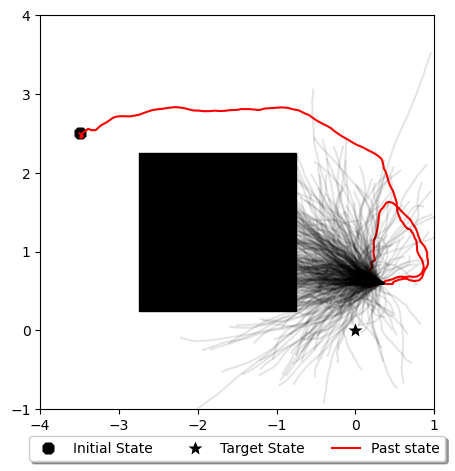

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


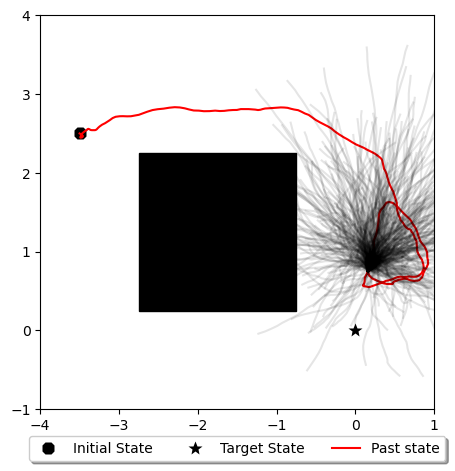

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


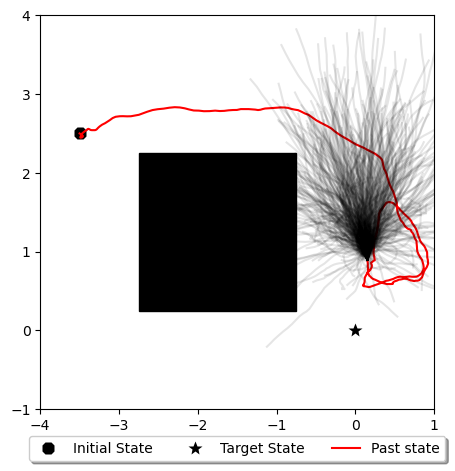

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


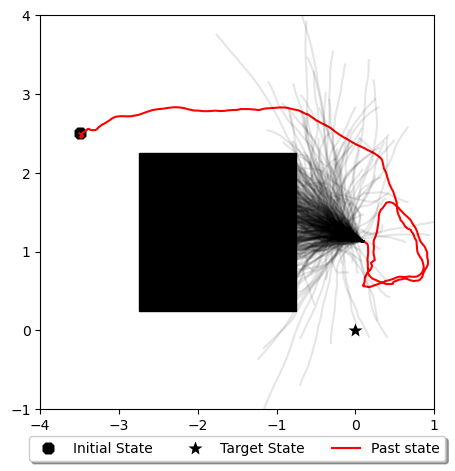

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


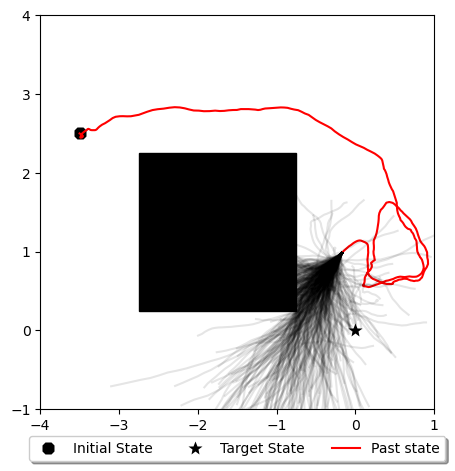

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


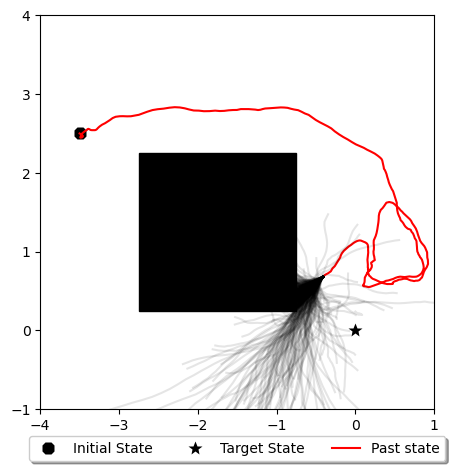

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


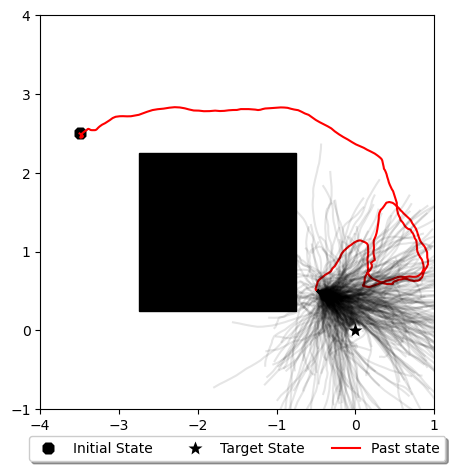

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


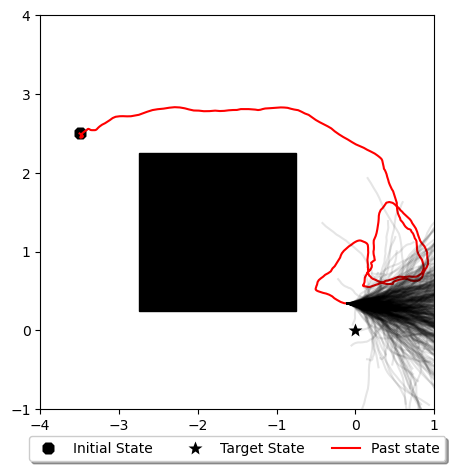

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


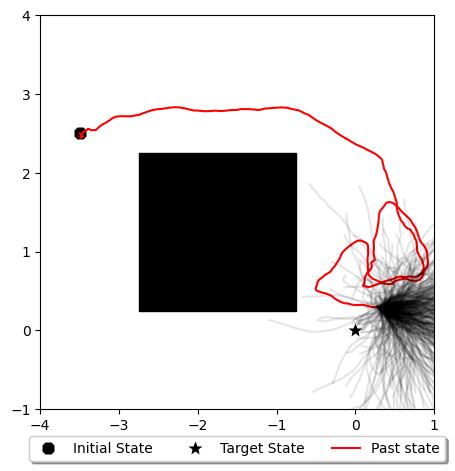

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


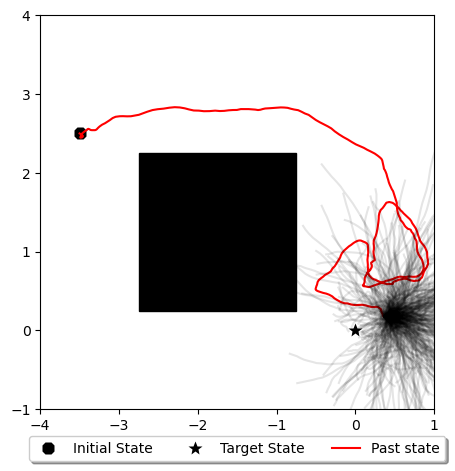

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


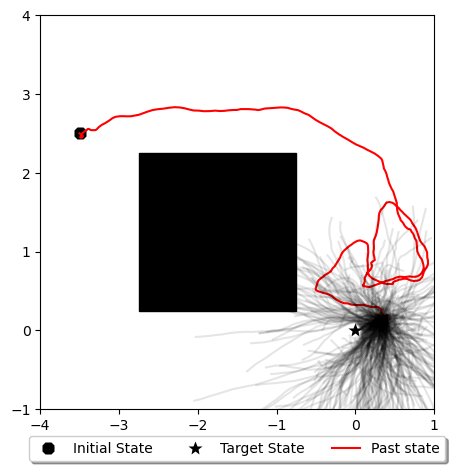

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


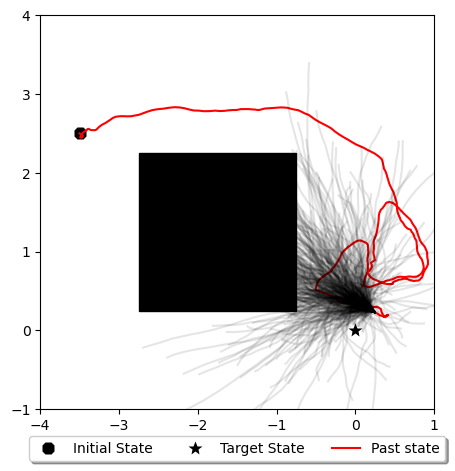

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


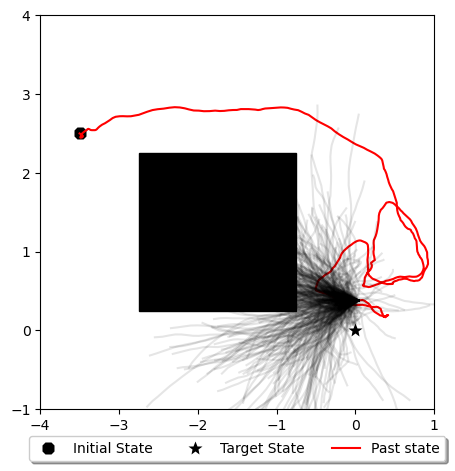

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


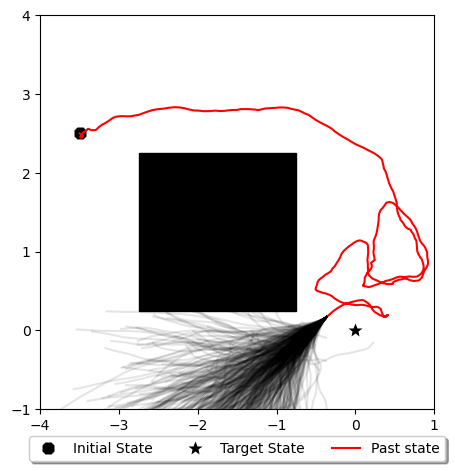

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


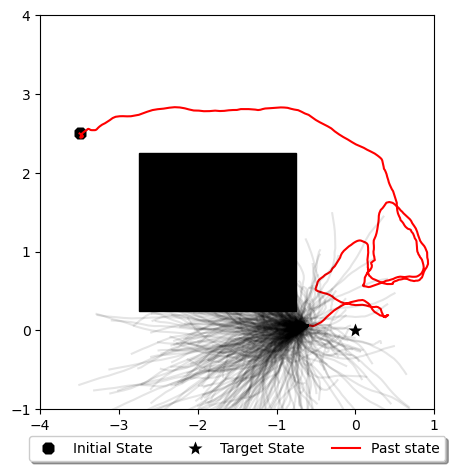

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


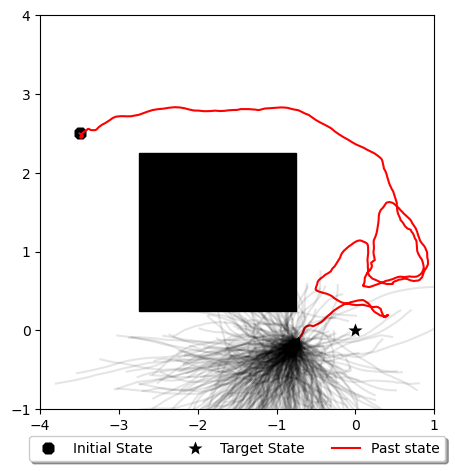

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


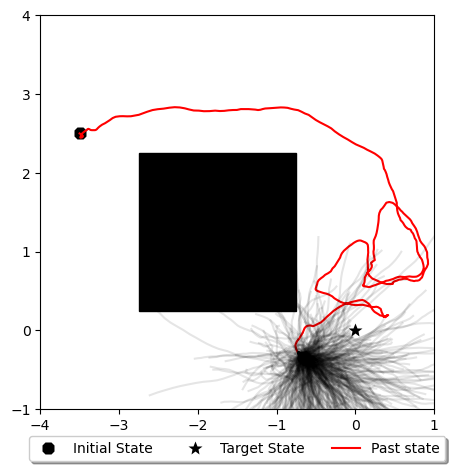

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


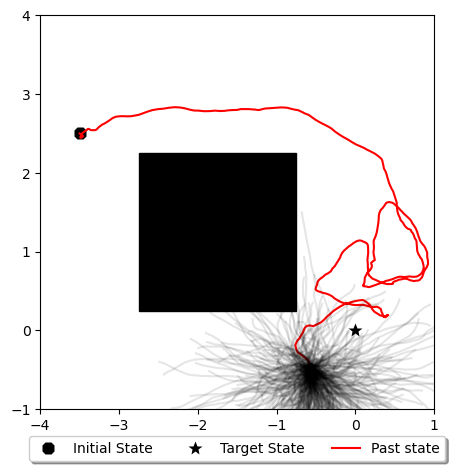

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


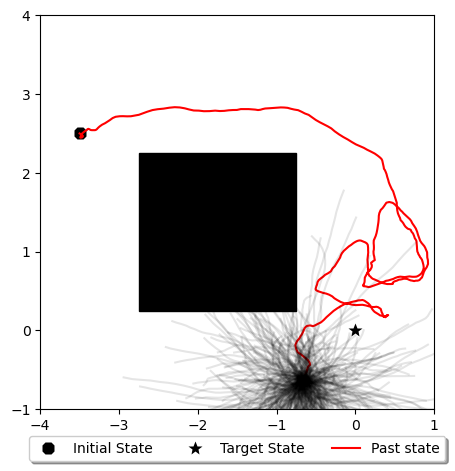

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


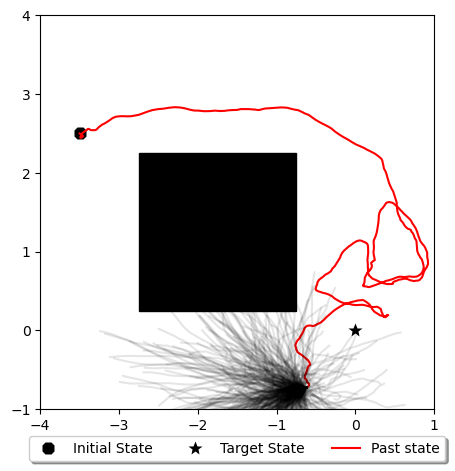

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


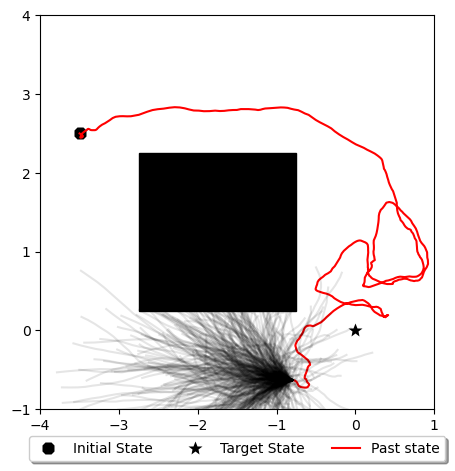

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


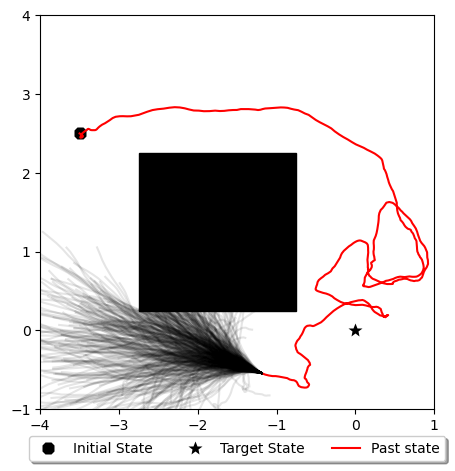

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


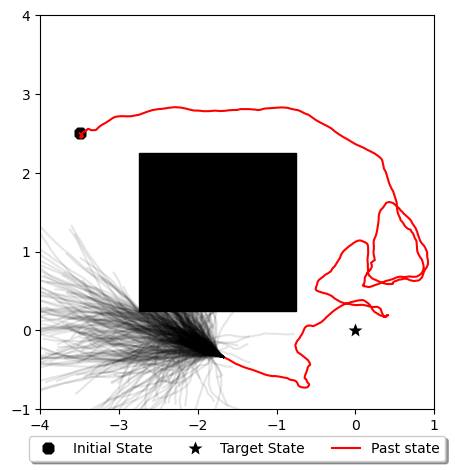

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


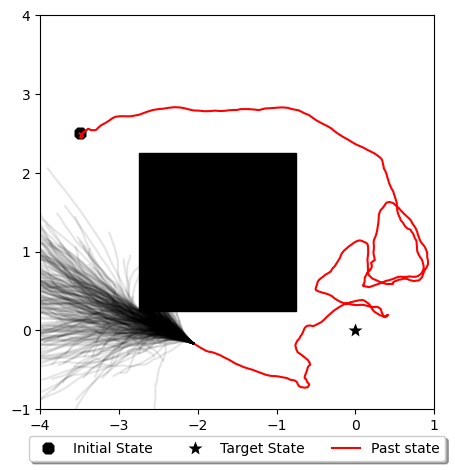

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


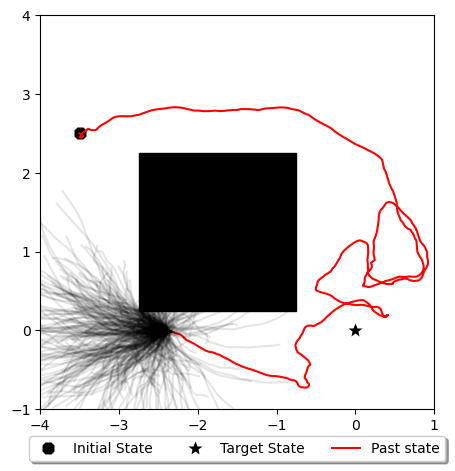

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


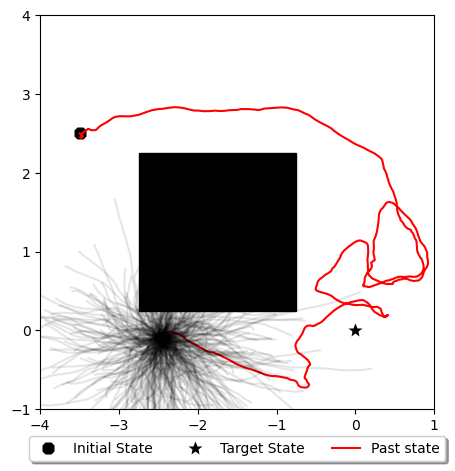

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


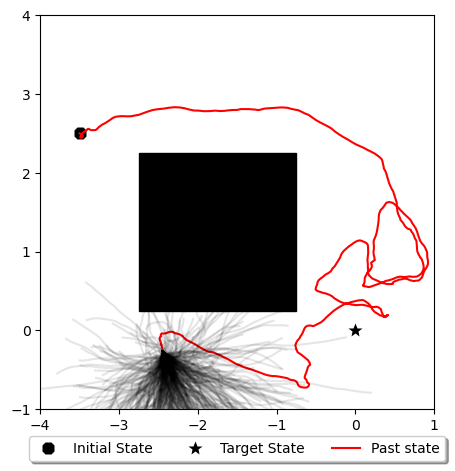

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


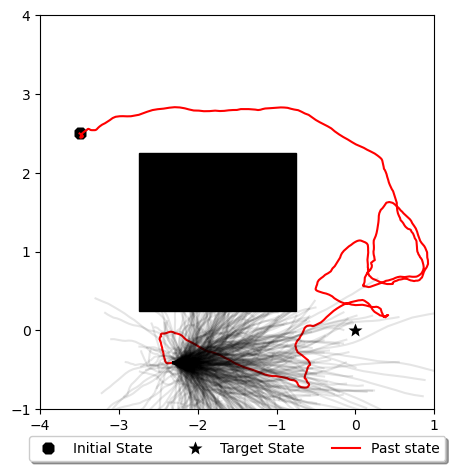

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


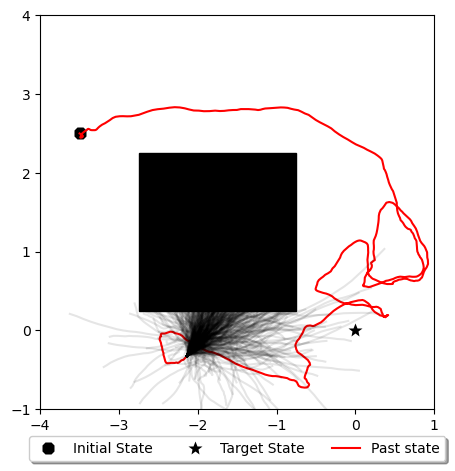

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


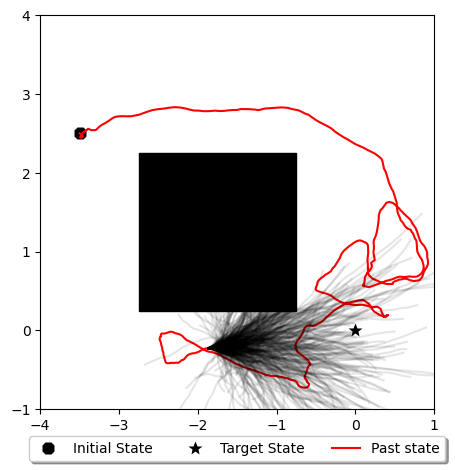

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


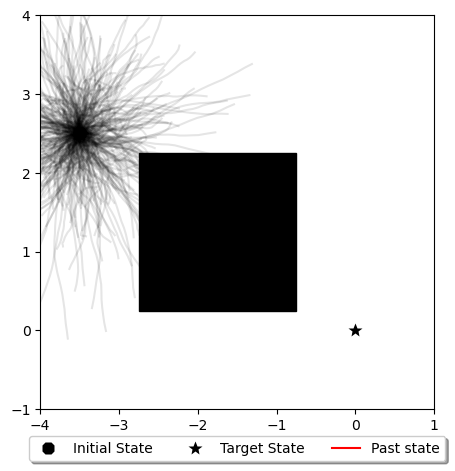

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


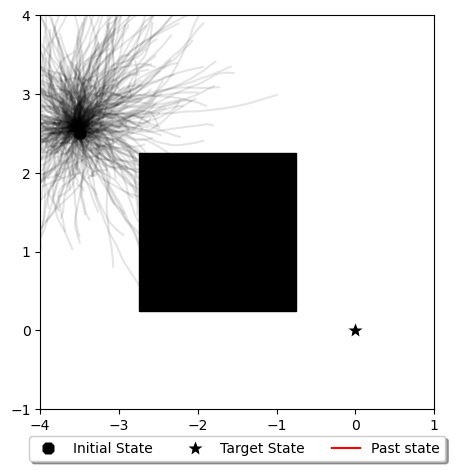

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


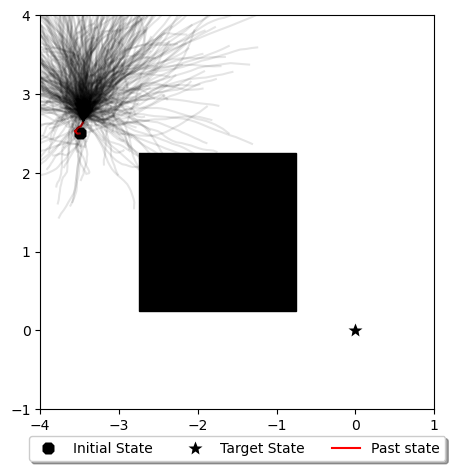

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


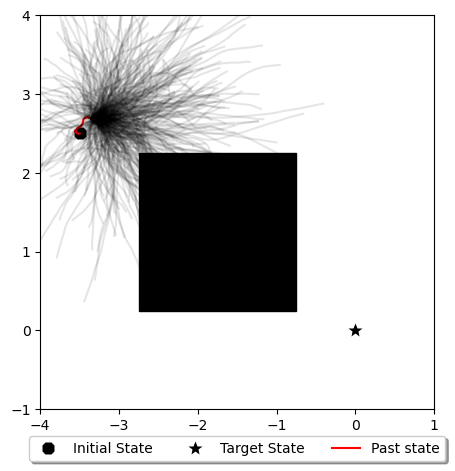

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


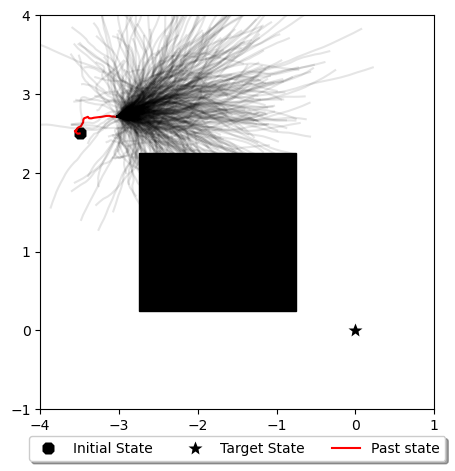

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


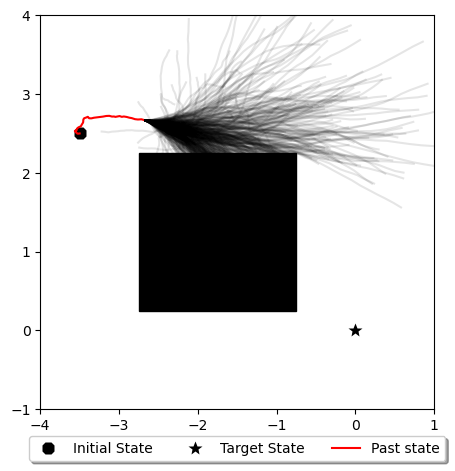

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


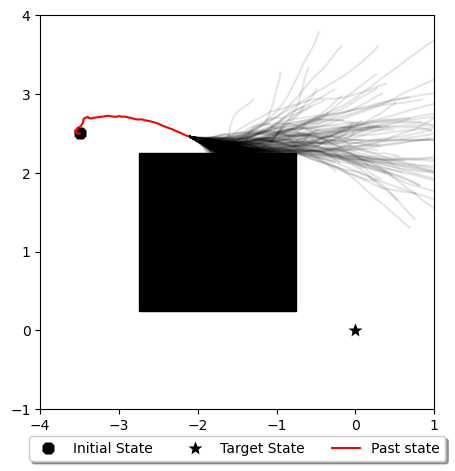

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


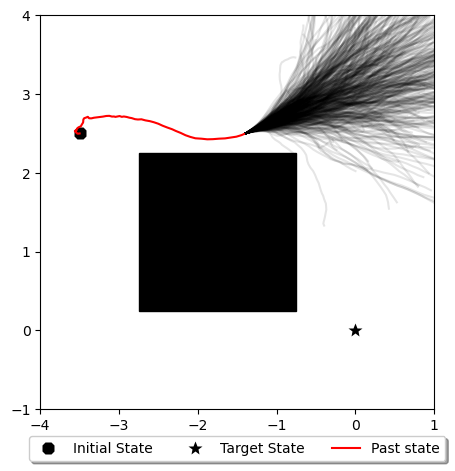

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


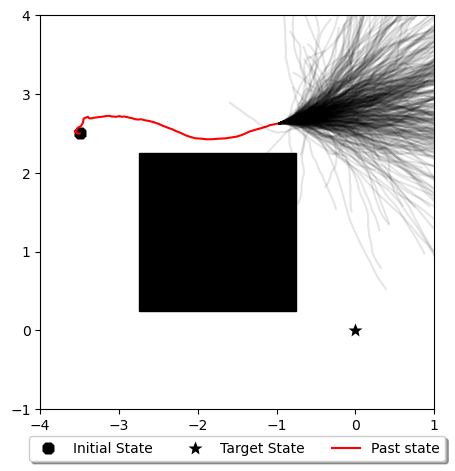

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


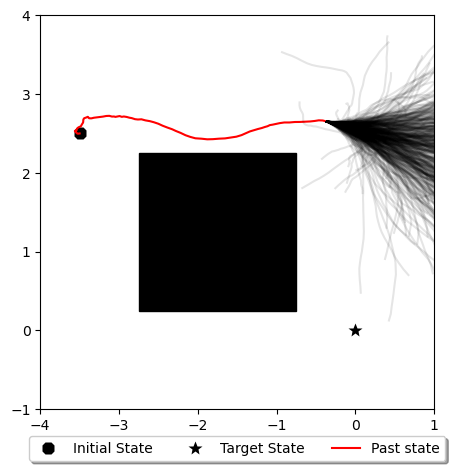

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


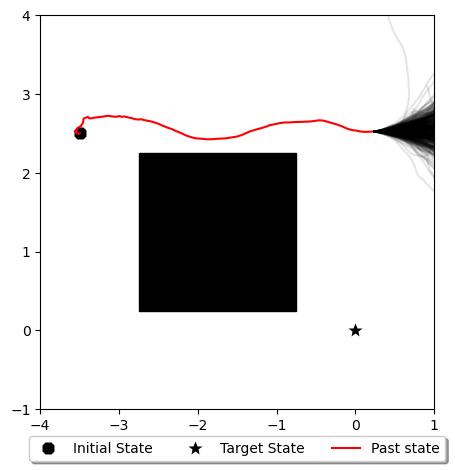

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


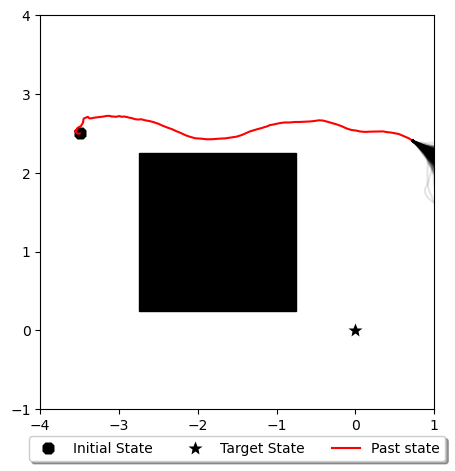

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Hit boundary
Desired threshold reached with value -inf. Stopping optimization.


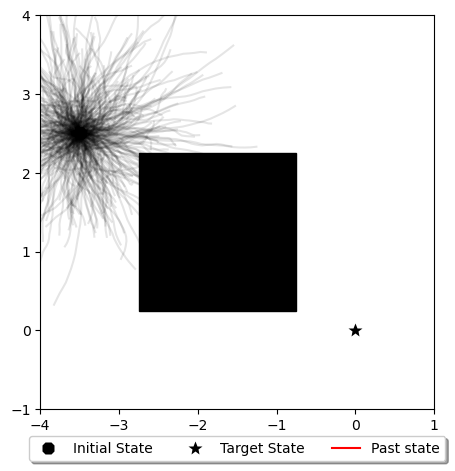

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


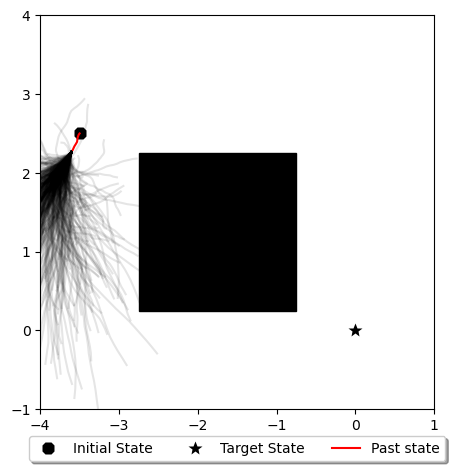

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


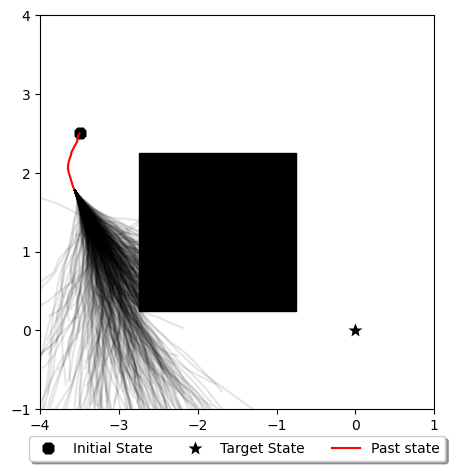

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


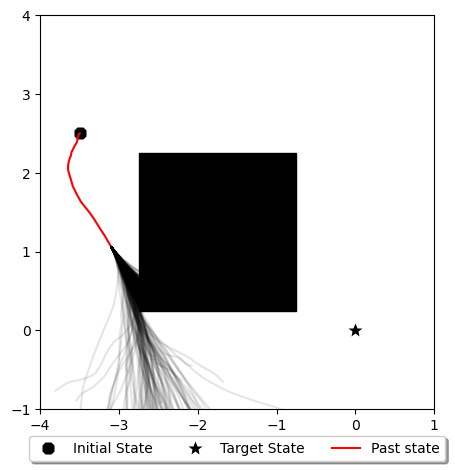

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


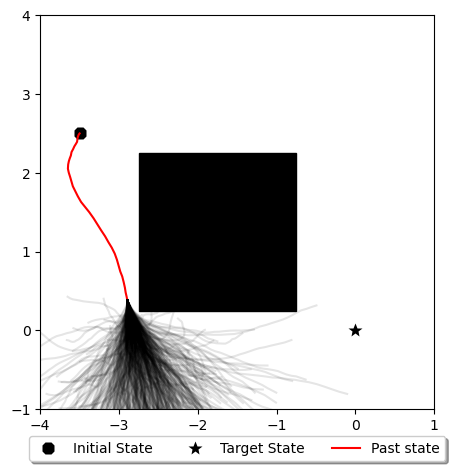

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


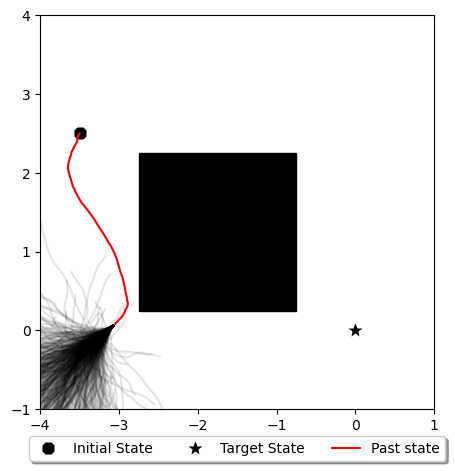

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


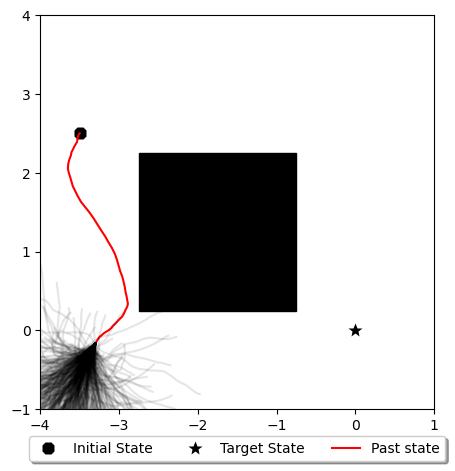

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


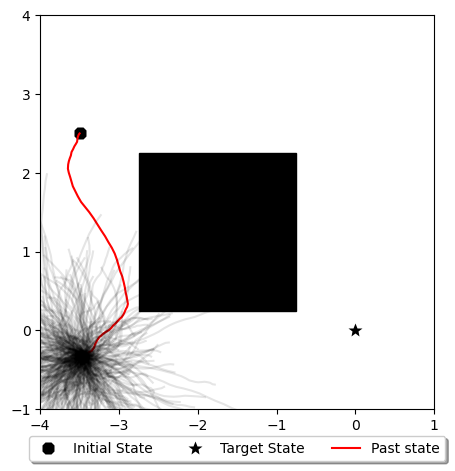

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


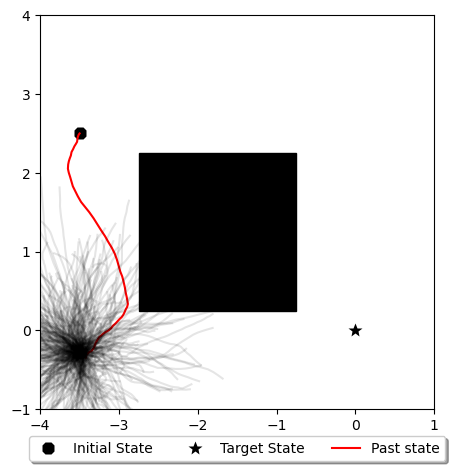

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


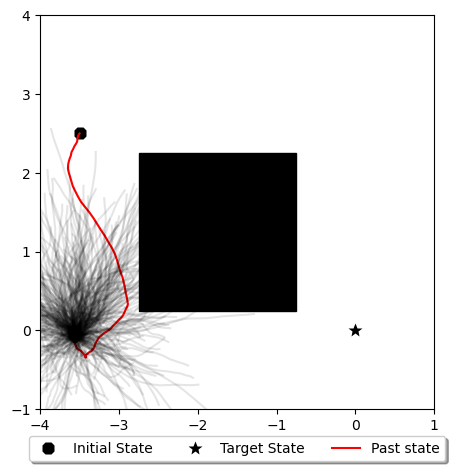

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


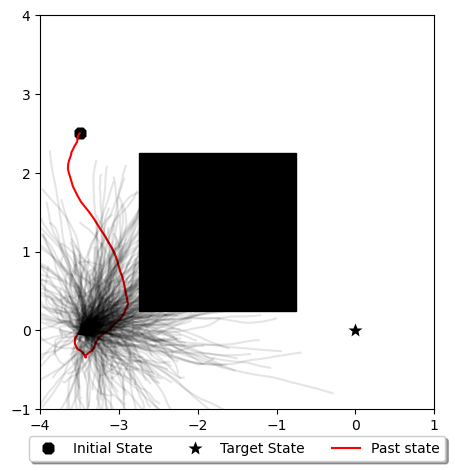

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


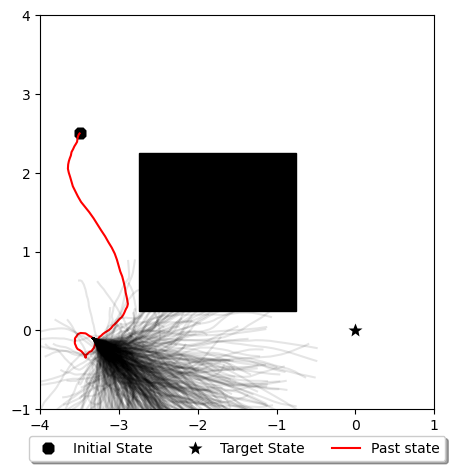

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


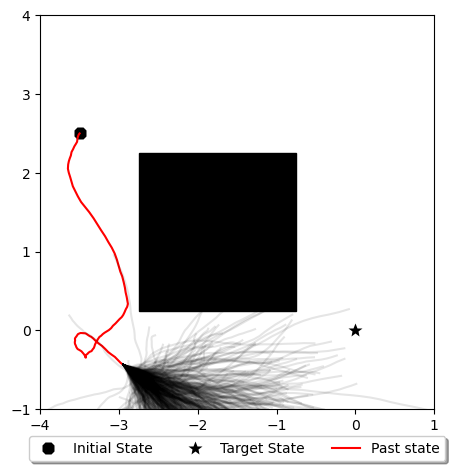

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


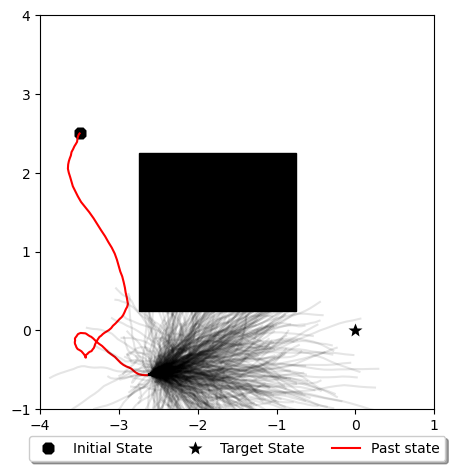

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


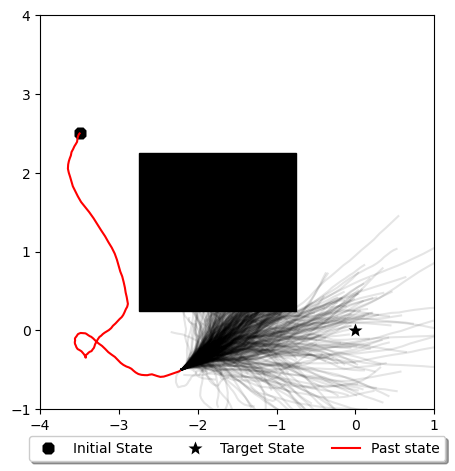

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


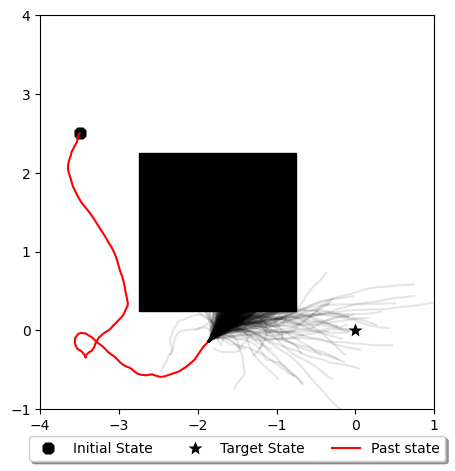

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


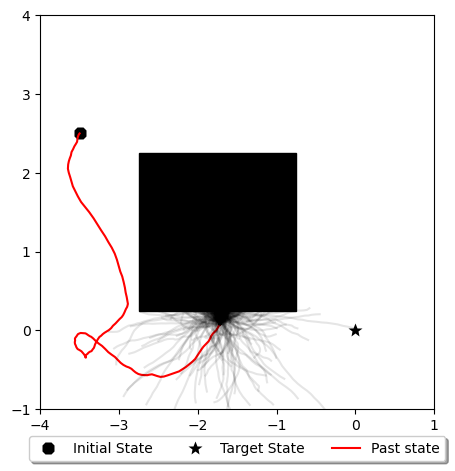

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


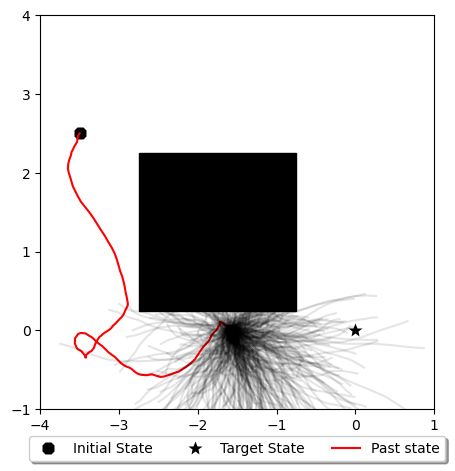

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


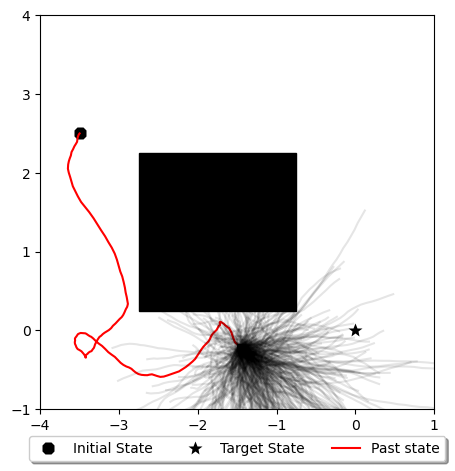

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


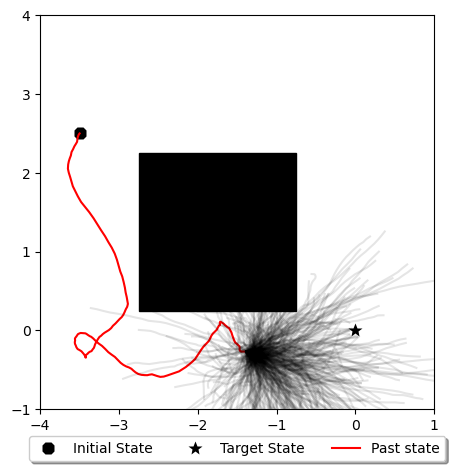

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


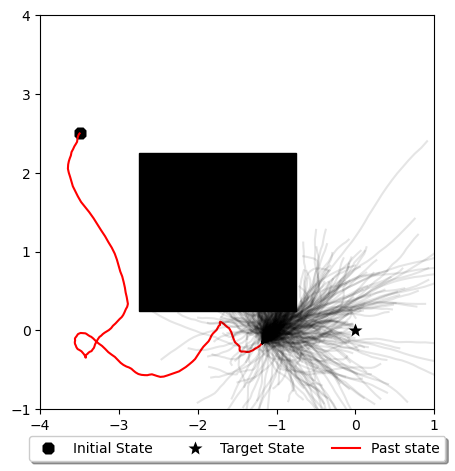

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


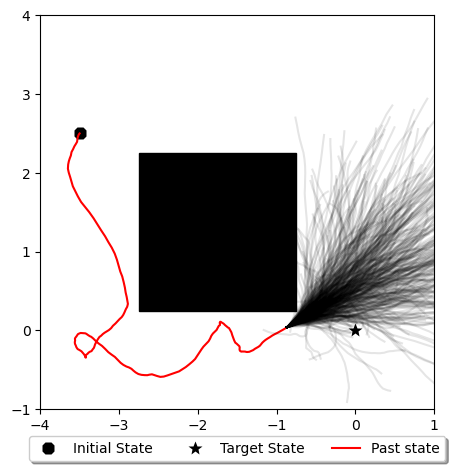

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


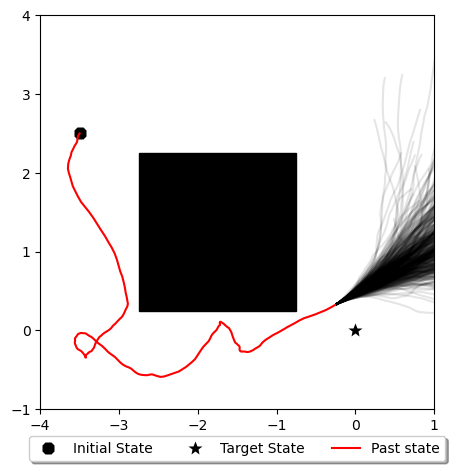

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


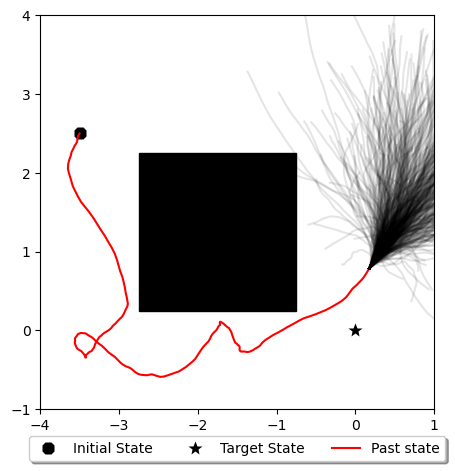

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


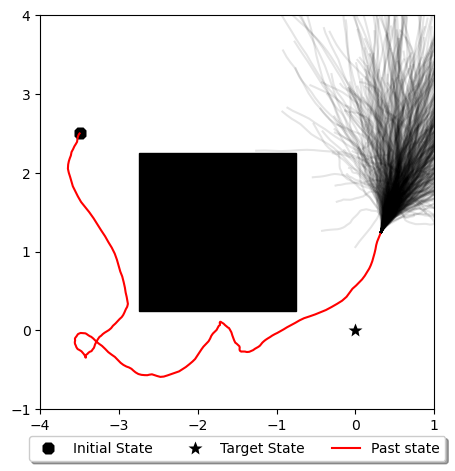

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


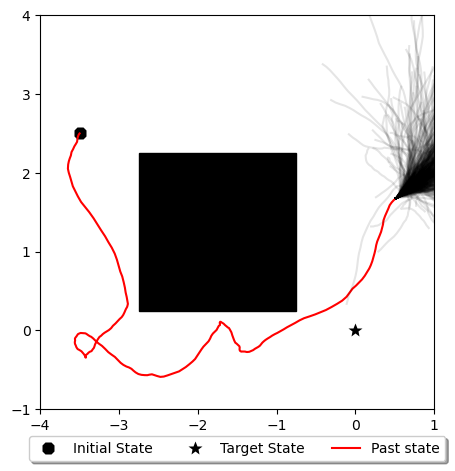

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


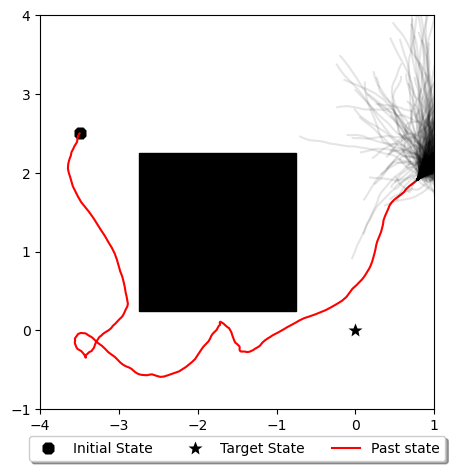

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


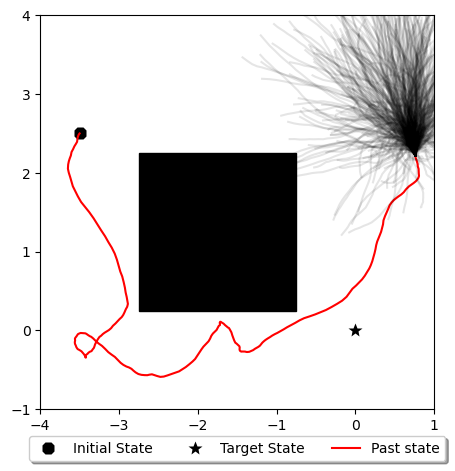

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


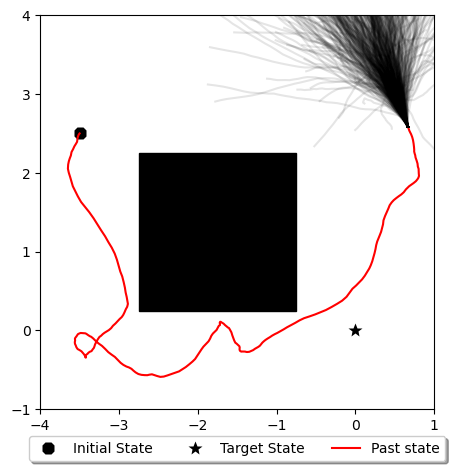

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


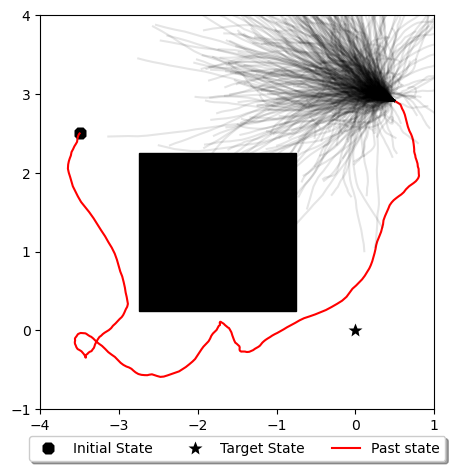

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


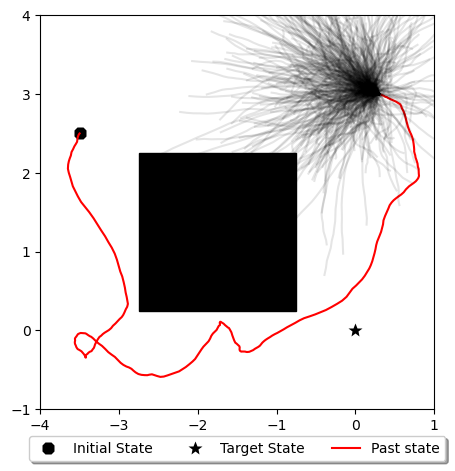

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


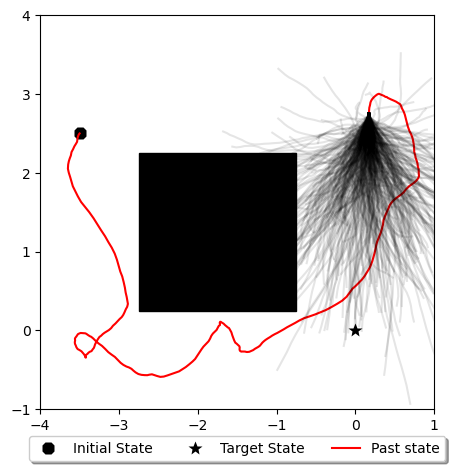

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


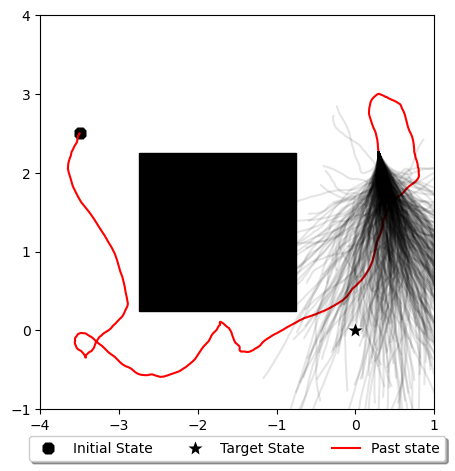

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


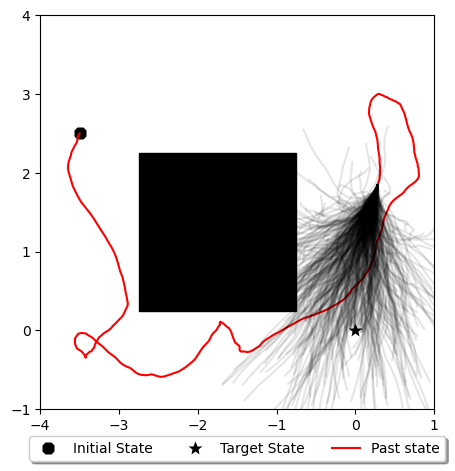

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


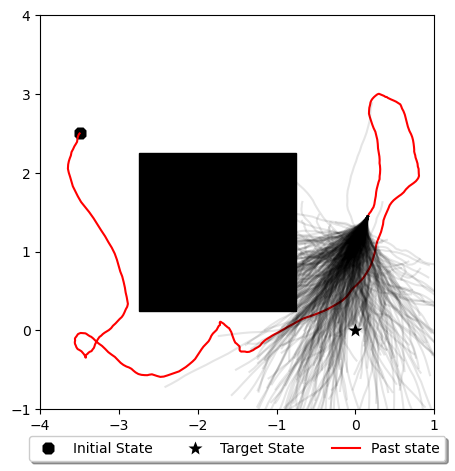

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


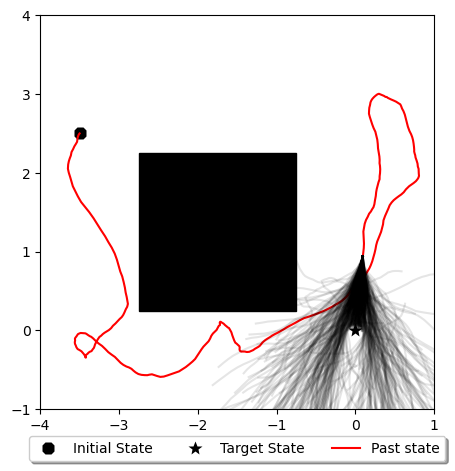

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


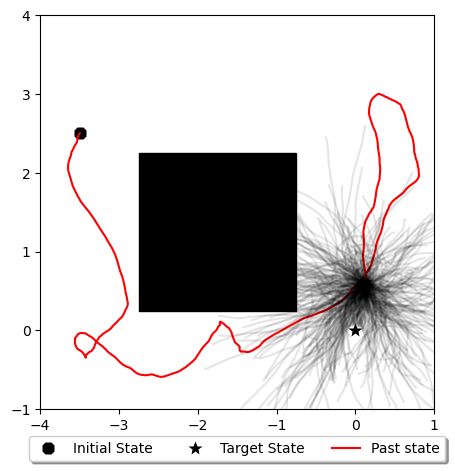

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


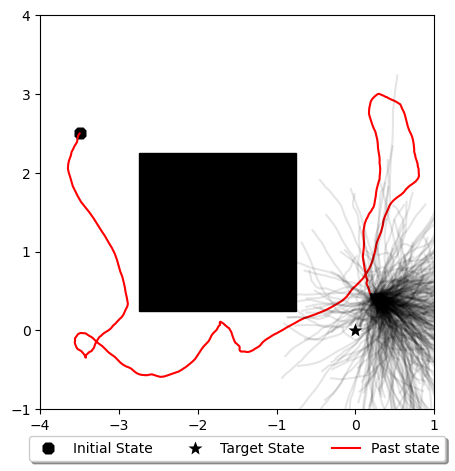

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


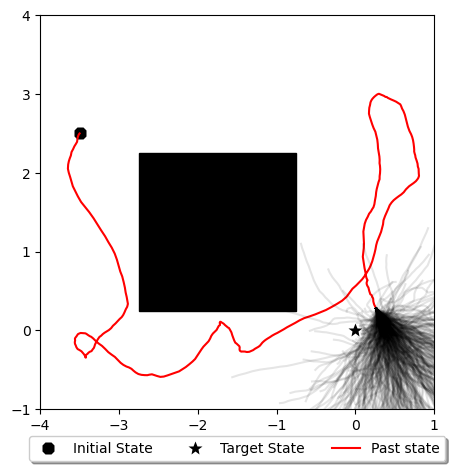

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


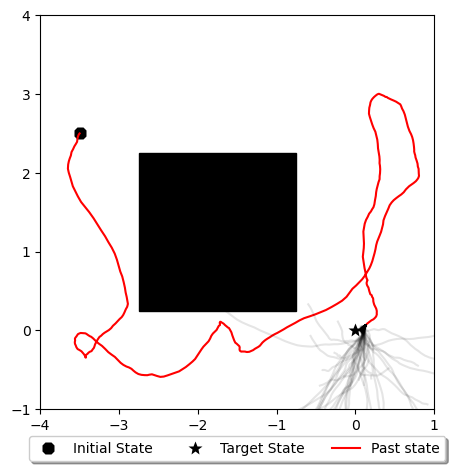

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -8.1651573362134e-05. Stopping optimization.
Goal reached at t=19.60s
Desired threshold reached with value -inf. Stopping optimization.


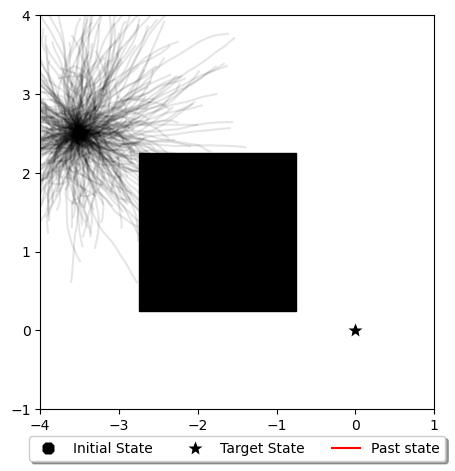

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


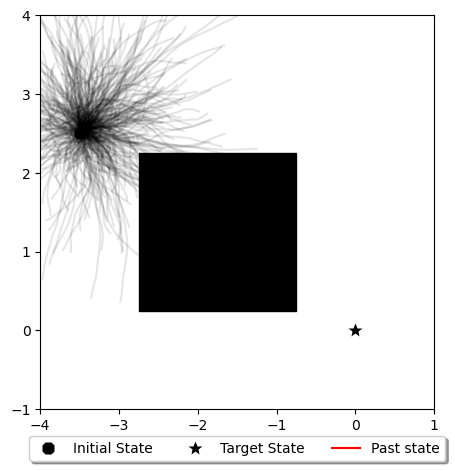

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


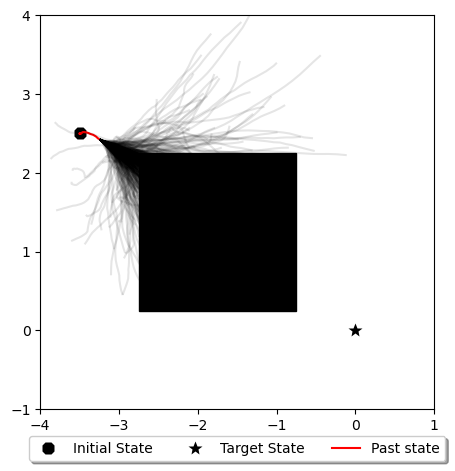

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


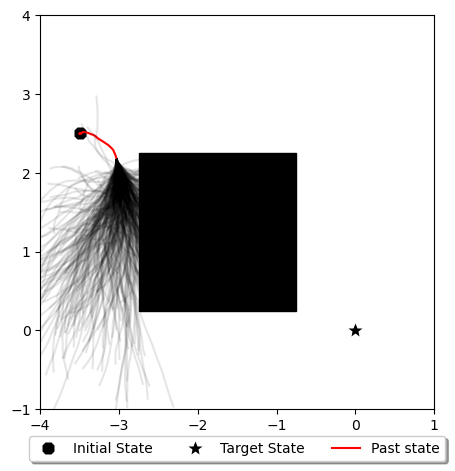

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


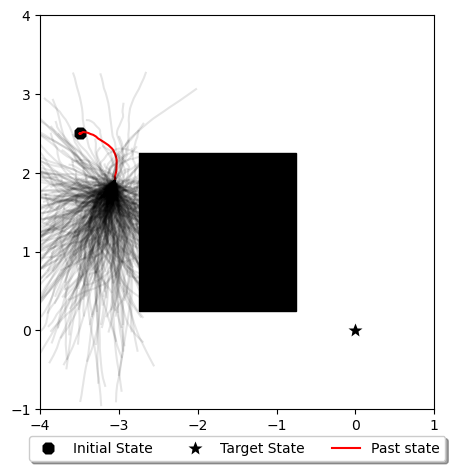

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


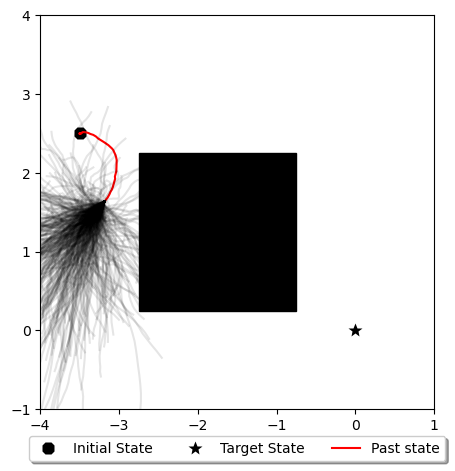

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


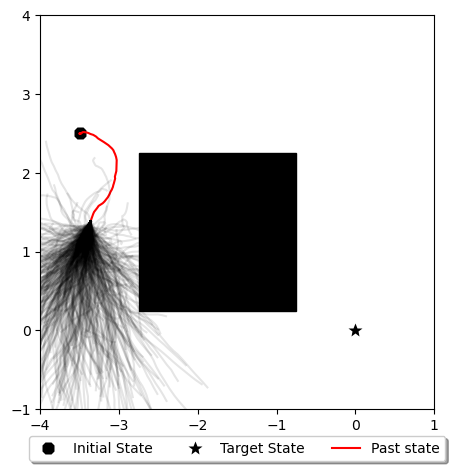

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


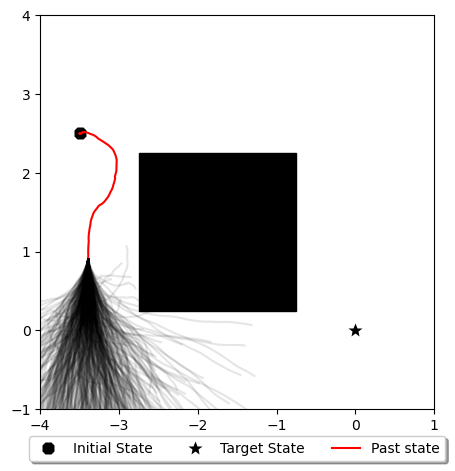

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


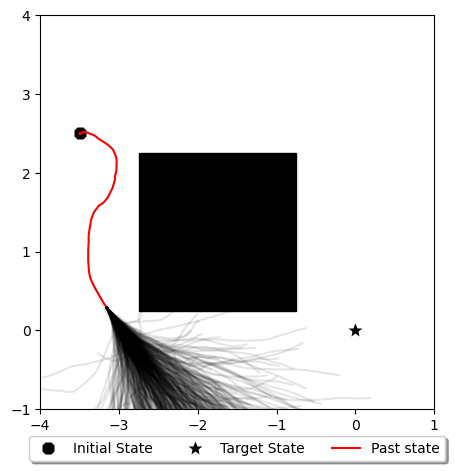

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


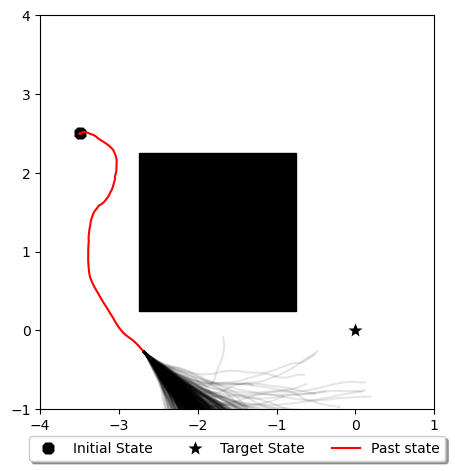

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


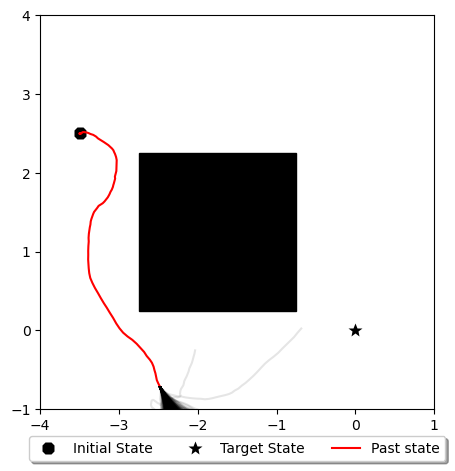

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


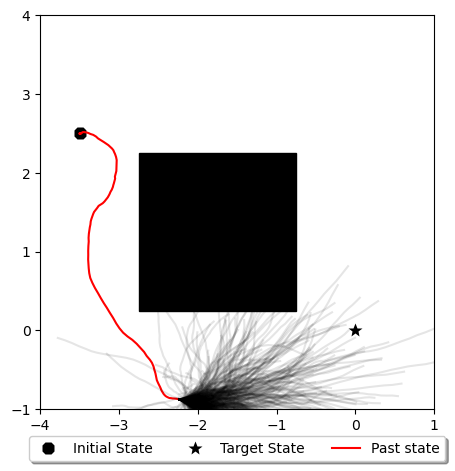

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


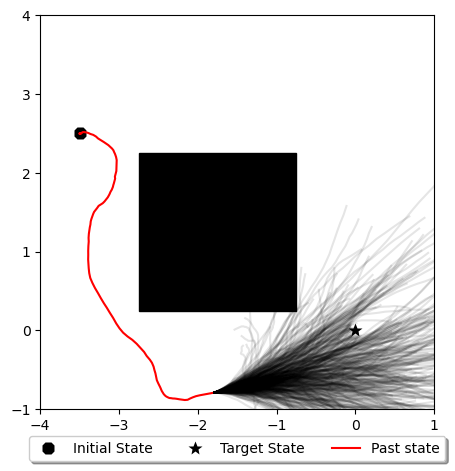

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


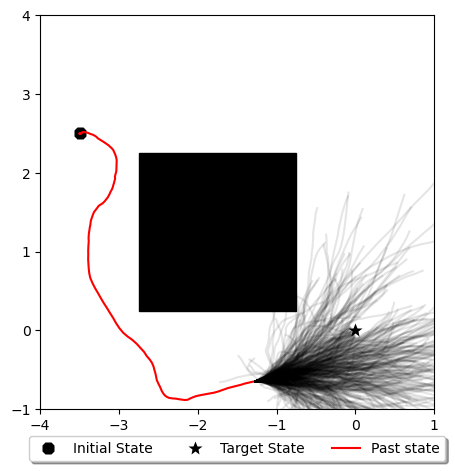

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


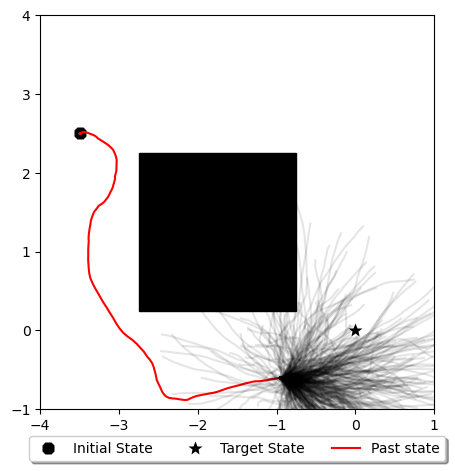

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


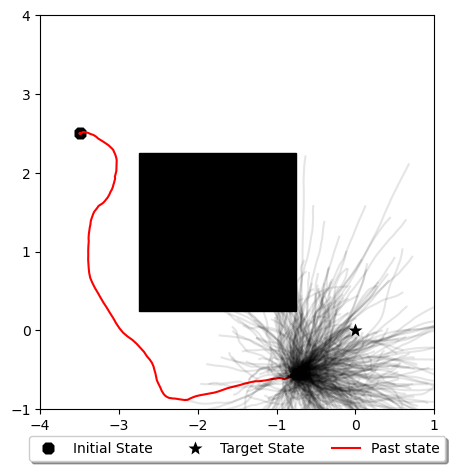

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


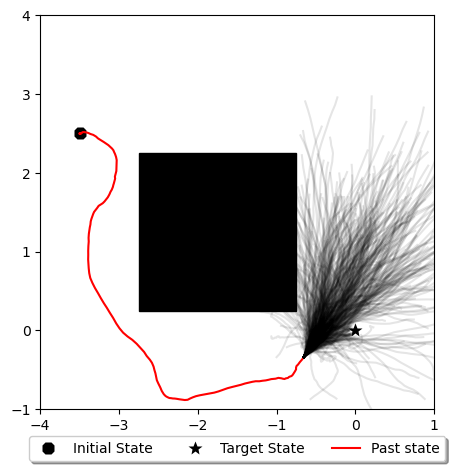

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


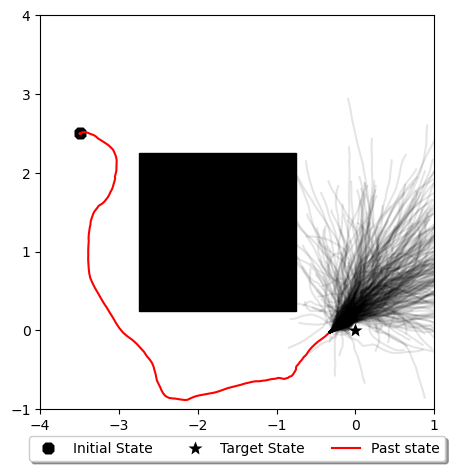

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


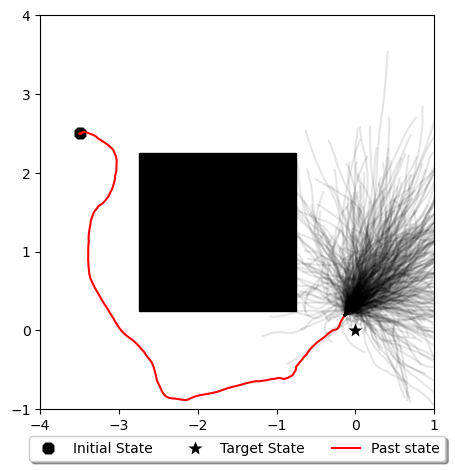

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


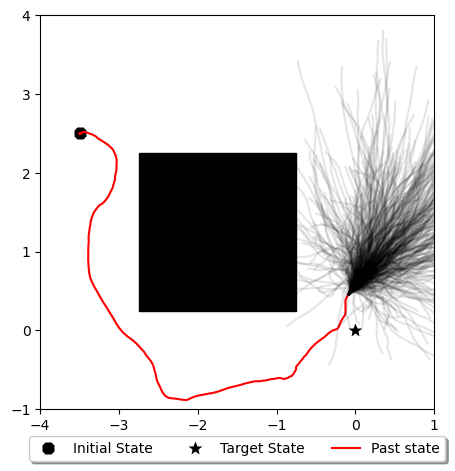

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


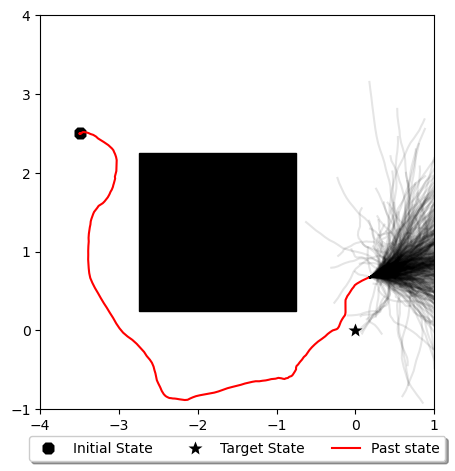

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


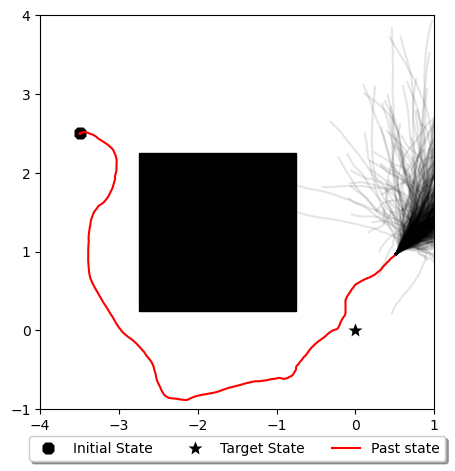

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


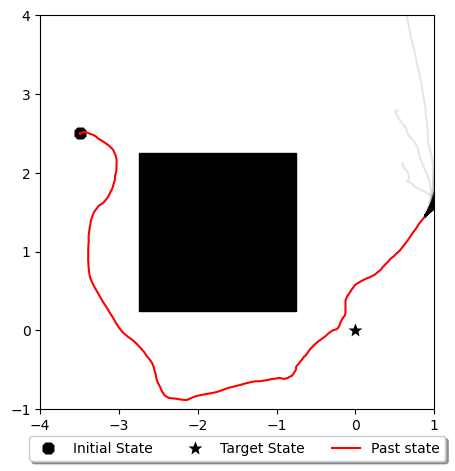

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


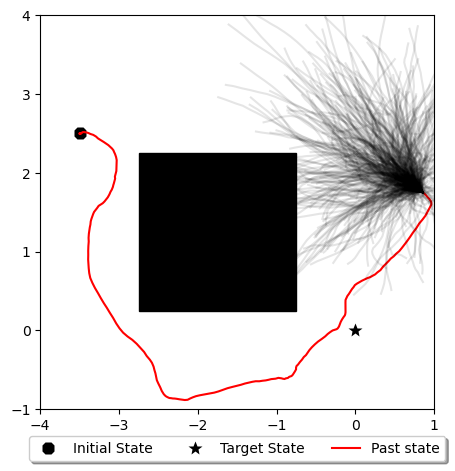

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


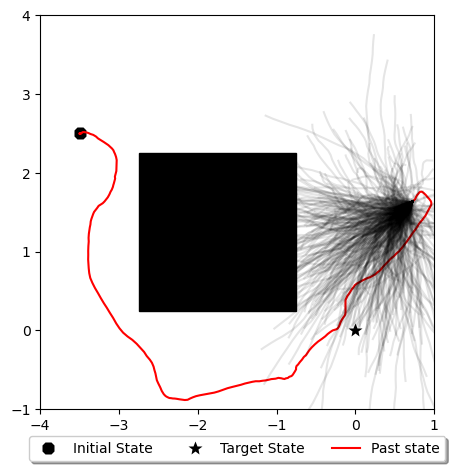

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


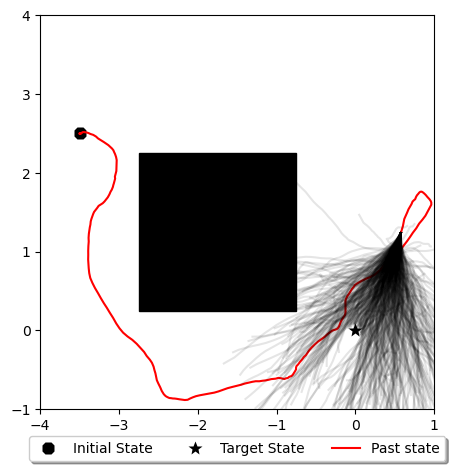

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


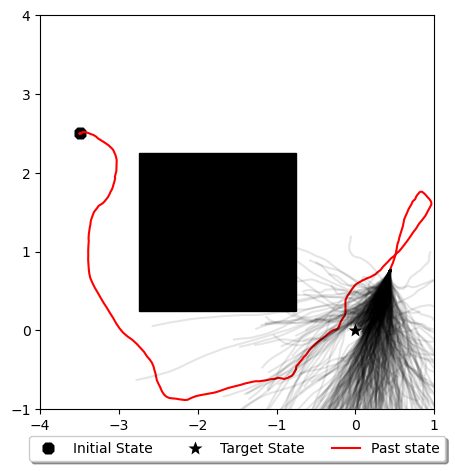

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


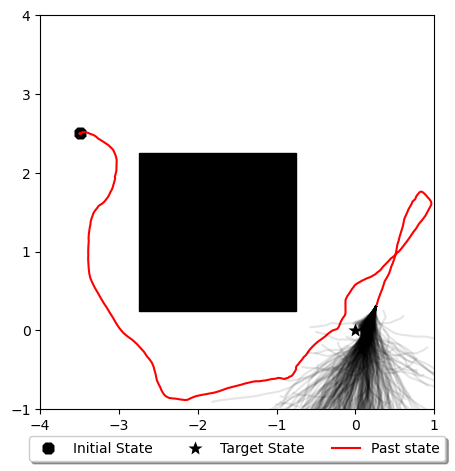

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -0.0004906944001132143. Stopping optimization.
Desired threshold reached with value -0.0001938821115690622. Stopping optimization.
Desired threshold reached with value -5.25598061509574e-05. Stopping optimization.
Goal reached at t=13.85s
Desired threshold reached with value -inf. Stopping optimization.


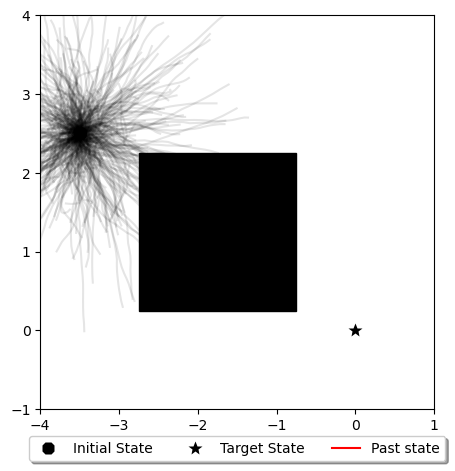

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


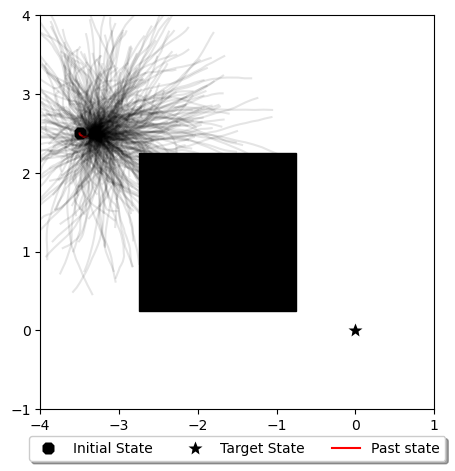

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


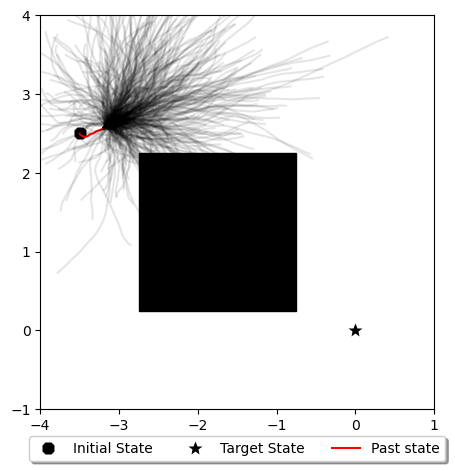

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


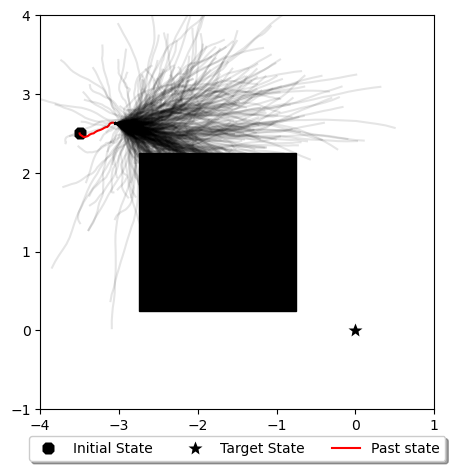

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


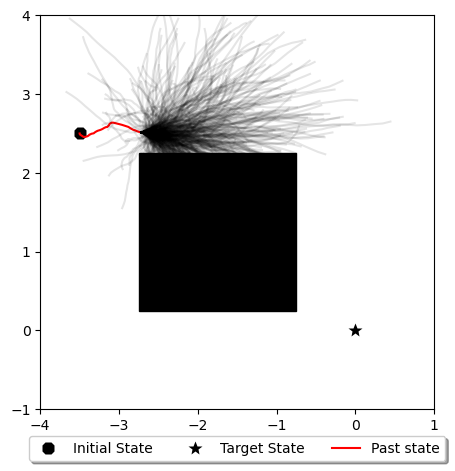

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


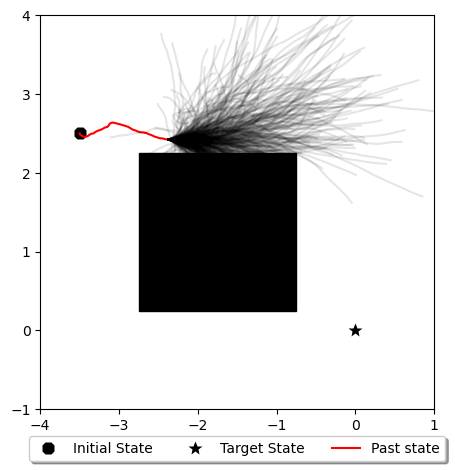

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


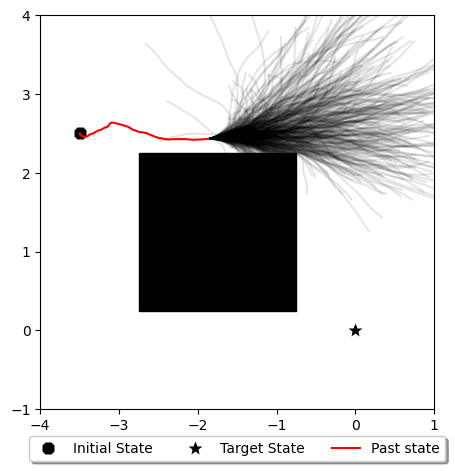

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


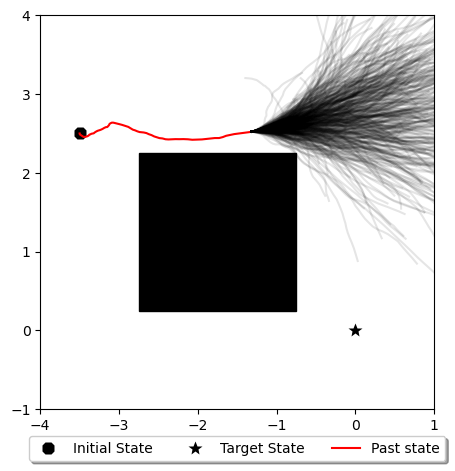

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


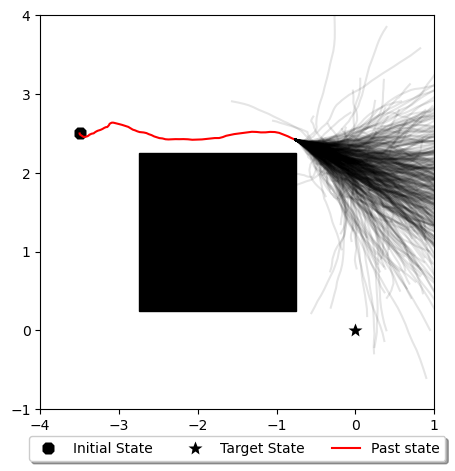

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


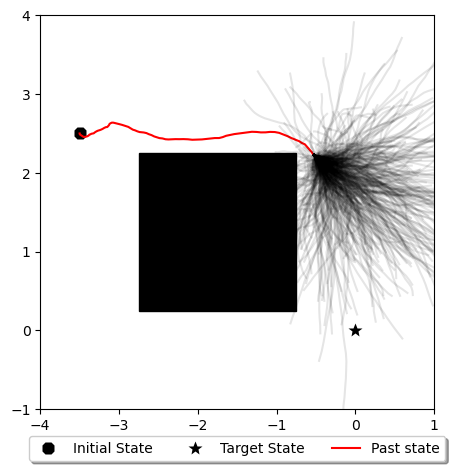

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


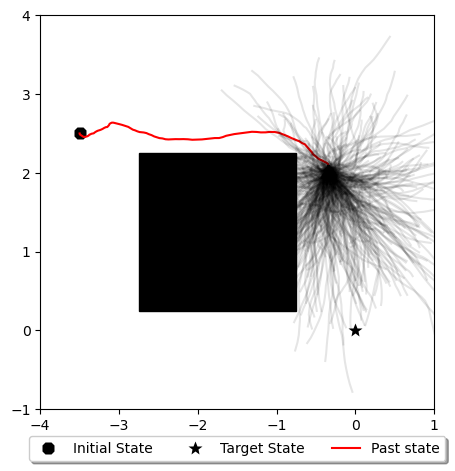

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


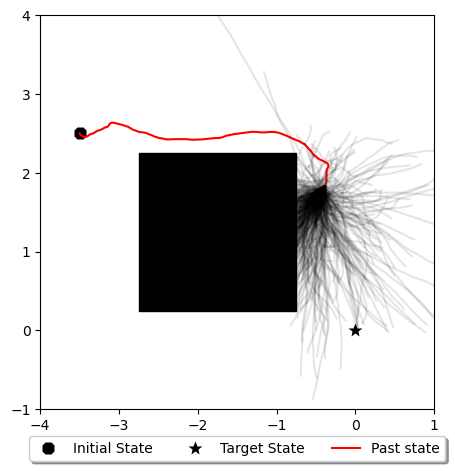

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


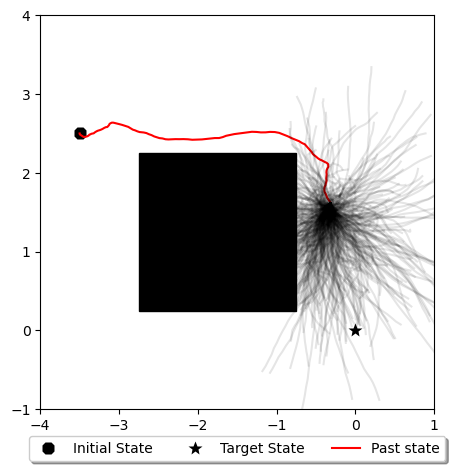

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


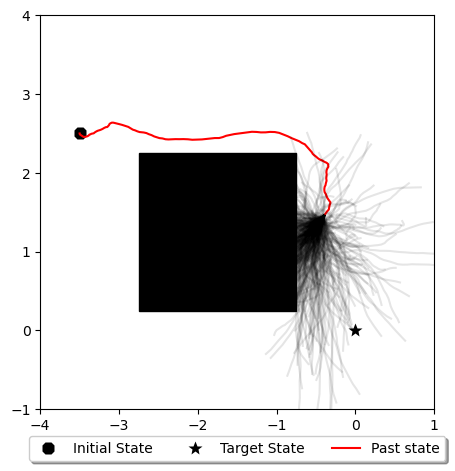

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


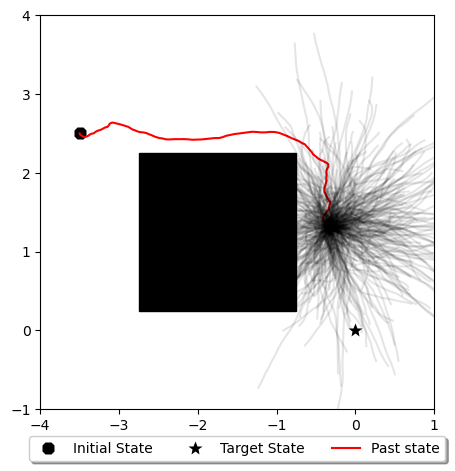

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


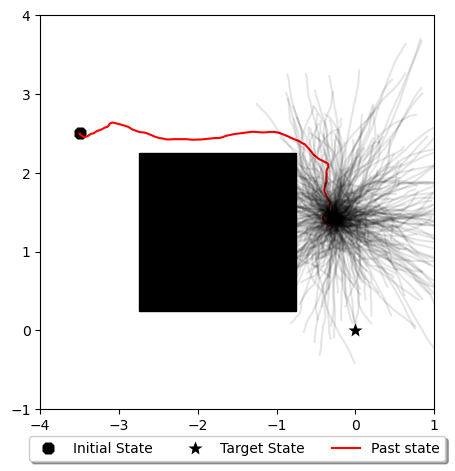

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


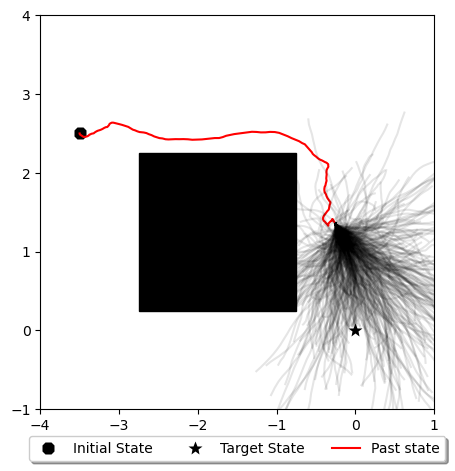

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


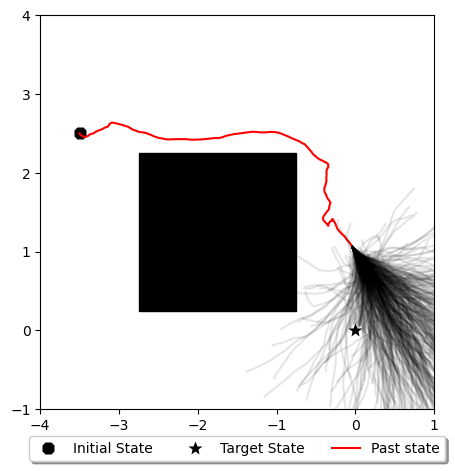

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


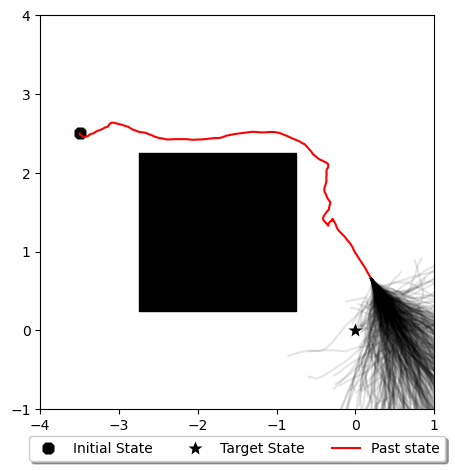

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


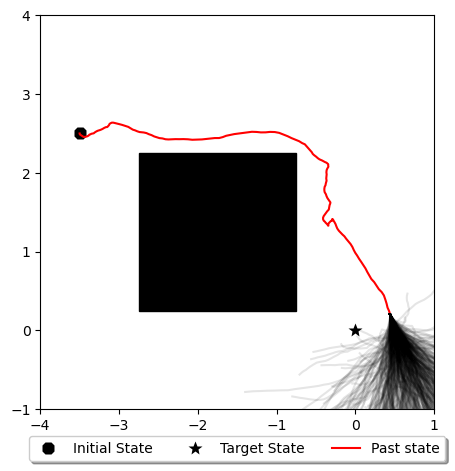

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


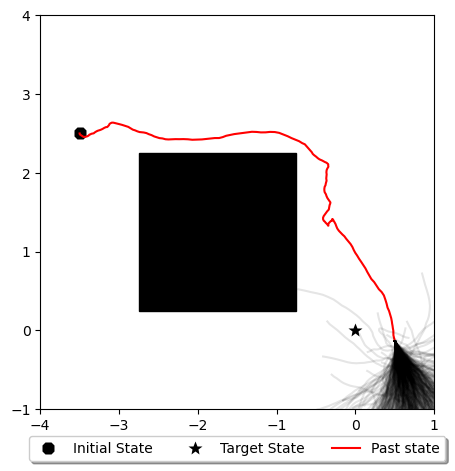

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


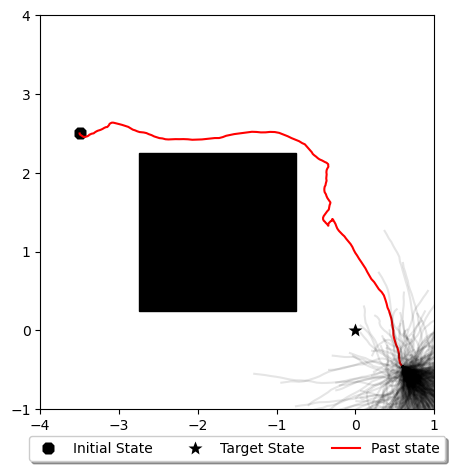

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


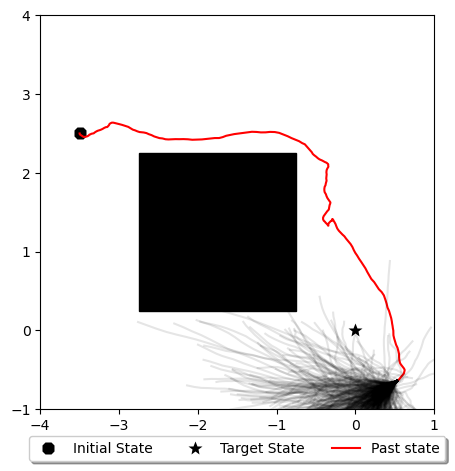

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


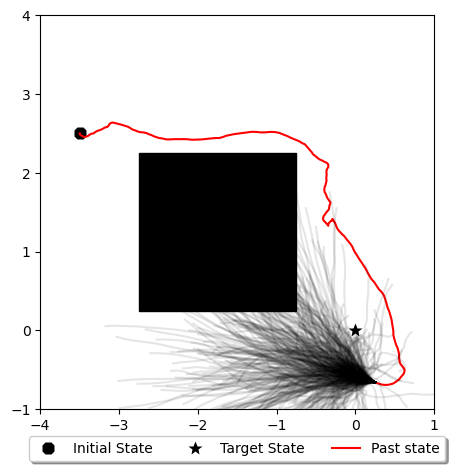

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


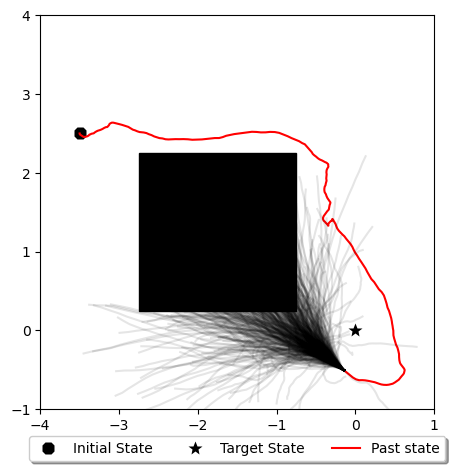

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


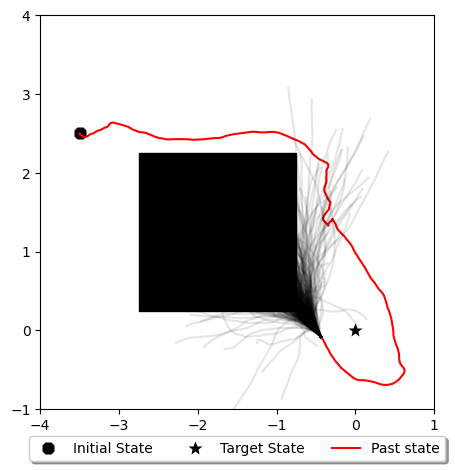

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


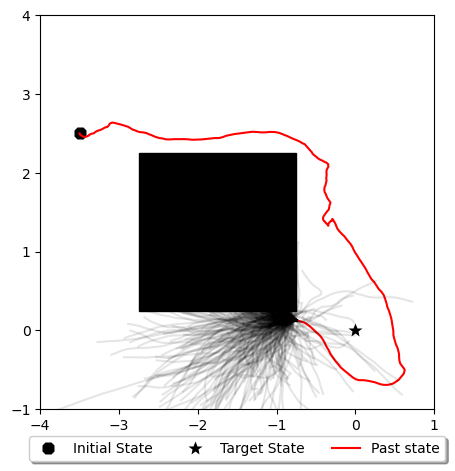

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


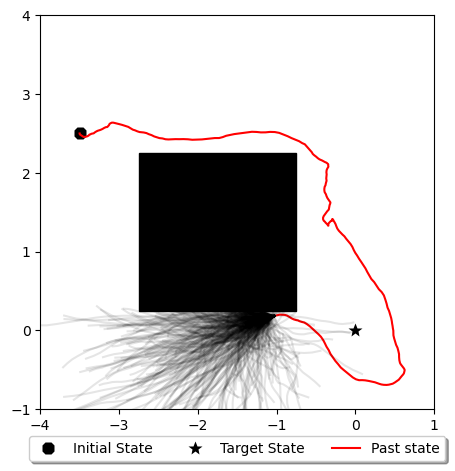

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


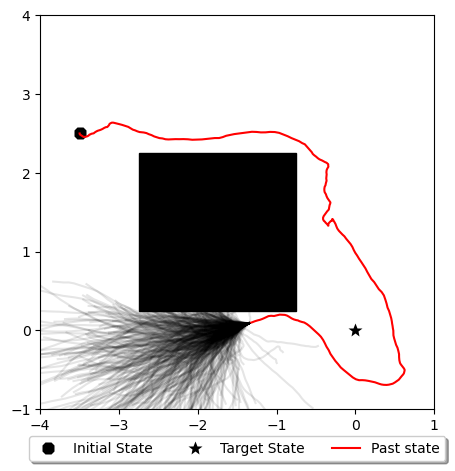

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


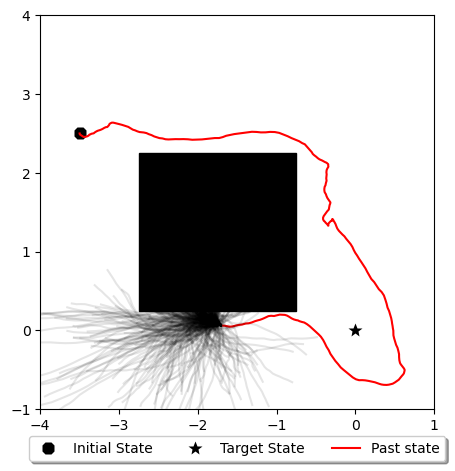

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


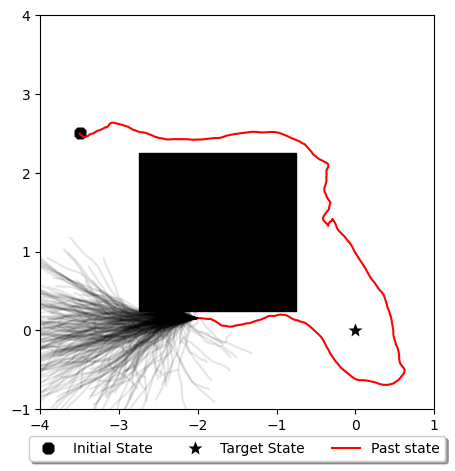

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


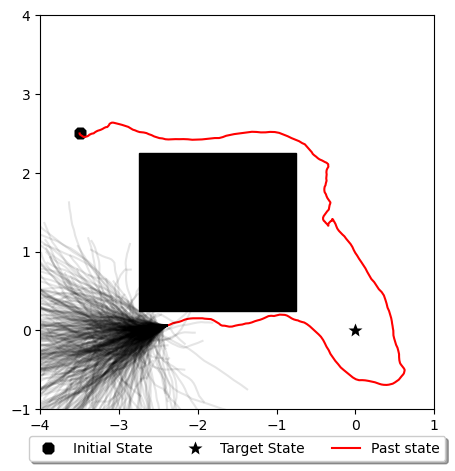

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


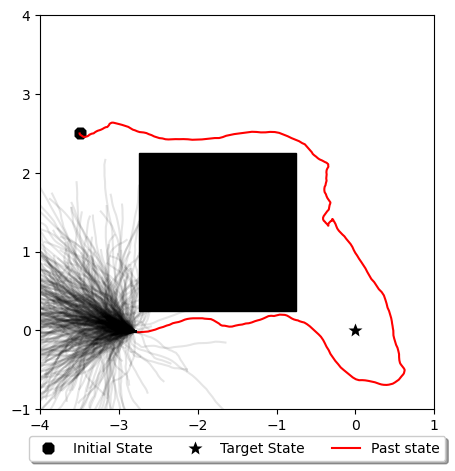

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


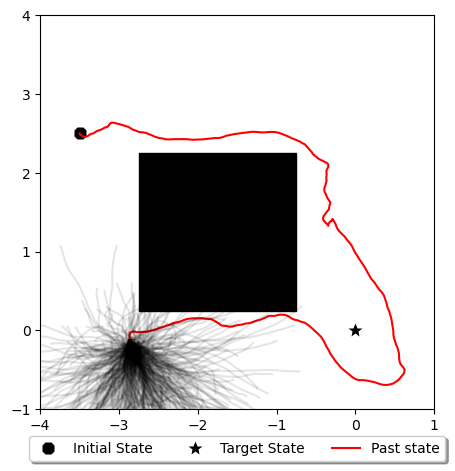

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


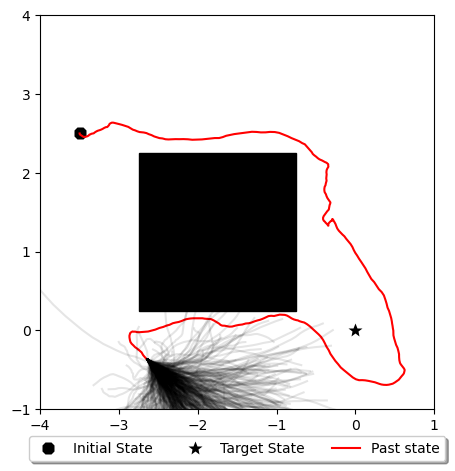

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


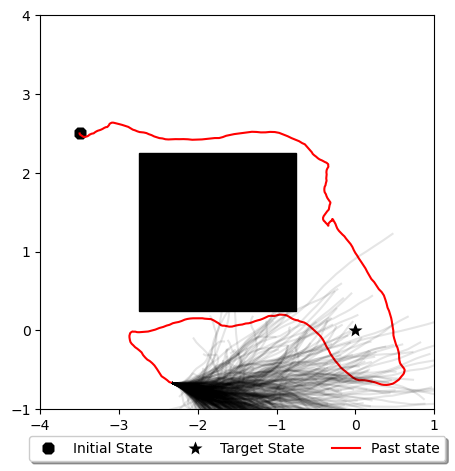

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


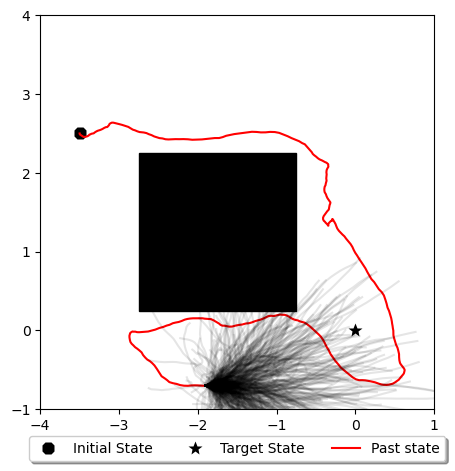

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


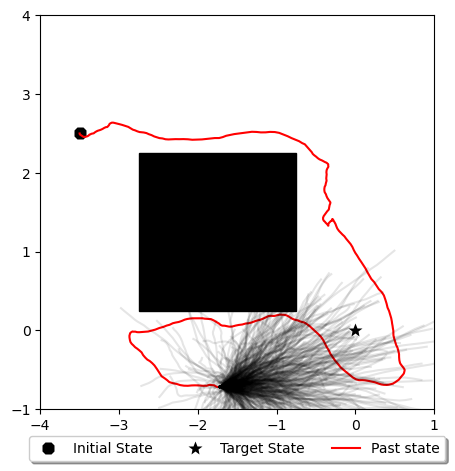

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


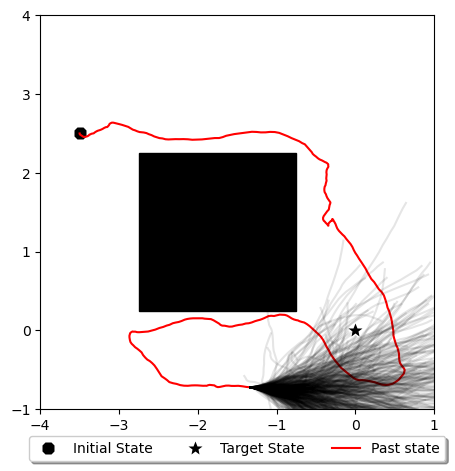

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


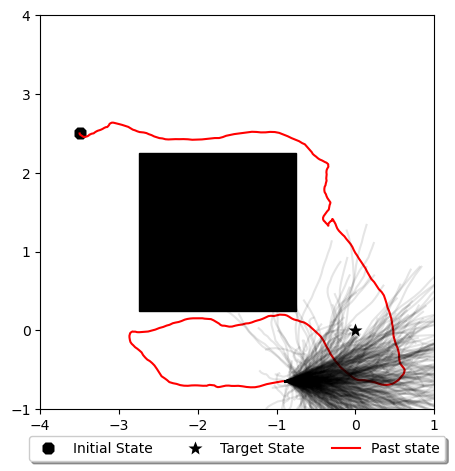

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


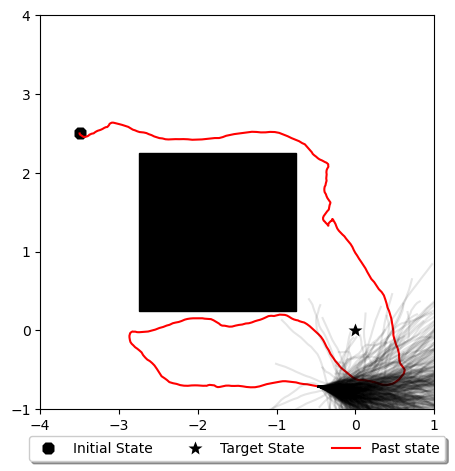

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


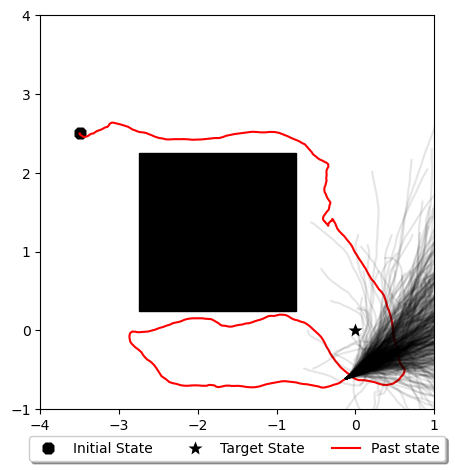

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


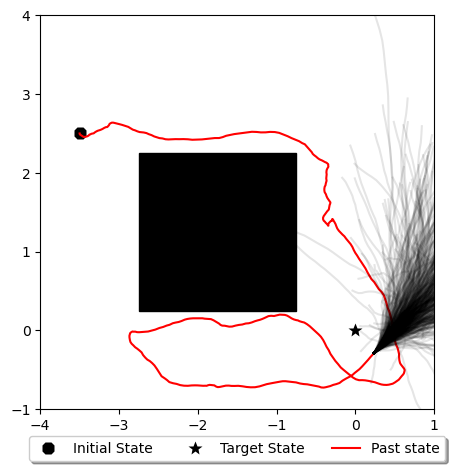

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


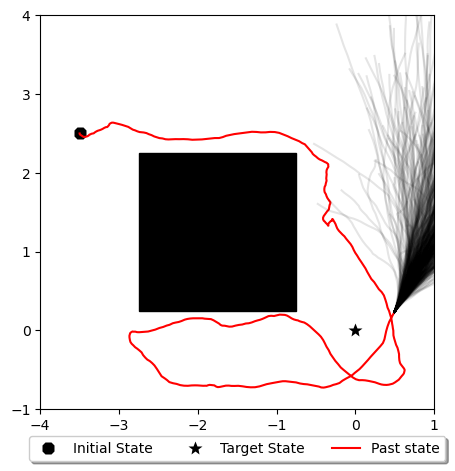

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


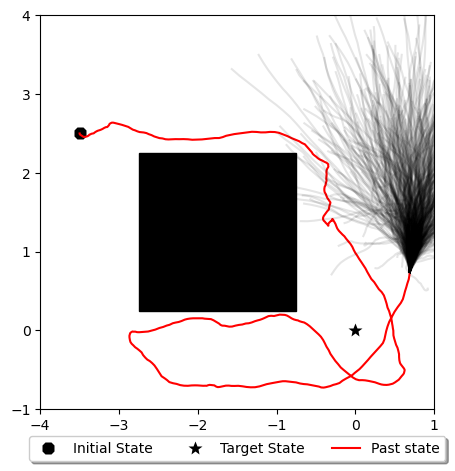

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


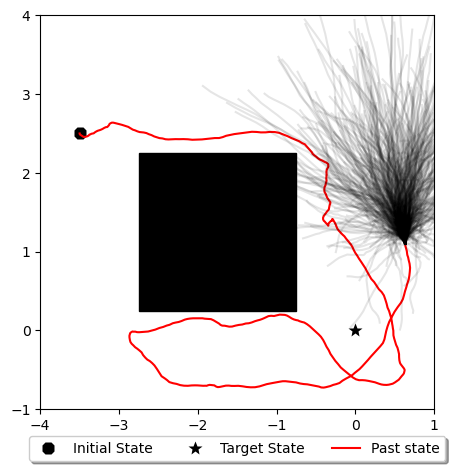

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


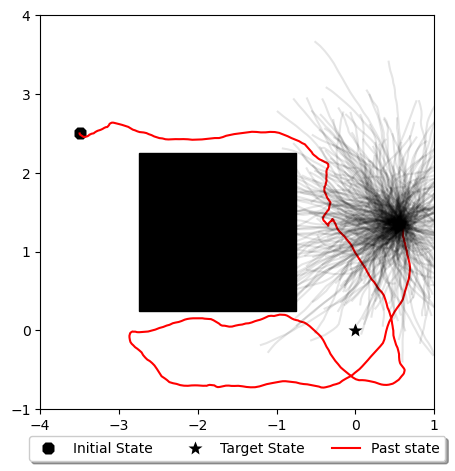

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


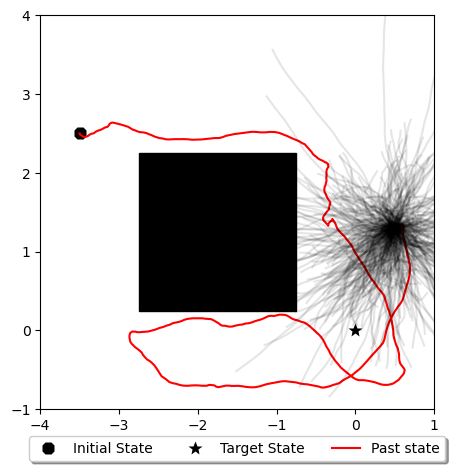

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


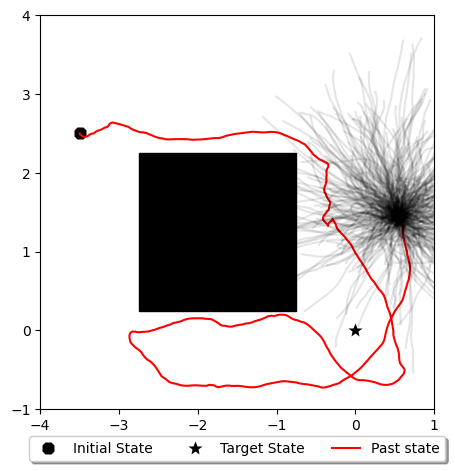

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


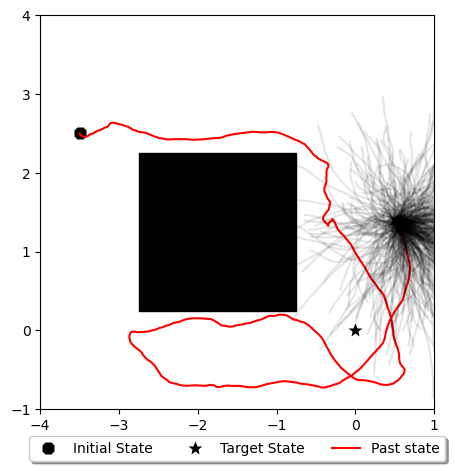

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


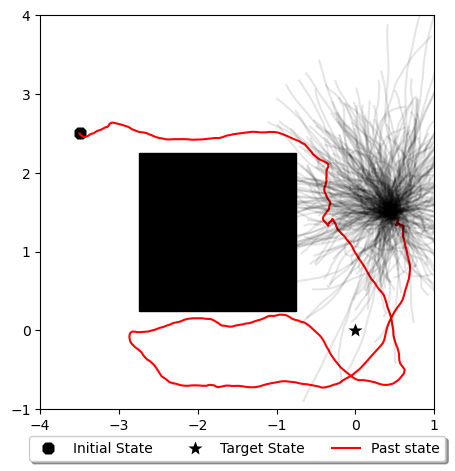

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


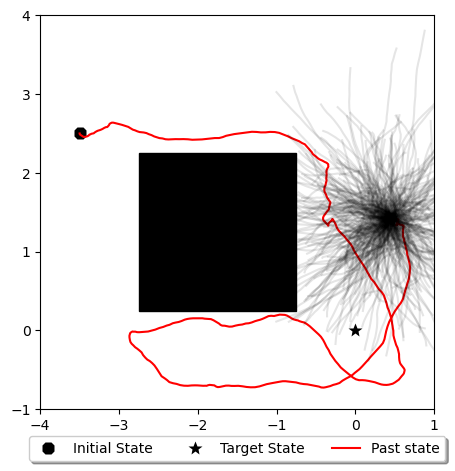

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


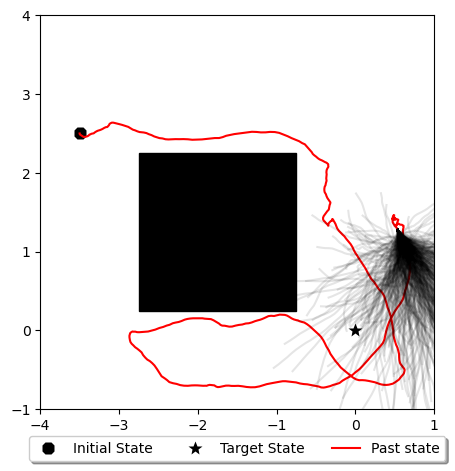

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


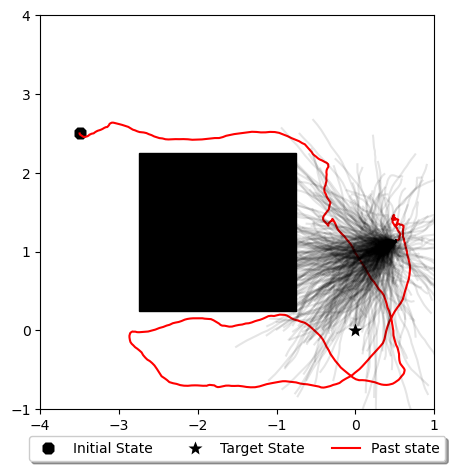

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


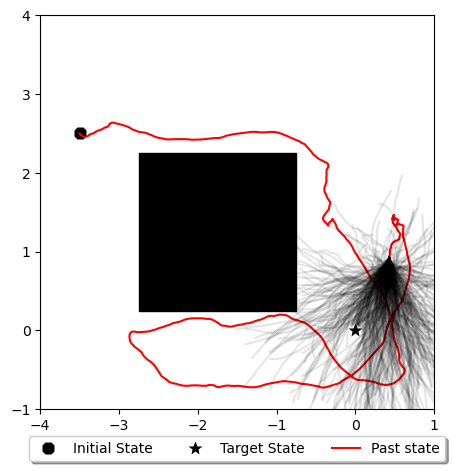

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


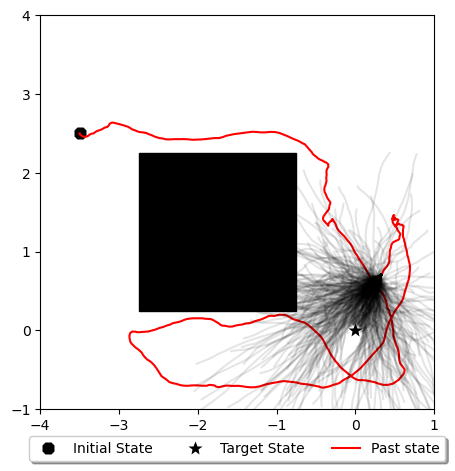

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


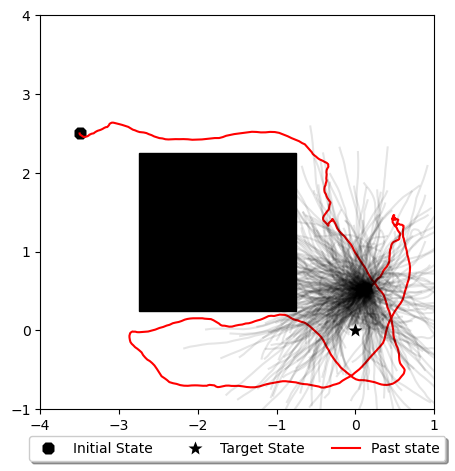

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


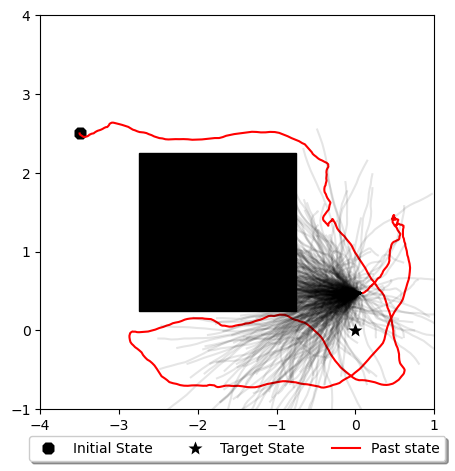

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


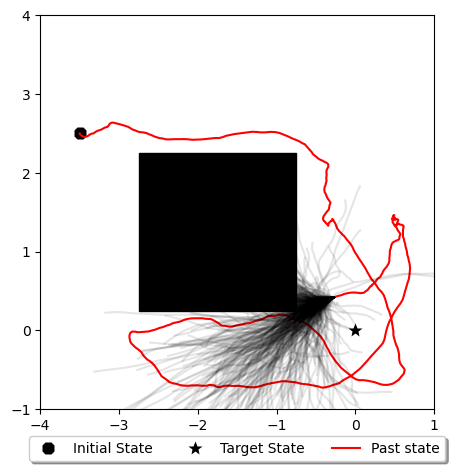

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


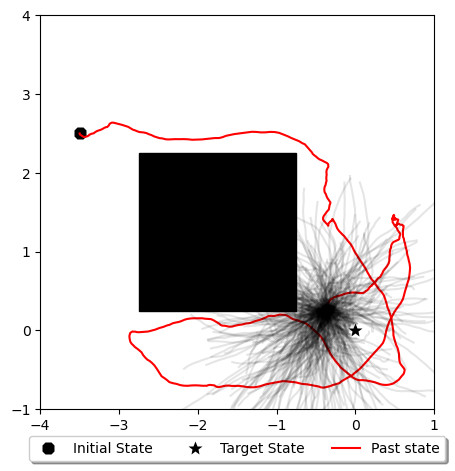

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


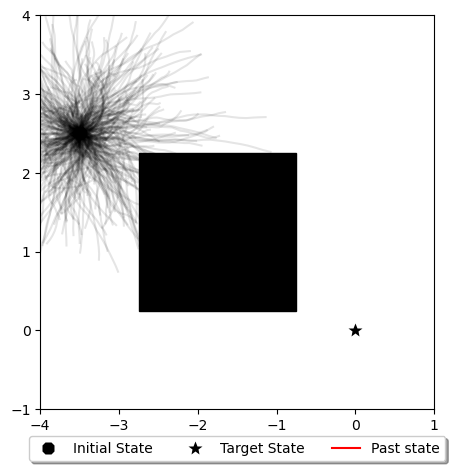

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


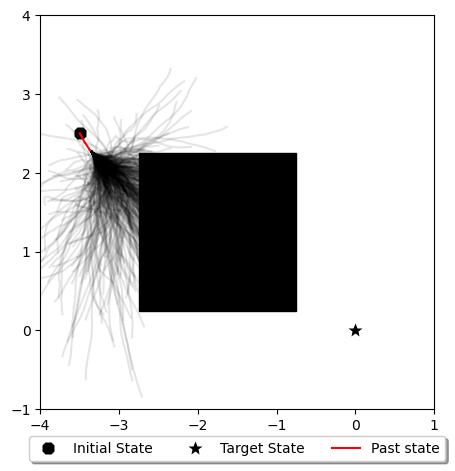

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


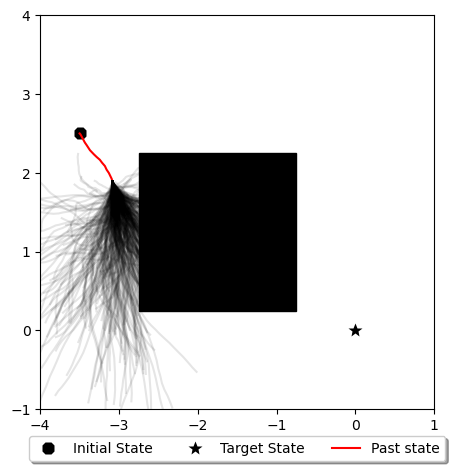

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


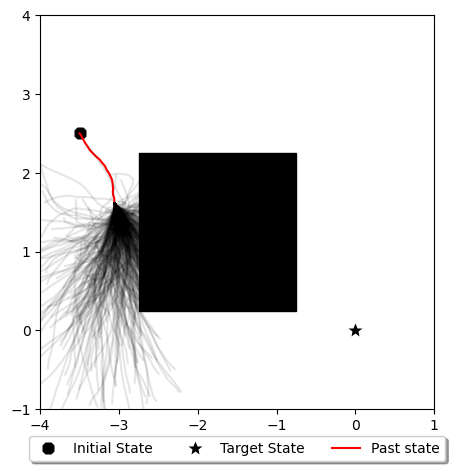

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


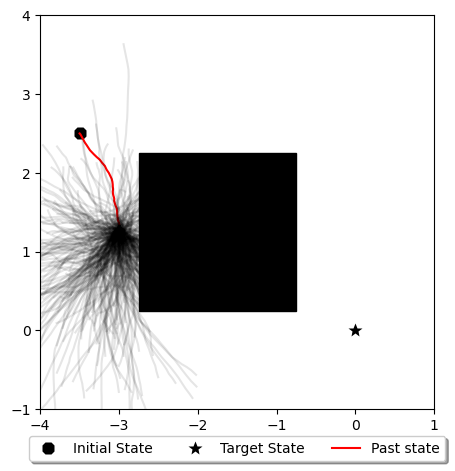

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


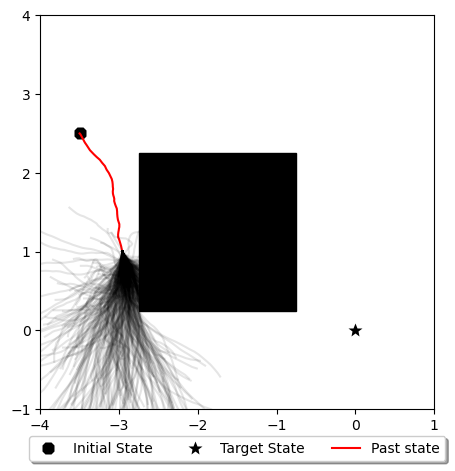

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


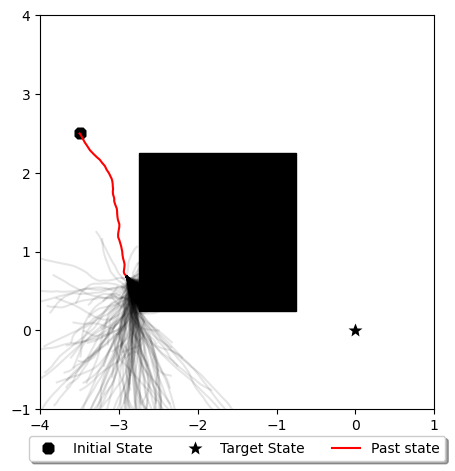

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


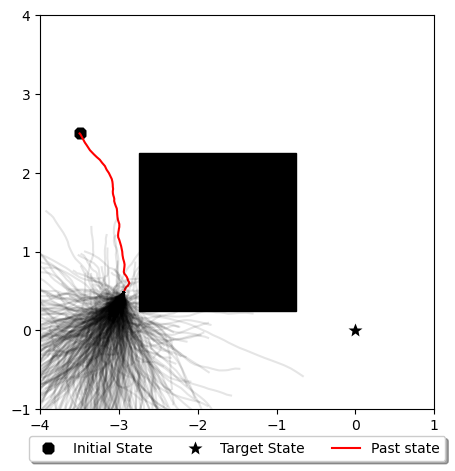

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


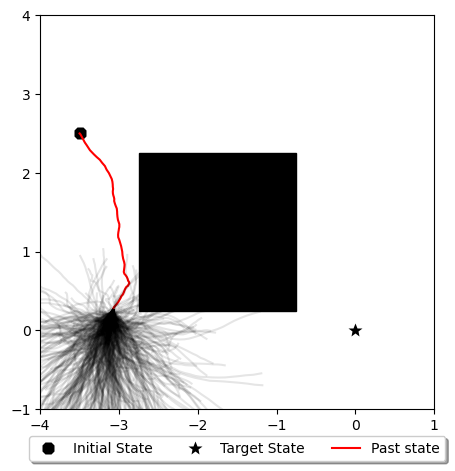

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


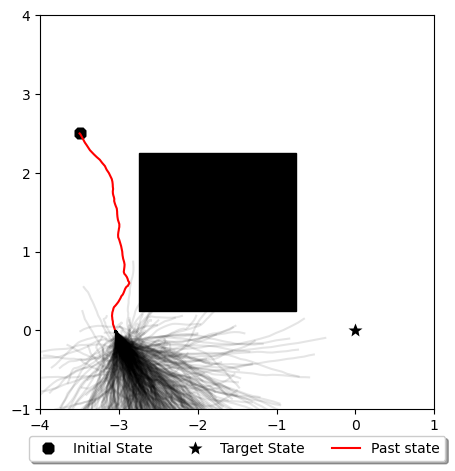

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


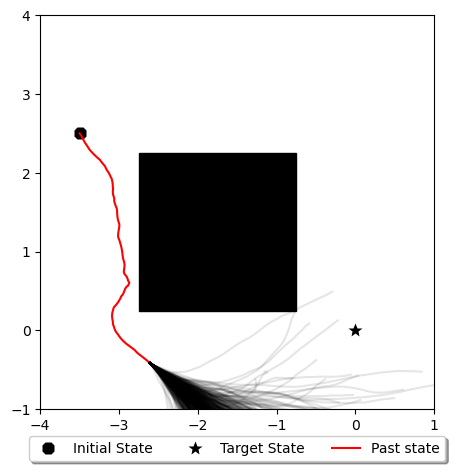

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


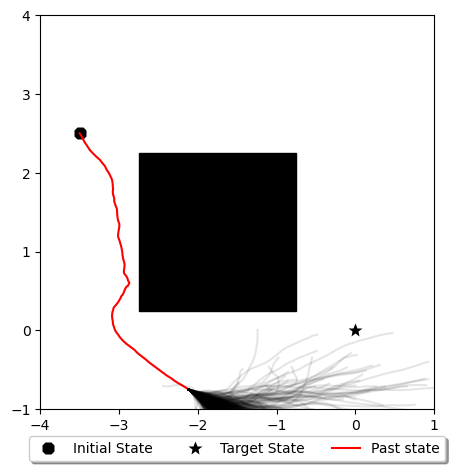

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


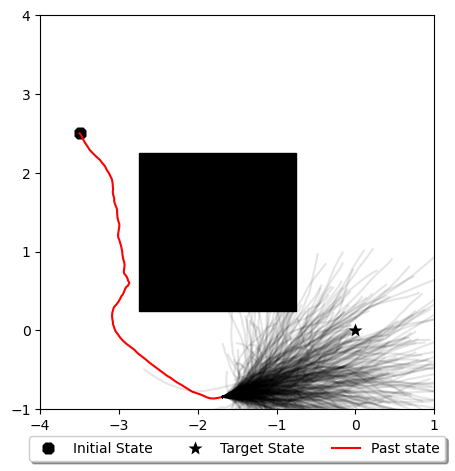

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


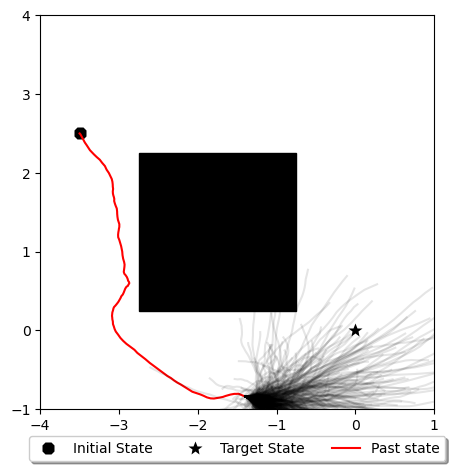

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


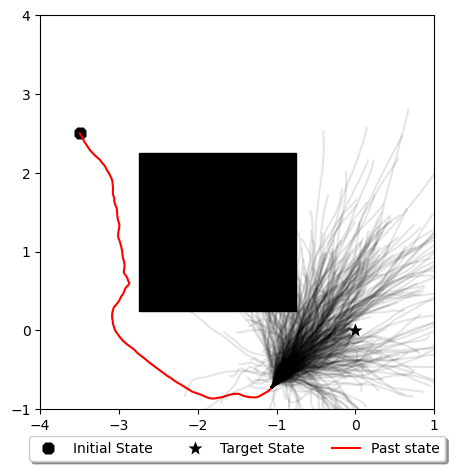

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


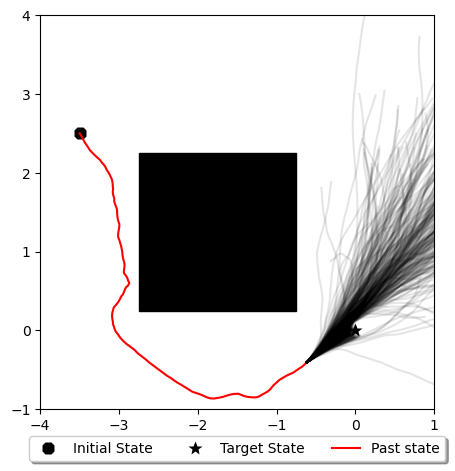

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -0.0017345691257895325. Stopping optimization.
Desired threshold reached with value -0.0007088972883917537. Stopping optimization.
Desired threshold reached with value -0.00018466545020626838. Stopping optimization.
Desired threshold reached with value -2.540835818145664e-05. Stopping optimization.
Goal reached at t=7.90s
Desired threshold reached with value -inf. Stopping optimization.


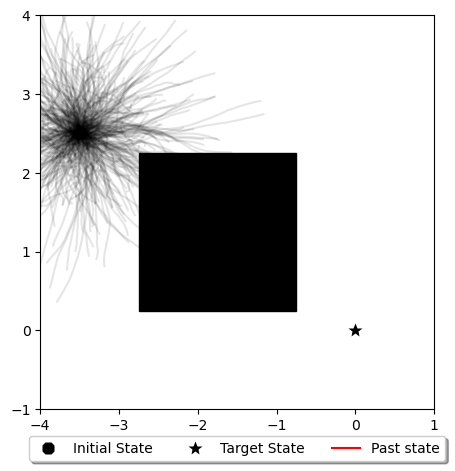

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


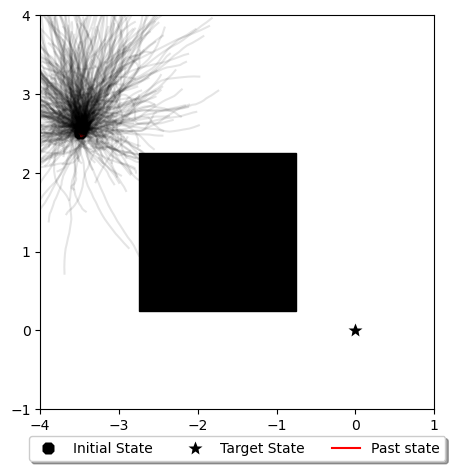

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


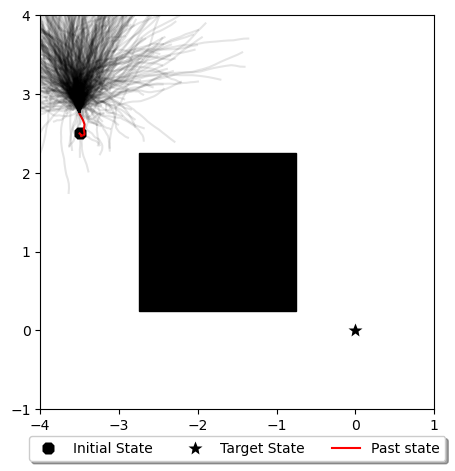

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


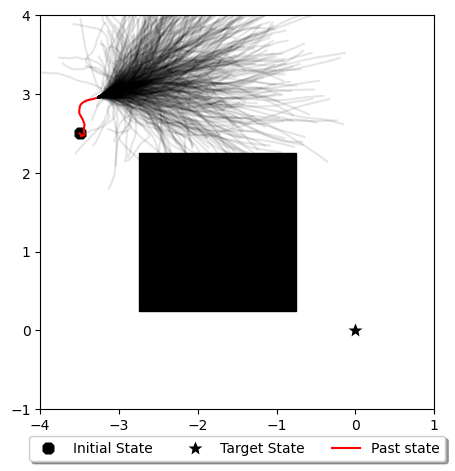

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


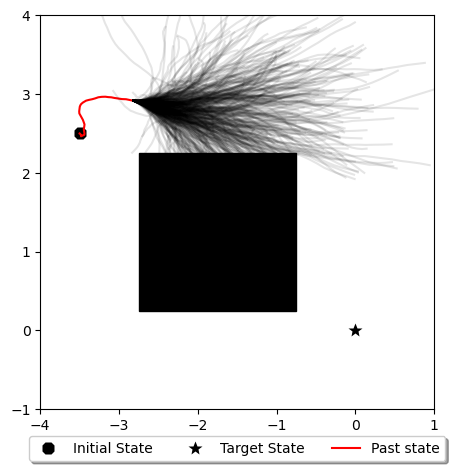

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


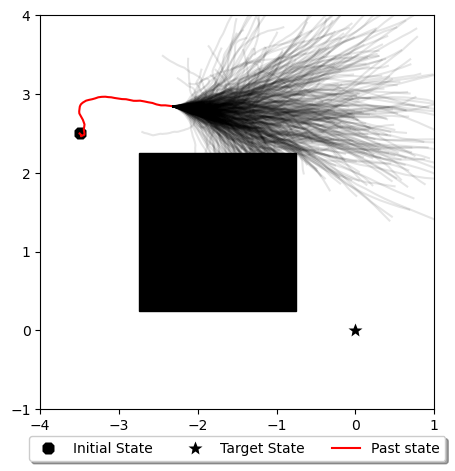

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


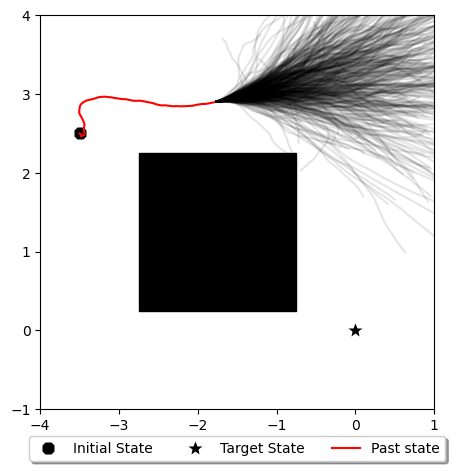

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


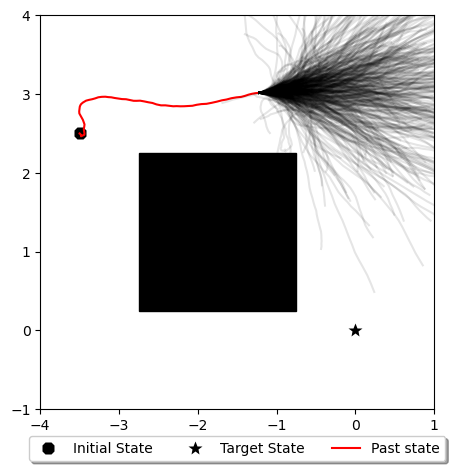

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


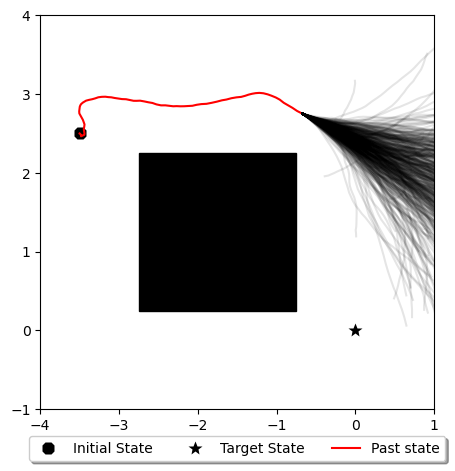

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


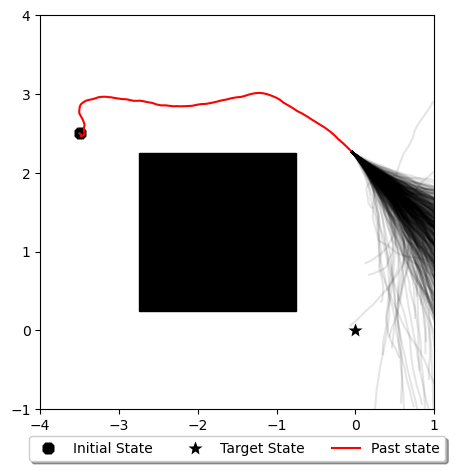

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


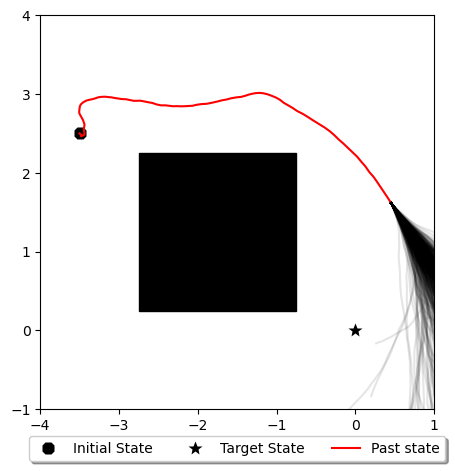

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


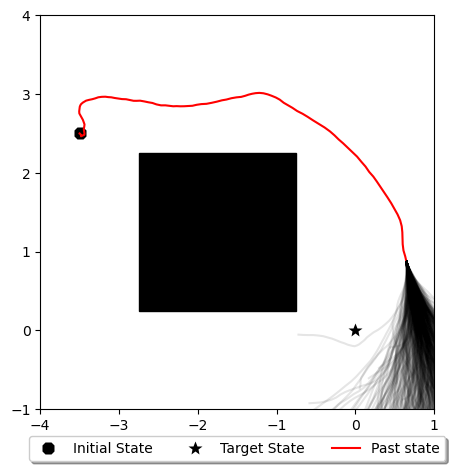

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


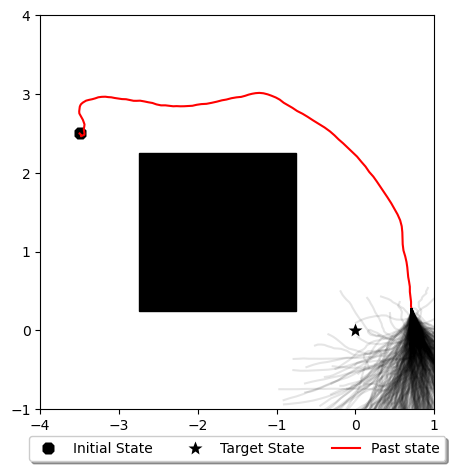

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


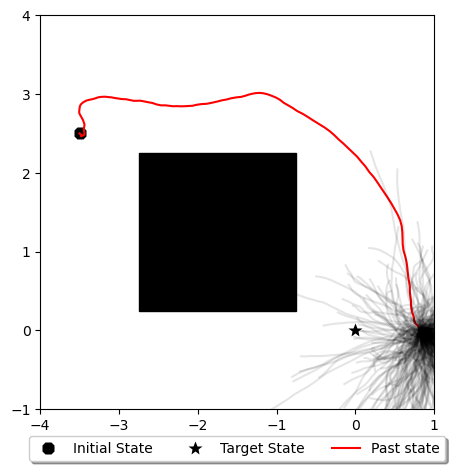

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


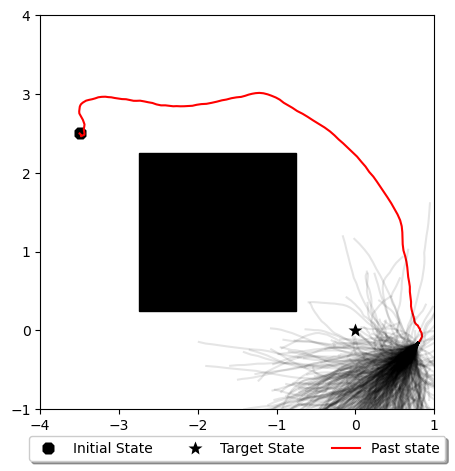

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


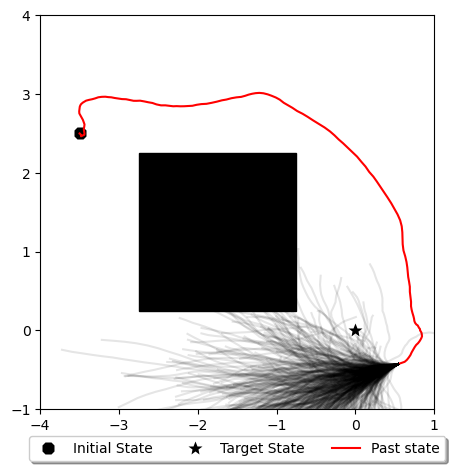

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


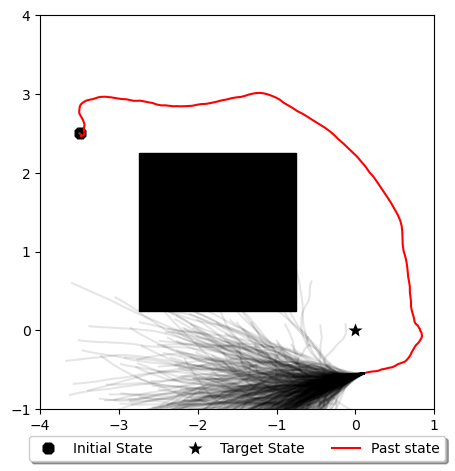

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


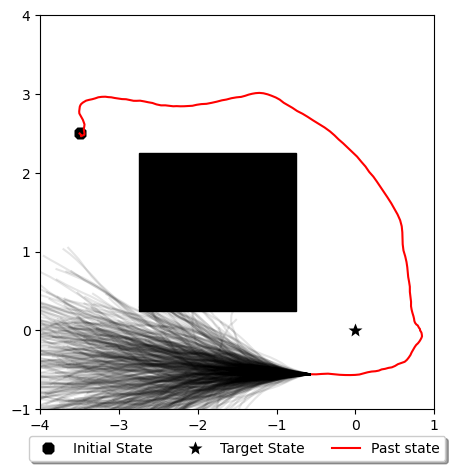

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


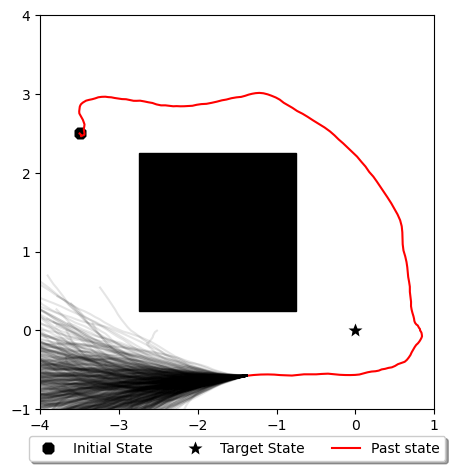

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


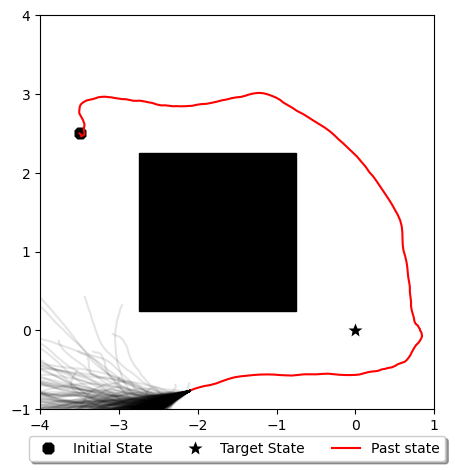

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


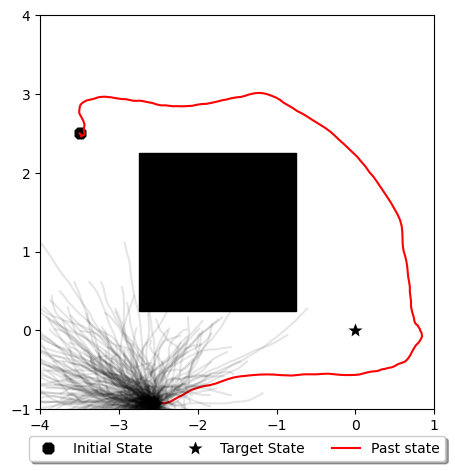

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


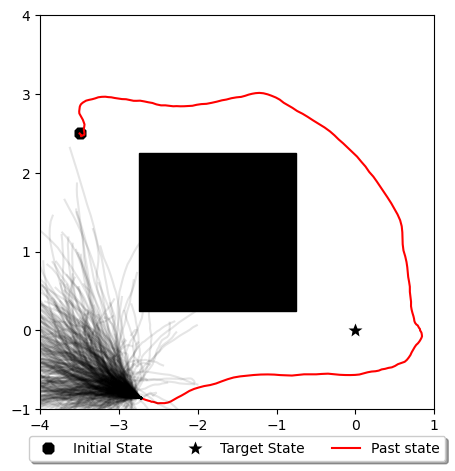

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


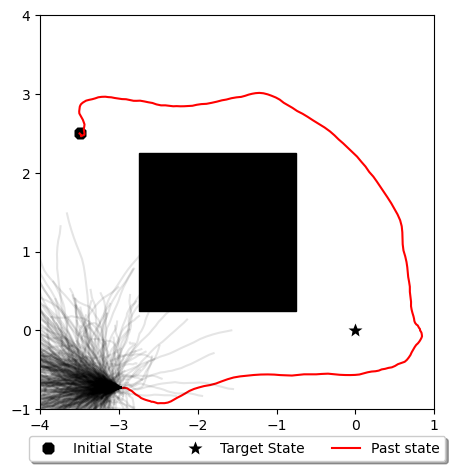

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


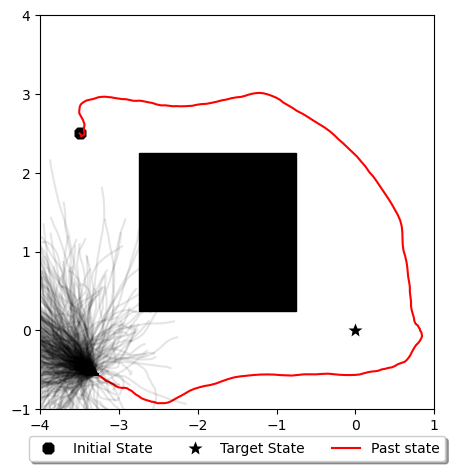

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


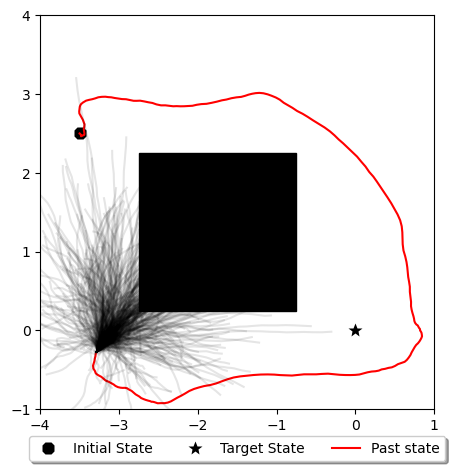

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


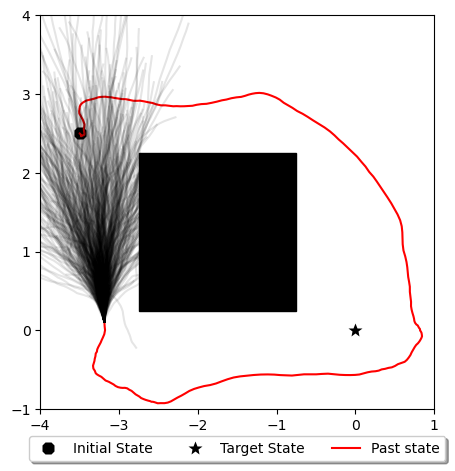

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


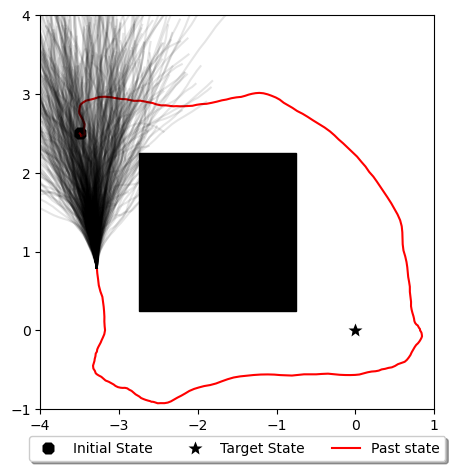

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


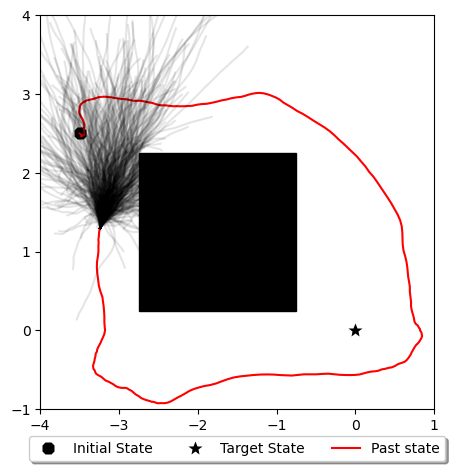

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


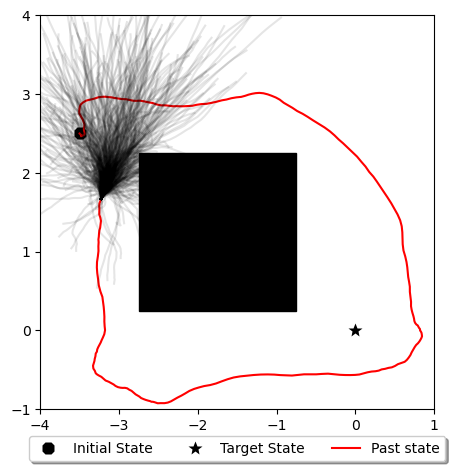

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


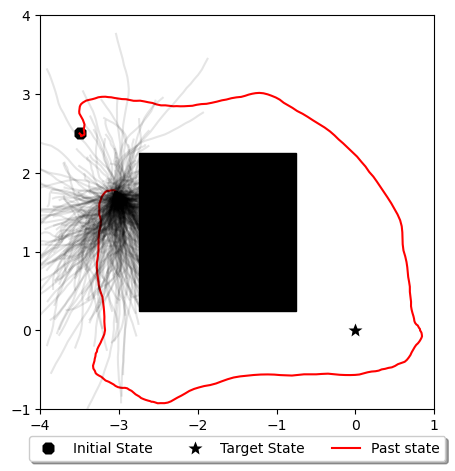

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


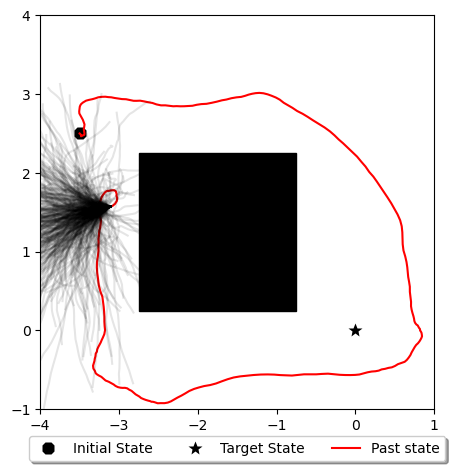

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


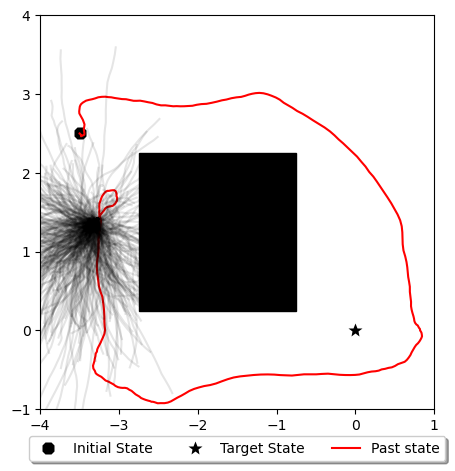

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


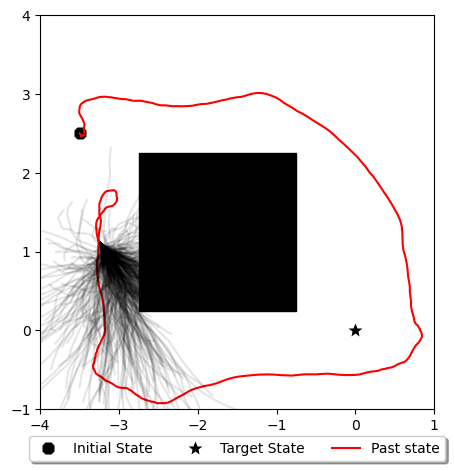

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


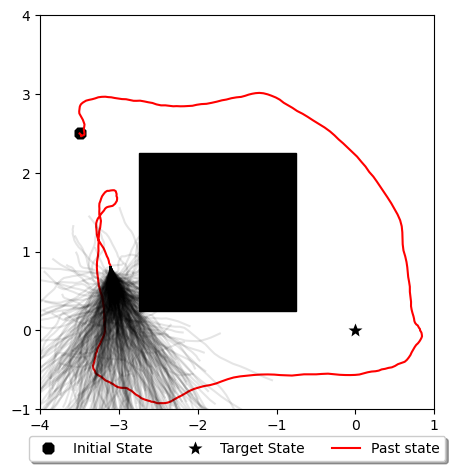

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


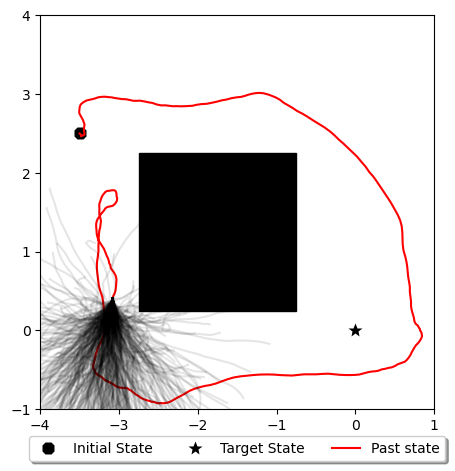

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


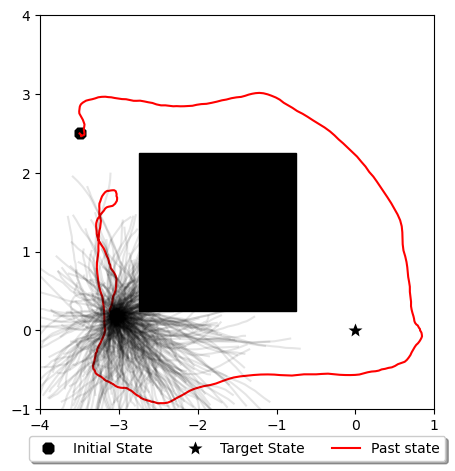

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


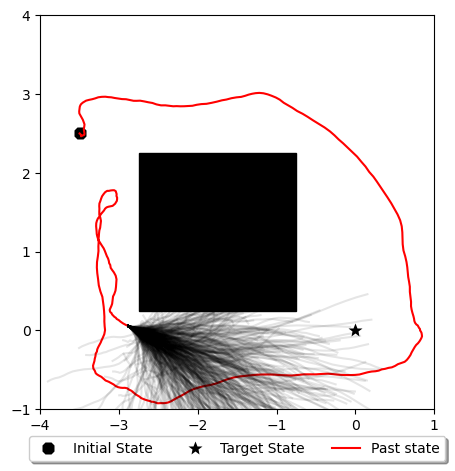

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


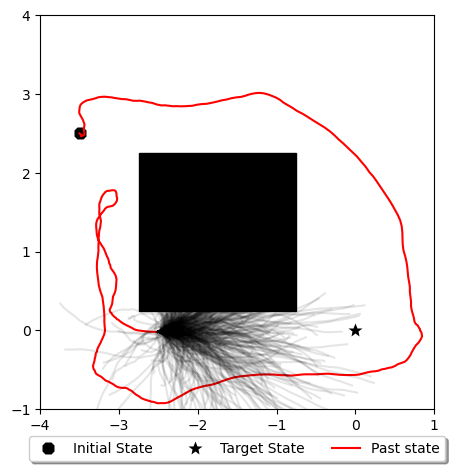

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


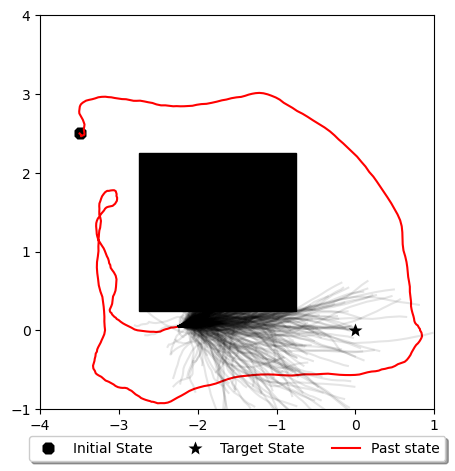

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


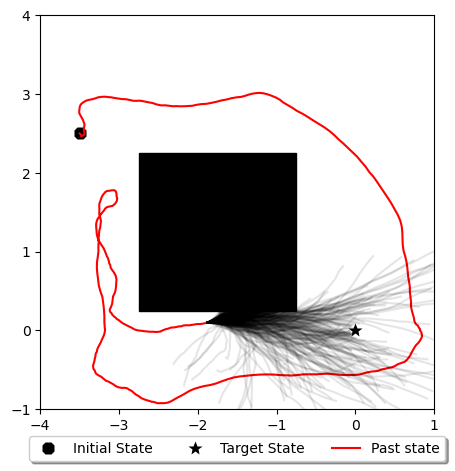

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


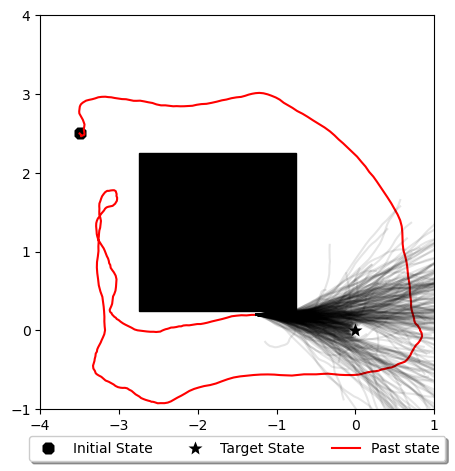

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


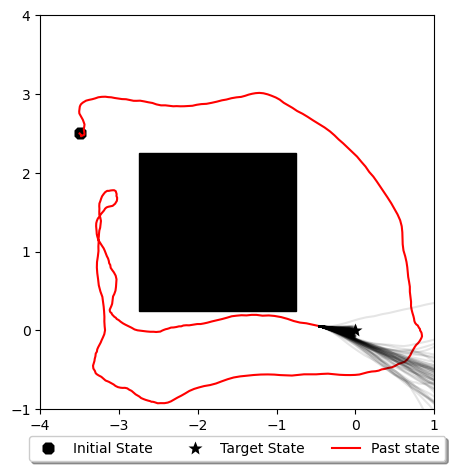

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -0.00018854709176657525. Stopping optimization.
Desired threshold reached with value -4.252016134523744e-05. Stopping optimization.
Goal reached at t=20.75s
Desired threshold reached with value -inf. Stopping optimization.


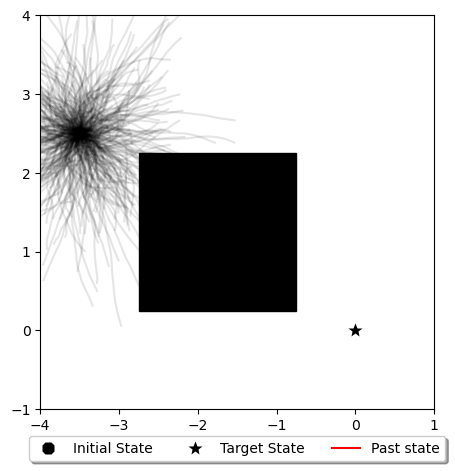

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


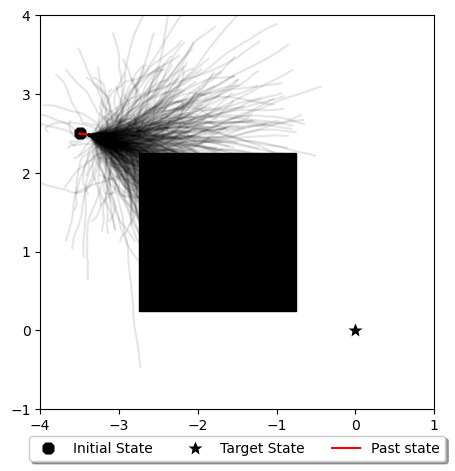

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


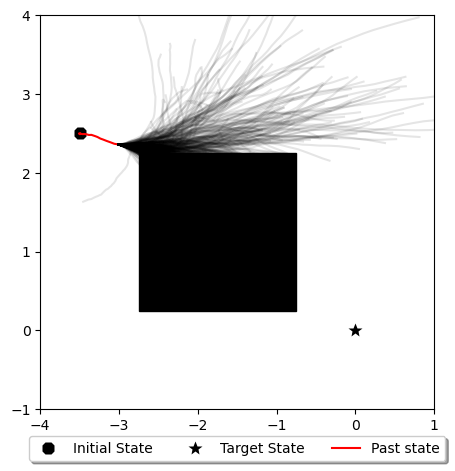

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


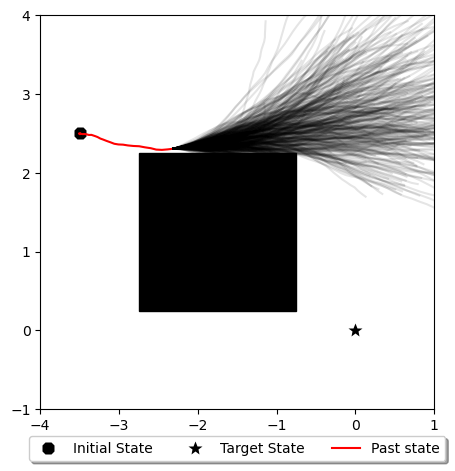

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


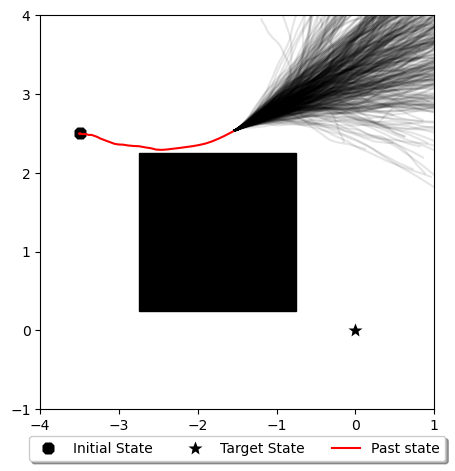

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


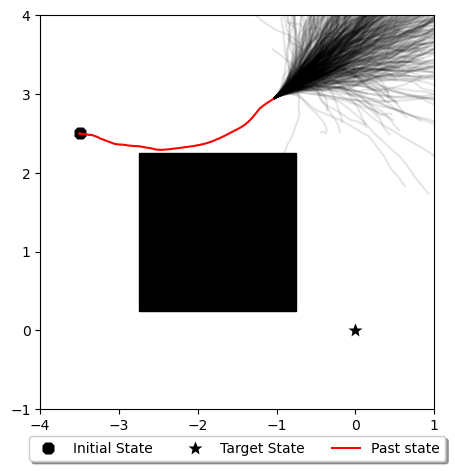

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


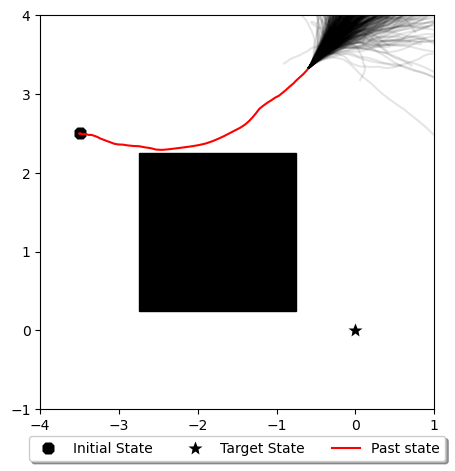

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


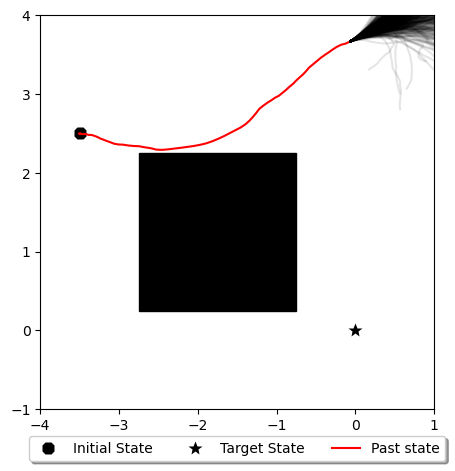

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


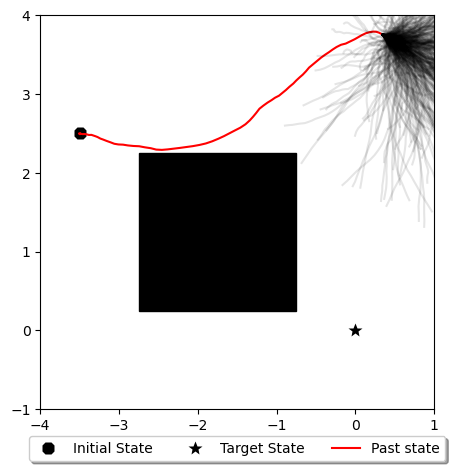

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


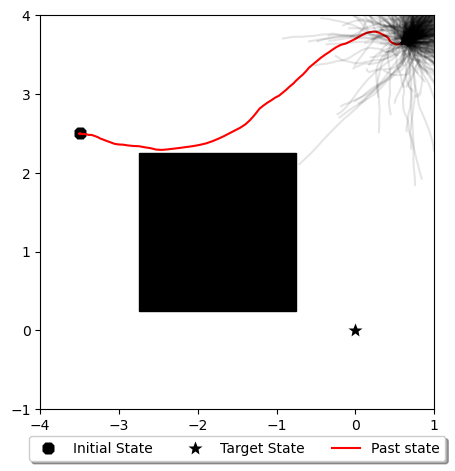

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


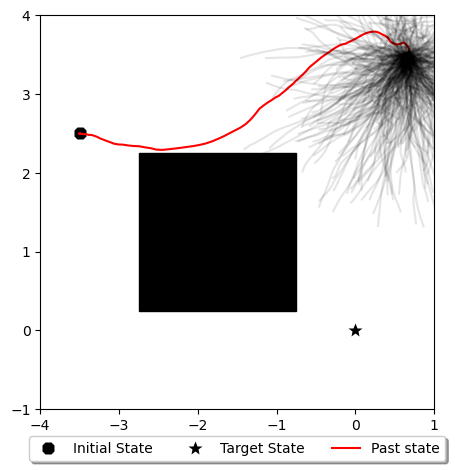

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


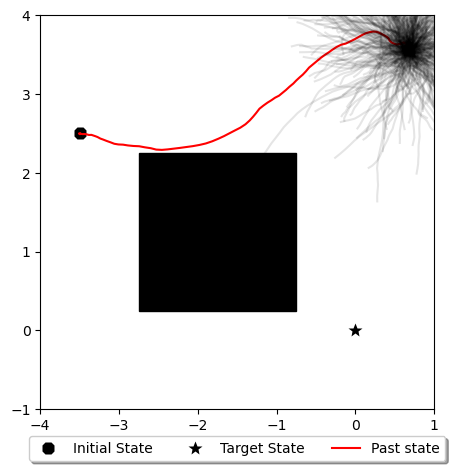

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


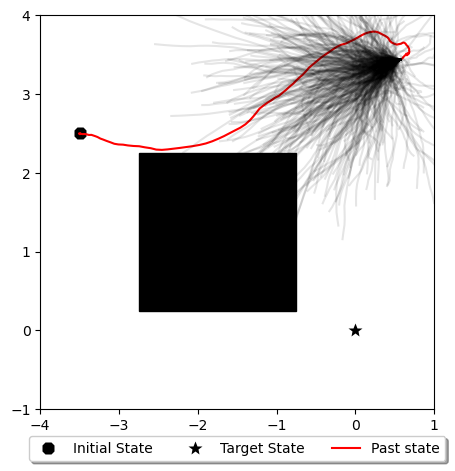

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


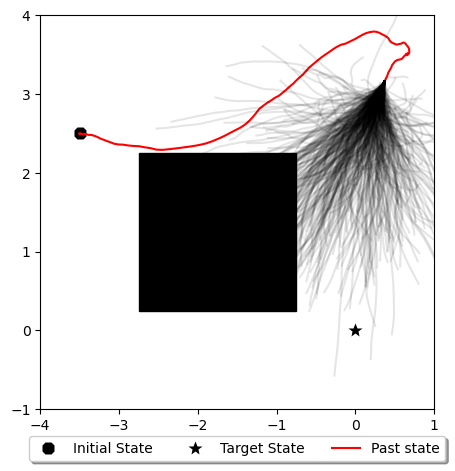

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


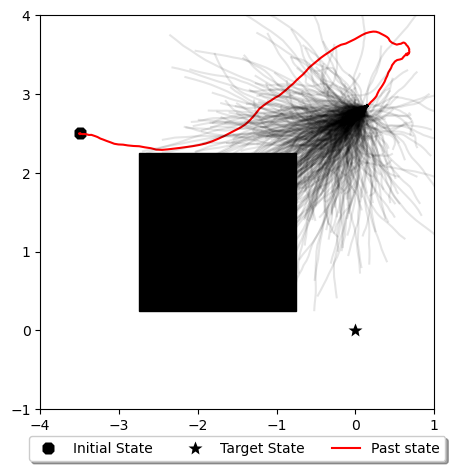

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


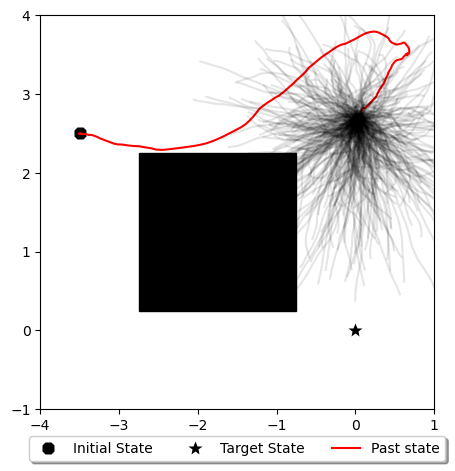

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


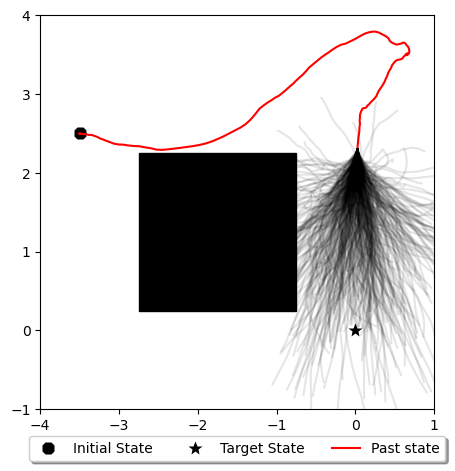

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


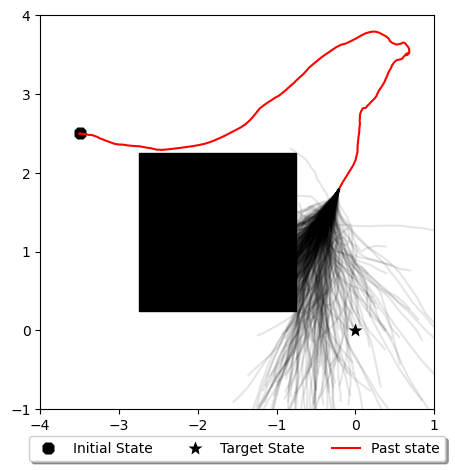

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


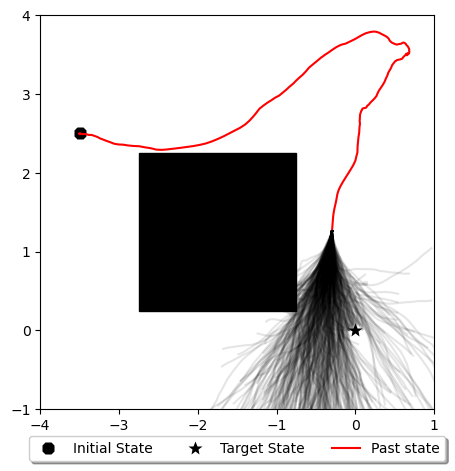

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


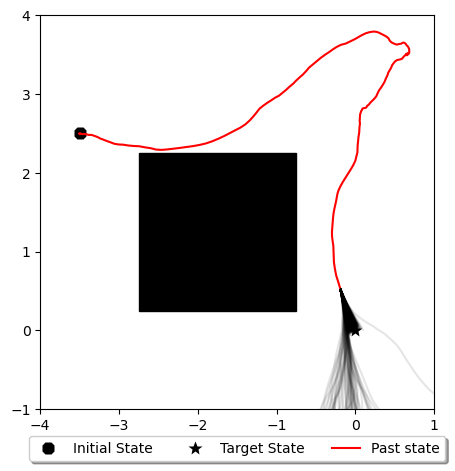

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -0.0020872157264650217. Stopping optimization.
Desired threshold reached with value -0.0008060839179108334. Stopping optimization.
Desired threshold reached with value -0.00020634008222028782. Stopping optimization.
Desired threshold reached with value -2.045445301663745e-05. Stopping optimization.
Goal reached at t=9.75s
Desired threshold reached with value -inf. Stopping optimization.


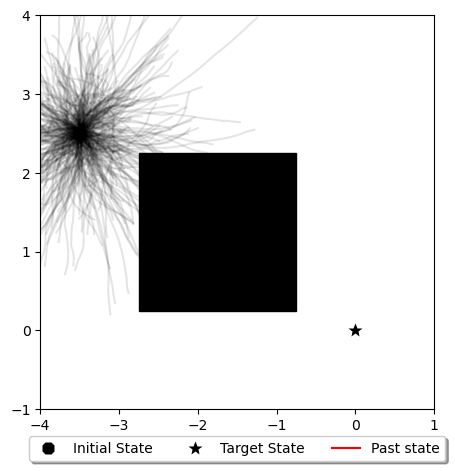

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


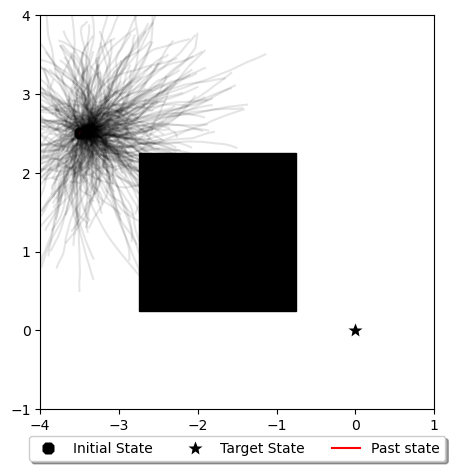

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


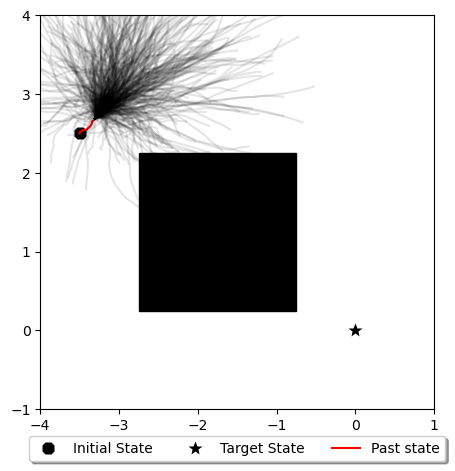

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


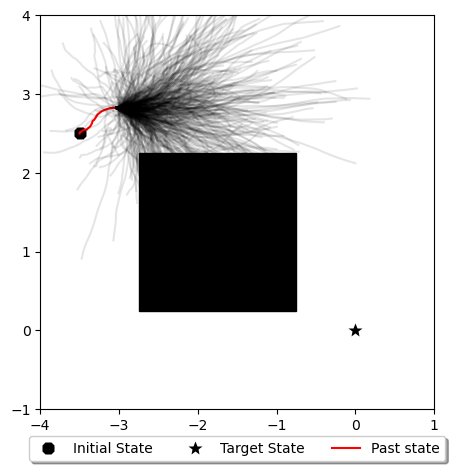

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


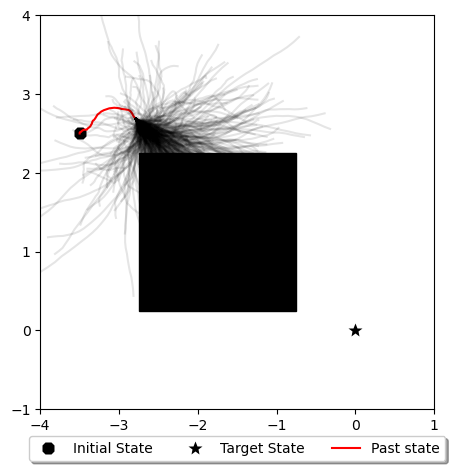

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


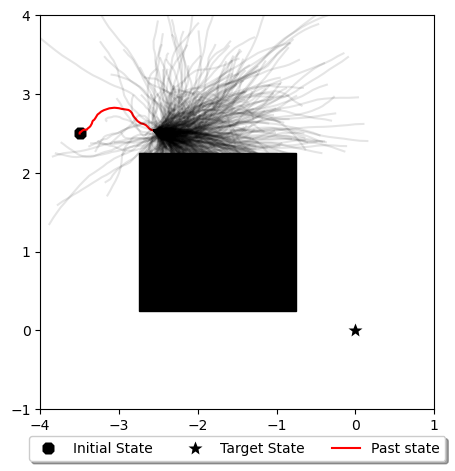

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


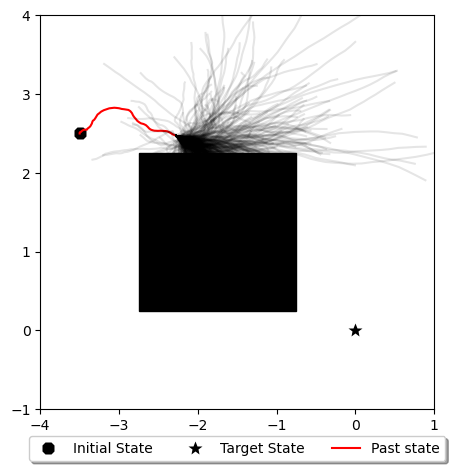

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


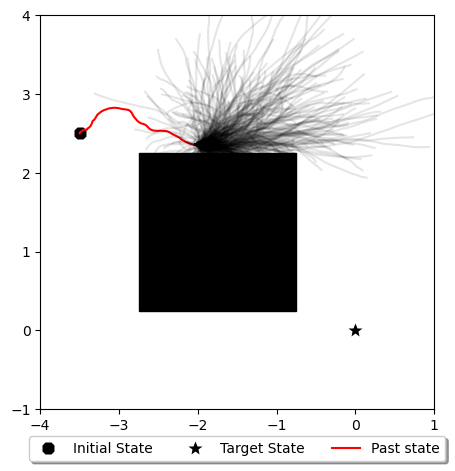

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


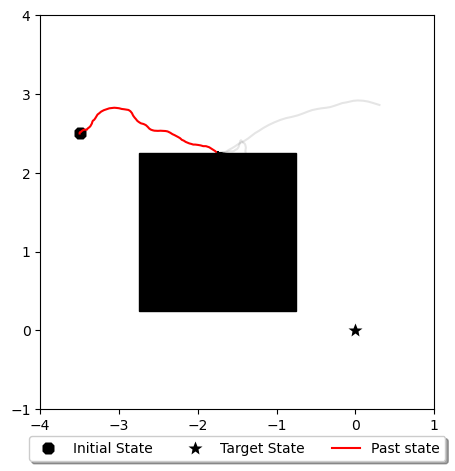

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


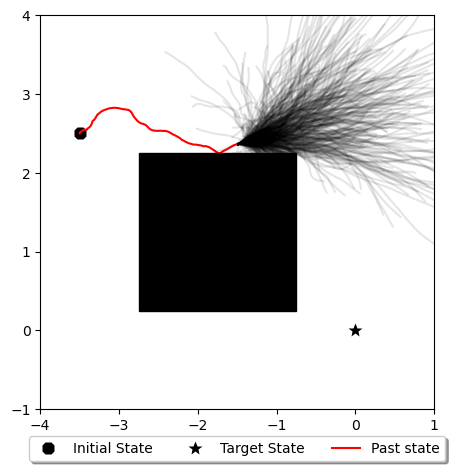

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


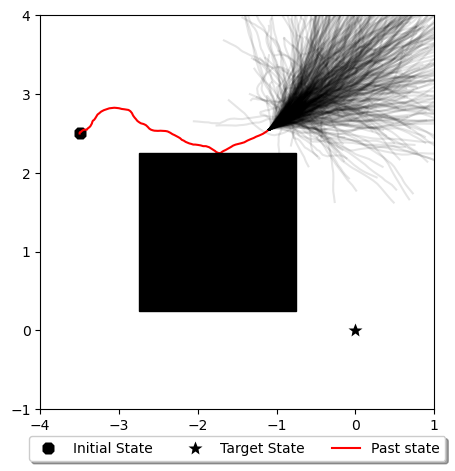

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


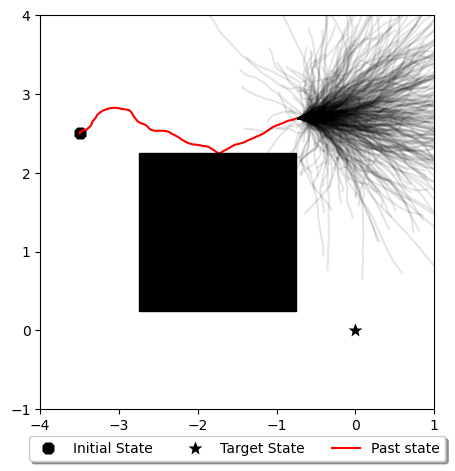

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


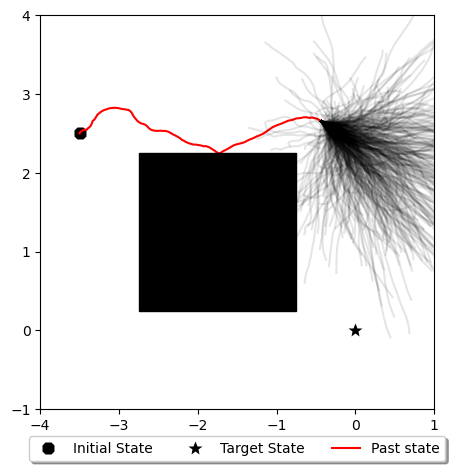

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


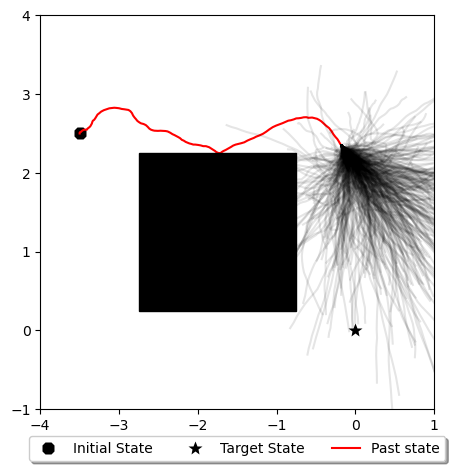

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


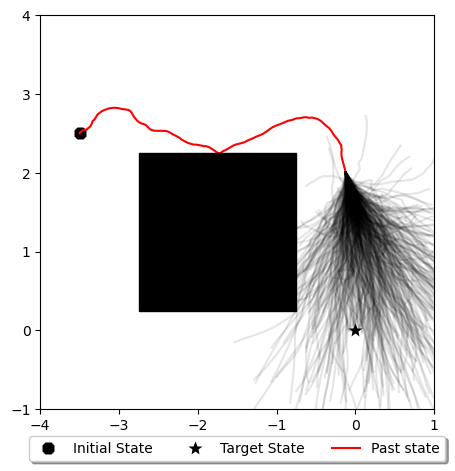

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


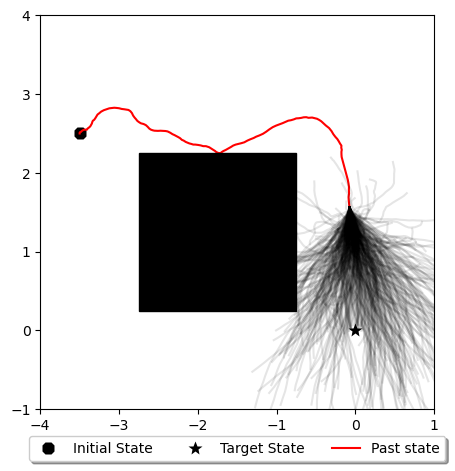

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


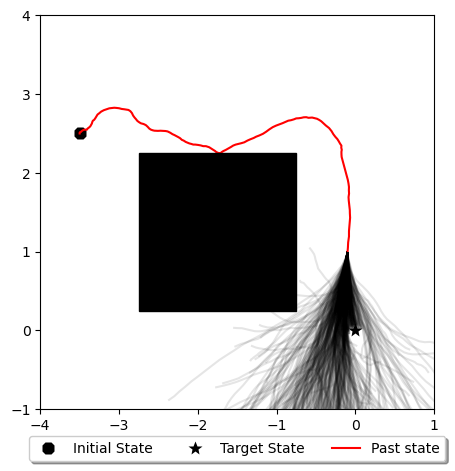

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


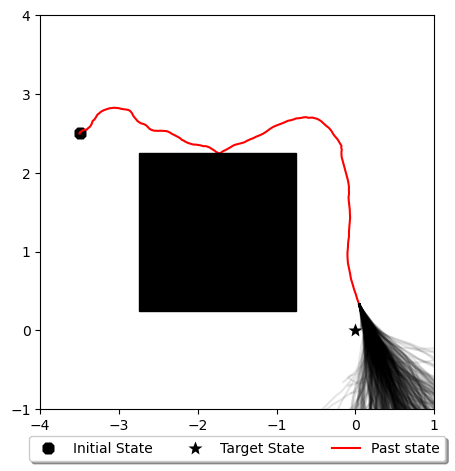

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -6.325834188439355e-05. Stopping optimization.
Goal reached at t=8.75s
Desired threshold reached with value -inf. Stopping optimization.


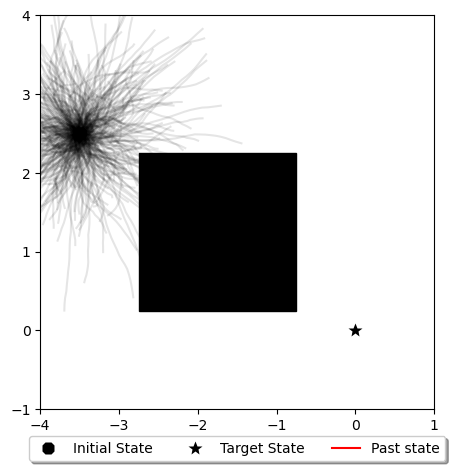

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


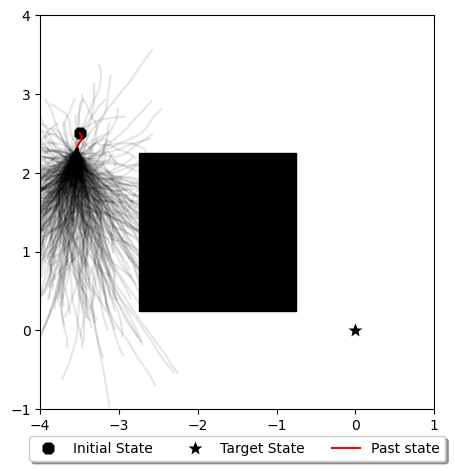

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


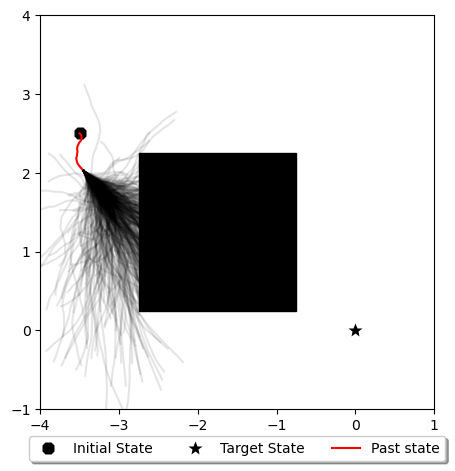

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


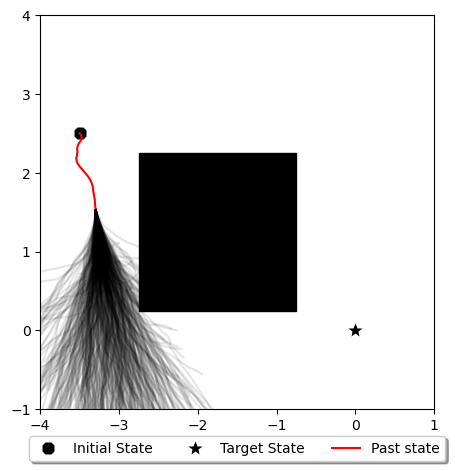

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


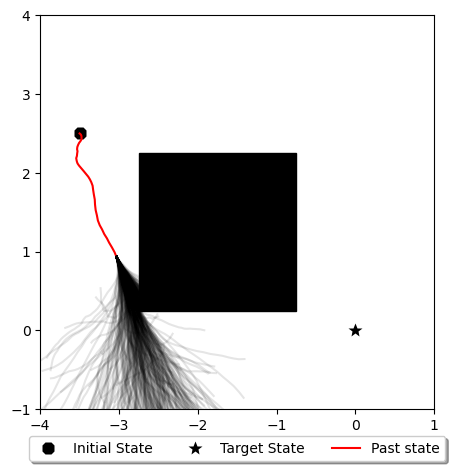

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


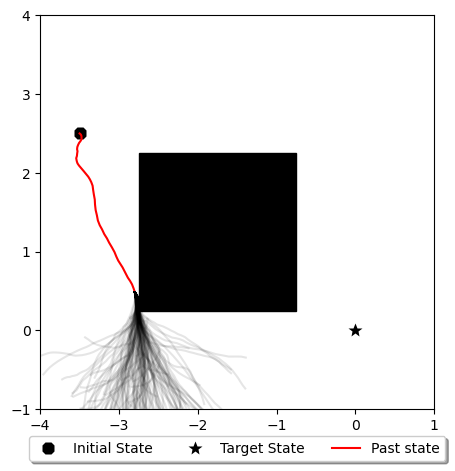

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


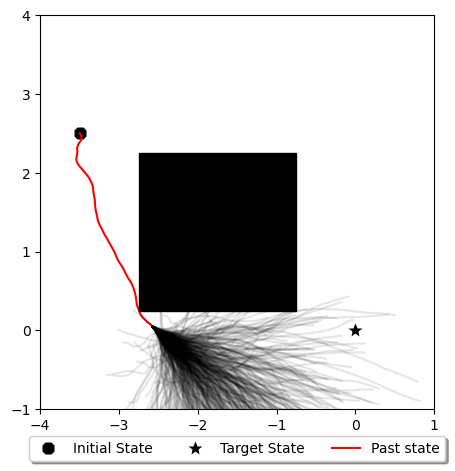

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


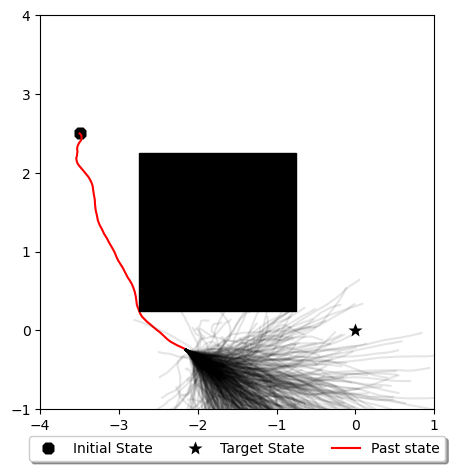

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


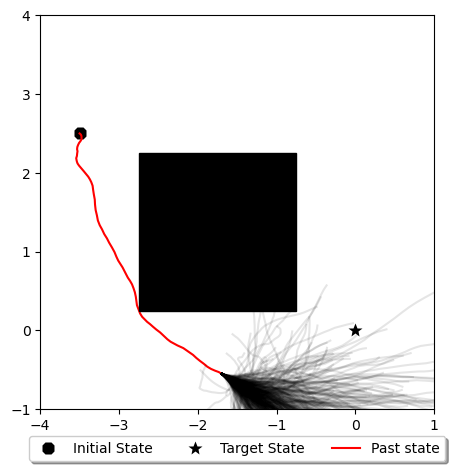

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


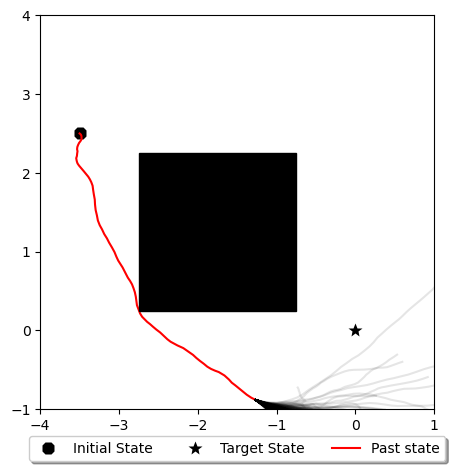

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


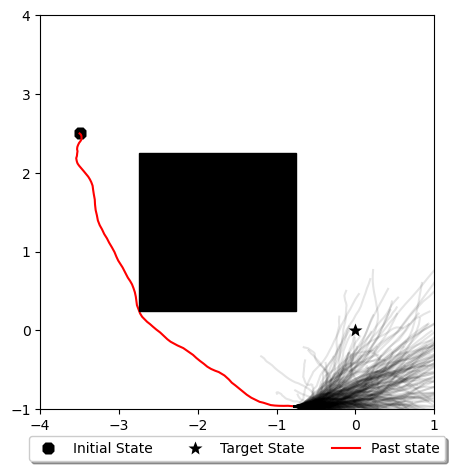

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


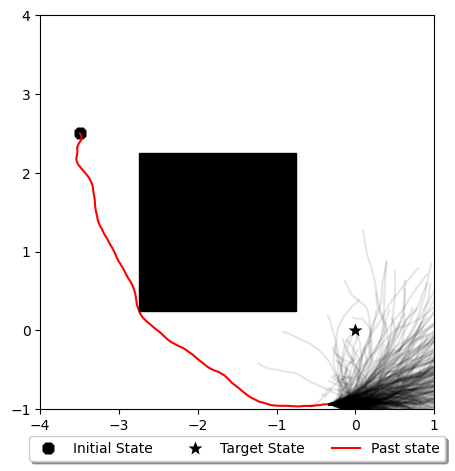

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


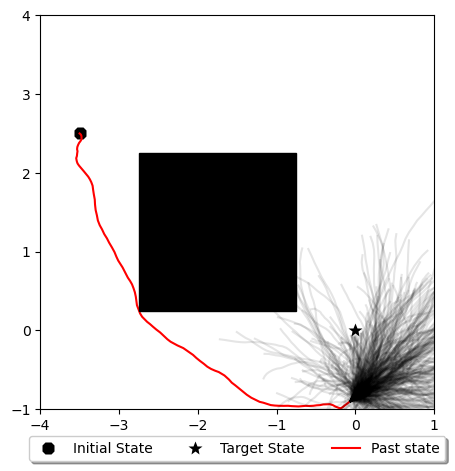

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


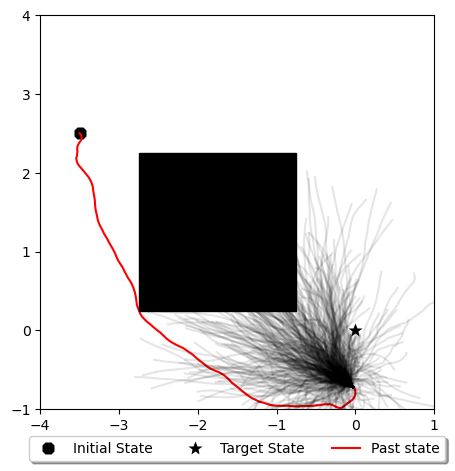

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


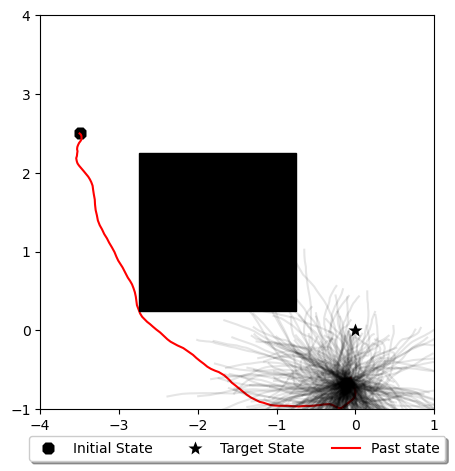

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


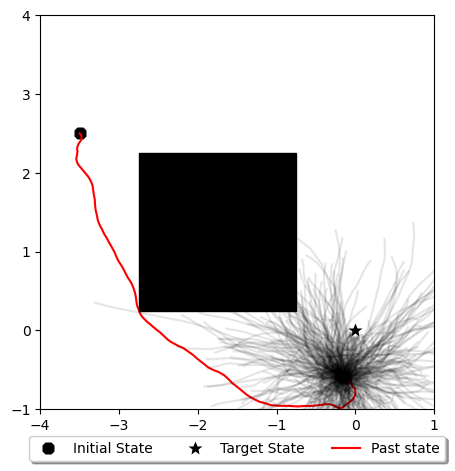

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


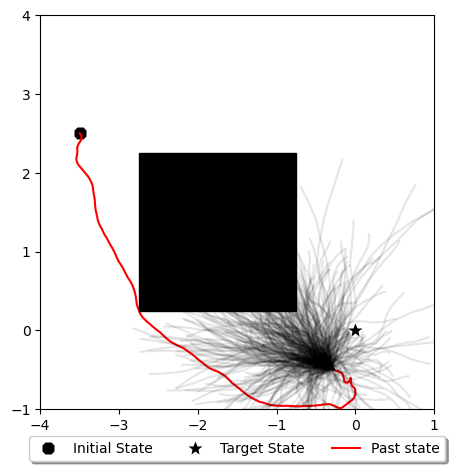

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


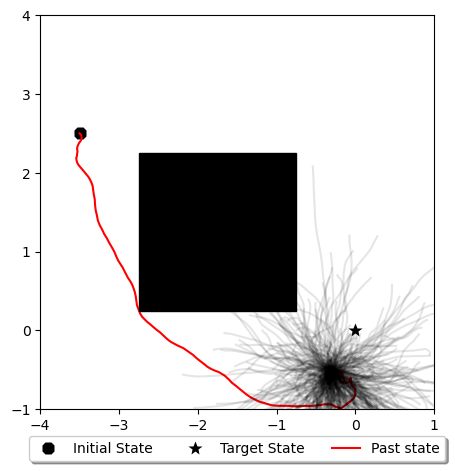

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


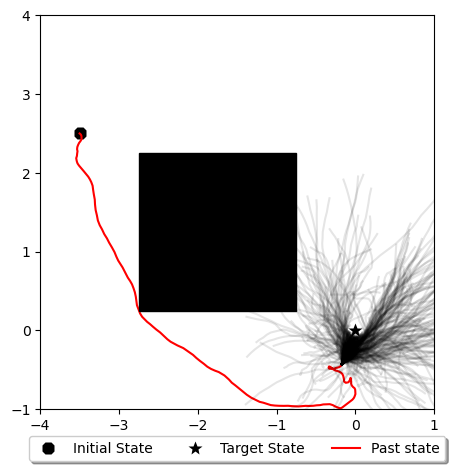

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


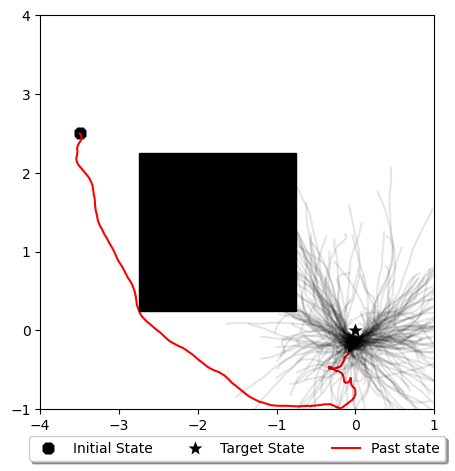

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -9.547327833815714e-05. Stopping optimization.
Goal reached at t=9.80s
Desired threshold reached with value -inf. Stopping optimization.


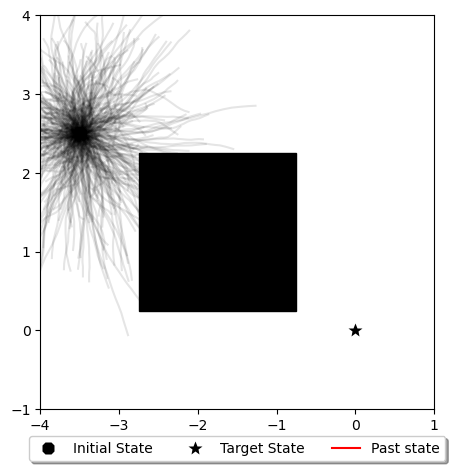

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


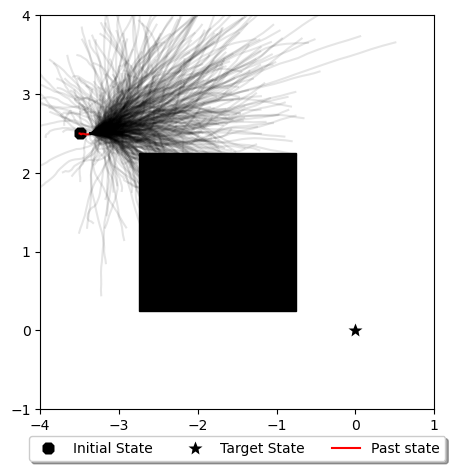

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


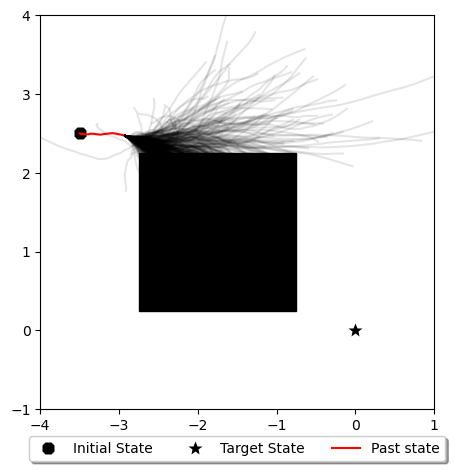

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


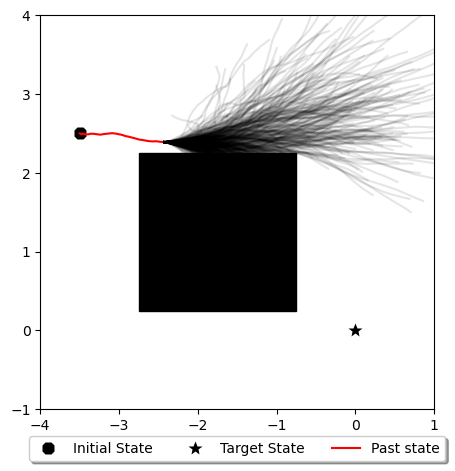

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


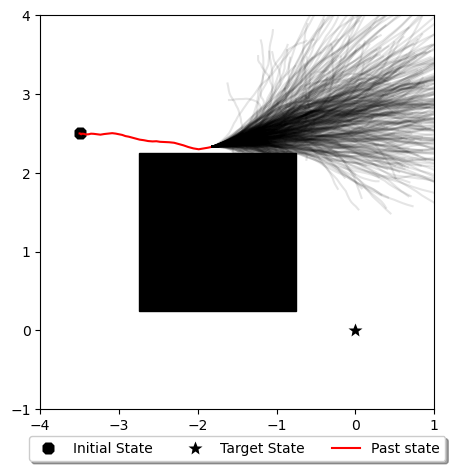

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


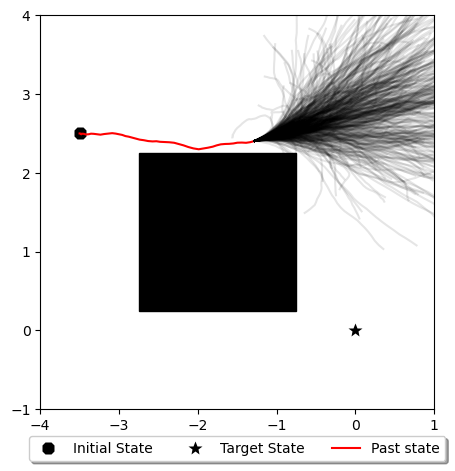

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


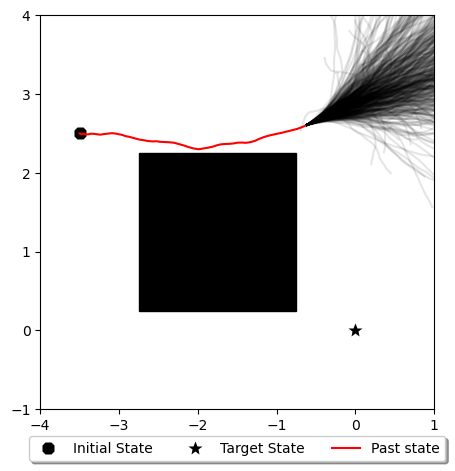

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


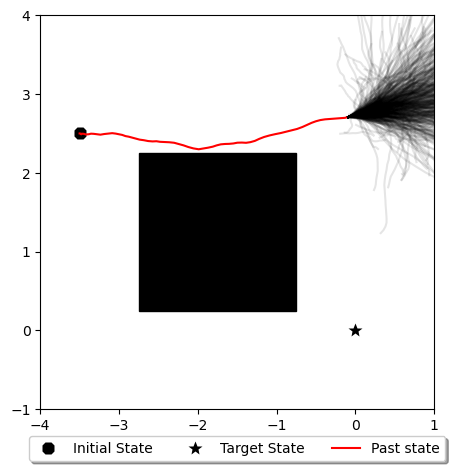

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


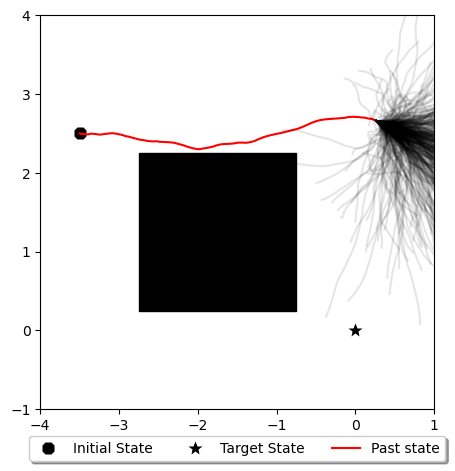

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


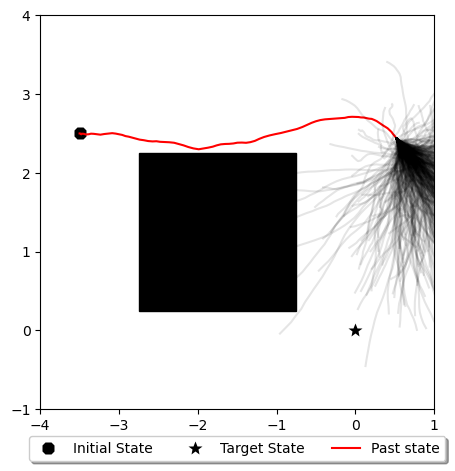

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


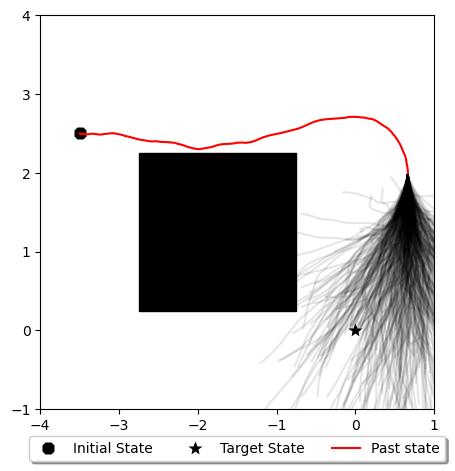

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


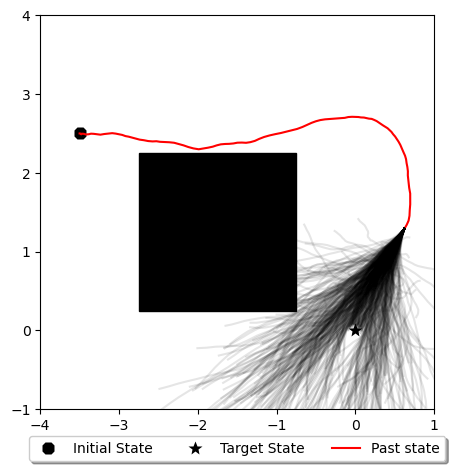

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


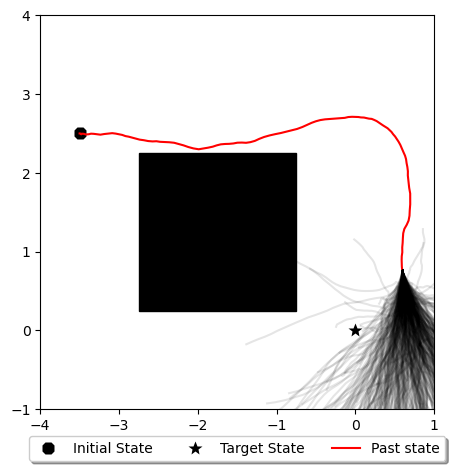

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


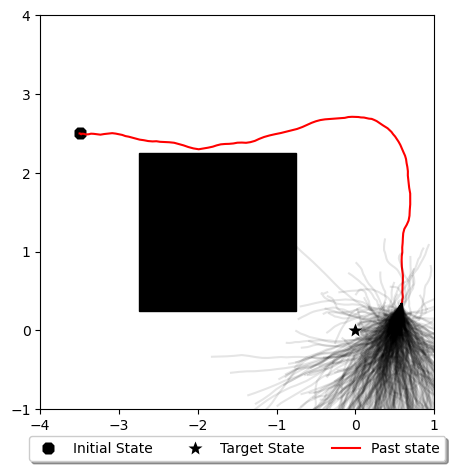

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


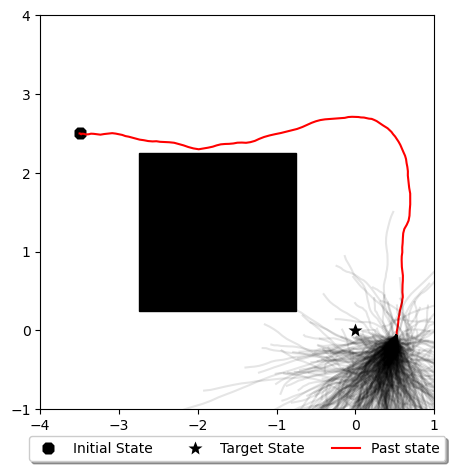

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


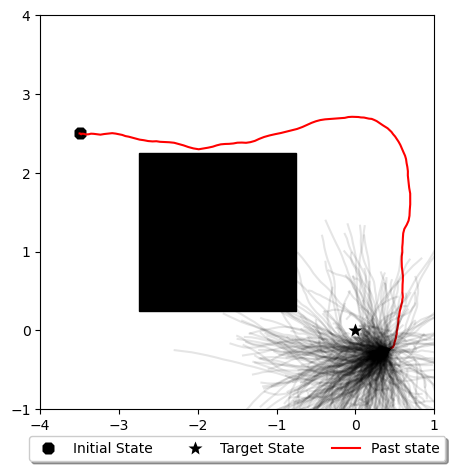

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


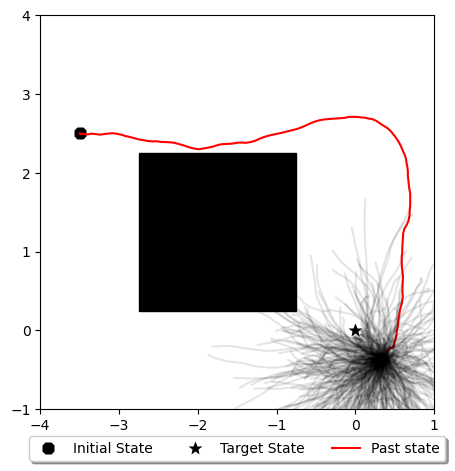

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


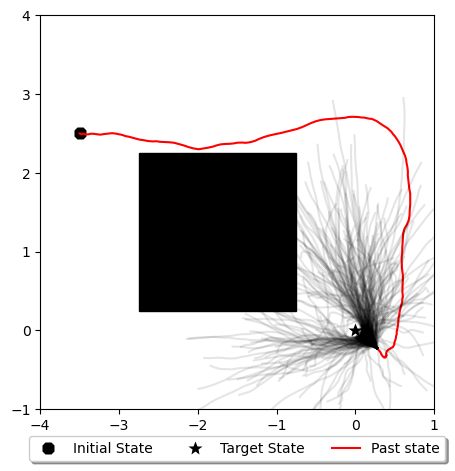

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


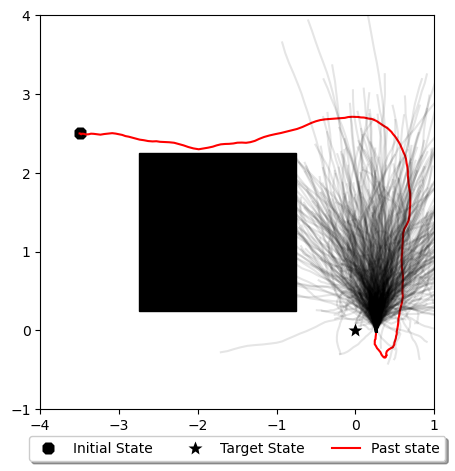

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


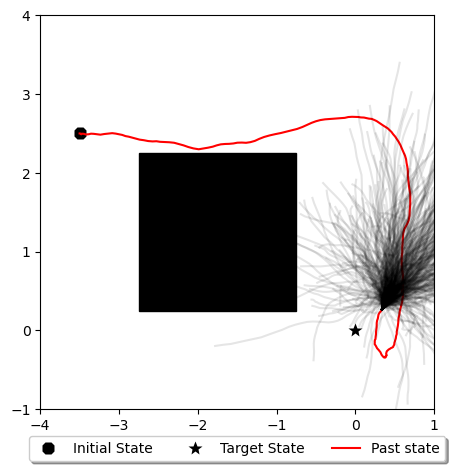

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


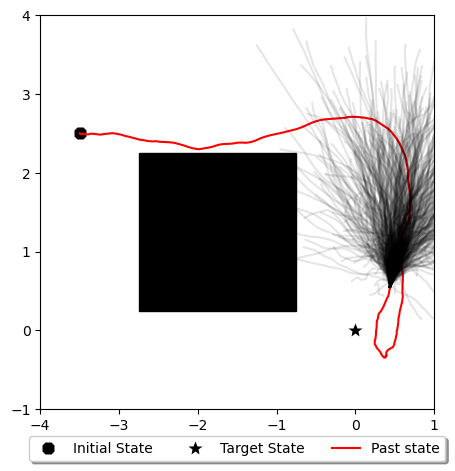

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


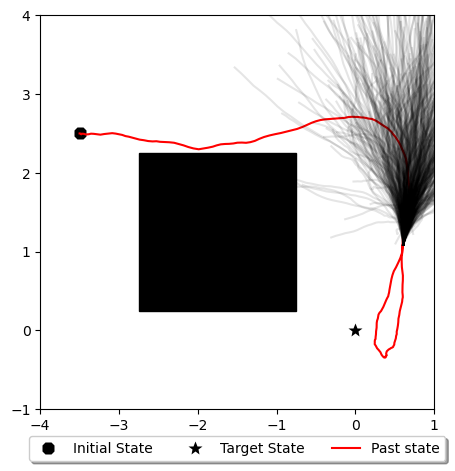

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


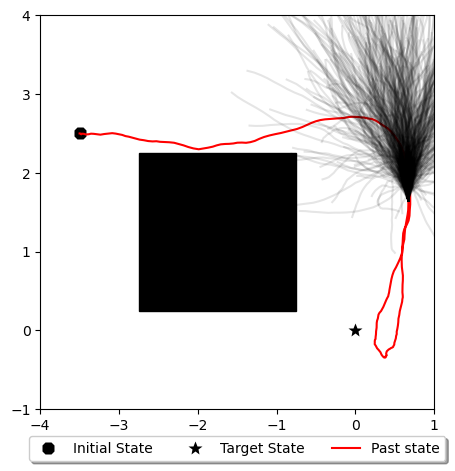

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


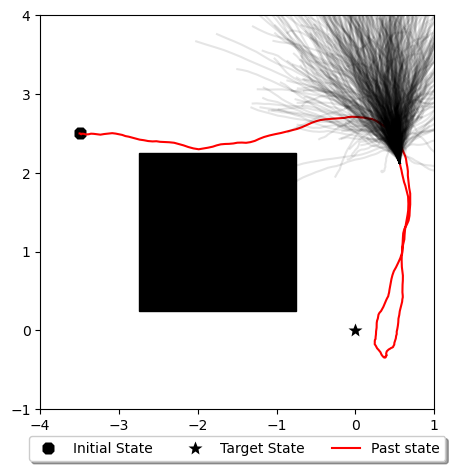

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


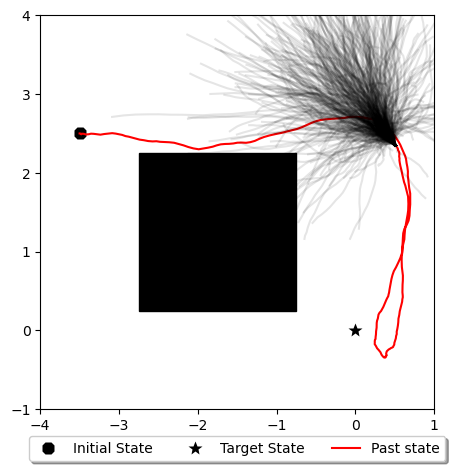

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


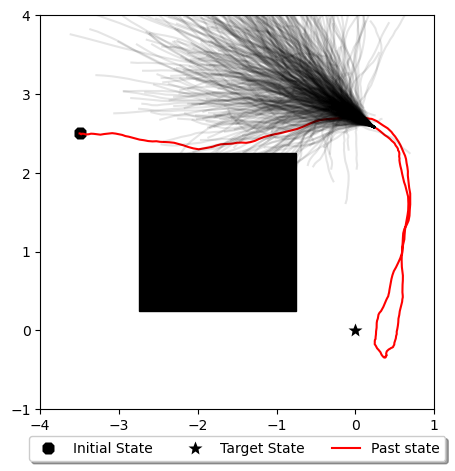

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


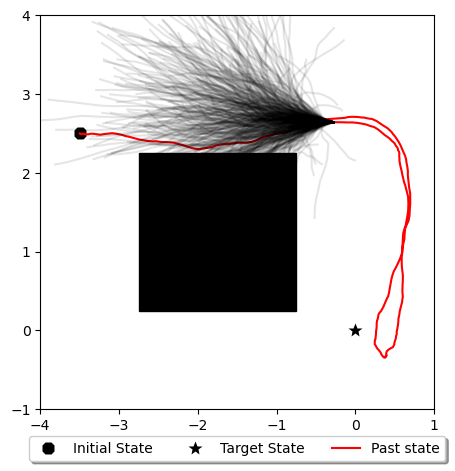

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


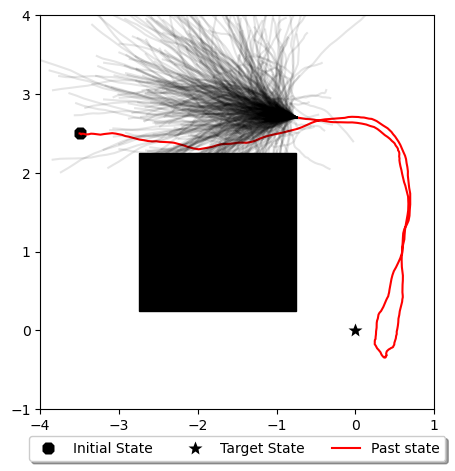

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


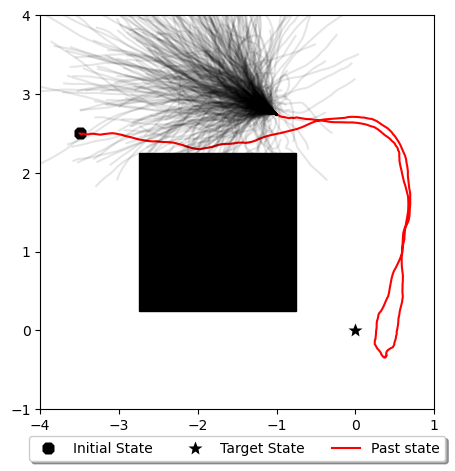

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


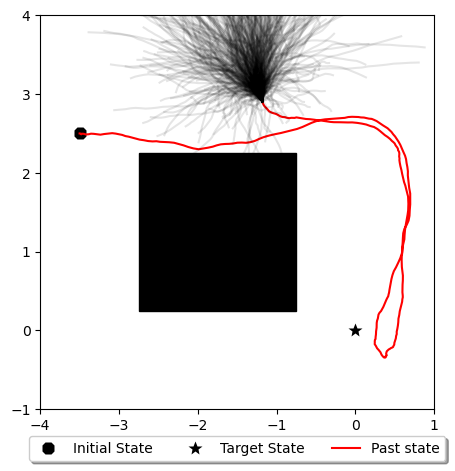

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


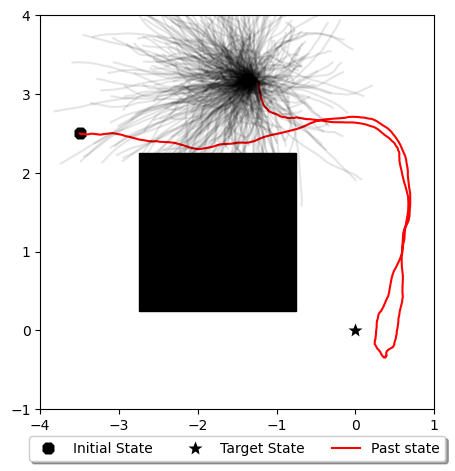

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


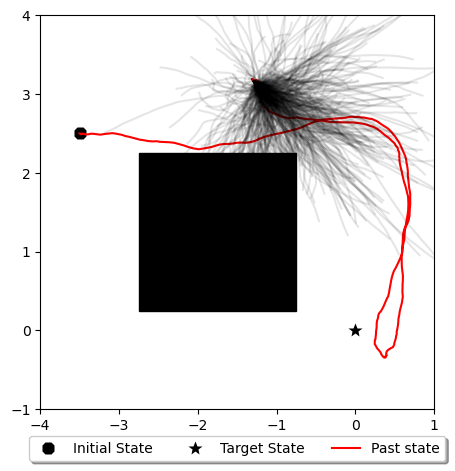

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


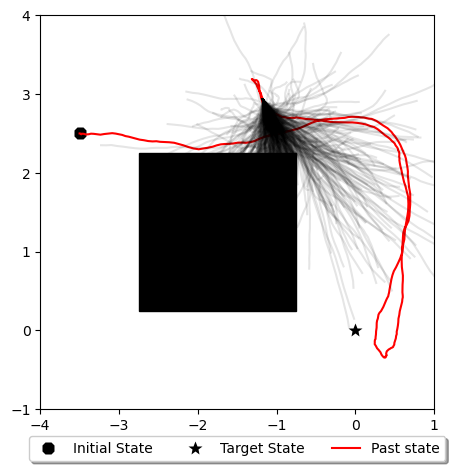

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


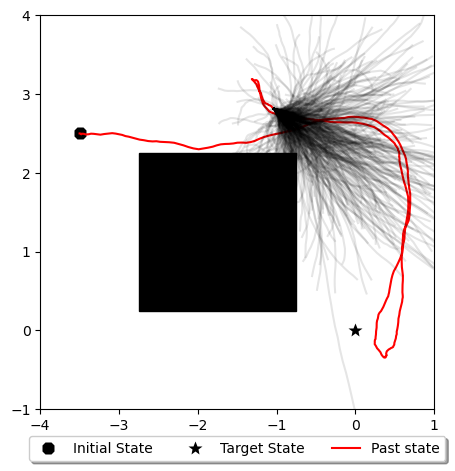

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


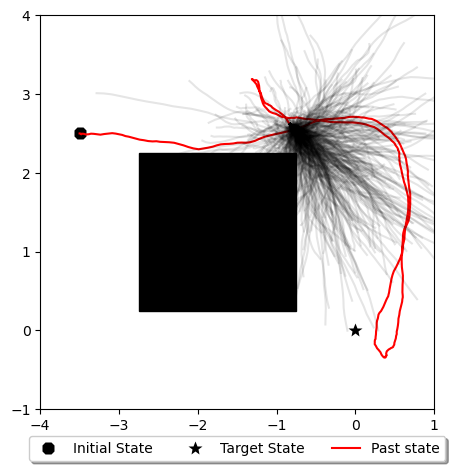

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


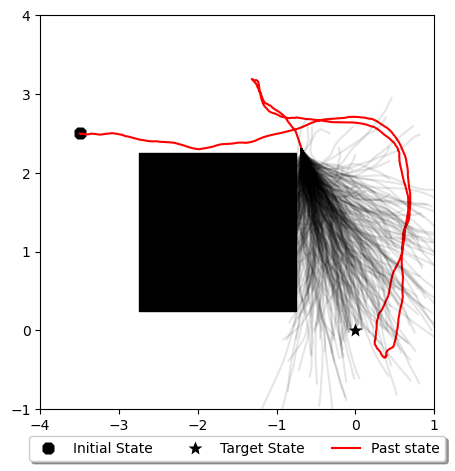

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


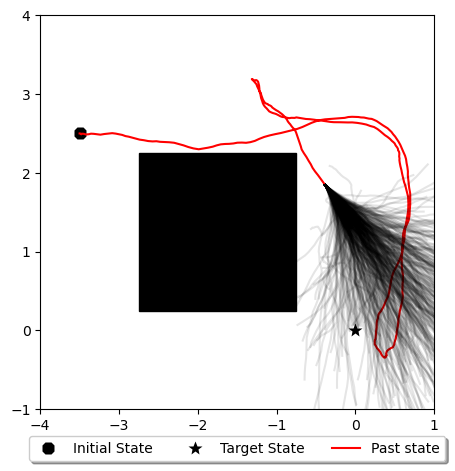

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


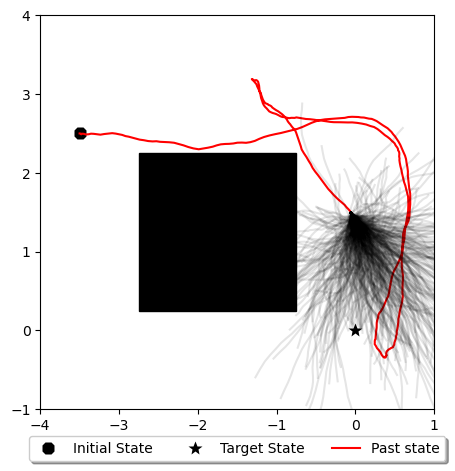

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


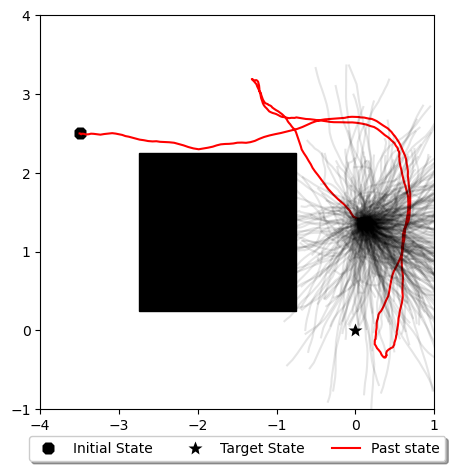

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


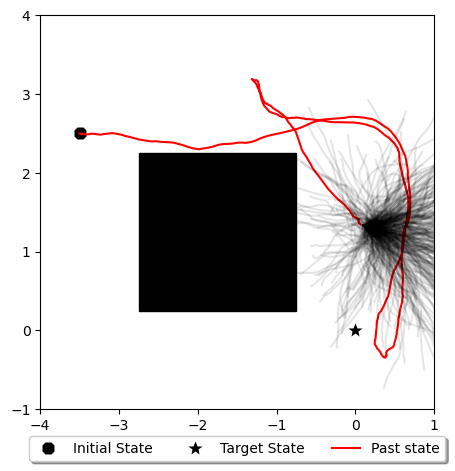

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


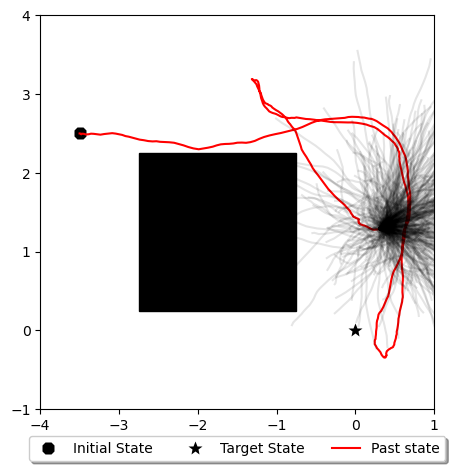

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


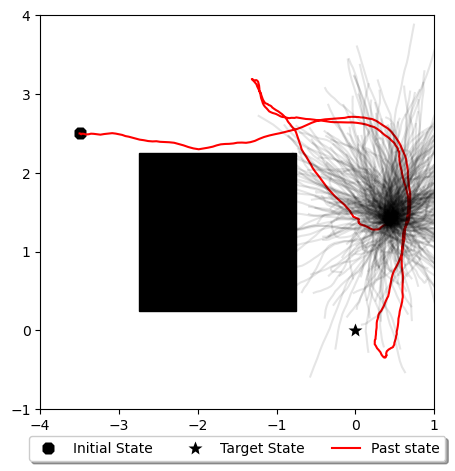

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


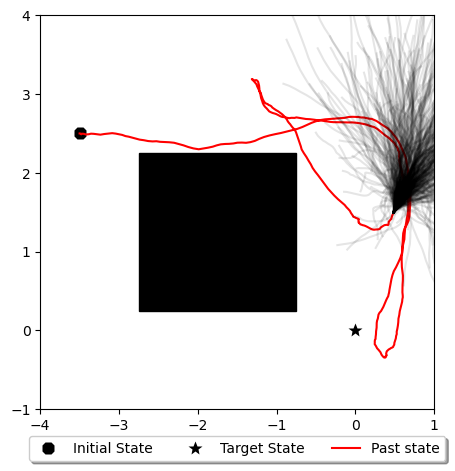

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


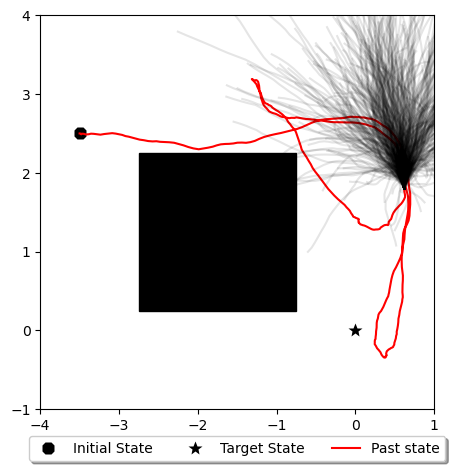

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


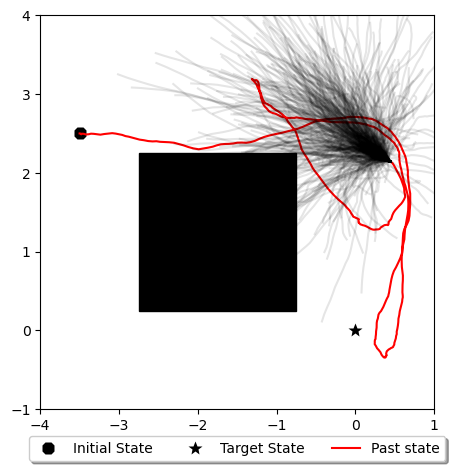

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


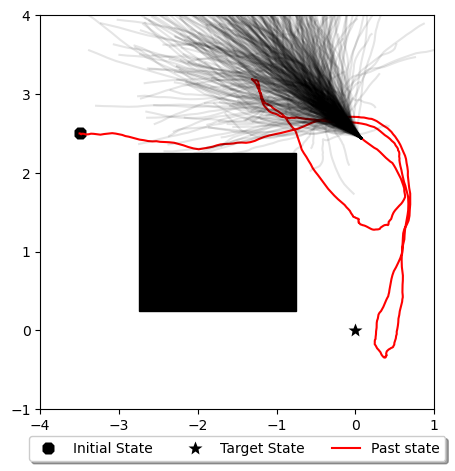

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


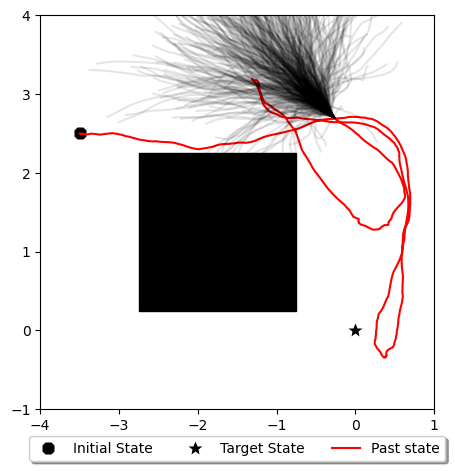

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


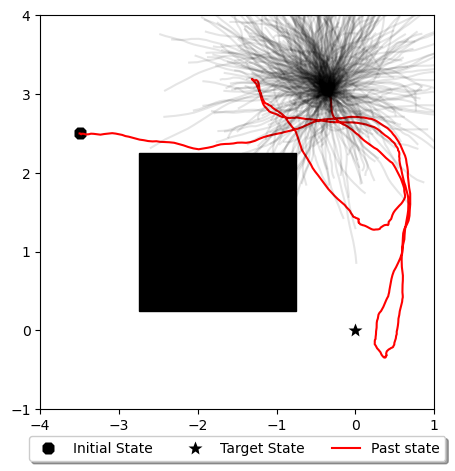

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


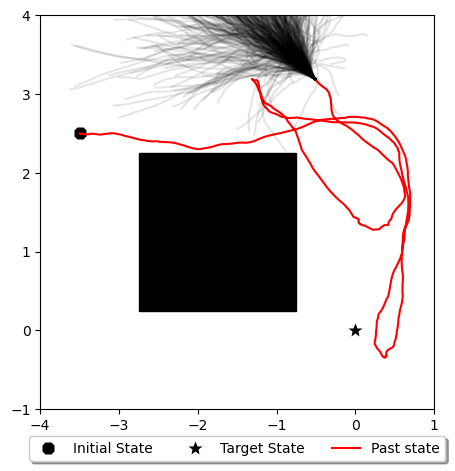

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


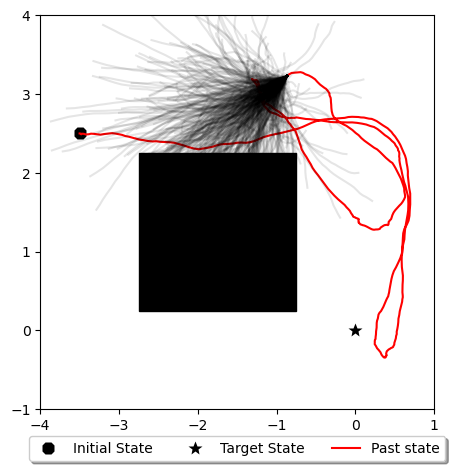

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


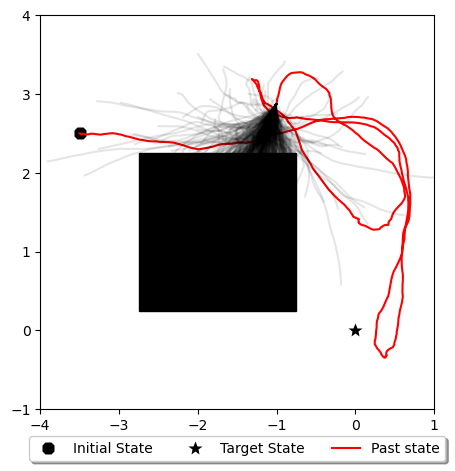

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


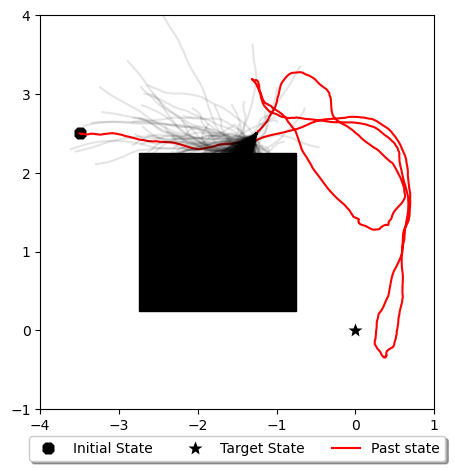

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


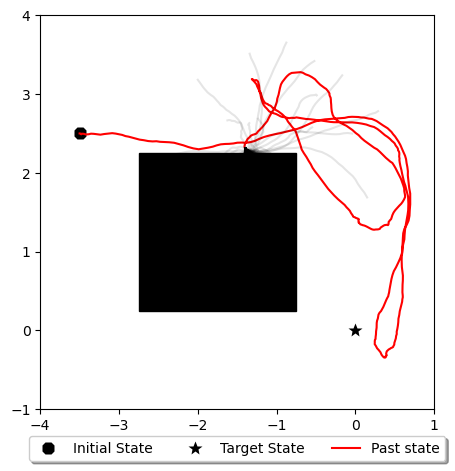

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


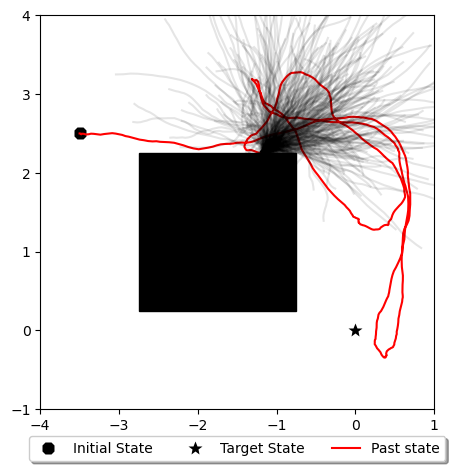

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


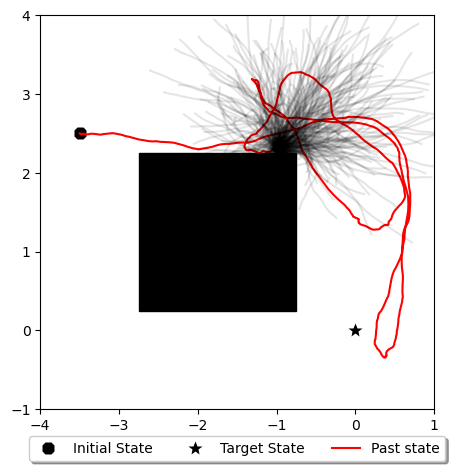

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


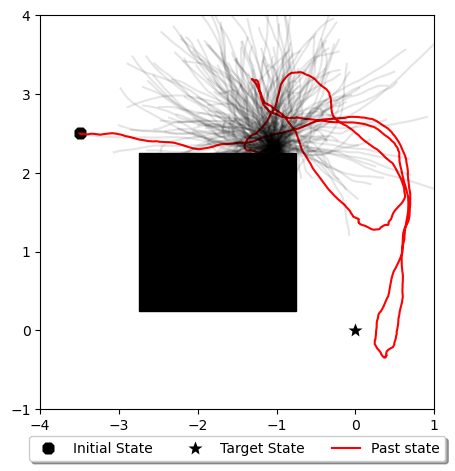

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


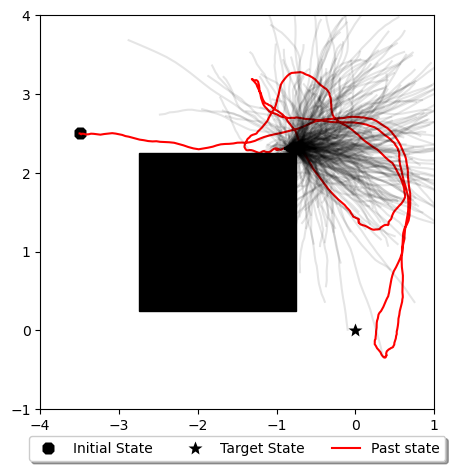

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


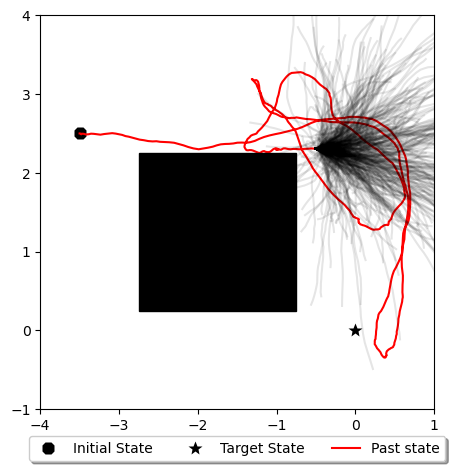

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


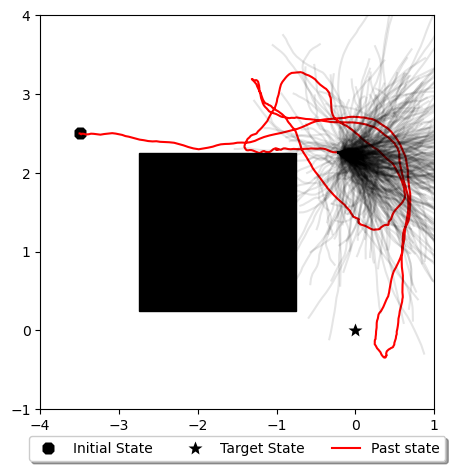

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


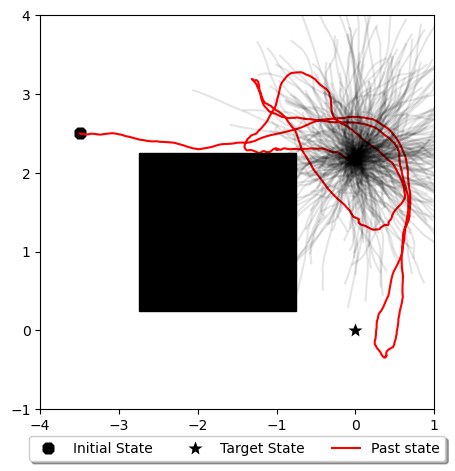

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


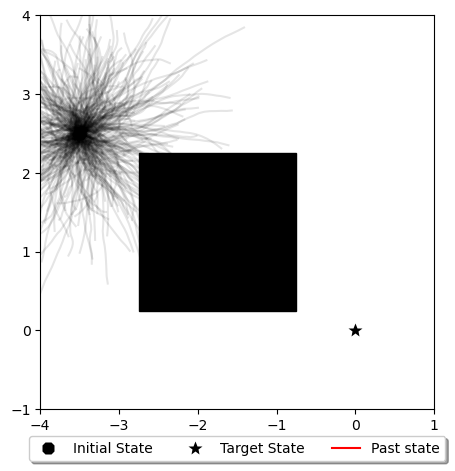

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


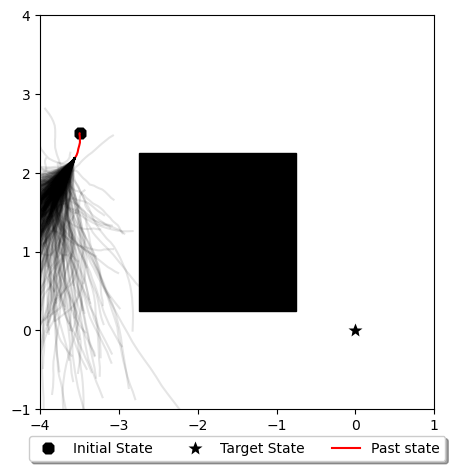

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


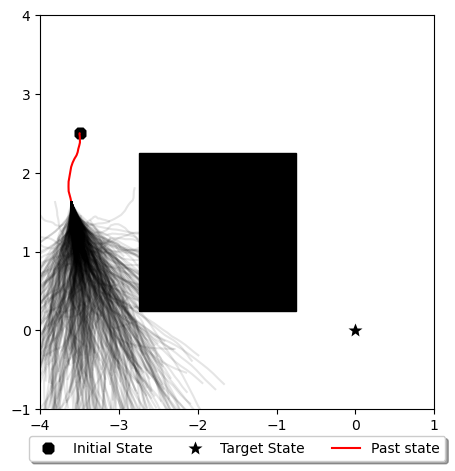

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


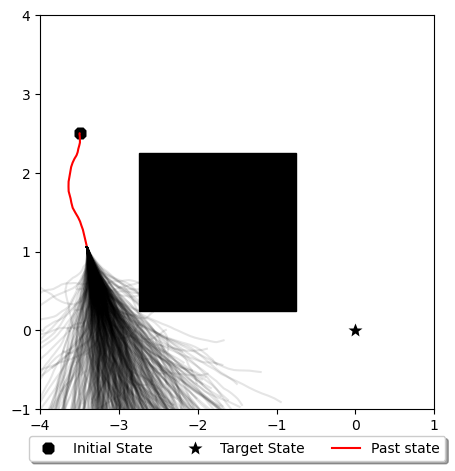

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


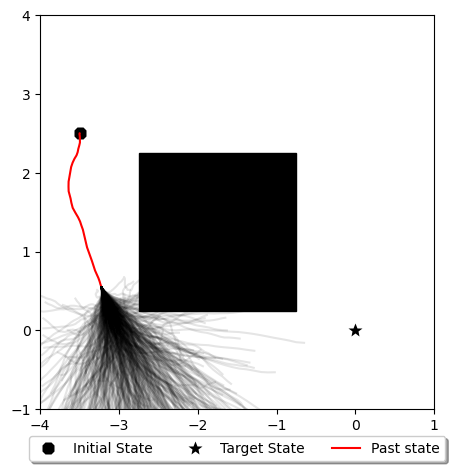

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


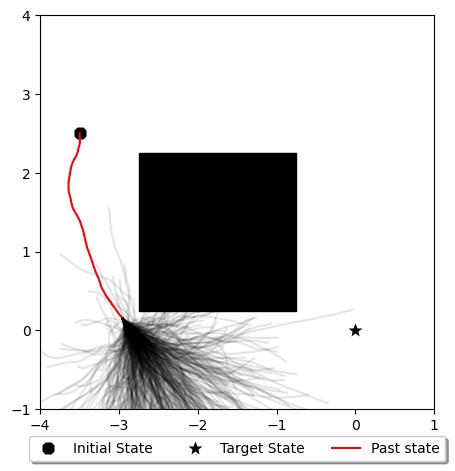

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


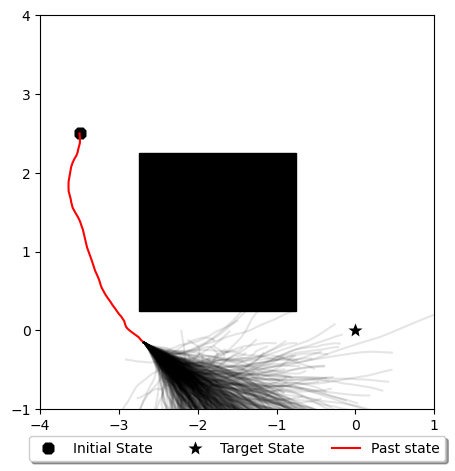

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


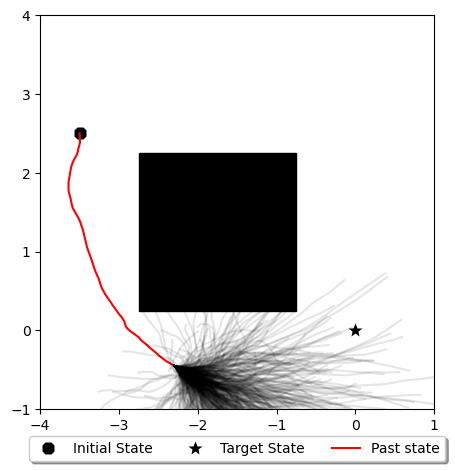

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


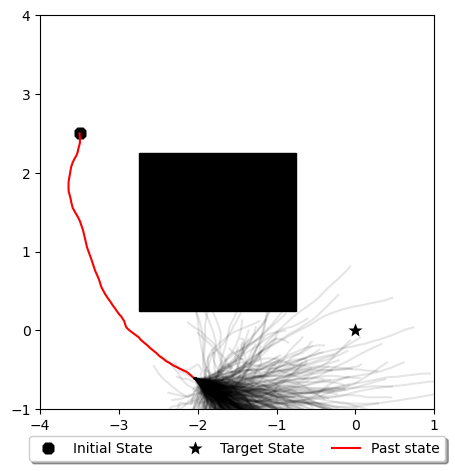

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


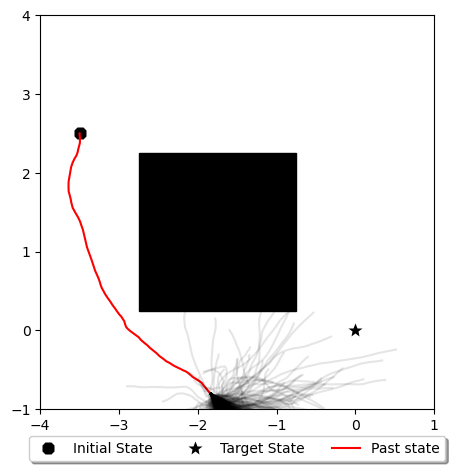

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


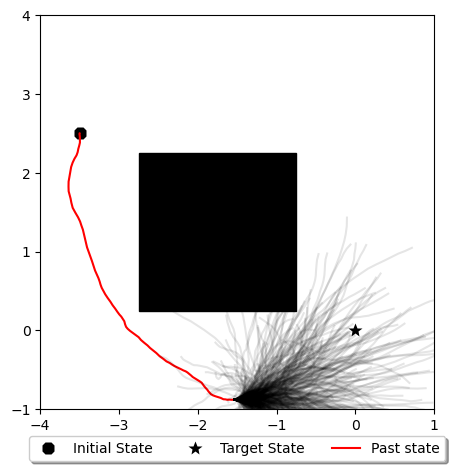

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


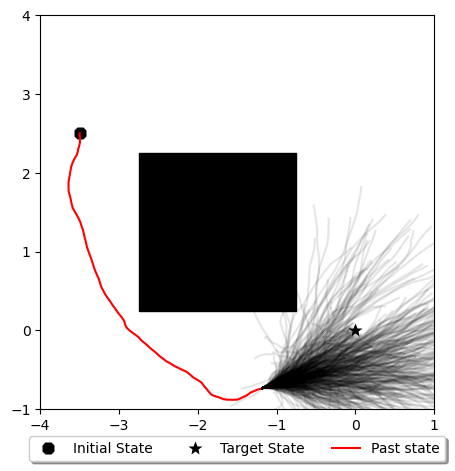

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


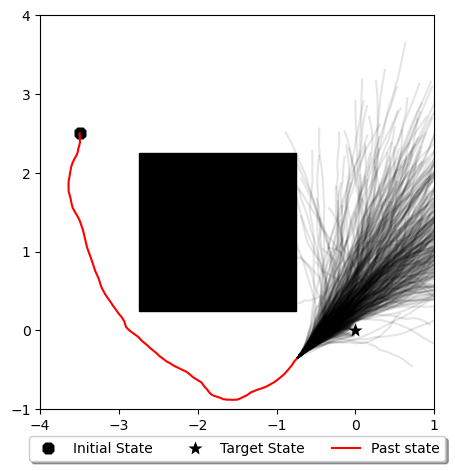

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


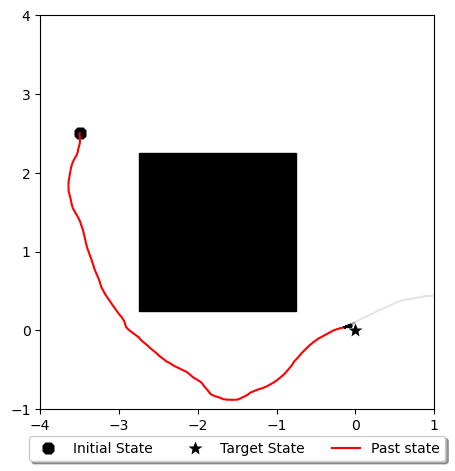

Desired threshold reached with value -7.675093716035483e-05. Stopping optimization.
Goal reached at t=6.55s
Desired threshold reached with value -inf. Stopping optimization.


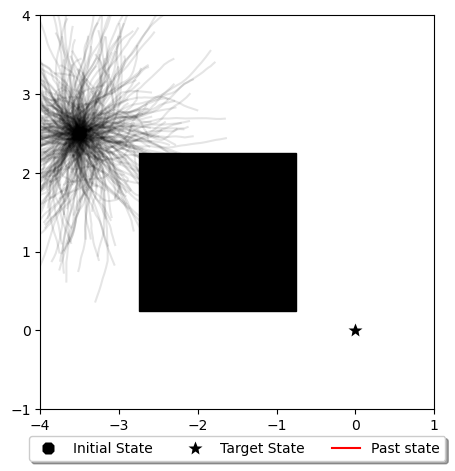

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


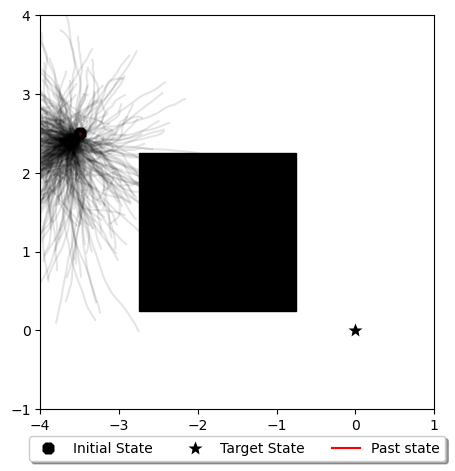

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


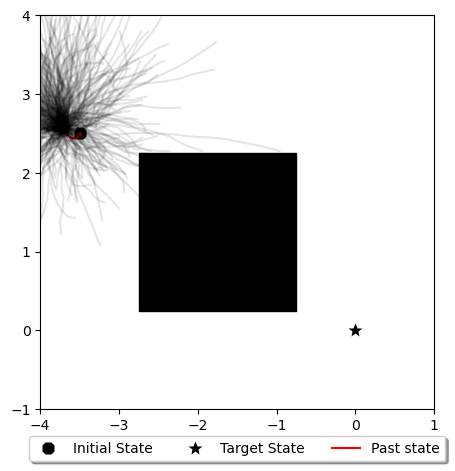

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


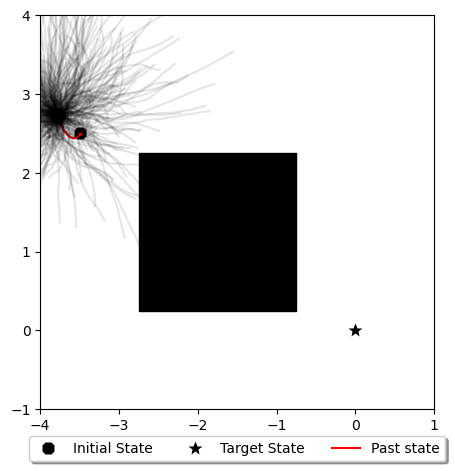

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


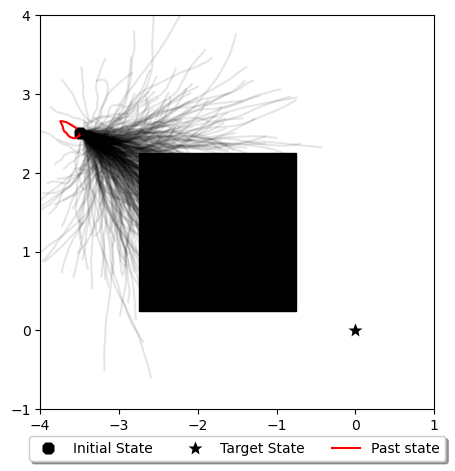

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


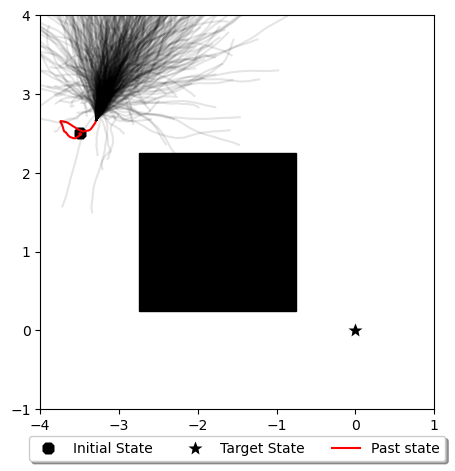

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


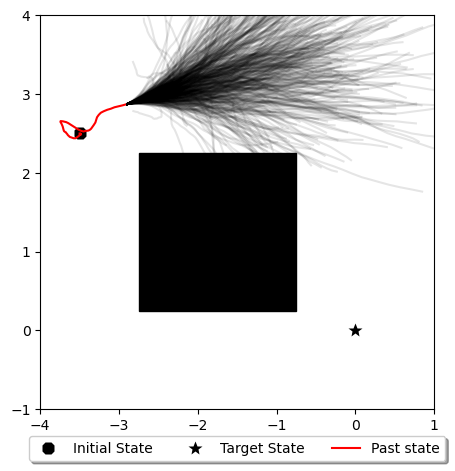

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


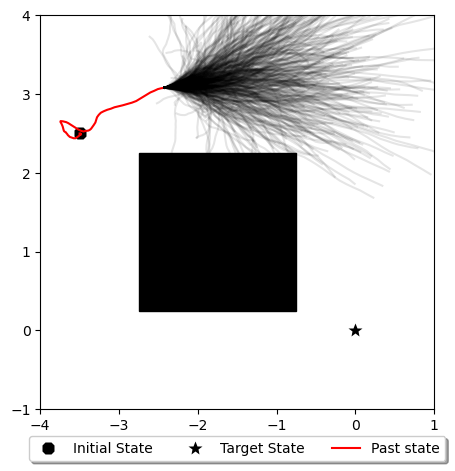

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


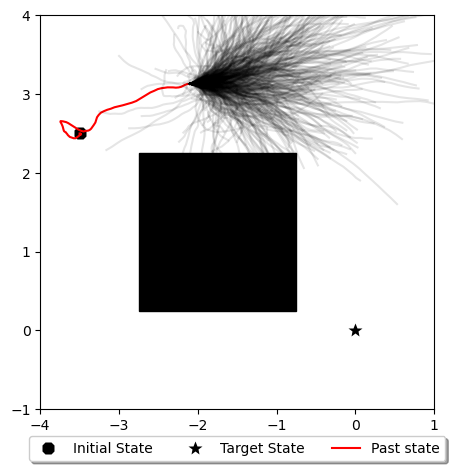

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


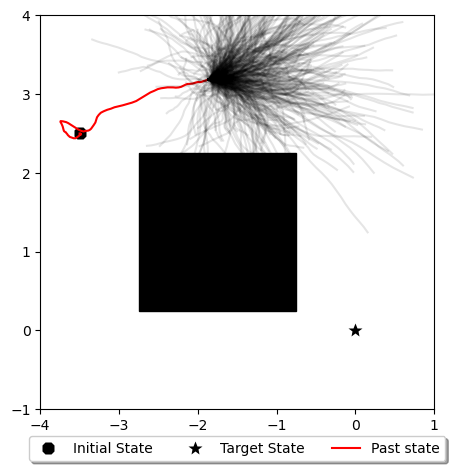

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


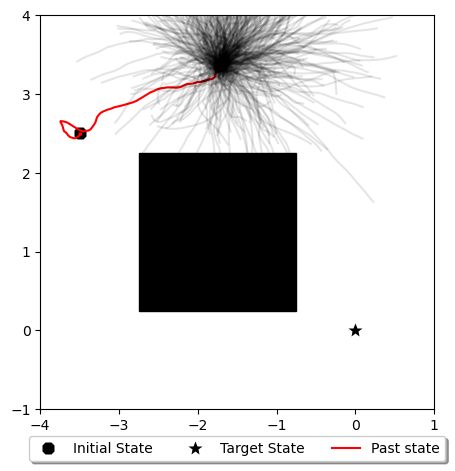

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


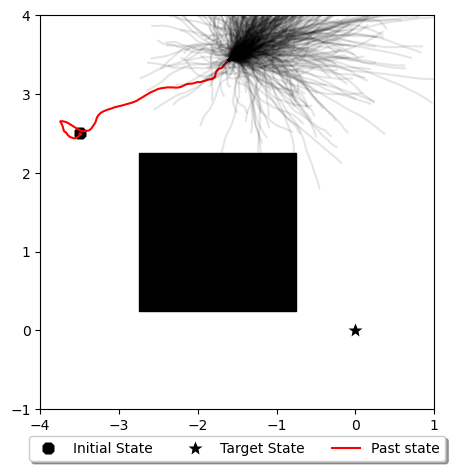

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


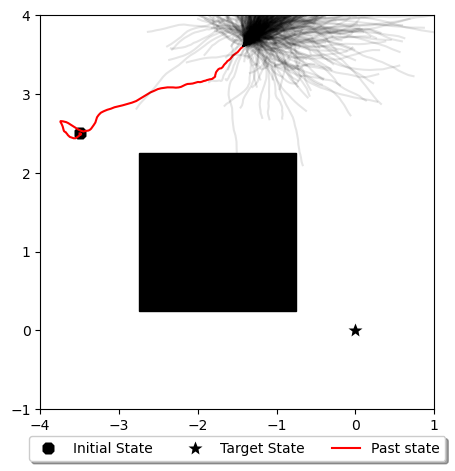

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


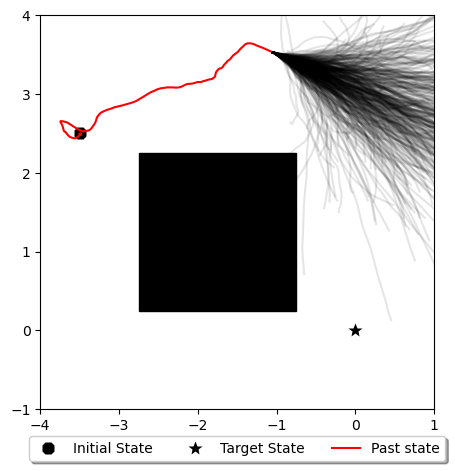

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


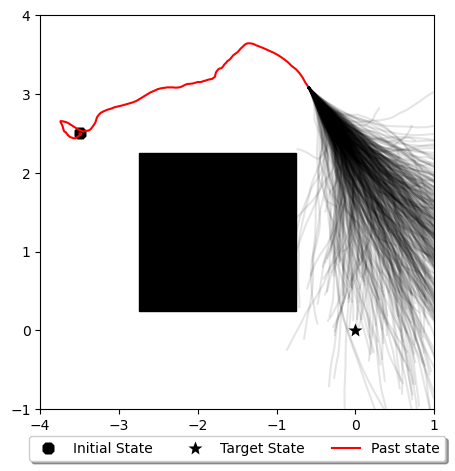

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


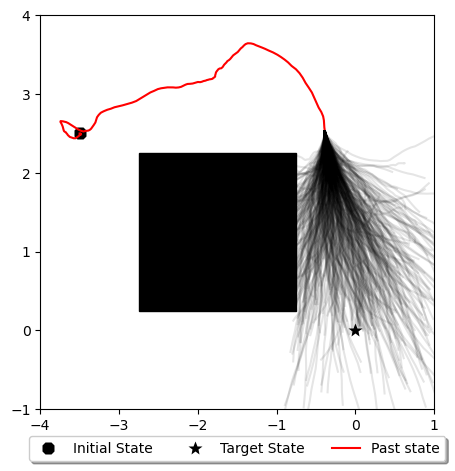

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


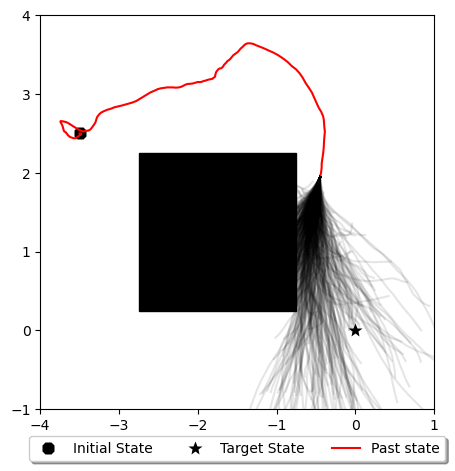

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


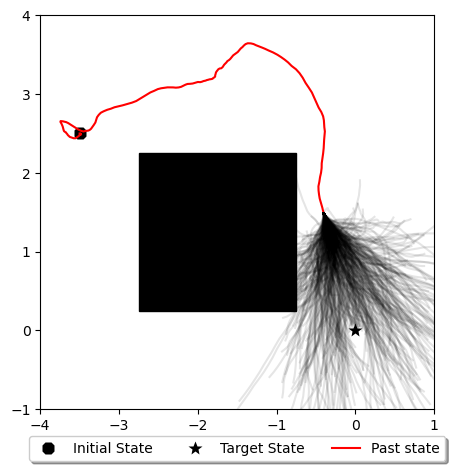

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


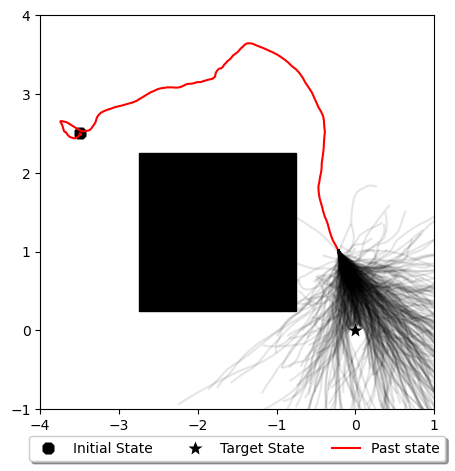

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


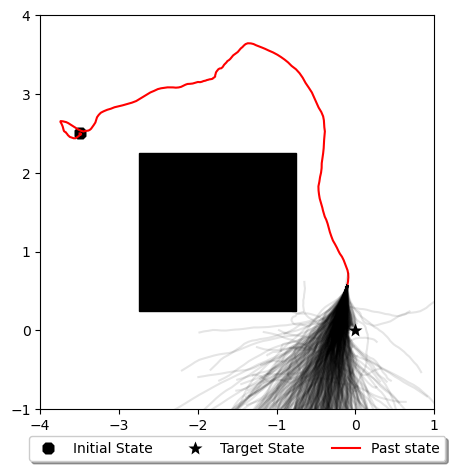

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


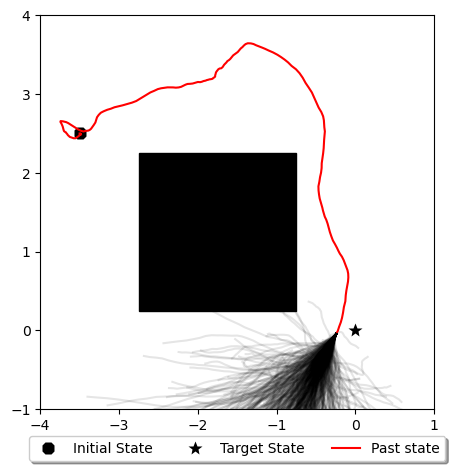

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


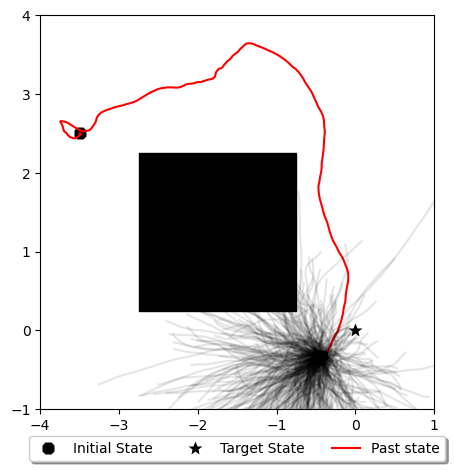

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


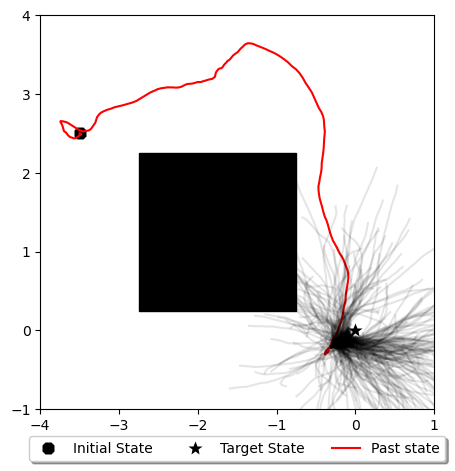

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -0.0009695190998347431. Stopping optimization.
Desired threshold reached with value -0.00024101397315972028. Stopping optimization.
Desired threshold reached with value -7.950731072325093e-05. Stopping optimization.
Goal reached at t=11.45s
Desired threshold reached with value -inf. Stopping optimization.


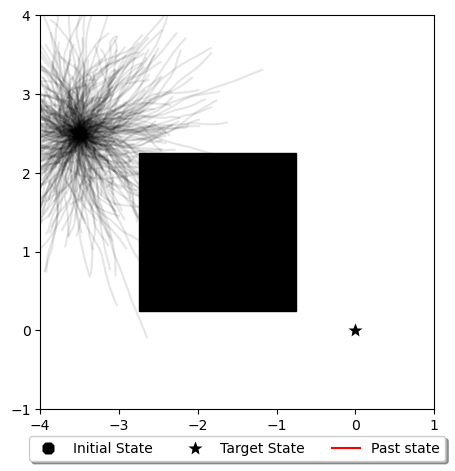

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


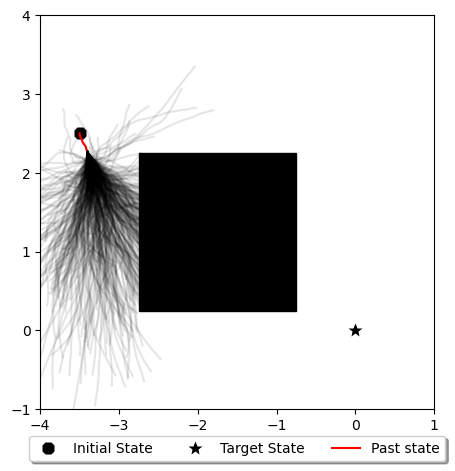

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


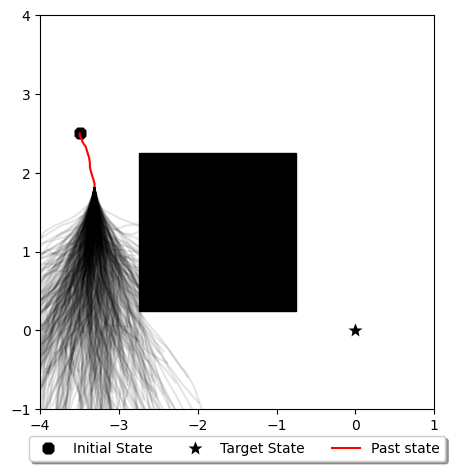

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


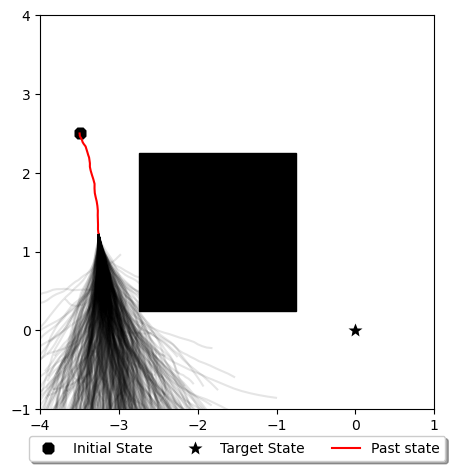

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


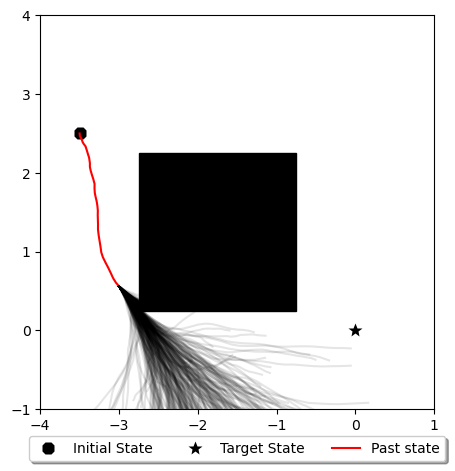

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


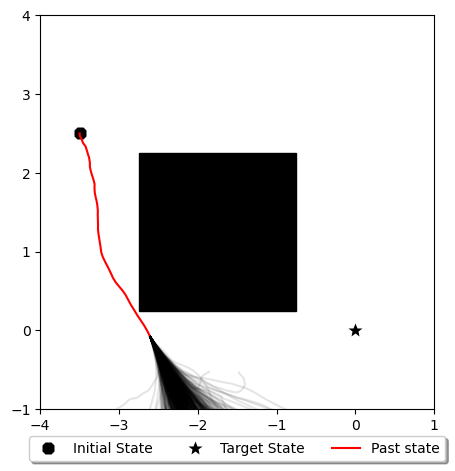

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


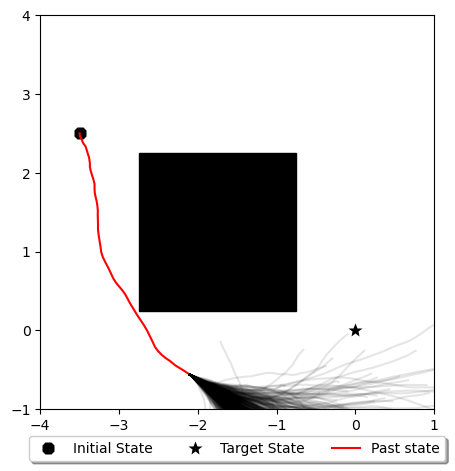

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


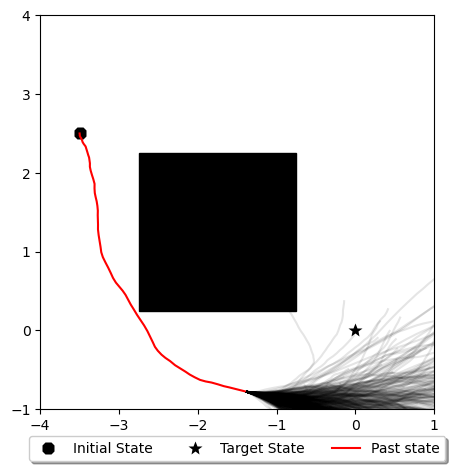

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


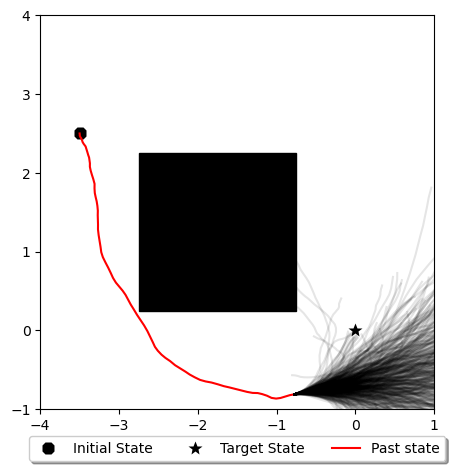

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


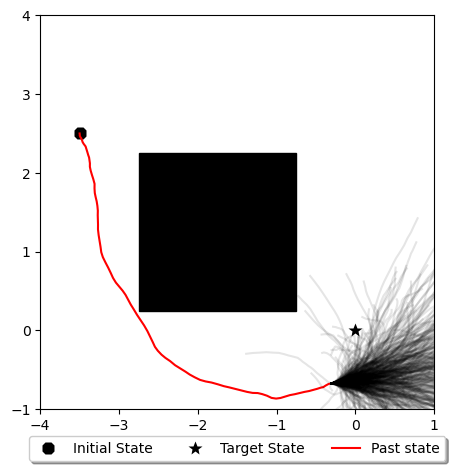

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


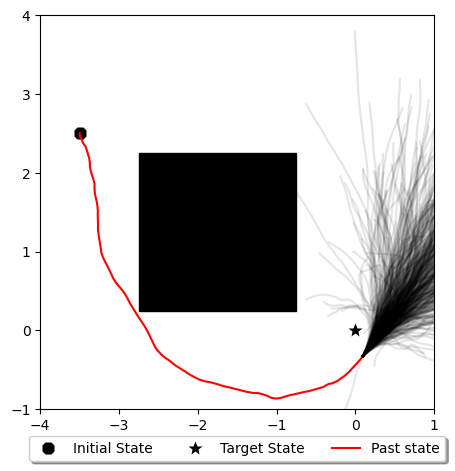

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


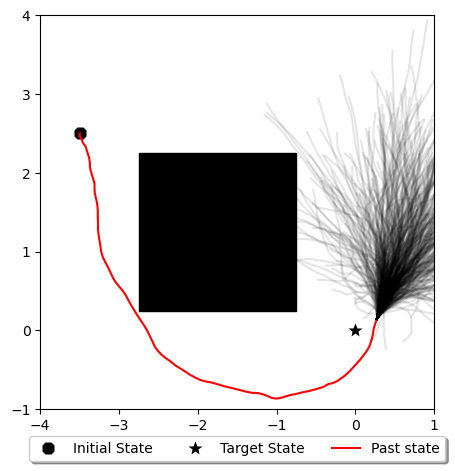

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


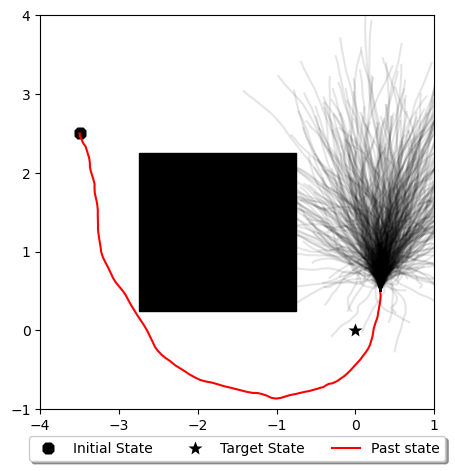

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


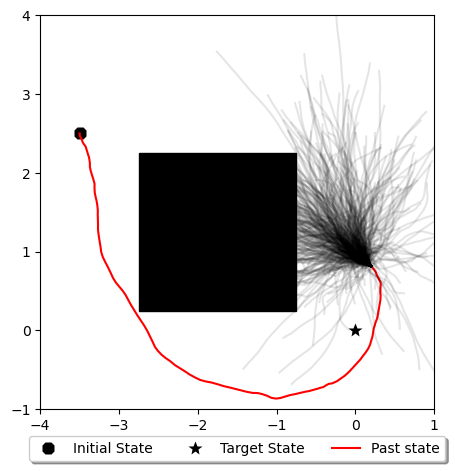

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


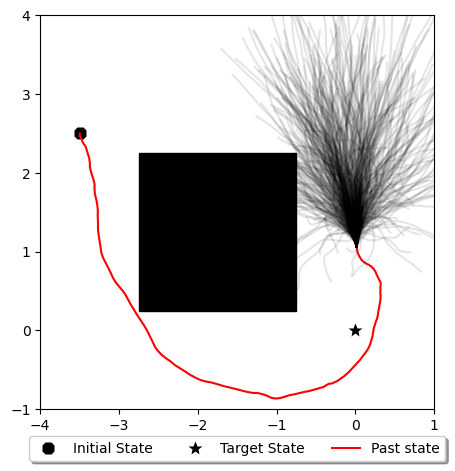

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


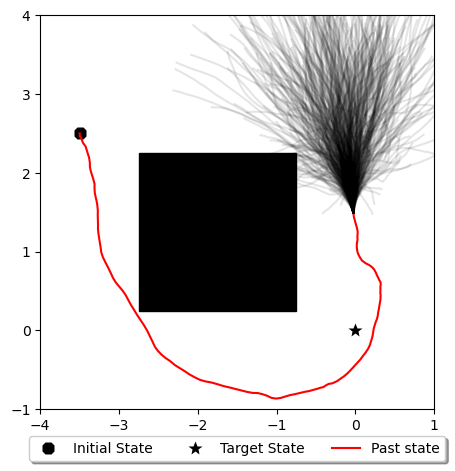

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


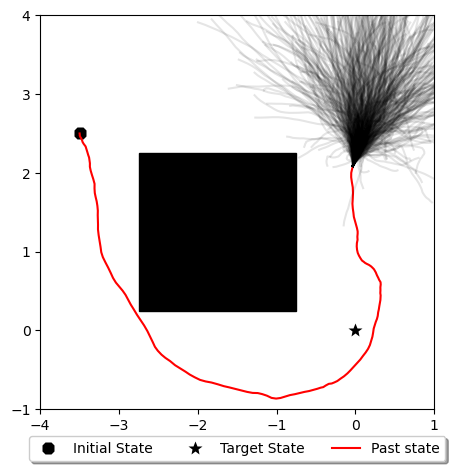

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


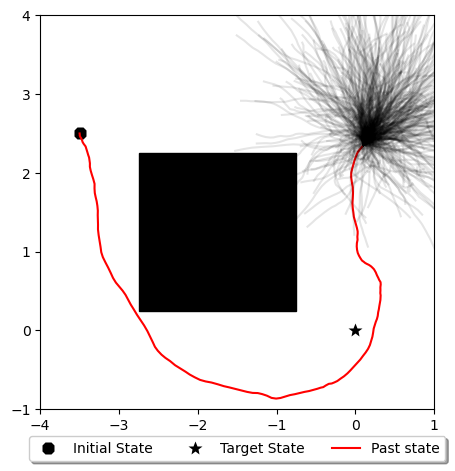

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


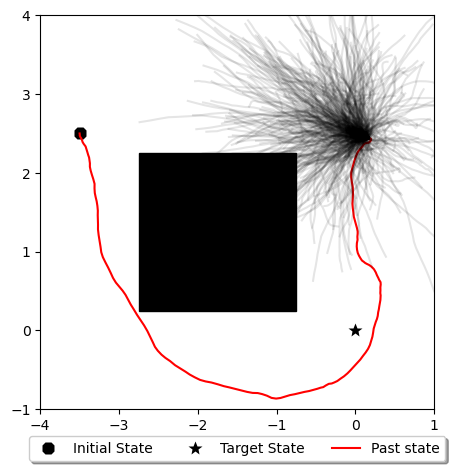

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


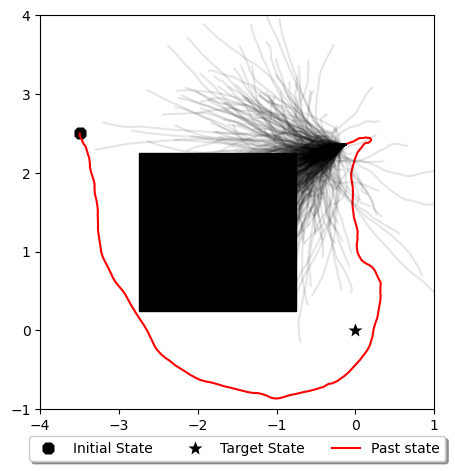

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


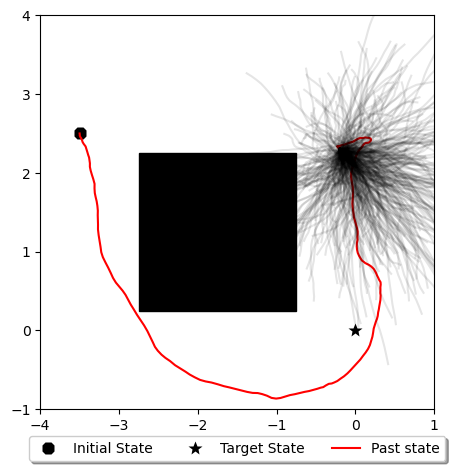

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


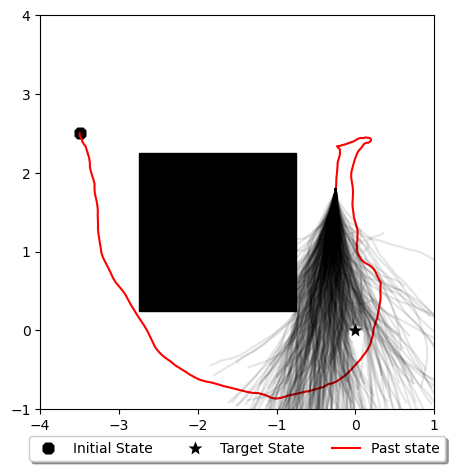

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


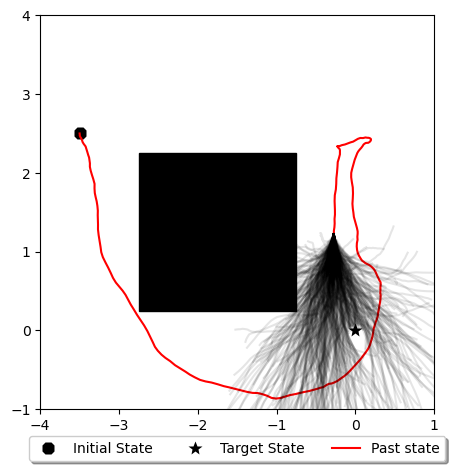

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


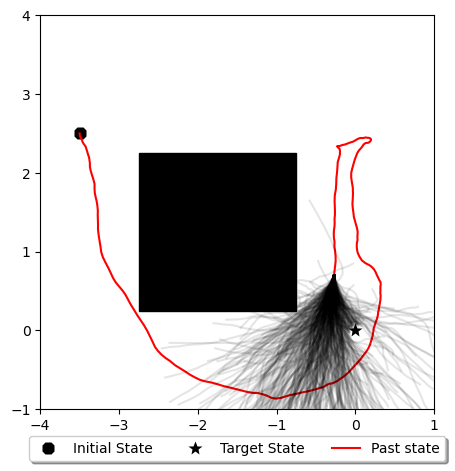

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


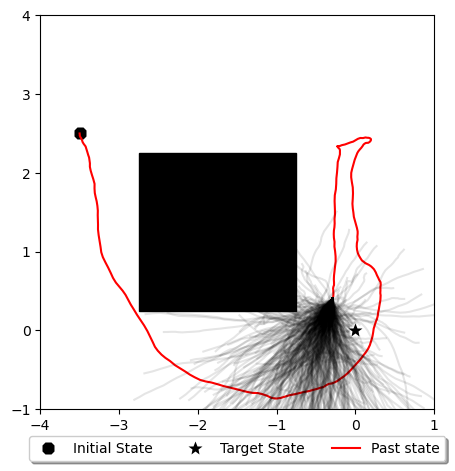

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


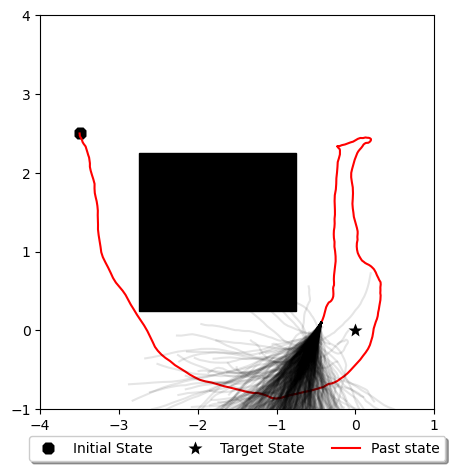

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


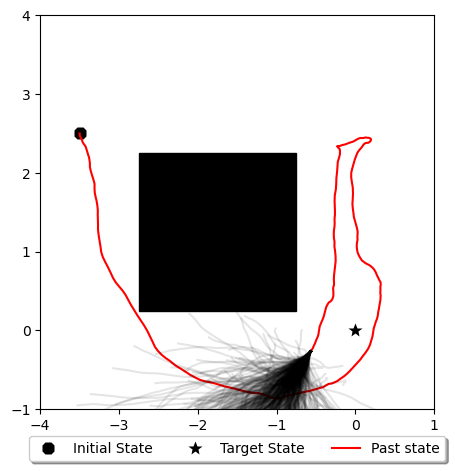

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


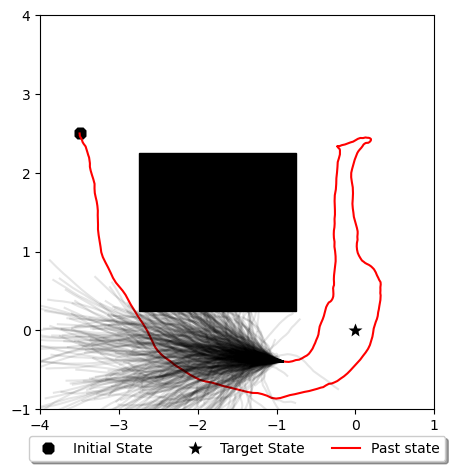

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


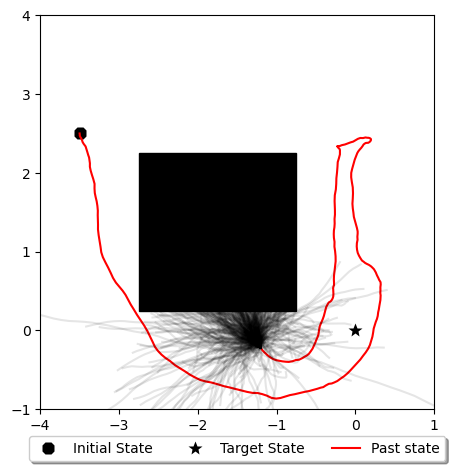

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


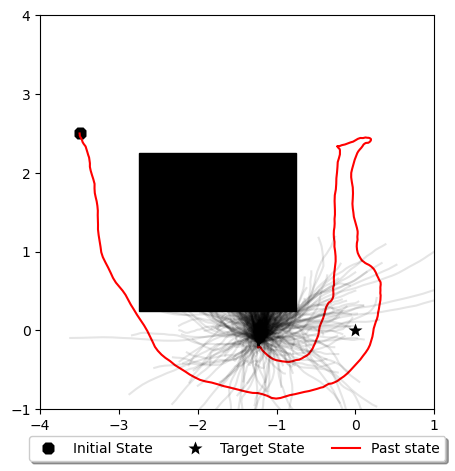

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


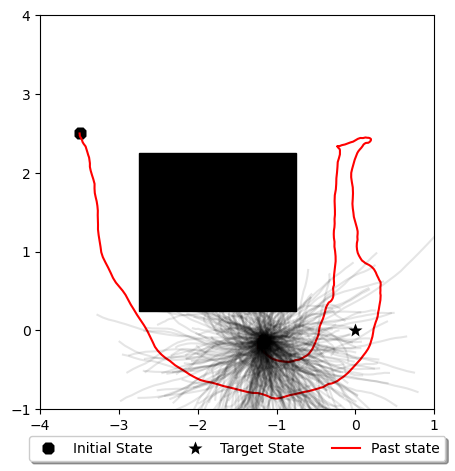

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


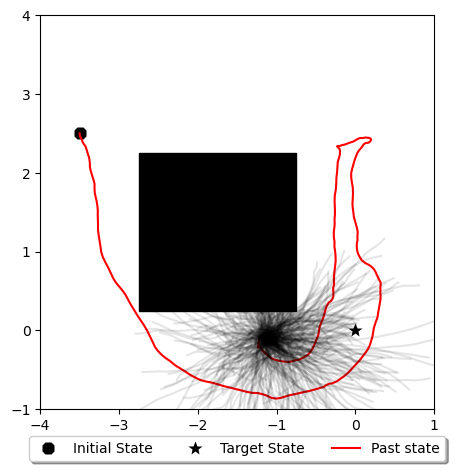

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


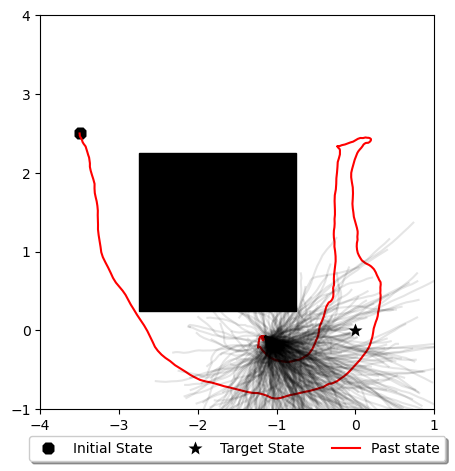

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


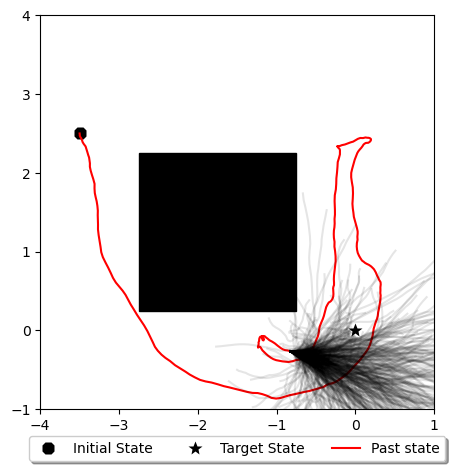

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


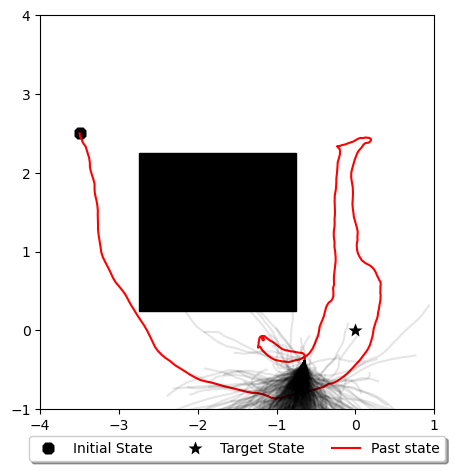

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


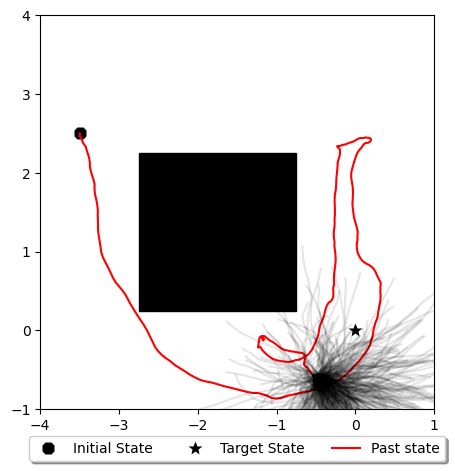

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


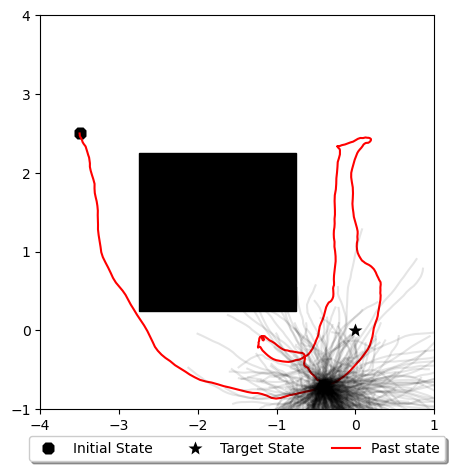

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


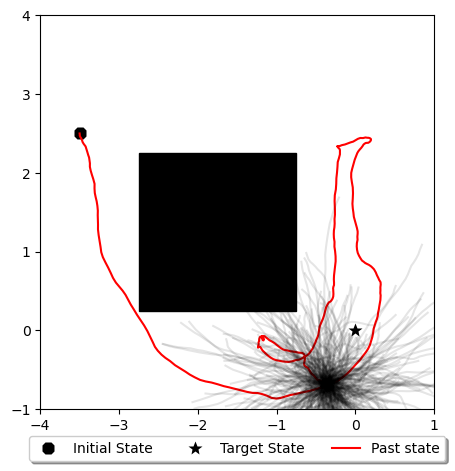

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


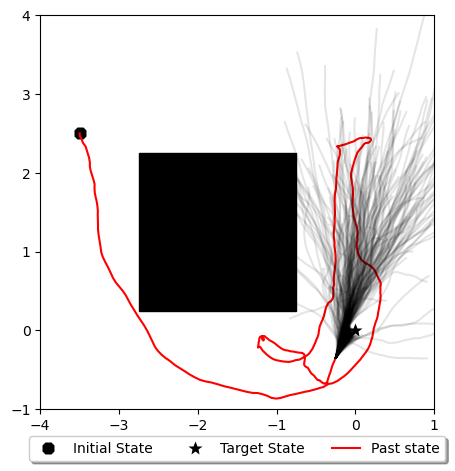

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -0.00020666277797684365. Stopping optimization.
Desired threshold reached with value -5.896974430169529e-05. Stopping optimization.
Goal reached at t=19.30s
Desired threshold reached with value -inf. Stopping optimization.


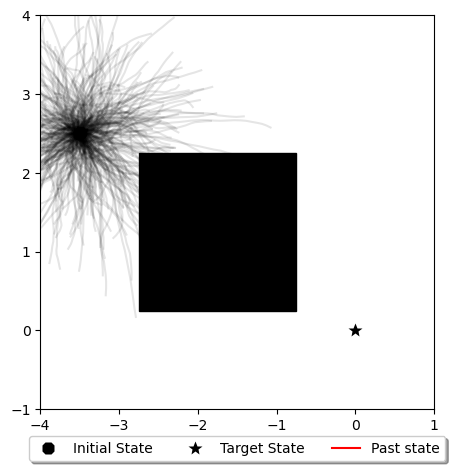

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


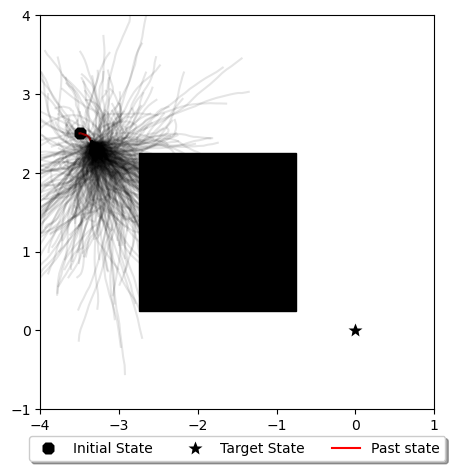

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


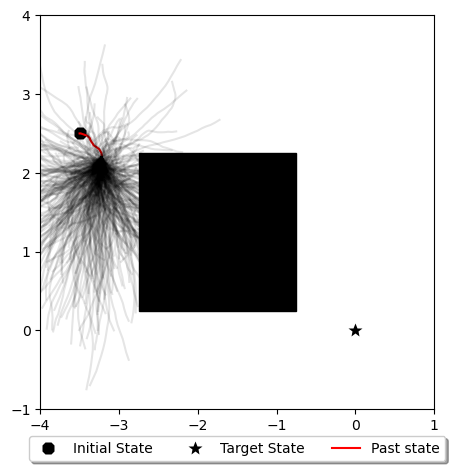

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


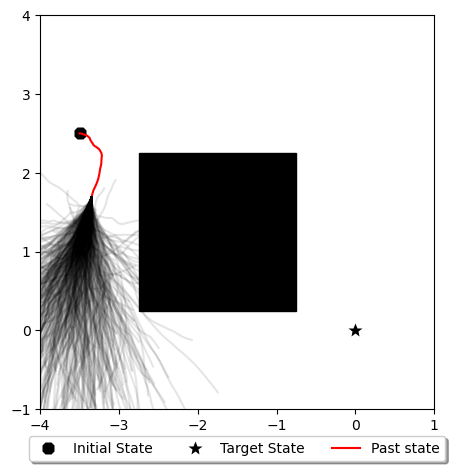

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


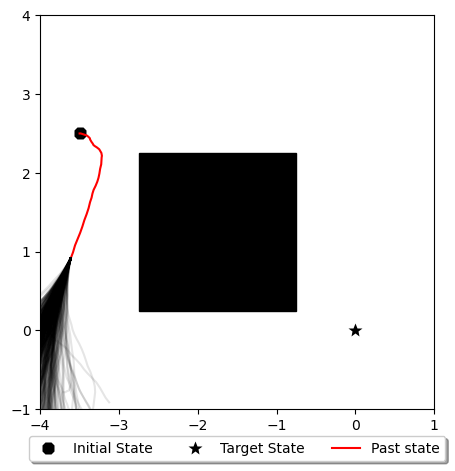

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Hit boundary
Desired threshold reached with value -inf. Stopping optimization.


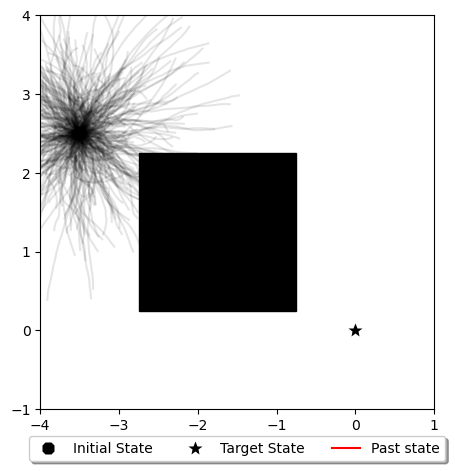

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


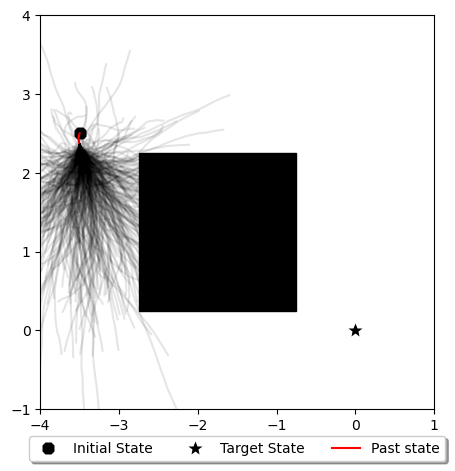

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


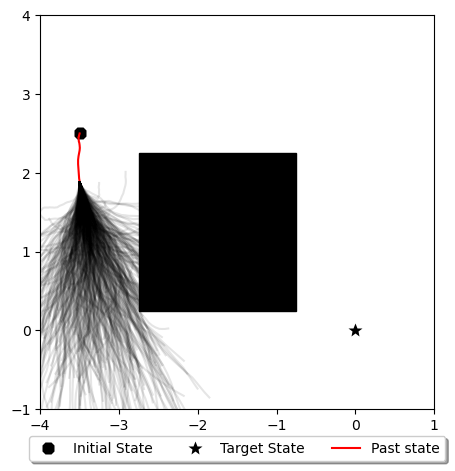

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


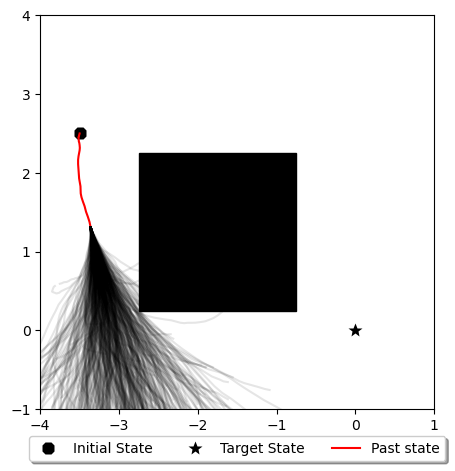

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


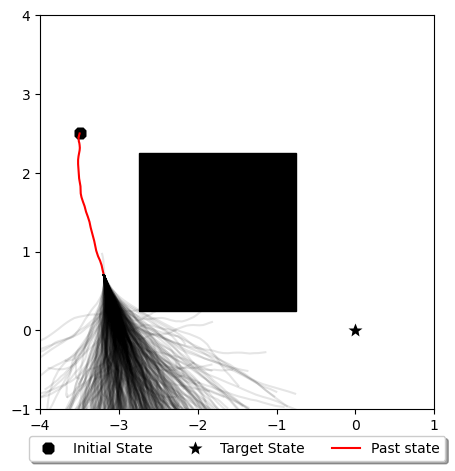

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


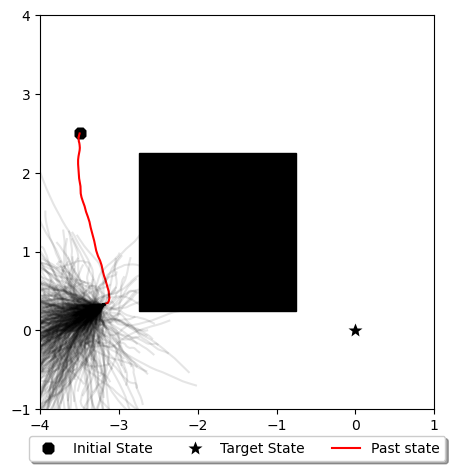

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


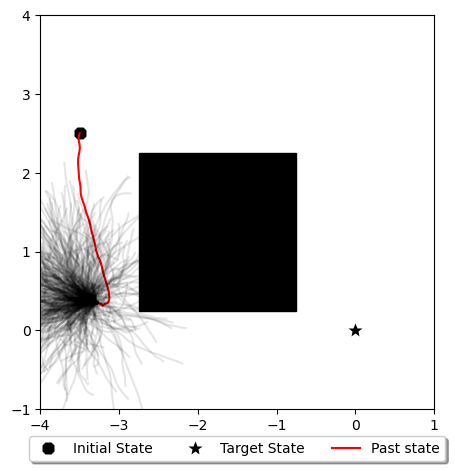

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


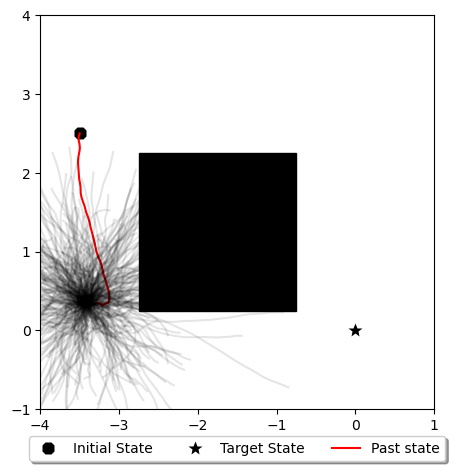

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


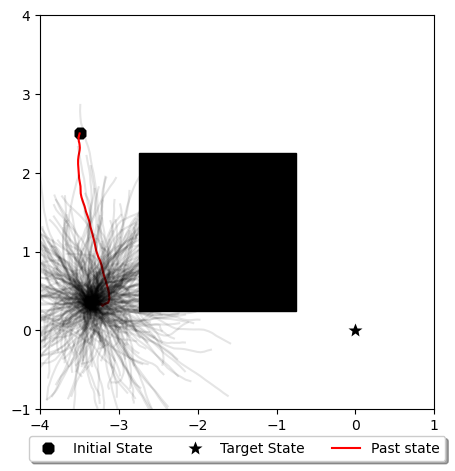

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


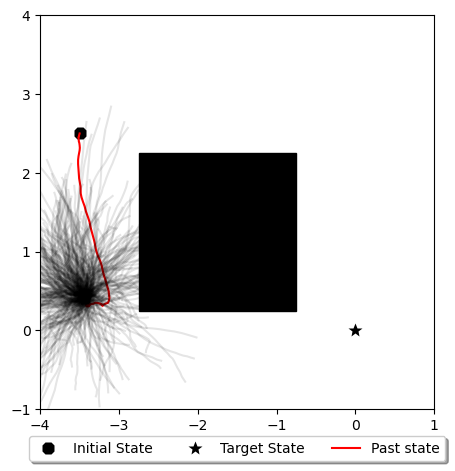

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


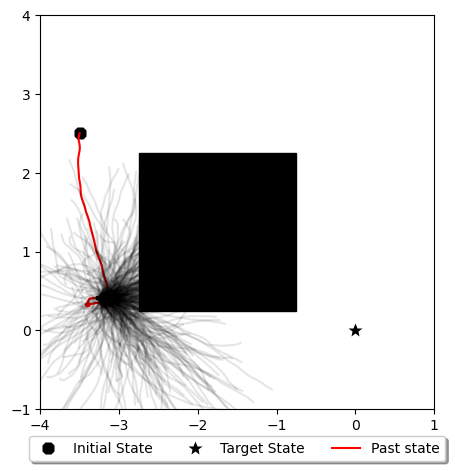

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


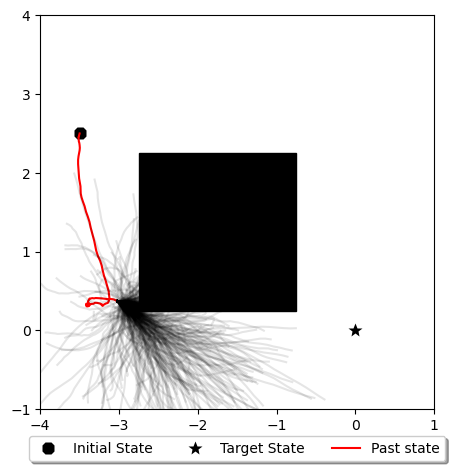

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


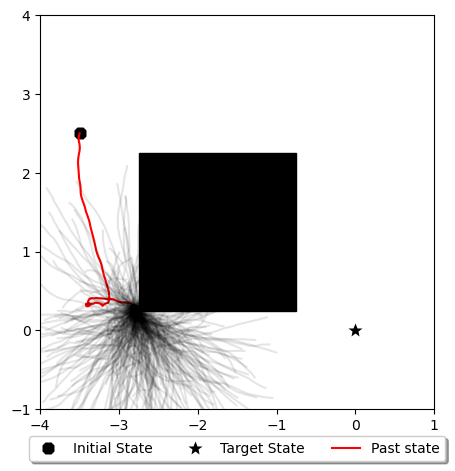

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


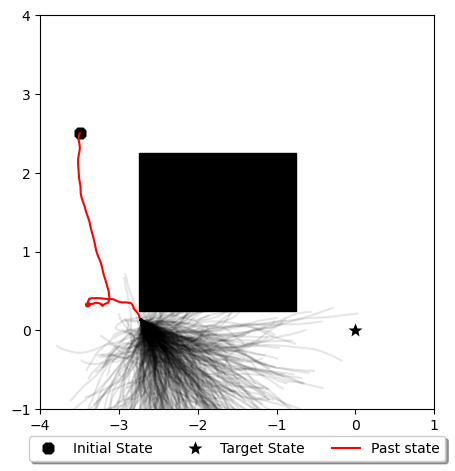

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


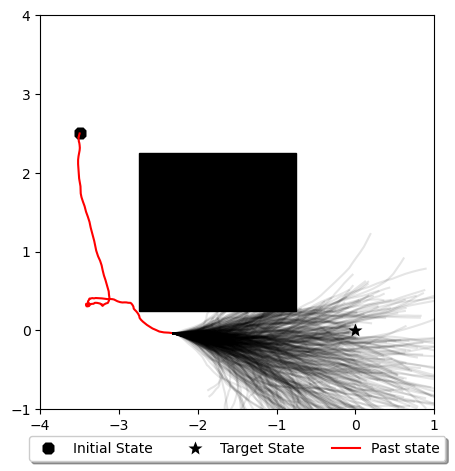

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


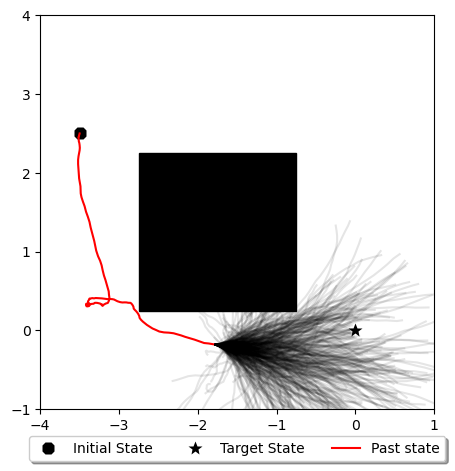

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


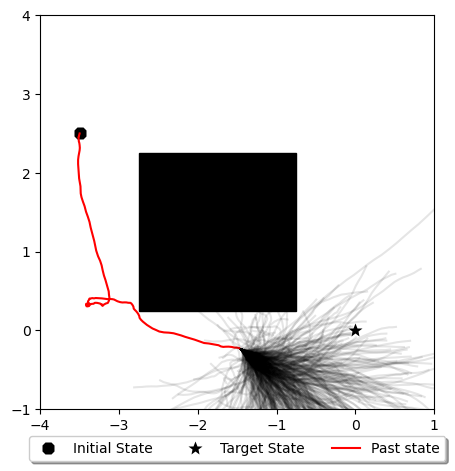

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


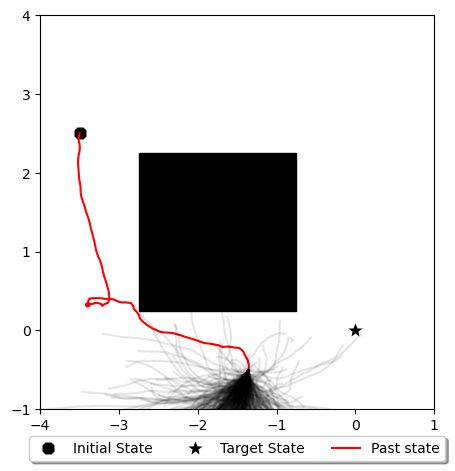

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


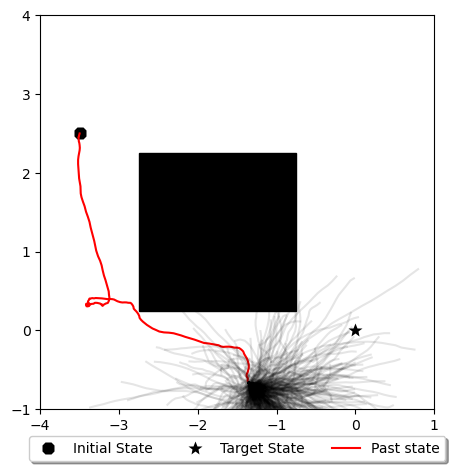

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


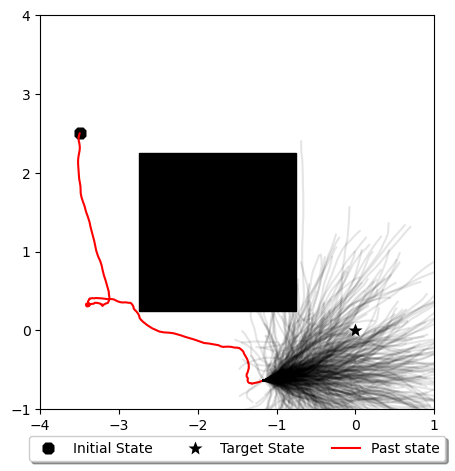

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


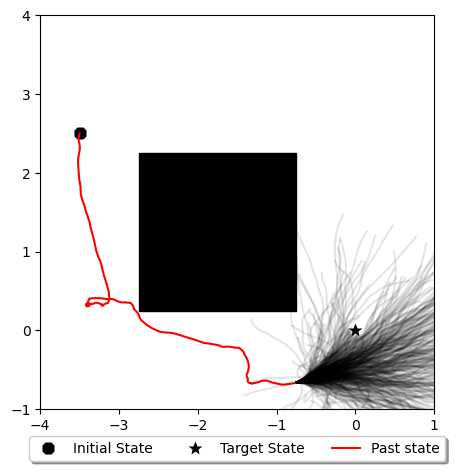

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


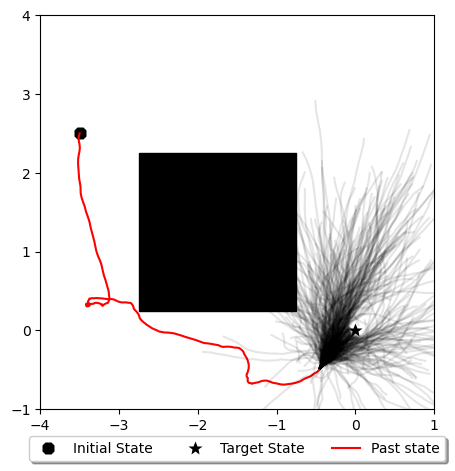

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


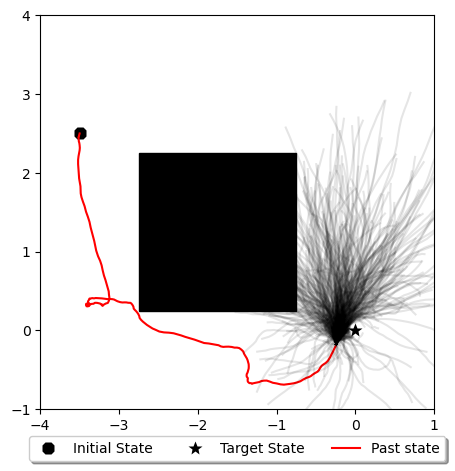

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


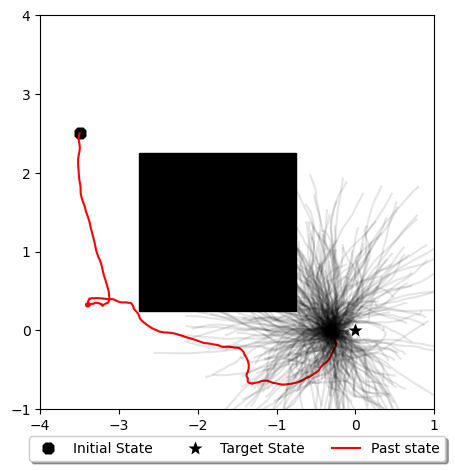

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


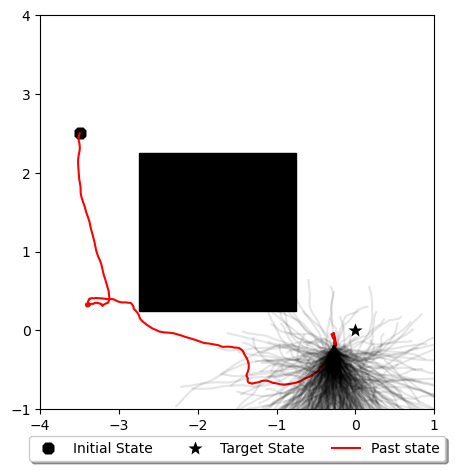

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


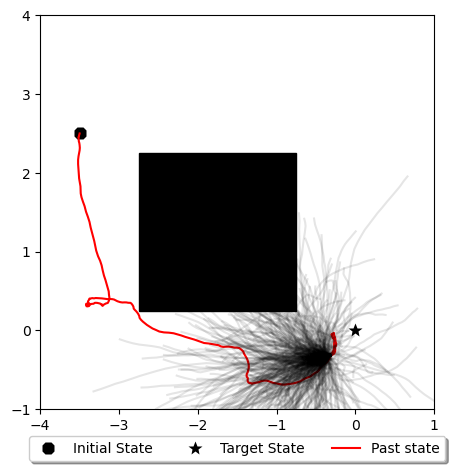

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


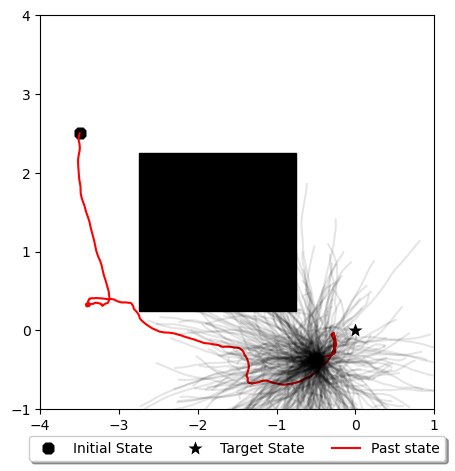

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


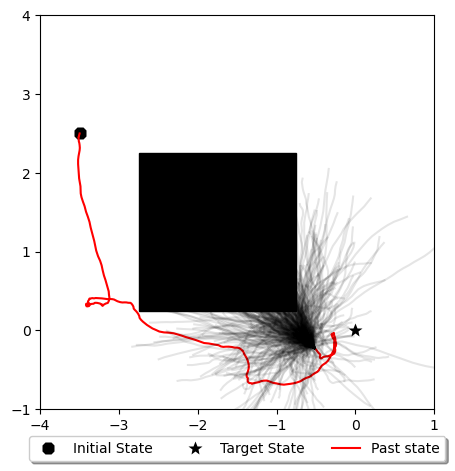

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


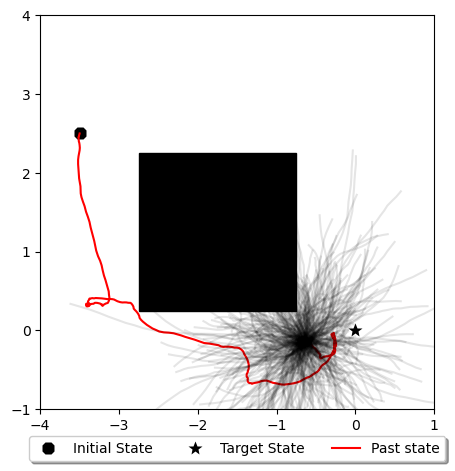

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


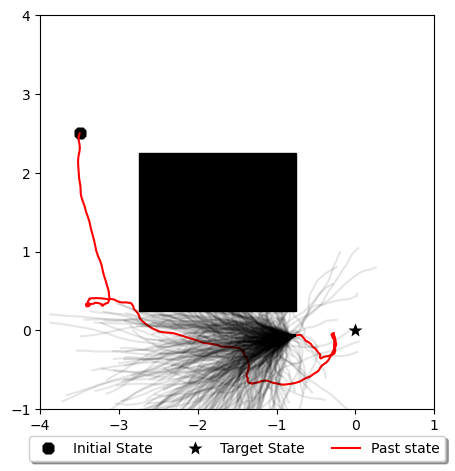

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


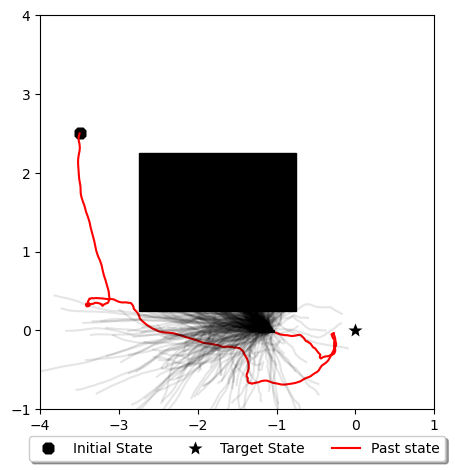

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


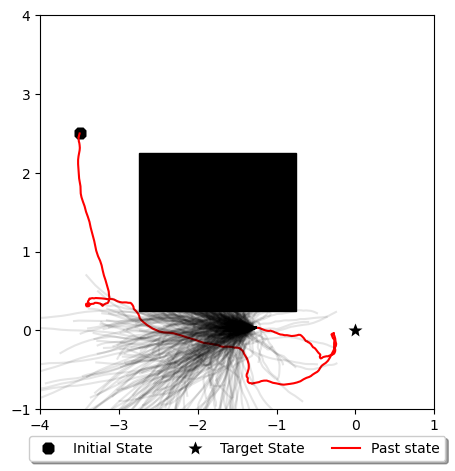

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


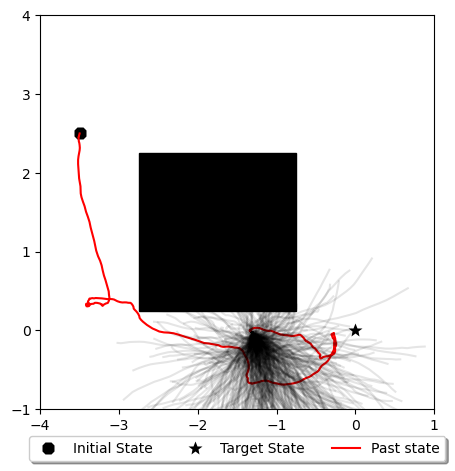

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


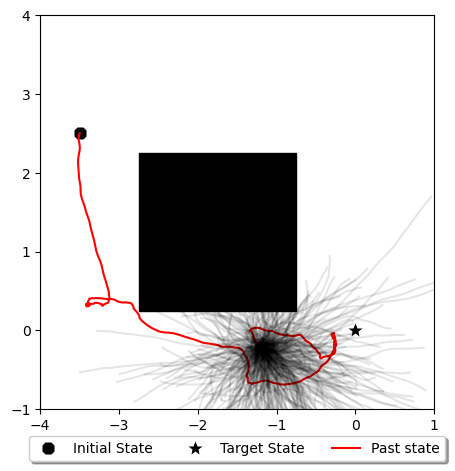

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


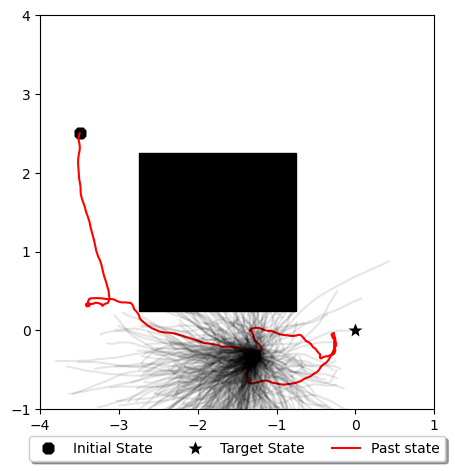

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


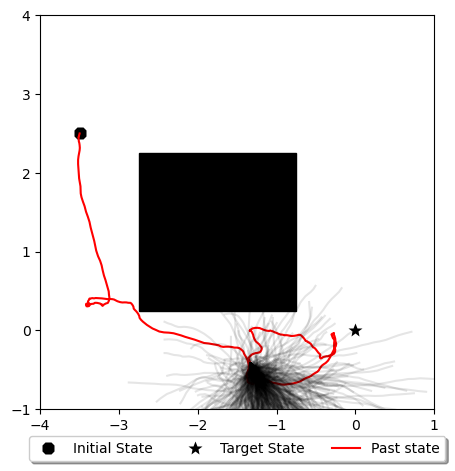

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


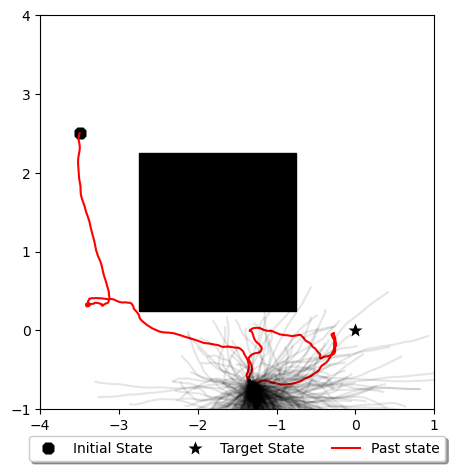

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


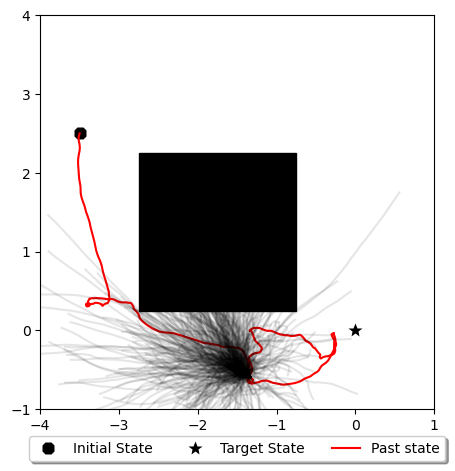

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


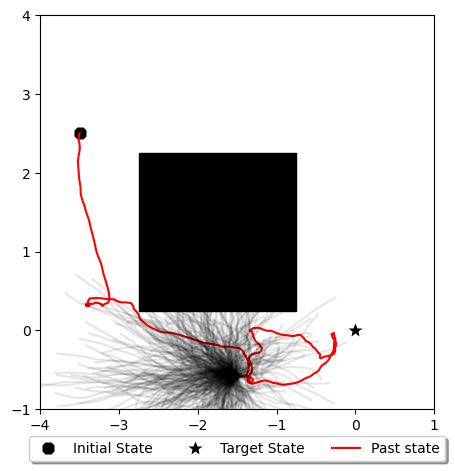

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


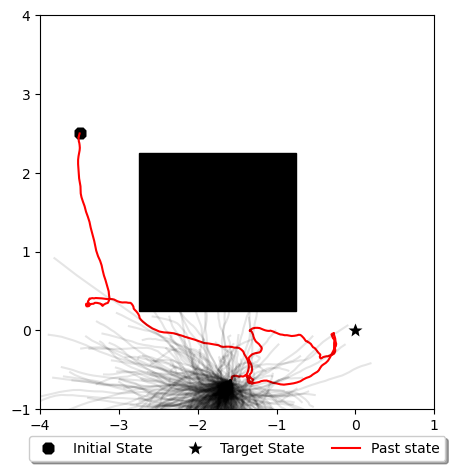

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


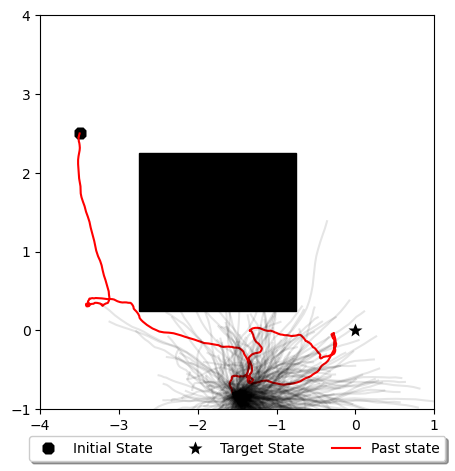

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


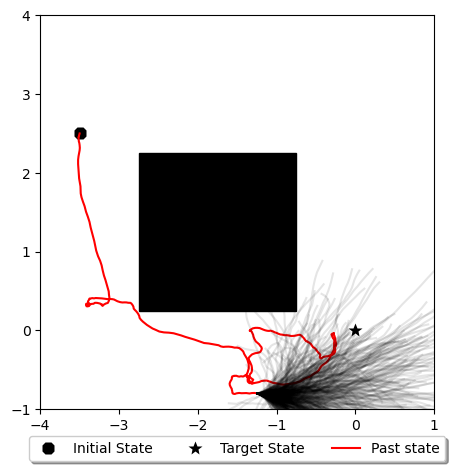

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


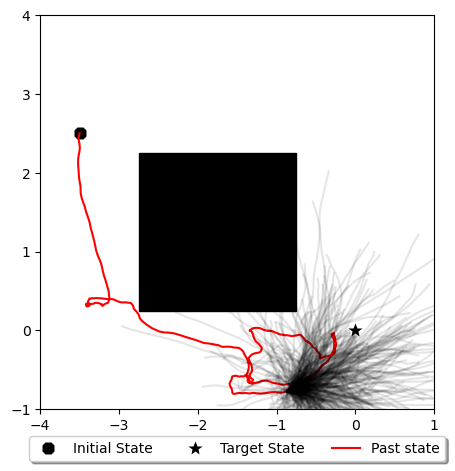

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


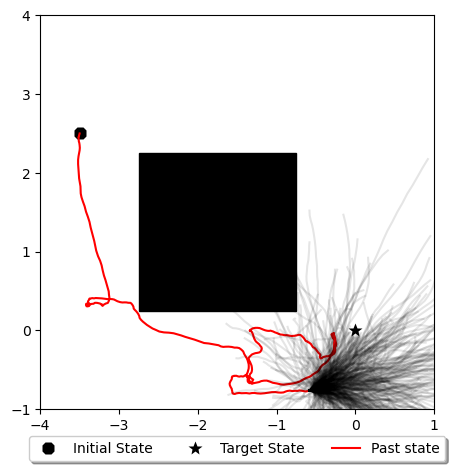

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


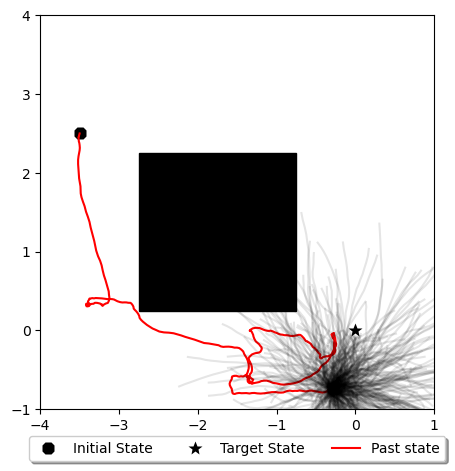

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


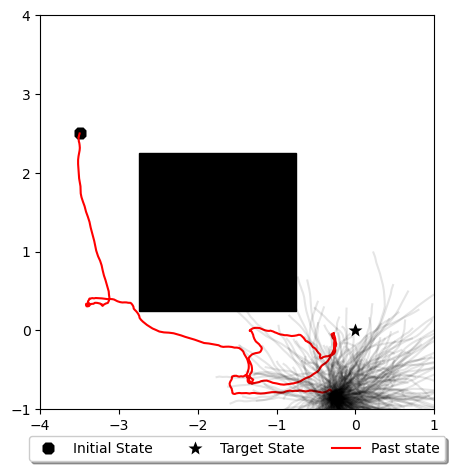

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


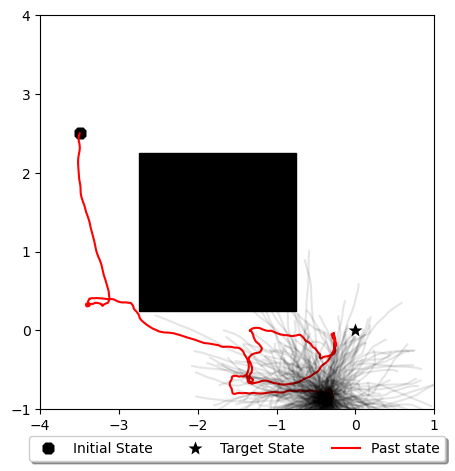

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


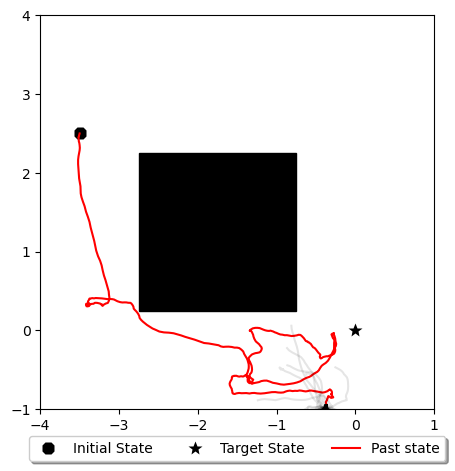

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


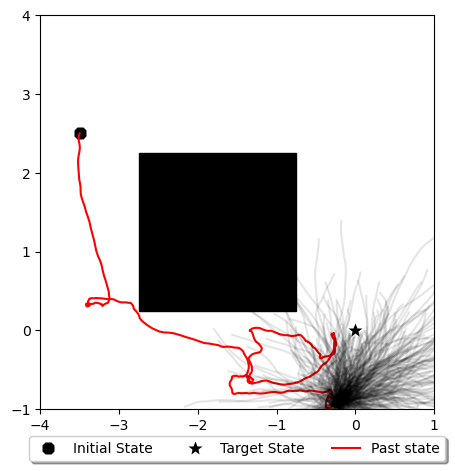

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


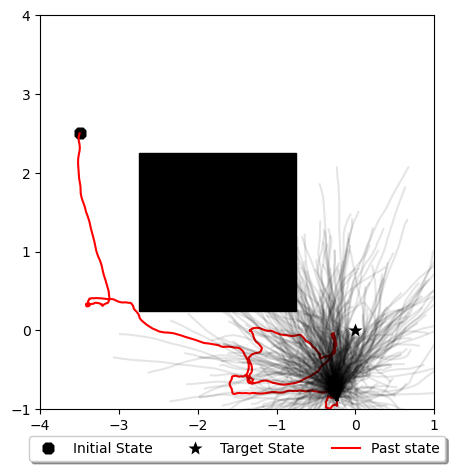

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


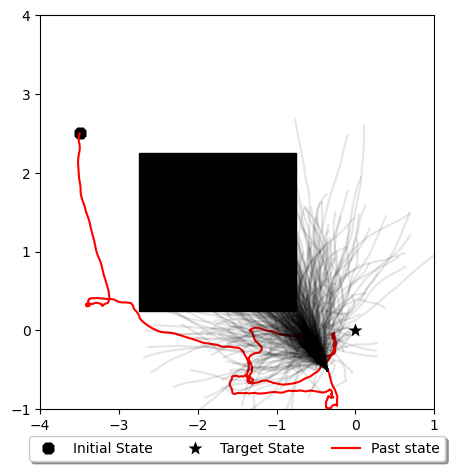

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


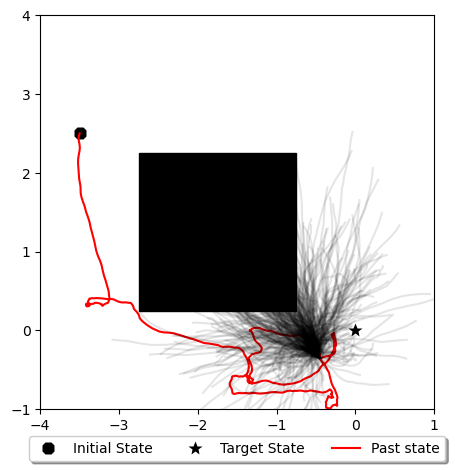

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


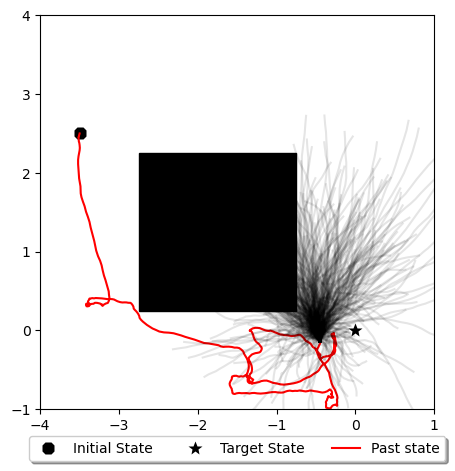

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


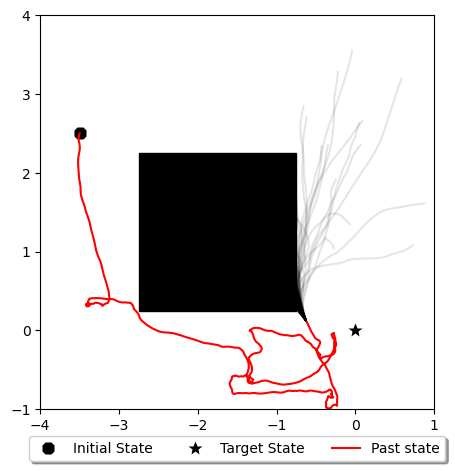

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


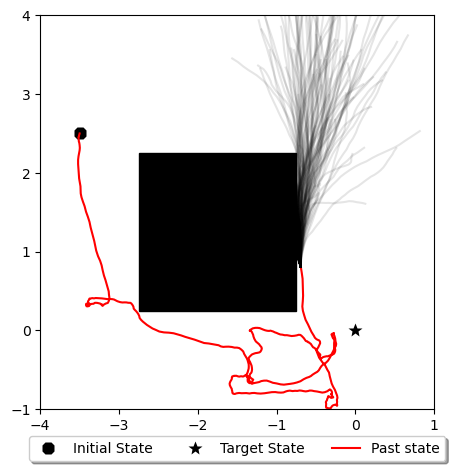

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


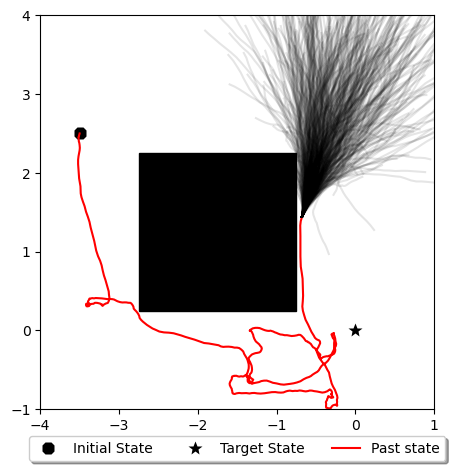

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


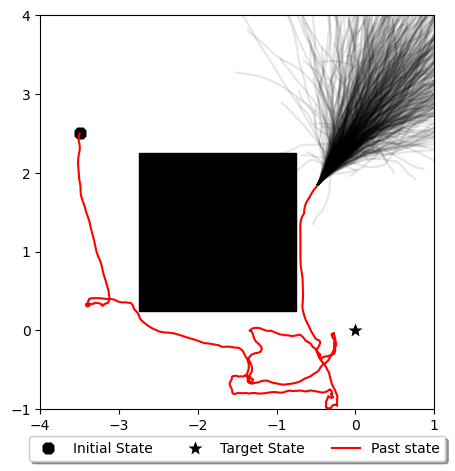

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


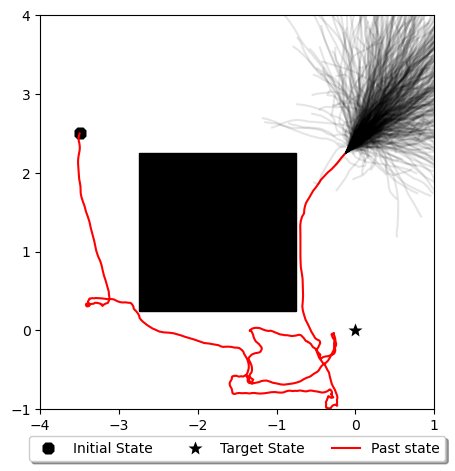

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


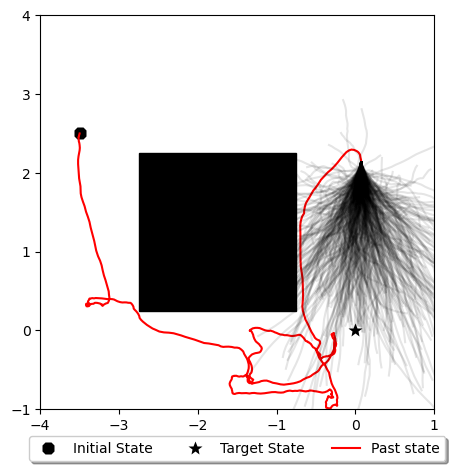

Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.
Desired threshold reached with value -inf. Stopping optimization.


KeyboardInterrupt: 

In [34]:
# Model parameters
for k in range(num_simulation) :
    terminate = False
    # obstacle_positions = []
    obstacle_positions = np.array([[-2.75, 0.25]])
    obstacle_radius = np.array([2.0])
    
    x_goal = np.array([0,0])
    x0 = np.array([-3.5, 2.5, 0, 0])
    obs_cost = 100
    dist_weight = 0.01
    gamma = [300]
    T = 2.0
    dt = 0.05
    theta = 0.01
    goal_tolerance = 0.1
    num_trajs = 500
    num_vis = 500
    
    # Simulation
    u_curr = np.zeros((int(T//dt), 2))
    x_hist = np.zeros( (max_steps+1, 4) )*np.nan
    u_hist = np.zeros( (max_steps+1, 2) )*np.nan
    x_hist[0] = x0
    
    vis_xlim = [-4.0, 1.0]
    vis_ylim = [-1.0, 4.0]
    
    
    hit_obstacle = False
    hit_boundary = False
    
    plot_every_n = 10
    for t in range(max_steps) :
        u_curr, x_vis = path_integral(x_hist[t], x_goal, u_curr, dist_weight, 
                               obs_cost, obstacle_positions, obstacle_radius, 
                               T, dt, theta, num_trajs, num_vis, init_report=t, gammas=gamma, sigma=sigma)
        u_hist[t] = u_curr[0]
        
        # for i, u in enumerate(u_curr[0]) :
        #     if u <= -0.005 :
        #         u_curr[0][i] = -0.1
        #     elif u >= 0.005 :
        #         u_curr[0][i] = 0.1
            
        # print( u_curr[0])
        
        # Simulate stochastic dynamics under control channel noise
        # u_noise = np.random.multivariate_normal(np.zeros(2), true_Sigma)
        # u_noise = GMM(true_mus, true_covs, true_probs)
        
        x_hist[t+1] =np.array([[1, 0, dt, 0],
                               [0, 1, 0, dt],
                               [0, 0, 1, 0],
                               [0, 0, 0, 1]]) @ x_hist[t] + np.array([[0, 0],[0, 0],[sigma, 0],[0, sigma]]) @ (u_curr[0] * dt ) \
                                                          + np.array([[0, 0],[0, 0],[sigma, 0],[0, sigma]]) @ (mu*dt + np.random.multivariate_normal(np.zeros(2), np.identity(2)) * np.sqrt(dt))                                                    
                                                          # + np.random.multivariate_normal( mu, sigma*np.identity(2)))    
        
        
        for obs_pos, obs_r in zip(obstacle_positions, obstacle_radius) :
            if (x_hist[t+1,0] > obs_pos[0] and x_hist[t+1,0] < obs_pos[0] + obs_r and 
                x_hist[t+1,1] > obs_pos[1] and x_hist[t+1,1] < obs_pos[1] + obs_r) :
                
                hit_obstacle = True
                terminate = True
                fail_index.append(k)
                print("Hit obstacle")
        
        if hit_obstacle == True :
            break
        
        # Boundary 
        if (x_hist[t+1,0] < -4 or x_hist[t+1,0] > 1  or x_hist[t+1,1] < -1 or x_hist[t+1,1] > 4 )  :
            hit_boundary = True
            terminate = True
            fail_index.append(k)
            print("Hit boundary")
            
        
        if hit_boundary == True :
            break
        
        # Goal check
        if np.linalg.norm(x_hist[t+1, :2] - x_goal) <= goal_tolerance :
            print("Goal reached at t={:.2f}s".format(t*dt))
            success_time.append(t*dt)
            terminate = True
            success_index.append(k)
            break
        
        if t % plot_every_n == 0 :
        # if terminate == True:
            # print(f"State:{x_hist[t+1]}")
            # print(f"Control:{u_curr[0]}")
            # Visualize the basic setup
            fig, ax = plt.subplots()
            ax.plot([x0[0]], [x0[1]], '8', markersize = 10, markerfacecolor = 'k', label = 'Initial State',markeredgecolor = 'none' )
            # ax.plot([x_hist[t+1,0]], [x_hist[t+1,1]], 'ro', markersize = 5, label = 'Curr. State', zorder =5 )
            # c1 = plt.Circle(x_goal, goal_tolerance, color = 'b', linewidth = 3, fill=False, zorder = 7)
            ax.plot([x_goal[0]], [x_goal[1]], '*', markersize = 10, markerfacecolor = 'k', label = 'Target State',markeredgecolor = 'none' )
            # ax.add_patch(c1)
            
            # Show obstacles
            if len(obstacle_positions) != 0 :
                for obs_pos, obs_r in zip(obstacle_positions, obstacle_radius) :
                    # obs = plt.Circle(obs_pos, obs_r, color='k', fill=True, zorder=6)
                    obs = plt.Rectangle(obs_pos, obs_r, obs_r, color='k', fill=True, zorder=6)
                    ax.add_patch(obs)
            
            # Track the realized trajectoy
            ax.plot(x_hist[:,0], x_hist[:,1], 'r', label='Past state')
            
            # Get rollout states from subset of maps for visualization
            ax.plot(x_vis[:,:,0].T, x_vis[:,:,1].T, 'k', alpha=0.1, zorder=3)
            
            
            ax.set_xlim(vis_xlim)
            ax.set_ylim(vis_ylim)
            
            # ax.legend(loc='lower left')
            ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05),
              fancybox=True, shadow=True, ncol=5)
            ax.set_aspect('equal')
            plt.tight_layout()
            # plt.savefig(f'simulation\plot_{t}.png')
            plt.show()
        
    # x_hists[k, :t, :] = x_hist[:t, :2]

    # if terminate == True:
    #     # Visualize the basic setup
    #     fig, ax = plt.subplots()
    #     ax.plot([x0[0]], [x0[1]], '8', markersize = 20, markerfacecolor = 'lime', label = 'Initial State',markeredgecolor = 'k', zorder=6  )
    #     ax.plot([x_goal[0]], [x_goal[1]], '*', markersize = 20, markerfacecolor = 'lime', label = 'Target State',markeredgecolor = 'k', zorder=6  )
        
    #     # Show obstacles
    #     for obs_pos, obs_r in zip(obstacle_positions, obstacle_radius) :
    #         obs = plt.Rectangle(obs_pos, obs_r, obs_r, color='k', fill=True, zorder=6)
    #         ax.add_patch(obs)
        
    #     # Track the realized trajectoy
    #     ax.plot(x_hist[:,0], x_hist[:,1], 'r', label='Past state')
    #     # ax.plot(x_vis[:,:,0].T, x_vis[:,:,1].T, 'k', alpha=0.1, zorder=3)
        
    #     ax.set_xlim(vis_xlim)
    #     ax.set_ylim(vis_ylim)
        
    #     # ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05),
    #     #   fancybox=True, shadow=True, ncol=5)
    #     ax.set_aspect('equal')
    #     plt.tight_layout()
    #     ax.set_xlabel(r'$p_{x}$')
    #     ax.set_ylabel(r'$p_{y}$')
    #     plt.gcf().set_dpi(600)
    #     plt.show()
   